In [1]:
import logging

import numpy as np
import optimistix as optx
from atmodeller import (
    InteriorAtmosphere,
    Planet,
    Species,
    SpeciesCollection,
    debug_logger,
    earth_oceans_to_hydrogen_mass,
    SolverParameters,
)
from atmodeller.eos import get_eos_models
from atmodeller.solubility import get_solubility_models
from atmodeller.thermodata import IronWustiteBuffer

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.colors import LogNorm

from scipy.interpolate import interp1d
import os

from matplotlib.ticker import ScalarFormatter

formatter = ScalarFormatter(useMathText=False)
formatter.set_scientific(False)
formatter.set_useOffset(False)
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable

logger = debug_logger()
logger.setLevel(logging.INFO)

# For more output use DEBUG
# logger.setLevel(logging.DEBUG)

Atmodeller initialized with double precision (float64)


In [2]:
number_of_realisations = 500
surface_temperature = 2500  # K -> take another temperature, the one aligning with mbe, up to 2-3k kelvin https://link.springer.com/article/10.1007/s11214-020-00660-3
# For simulations with fixed mass and surface radius:
planet_mass = 8e25 #13.4 earth masses for inside boundary (90% somewhat, could be less, reask)
surface_radius = 2.5559e7  # Lindal et al -> Can be discussed, radius of magma envelope boundary -> reduce and deal with incostitent between rocky and ice planets
#will iterate over later, take for now 0.8 r_U (I find results of 0.4-0.9). r_U = 2.5559e7 https://link.springer.com/article/10.1007/s11214-020-00660-3
mantle_melt_fraction = 1.0  # 0.1 -> we will iterate 

RANDOM_SEED = 0
np.random.seed(RANDOM_SEED)

In [3]:
H_masspercent_lodders09: float = 73.9
He_masspercent_lodders09: float = 24.69
C_masspercent_lodders09: float = 0.22
N_masspercent_lodders09: float = 0.07
O_masspercent_lodders09: float = 0.63
Si_masspercent_lodders09: float = 0.07
Mg_masspercent_lodders09: float = 0.06

H_logN: float = 12
He_logN: float = 10.93
C_logN: float = 8.39
N_logN: float = 7.86
O_logN: float = 8.73
Si_logN: float = 7.53
Mg_logN: float = 7.54 

In [4]:
#SiO2 for primitive composition of Earth
SiO2_mantlemasspercent_palme14: float = 45.4
total_mantlemasspercent_palme14: float = 98.41
core_mass_fraction: float = 0.327  # typical values used are between 0.325 - 0.33
Si_massfraction_palme14: float = round(
    SiO2_mantlemasspercent_palme14
    / total_mantlemasspercent_palme14
    * (1 - core_mass_fraction)
    / (28.0855 + 2 * 15.999)
    * 28.0855,
    3,
)

O_massfraction_palme141: float = Si_massfraction_palme14 / 28.0855 * 2 * 15.999

MgO_mantlemasspercent_palme14: float = 36.77
Mg_massfraction_palme14: float = round(
    MgO_mantlemasspercent_palme14
    / total_mantlemasspercent_palme14
    * (1 - core_mass_fraction)
    / (24.305 + 15.999)
    * 24.305,
    3,
)

O_massfraction_palme142: float = Si_massfraction_palme14 / 24.305 * 15.999
O_massfraction_palme14 = O_massfraction_palme141 + O_massfraction_palme142

In [5]:
#define what volume is

eos_models = get_eos_models()
sol_models = get_solubility_models()

H2O_g = Species.create_gas("H2O")
H2O_gs = Species.create_gas("H2O", solubility=sol_models["H2O_peridotite_sossi23"])
H2O_rgs = Species.create_gas(
    "H2O",
    activity=eos_models["H2O_cork_holland98"],
    solubility=sol_models["H2O_peridotite_sossi23"],
)

H2_g = Species.create_gas("H2")
H2_gs = Species.create_gas("H2", solubility=sol_models["H2_basalt_hirschmann12"])
H2_rgs = Species.create_gas(
    "H2", activity=eos_models["H2_chabrier21"], solubility=sol_models["H2_basalt_hirschmann12"]
)

O2_g = Species.create_gas("O2")
O2_rg = Species.create_gas("O2", activity=eos_models["O2_cs_shi92"])

OSi_g = Species.create_gas("OSi")
OSi_rg = Species.create_gas("OSi", activity=eos_models["OSi_rk49_connolly16"])

H4Si_g = Species.create_gas("H4Si")
H4Si_rg = Species.create_gas("H4Si", activity=eos_models["H4Si_wang18"])

O2Si_l = Species.create_condensed("O2Si", state="l")
O2Si_bqz = Species.create_condensed("O2Si", state="bqz")

CO2_g = Species.create_gas("CO2")
CO2_gs = Species.create_gas("CO2", solubility=sol_models["CO2_basalt_dixon95"])
CO2_rgs = Species.create_gas(
    "CO2", solubility=sol_models["CO2_basalt_dixon95"], activity=eos_models["CO2_cs_shi92"]
)

CO_g = Species.create_gas("CO")
CO_gs = Species.create_gas("CO", solubility=sol_models["CO_basalt_yoshioka19"])
CO_rgs = Species.create_gas(
    "CO", solubility=sol_models["CO_basalt_yoshioka19"], activity=eos_models["CO_cs_shi92"]
)

CH4_g = Species.create_gas("CH4")
CH4_gs = Species.create_gas("CH4", solubility=sol_models["CH4_basalt_ardia13"])
CH4_rgs = Species.create_gas(
    "CH4", solubility=sol_models["CH4_basalt_ardia13"], activity=eos_models["CH4_cs_shi92"]
)

N2_g = Species.create_gas("N2")
N2_gs = Species.create_gas("N2", solubility=sol_models["N2_basalt_libourel03"])
N2_rgs = Species.create_gas(
    "N2", solubility=sol_models["N2_basalt_libourel03"], activity=eos_models["N2_cs_saxena87"]
)

NH3_g = Species.create_gas("NH3")
NH3_rg = Species.create_gas("H3N", activity=eos_models["H3N_rk49_reid87"])

He_g = Species.create_gas("He")
He_gs = Species.create_gas("He", solubility=sol_models["He_basalt_jambon86"])
He_rgs = Species.create_gas(
    "He", solubility=sol_models["He_basalt_jambon86"], activity=eos_models["He_chabrier21"]
)

Mg_g = Species.create_gas("Mg")
#Mg_gs = Species.create_gas("He", solubility=sol_models["He_basalt_jambon86"])
#Mg_rgs = Species.create_gas(
#    "He", solubility=sol_models["He_basalt_jambon86"], activity=eos_models["He_chabrier21"]
#)

MgO_l = Species.create_condensed("MgO", state="l")
MgO_cr = Species.create_condensed("MgO", state="cr")
MgH_g = Species.create_gas("MgH")
MgOH_g = Species.create_gas("MgOH")

species_HHeCNOSi_magma_nosol_ideal = SpeciesCollection(
    (H2O_g, H2_g, O2_g, OSi_g, H4Si_g, O2Si_l, CO2_g, CO_g, CH4_g, N2_g, NH3_g, He_g, Mg_g, MgO_l, MgH_g, MgOH_g)
)
species_HHeCNOSi_magma_sol_ideal = SpeciesCollection(
    (H2O_gs, H2_gs, O2_g, OSi_g, H4Si_g, O2Si_l, CO2_gs, CO_gs, CH4_gs, N2_gs, NH3_g, He_gs, Mg_g, MgO_l, MgH_g, MgOH_g)
)
species_HHeCNOSi_magma_sol_real = SpeciesCollection(
    (
        H2O_rgs,
        H2_rgs,
        O2_rg,
        OSi_rg,
        H4Si_rg,
        O2Si_l,
        CO2_rgs,
        CO_rgs,
        CH4_rgs,
        N2_rgs,
        NH3_rg,
        He_rgs,
        Mg_g, 
        MgO_l,
        MgH_g,
        MgOH_g
    )
)
#MgH Magnesium Hydride
#MgOH Magnesium Hydroxide -> ideal gas law 
#Plot condensed moles for example for Silicon
#mass balance, take mass constraints, take atmospheric mass/moles+ take condensed mass/moles + take dissolved mass/moles
#plot envelope mass fraction, envelope mass/planet mass, Helled, what do they call the volatile layer. 
#temperature-pressure profile at 1 Myr or 10 Myr
#Ravit Helled 2011-2013

In [6]:
color_tot = "black"
color_H2 = "orange"
color_H2O = "blue"
color_SiH4 = "red"
color_SiO = "brown"
color_O2 = "limegreen"
color_CO2 = "cyan"
color_CO = "magenta"
color_CH4 = "purple"
color_N2 = "green"
color_NH3 = "pink"
color_MgO = "darkred"
color_He = "gray"
color_H = "orange"
color_C = "cyan"
color_N = "green"
color_O = "blue"
color_Si = "red"
color_Mg = "lime"
color_MgH2 = "gold"
color_MgH = "teal"
color_MgOH = "indigo"

In [7]:
metall = 30
hmps = np.logspace(-1, 1, num=number_of_realisations)

h_kgs = hmps / 100 * planet_mass  # kg

si_kg_magma: float = Si_massfraction_palme14 * planet_mass
mg_kg_magma: float = Mg_massfraction_palme14 * planet_mass
o_kg_magma: float = O_massfraction_palme14 * planet_mass

# Lodders et al. (2009) Springer book chapter Table 8
si_kgs_solar = h_kgs * Si_masspercent_lodders09 / H_masspercent_lodders09
mg_kgs_solar = h_kgs * Mg_masspercent_lodders09 / H_masspercent_lodders09
o_kgs_solar = h_kgs * O_masspercent_lodders09 / H_masspercent_lodders09
c_kgs_solar = h_kgs * C_masspercent_lodders09 / H_masspercent_lodders09
n_kgs_solar = h_kgs * N_masspercent_lodders09 / H_masspercent_lodders09
he_kgs_solar = h_kgs * He_masspercent_lodders09 / H_masspercent_lodders09
mass_constraints = {
    "H": h_kgs,
    "He": he_kgs_solar,
    "C": metall * c_kgs_solar,
    "N": metall * n_kgs_solar,
    "Si": metall * si_kgs_solar + mantle_melt_fraction * si_kg_magma,
    "O": metall * o_kgs_solar + mantle_melt_fraction * o_kg_magma,
    "Mg": metall * mg_kgs_solar + mantle_melt_fraction * mg_kg_magma,
        }


In [8]:
def create_isotherms(surface_temperature, planet_mass, mantle_melt_fraction, surface_radius, metallicity):
    hmps = np.logspace(-1, 1, num=number_of_realisations)

    h_kgs = hmps / 100 * planet_mass  # kg

    si_kg_magma: float = Si_massfraction_palme14 * planet_mass
    mg_kg_magma: float = Mg_massfraction_palme14 * planet_mass
    o_kg_magma: float = O_massfraction_palme14 * planet_mass

    # Lodders et al. (2009) Springer book chapter Table 8
    si_kgs_solar = h_kgs * Si_masspercent_lodders09 / H_masspercent_lodders09
    mg_kgs_solar = h_kgs * Mg_masspercent_lodders09 / H_masspercent_lodders09
    o_kgs_solar = h_kgs * O_masspercent_lodders09 / H_masspercent_lodders09
    c_kgs_solar = h_kgs * C_masspercent_lodders09 / H_masspercent_lodders09
    n_kgs_solar = h_kgs * N_masspercent_lodders09 / H_masspercent_lodders09
    he_kgs_solar = h_kgs * He_masspercent_lodders09 / H_masspercent_lodders09
    mass_constraints = {
        "H": h_kgs,
        "He": he_kgs_solar,
        "C": metallicity * c_kgs_solar,
        "N": metallicity * n_kgs_solar,
        "Si": metallicity * si_kgs_solar + mantle_melt_fraction * si_kg_magma,
        "O": metallicity * o_kgs_solar + mantle_melt_fraction * o_kg_magma,
        "Mg": metallicity * mg_kgs_solar + mantle_melt_fraction * mg_kg_magma,
            }



    Uranus = Planet(
                surface_temperature=surface_temperature,
                planet_mass=planet_mass,
                mantle_melt_fraction=mantle_melt_fraction,
                surface_radius=surface_radius,
            )

    model_magma_nosol_ideal = InteriorAtmosphere(species_HHeCNOSi_magma_nosol_ideal)
    model_magma_nosol_ideal.solve(
            planet=Uranus,
            mass_constraints=mass_constraints,
            )
    output_magma_nosol_ideal = model_magma_nosol_ideal.output
    output_magma_nosol_ideal.quick_look()
    output_magma_nosol_ideal.to_excel("HHeCNOSi_magma_nosol_ideal")

    model_magma_sol_ideal = InteriorAtmosphere(species_HHeCNOSi_magma_sol_ideal)
    initial_log_number_density = output_magma_nosol_ideal.log_number_density
    model_magma_sol_ideal.solve(
            planet=Uranus,
            mass_constraints=mass_constraints,
            initial_log_number_density=initial_log_number_density,
            )
    output_magma_sol_ideal = model_magma_sol_ideal.output
    output_magma_sol_ideal.quick_look()
    output_magma_sol_ideal.to_excel("HHeCNOSi_magma_sol_ideal")

    model_magma_sol_real = InteriorAtmosphere(species_HHeCNOSi_magma_sol_real)
    initial_log_number_density = output_magma_sol_ideal.log_number_density
    model_magma_sol_real.solve(
            planet=Uranus,
            mass_constraints=mass_constraints,
            initial_log_number_density=initial_log_number_density,
            )
    output_magma_sol_real = model_magma_sol_real.output
    output_magma_sol_real.quick_look()
    output_magma_sol_real.to_excel("HHeCNOSi_magma_sol_real")

    filename = "HHeCNOSi_magma_sol_real.xlsx"

    H2_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="H2_g")["pressure"]
    H2O_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="H2O_g")["pressure"]
    O2_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="O2_g")["pressure"]
    SiH4_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="H4Si_g")["pressure"]
    SiO_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="OSi_g")["pressure"]
    CO2_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="CO2_g")["pressure"]
    CO_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="CO_g")["pressure"]
    CH4_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="CH4_g")["pressure"]
    N2_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="N2_g")["pressure"]
    NH3_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="H3N_g")["pressure"]
    He_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="He_g")["pressure"]
    Mg_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="Mg_g")["pressure"]
    MgOH_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="HMgO_g")["pressure"]
    MgH_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="HMg_g")["pressure"]
    tot_pressure_magma_sol_real = pd.read_excel(filename, sheet_name="atmosphere")["pressure"]

    H2_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2_g")["total_number_density"]
    H2O_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2O_g")["total_number_density"]
    O2_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="O2_g")["total_number_density"]
    SiH4_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H4Si_g")["total_number_density"]
    SiO_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="OSi_g")["total_number_density"]
    CO2_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO2_g")["total_number_density"]
    CO_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO_g")["total_number_density"]
    CH4_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CH4_g")["total_number_density"]
    N2_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="N2_g")["total_number_density"]
    NH3_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H3N_g")["total_number_density"]
    He_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="He_g")["total_number_density"]
    Mg_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="Mg_g")["total_number_density"]
    MgOH_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMgO_g")["total_number_density"]
    MgH_total_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMg_g")["total_number_density"]

    H2_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2_g")["dissolved_number_density"]
    H2O_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2O_g")["dissolved_number_density"]
    O2_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="O2_g")["dissolved_number_density"]
    SiH4_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H4Si_g")["dissolved_number_density"]
    SiO_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="OSi_g")["dissolved_number_density"]
    CO2_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO2_g")["dissolved_number_density"]
    CO_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO_g")["dissolved_number_density"]
    CH4_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CH4_g")["dissolved_number_density"]
    N2_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="N2_g")["dissolved_number_density"]
    NH3_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H3N_g")["dissolved_number_density"]
    He_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="He_g")["dissolved_number_density"]
    Mg_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="Mg_g")["dissolved_number_density"]
    MgOH_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMgO_g")["dissolved_number_density"]
    MgH_dissolved_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMg_g")["dissolved_number_density"]

    H2_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2_g")["atmosphere_number_density"]
    H2O_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H2O_g")["atmosphere_number_density"]
    O2_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="O2_g")["atmosphere_number_density"]
    SiH4_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H4Si_g")["atmosphere_number_density"]
    SiO_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="OSi_g")["atmosphere_number_density"]
    CO2_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO2_g")["atmosphere_number_density"]
    CO_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CO_g")["atmosphere_number_density"]
    CH4_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="CH4_g")["atmosphere_number_density"]
    N2_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="N2_g")["atmosphere_number_density"]
    NH3_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="H3N_g")["atmosphere_number_density"]
    He_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="He_g")["atmosphere_number_density"]
    Mg_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="Mg_g")["atmosphere_number_density"]
    MgOH_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMgO_g")["atmosphere_number_density"]
    MgH_atmosphere_number_density_magma_sol_real = pd.read_excel(filename, sheet_name="HMg_g")["atmosphere_number_density"]

    H2_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="H2_g")["molar_mass"]
    H2O_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="H2O_g")["molar_mass"]
    O2_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="O2_g")["molar_mass"]
    SiH4_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="H4Si_g")["molar_mass"]
    SiO_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="OSi_g")["molar_mass"]
    CO2_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="CO2_g")["molar_mass"]
    CO_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="CO_g")["molar_mass"]
    CH4_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="CH4_g")["molar_mass"]
    N2_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="N2_g")["molar_mass"]
    NH3_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="H3N_g")["molar_mass"]
    He_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="He_g")["molar_mass"]
    Mg_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="Mg_g")["molar_mass"]
    MgOH_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="HMgO_g")["molar_mass"]
    MgH_molar_mass_magma_sol_real = pd.read_excel(filename, sheet_name="HMg_g")["molar_mass"]

    Avogadro = 6.022e23

    H2_total_rho = H2_total_number_density_magma_sol_real * H2_molar_mass_magma_sol_real / Avogadro 
    H2O_total_rho = H2O_total_number_density_magma_sol_real * H2O_molar_mass_magma_sol_real / Avogadro 
    O2_total_rho = O2_total_number_density_magma_sol_real * O2_molar_mass_magma_sol_real / Avogadro 
    SiH4_total_rho = SiH4_total_number_density_magma_sol_real * SiH4_molar_mass_magma_sol_real / Avogadro
    SiO_total_rho = SiO_total_number_density_magma_sol_real * SiO_molar_mass_magma_sol_real / Avogadro 
    CO2_total_rho = CO2_total_number_density_magma_sol_real * CO2_molar_mass_magma_sol_real / Avogadro 
    CO_total_rho = CO_total_number_density_magma_sol_real * CO_molar_mass_magma_sol_real / Avogadro 
    CH4_total_rho = CH4_total_number_density_magma_sol_real * CH4_molar_mass_magma_sol_real / Avogadro
    N2_total_rho = N2_total_number_density_magma_sol_real * N2_molar_mass_magma_sol_real / Avogadro 
    NH3_total_rho = NH3_total_number_density_magma_sol_real * NH3_molar_mass_magma_sol_real / Avogadro
    He_total_rho = He_total_number_density_magma_sol_real * He_molar_mass_magma_sol_real / Avogadro 
    Mg_total_rho = Mg_total_number_density_magma_sol_real * Mg_molar_mass_magma_sol_real / Avogadro 
    MgOH_total_rho = MgOH_total_number_density_magma_sol_real * MgOH_molar_mass_magma_sol_real / Avogadro 
    MgH_total_rho = MgH_total_number_density_magma_sol_real * MgH_molar_mass_magma_sol_real / Avogadro

    H2_dissolved_rho = H2_dissolved_number_density_magma_sol_real * H2_molar_mass_magma_sol_real / Avogadro 
    H2O_dissolved_rho = H2O_dissolved_number_density_magma_sol_real * H2O_molar_mass_magma_sol_real / Avogadro 
    O2_dissolved_rho = O2_dissolved_number_density_magma_sol_real * O2_molar_mass_magma_sol_real / Avogadro 
    SiH4_dissolved_rho = SiH4_dissolved_number_density_magma_sol_real * SiH4_molar_mass_magma_sol_real / Avogadro
    SiO_dissolved_rho = SiO_dissolved_number_density_magma_sol_real * SiO_molar_mass_magma_sol_real / Avogadro 
    CO2_dissolved_rho = CO2_dissolved_number_density_magma_sol_real * CO2_molar_mass_magma_sol_real / Avogadro 
    CO_dissolved_rho = CO_dissolved_number_density_magma_sol_real * CO_molar_mass_magma_sol_real / Avogadro 
    CH4_dissolved_rho = CH4_dissolved_number_density_magma_sol_real * CH4_molar_mass_magma_sol_real / Avogadro
    N2_dissolved_rho = N2_dissolved_number_density_magma_sol_real * N2_molar_mass_magma_sol_real / Avogadro 
    NH3_dissolved_rho = NH3_dissolved_number_density_magma_sol_real * NH3_molar_mass_magma_sol_real / Avogadro
    He_dissolved_rho = He_dissolved_number_density_magma_sol_real * He_molar_mass_magma_sol_real / Avogadro 
    Mg_dissolved_rho = Mg_dissolved_number_density_magma_sol_real * Mg_molar_mass_magma_sol_real / Avogadro 
    MgOH_dissolved_rho = MgOH_dissolved_number_density_magma_sol_real * MgOH_molar_mass_magma_sol_real / Avogadro 
    MgH_dissolved_rho = MgH_dissolved_number_density_magma_sol_real * MgH_molar_mass_magma_sol_real / Avogadro

    H2_atmosphere_rho = H2_atmosphere_number_density_magma_sol_real * H2_molar_mass_magma_sol_real / Avogadro 
    H2O_atmosphere_rho = H2O_atmosphere_number_density_magma_sol_real * H2O_molar_mass_magma_sol_real / Avogadro 
    O2_atmosphere_rho = O2_atmosphere_number_density_magma_sol_real * O2_molar_mass_magma_sol_real / Avogadro 
    SiH4_atmosphere_rho = SiH4_atmosphere_number_density_magma_sol_real * SiH4_molar_mass_magma_sol_real / Avogadro
    SiO_atmosphere_rho = SiO_atmosphere_number_density_magma_sol_real * SiO_molar_mass_magma_sol_real / Avogadro 
    CO2_atmosphere_rho = CO2_atmosphere_number_density_magma_sol_real * CO2_molar_mass_magma_sol_real / Avogadro 
    CO_atmosphere_rho = CO_atmosphere_number_density_magma_sol_real * CO_molar_mass_magma_sol_real / Avogadro 
    CH4_atmosphere_rho = CH4_atmosphere_number_density_magma_sol_real * CH4_molar_mass_magma_sol_real / Avogadro
    N2_atmosphere_rho = N2_atmosphere_number_density_magma_sol_real * N2_molar_mass_magma_sol_real / Avogadro 
    NH3_atmosphere_rho = NH3_atmosphere_number_density_magma_sol_real * NH3_molar_mass_magma_sol_real / Avogadro
    He_atmosphere_rho = He_atmosphere_number_density_magma_sol_real * He_molar_mass_magma_sol_real / Avogadro 
    Mg_atmosphere_rho = Mg_atmosphere_number_density_magma_sol_real * Mg_molar_mass_magma_sol_real / Avogadro 
    MgOH_atmosphere_rho = MgOH_atmosphere_number_density_magma_sol_real * MgOH_molar_mass_magma_sol_real / Avogadro 
    MgH_atmosphere_rho = MgH_atmosphere_number_density_magma_sol_real * MgH_molar_mass_magma_sol_real / Avogadro

    fig, axes = plt.subplots(4, 4, figsize=(14, 12))
    axes = axes.flatten()
    total_species_data = [
        ("H2", H2_pressure_magma_sol_real, H2_total_rho, color_H2),
        ("H2O", H2O_pressure_magma_sol_real, H2O_total_rho, color_H2O),
        ("SiH4", SiH4_pressure_magma_sol_real, SiH4_total_rho, color_SiH4),
        ("SiO", SiO_pressure_magma_sol_real, SiO_total_rho, color_SiO),
        ("CO2", CO2_pressure_magma_sol_real, CO2_total_rho, color_CO2),
        ("CO", CO_pressure_magma_sol_real, CO_total_rho, color_CO),
        ("CH4", CH4_pressure_magma_sol_real, CH4_total_rho, color_CH4),
        ("N2", N2_pressure_magma_sol_real, N2_total_rho, color_N2),
        ("NH3", NH3_pressure_magma_sol_real, NH3_total_rho, color_NH3),
        ("He", He_pressure_magma_sol_real, He_total_rho, color_He),
        ("Mg", Mg_pressure_magma_sol_real, Mg_total_rho, color_Mg),
        ("MgH", MgH_pressure_magma_sol_real, MgH_total_rho, color_MgH),
        ("MgOH", MgOH_pressure_magma_sol_real, MgOH_total_rho, color_MgOH),
    ]

    for ax, (name, P, rho, color) in zip(axes, total_species_data):
        ax.plot(P, rho, color=color, lw=3)
        ax.set_title(name)
        ax.set_xlabel("Pressure [bar]")
        ax.set_ylabel("Density [kg/m3]")
        ax.grid(True, alpha=0.3)

    # Hide any empty subplot
    for ax in axes[len(total_species_data):]:
        ax.axis('off')

    fig.tight_layout()
    title = f"Uranus Interior: Total,{metallicity:.0f}× Solar Metallicity, T ={surface_temperature:.0f}"
    filename = f"./rho-P/uranus_total_{metallicity:.0f}_{surface_temperature:.0f}.png"
    fig.subplots_adjust(top=0.93)  # makes room for main title
    fig.suptitle(title, fontsize=18, y=0.99)
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    fig, axes = plt.subplots(4, 4, figsize=(14, 12))
    axes = axes.flatten()
    dissolved_species_data = [
        ("H2", H2_pressure_magma_sol_real, H2_dissolved_rho, color_H2),
        ("H2O", H2O_pressure_magma_sol_real, H2O_dissolved_rho, color_H2O),
        ("SiH4", SiH4_pressure_magma_sol_real, SiH4_dissolved_rho, color_SiH4),
        ("SiO", SiO_pressure_magma_sol_real, SiO_dissolved_rho, color_SiO),
        ("CO2", CO2_pressure_magma_sol_real, CO2_dissolved_rho, color_CO2),
        ("CO", CO_pressure_magma_sol_real, CO_dissolved_rho, color_CO),
        ("CH4", CH4_pressure_magma_sol_real, CH4_dissolved_rho, color_CH4),
        ("N2", N2_pressure_magma_sol_real, N2_dissolved_rho, color_N2),
        ("NH3", NH3_pressure_magma_sol_real, NH3_dissolved_rho, color_NH3),
        ("He", He_pressure_magma_sol_real, He_dissolved_rho, color_He),
        ("Mg", Mg_pressure_magma_sol_real, Mg_dissolved_rho, color_Mg),
        ("MgH", MgH_pressure_magma_sol_real, MgH_dissolved_rho, color_MgH),
        ("MgOH", MgOH_pressure_magma_sol_real, MgOH_dissolved_rho, color_MgOH),
    ]

    for ax, (name, P, rho, color) in zip(axes, dissolved_species_data):
        ax.plot(P, rho, color=color, lw=3)
        ax.set_title(name)
        ax.set_xlabel("Pressure [bar]")
        ax.set_ylabel("Density [kg/m3]")
        ax.grid(True, alpha=0.3)

    # Hide any empty subplot
    for ax in axes[len(dissolved_species_data):]:
        ax.axis('off')

    fig.tight_layout()
    title = f"Uranus Interior: Dissolved,{metallicity:.0f}× Solar Metallicity, T ={surface_temperature:.0f}"
    filename = f"./rho-P/uranus_dissolved_{metallicity:.0f}_{surface_temperature:.0f}.png"
    fig.subplots_adjust(top=0.93)  # makes room for main title
    fig.suptitle(title, fontsize=18, y=0.99)
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()

    fig, axes = plt.subplots(4, 4, figsize=(14, 12))
    axes = axes.flatten()
    atmosphere_species_data = [
        ("H2", H2_pressure_magma_sol_real, H2_atmosphere_rho, color_H2),
        ("H2O", H2O_pressure_magma_sol_real, H2O_atmosphere_rho, color_H2O),
        ("SiH4", SiH4_pressure_magma_sol_real, SiH4_atmosphere_rho, color_SiH4),
        ("SiO", SiO_pressure_magma_sol_real, SiO_atmosphere_rho, color_SiO),
        ("CO2", CO2_pressure_magma_sol_real, CO2_atmosphere_rho, color_CO2),
        ("CO", CO_pressure_magma_sol_real, CO_atmosphere_rho, color_CO),
        ("CH4", CH4_pressure_magma_sol_real, CH4_atmosphere_rho, color_CH4),
        ("N2", N2_pressure_magma_sol_real, N2_atmosphere_rho, color_N2),
        ("NH3", NH3_pressure_magma_sol_real, NH3_atmosphere_rho, color_NH3),
        ("He", He_pressure_magma_sol_real, He_atmosphere_rho, color_He),
        ("Mg", Mg_pressure_magma_sol_real, Mg_atmosphere_rho, color_Mg),
        ("MgH", MgH_pressure_magma_sol_real, MgH_atmosphere_rho, color_MgH),
        ("MgOH", MgOH_pressure_magma_sol_real, MgOH_atmosphere_rho, color_MgOH),
    ]

    for ax, (name, P, rho, color) in zip(axes, atmosphere_species_data):
        ax.plot(P, rho, color=color, lw=3)
        ax.set_title(name)
        ax.set_xlabel("Pressure [bar]")
        ax.set_ylabel("Density [kg/m3]")
        ax.grid(True, alpha=0.3)

    # Hide any empty subplot
    for ax in axes[len(atmosphere_species_data):]:
        ax.axis('off')

    fig.tight_layout()
    title = f"Uranus Interior: Atmosphere,{metallicity:.0f}× Solar Metallicity, T ={surface_temperature:.0f}"
    filename = f"./rho-P/uranus_atmosphere_{metallicity:.0f}_{surface_temperature:.0f}.png"
    fig.subplots_adjust(top=0.93)  # makes room for main title
    fig.suptitle(title, fontsize=18, y=0.99)
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()


[19:46:15 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:46:15 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

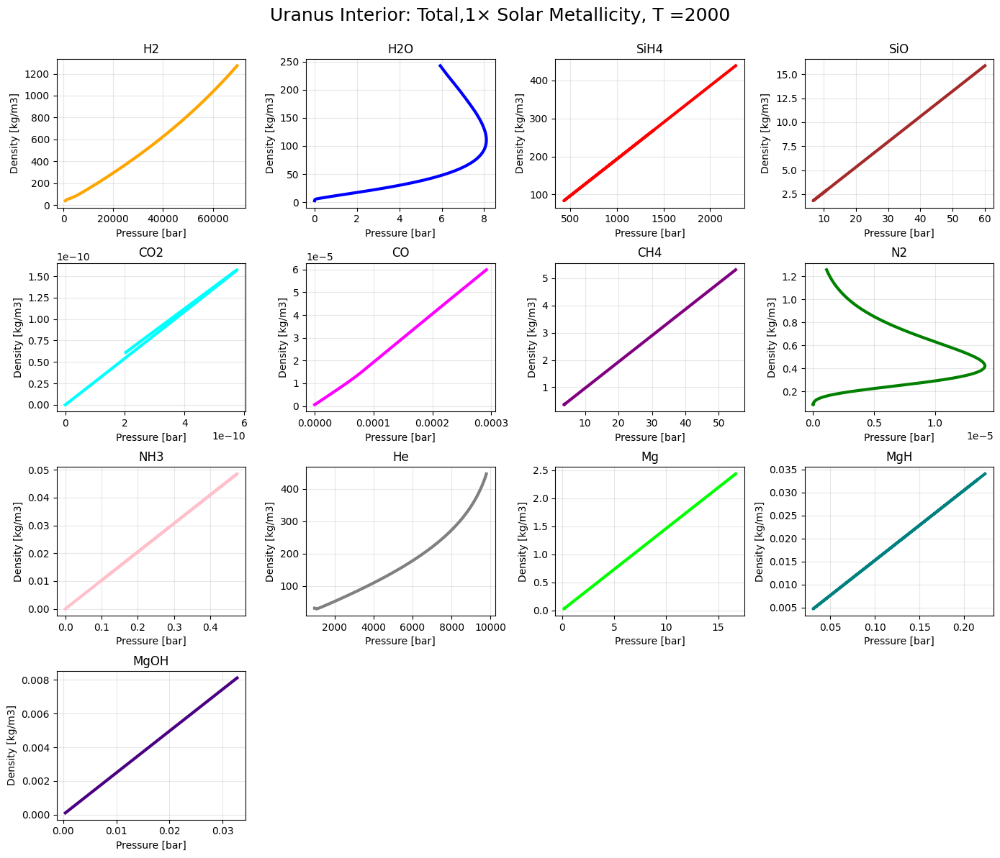

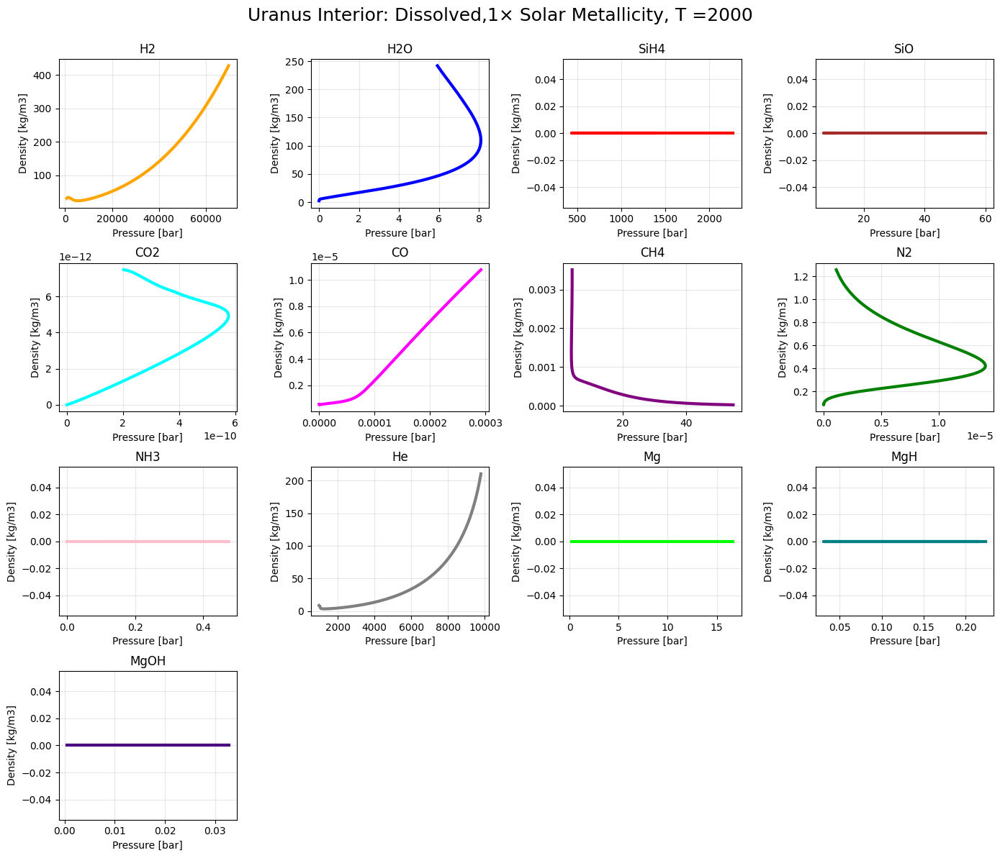

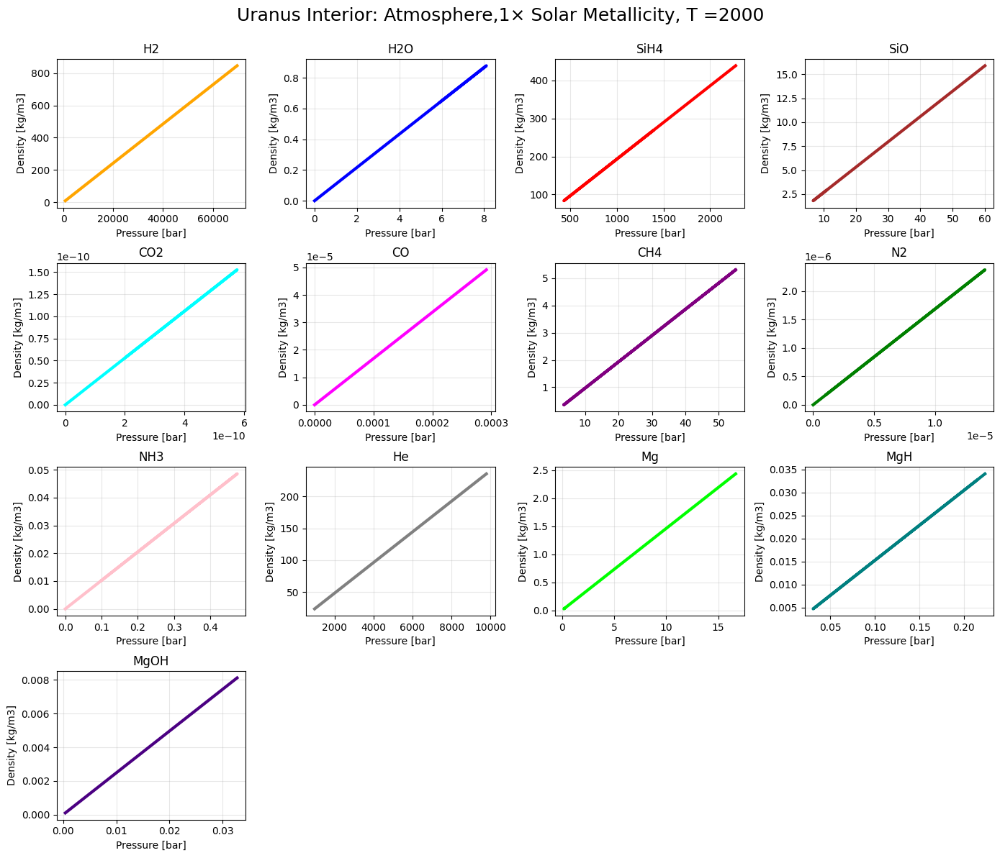

[19:48:53 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:48:53 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

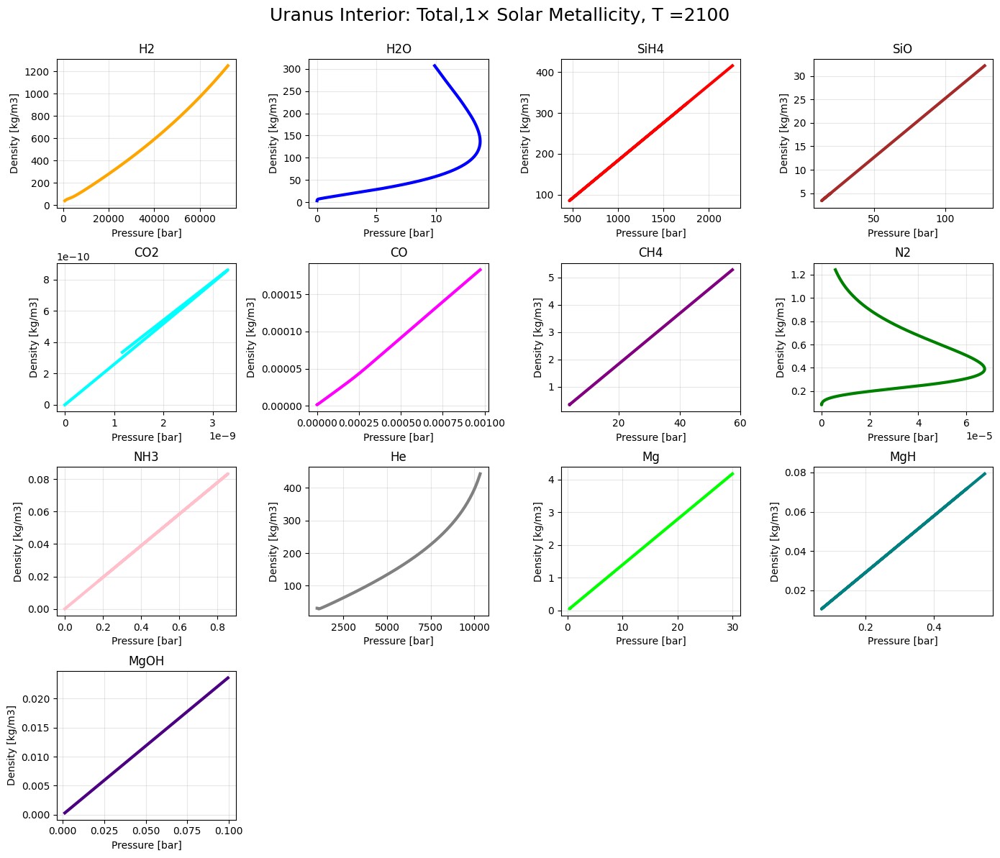

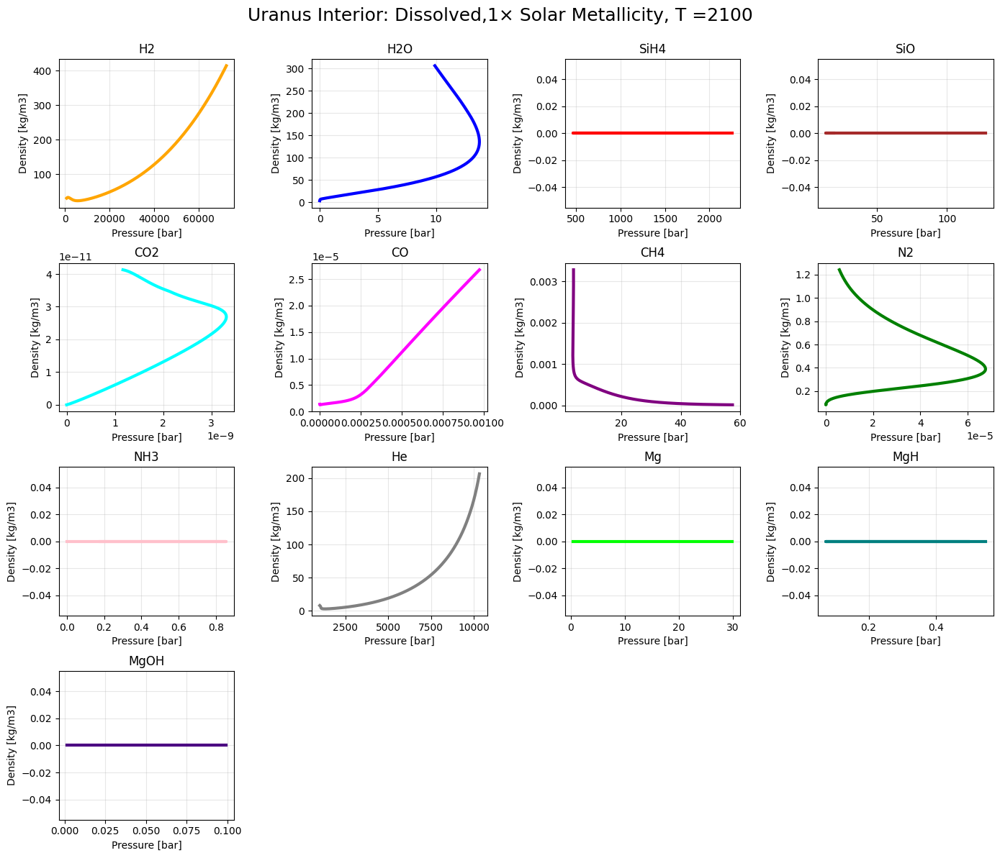

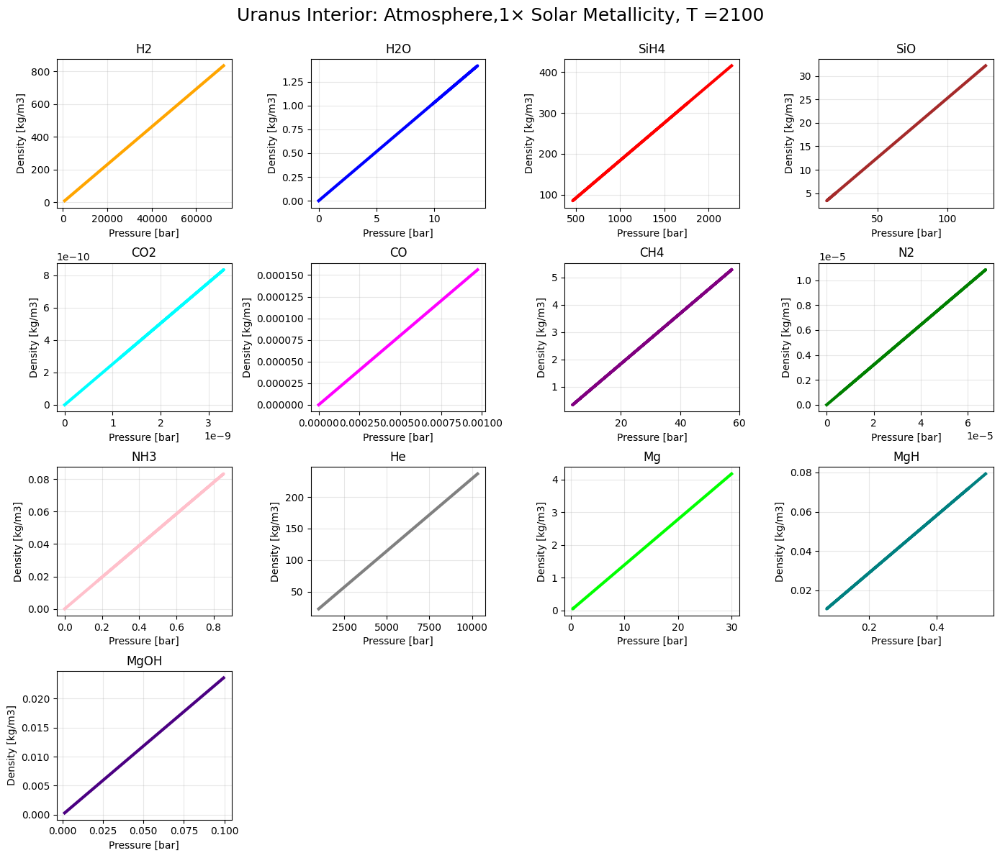

[19:52:24 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:52:24 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

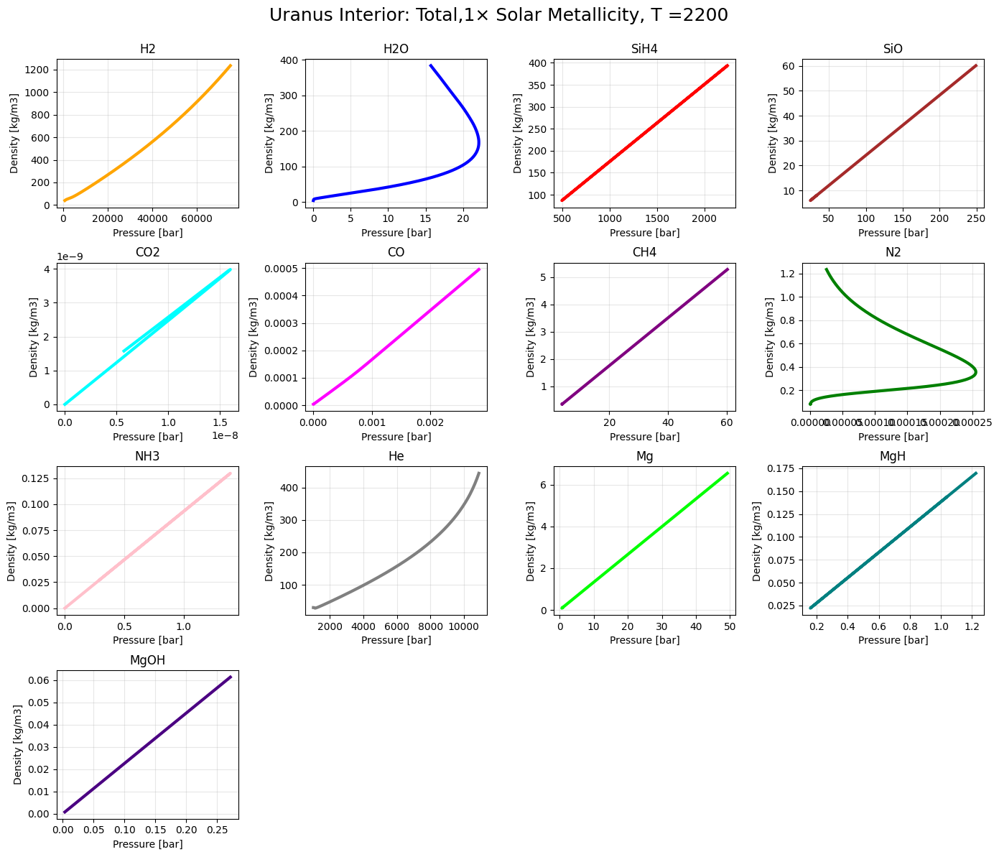

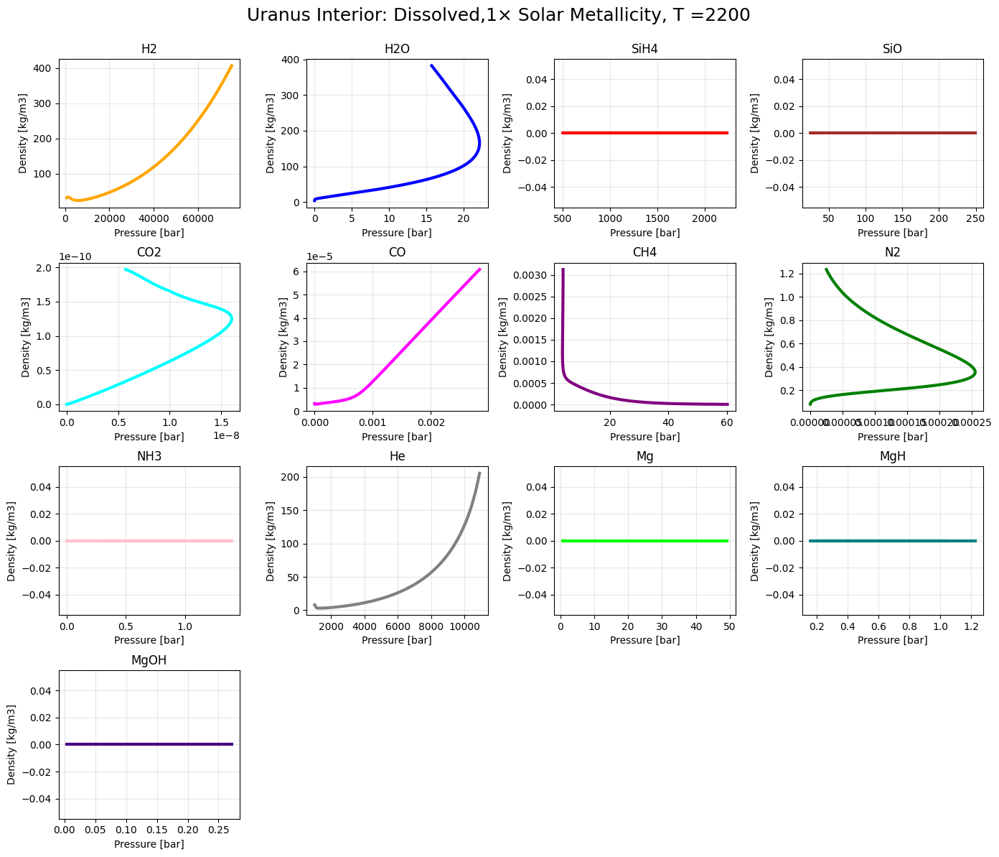

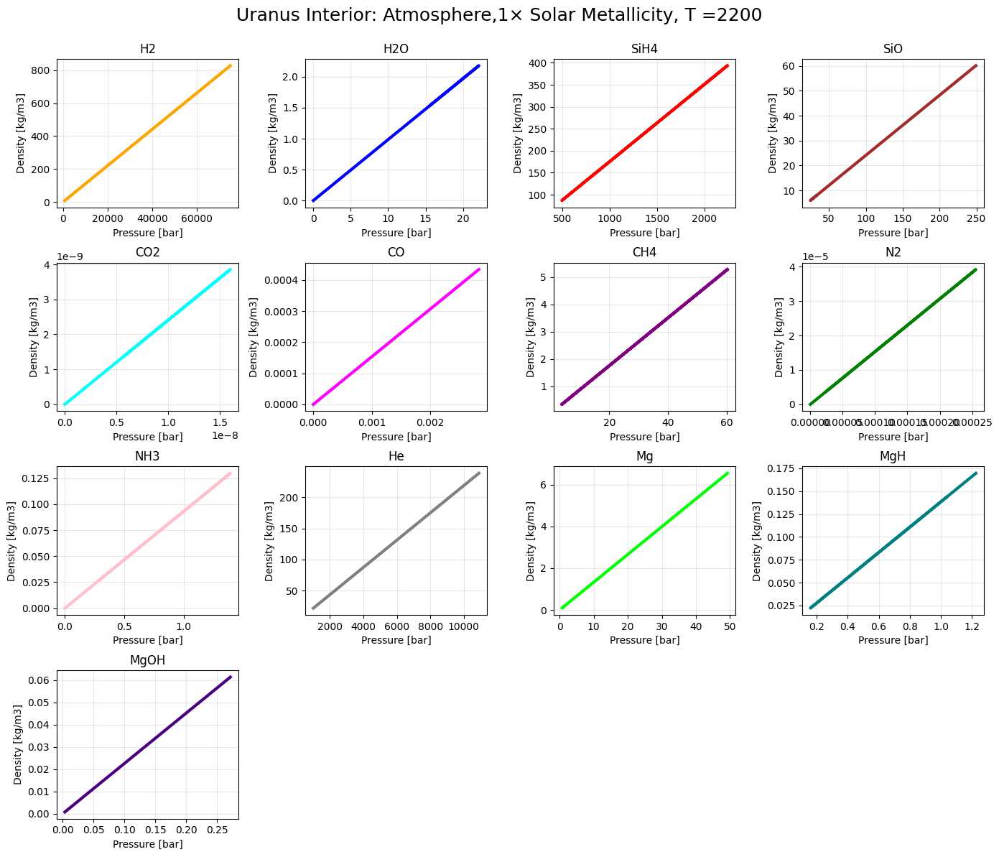

[19:53:39 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:53:39 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

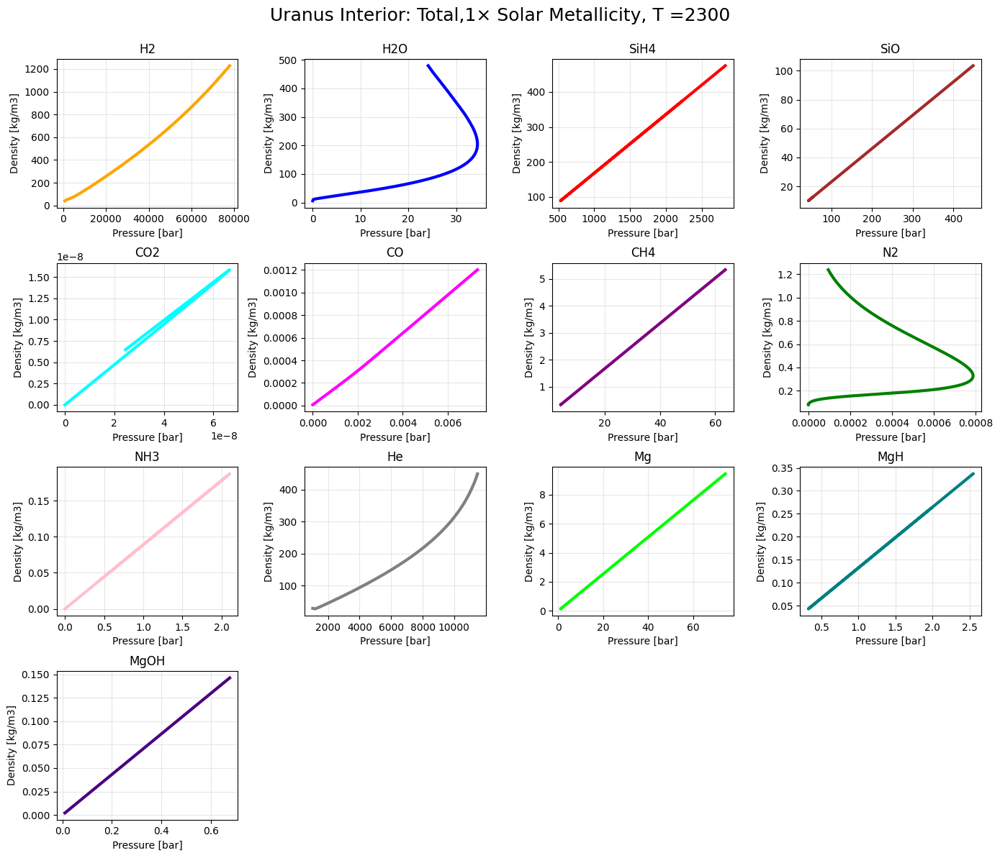

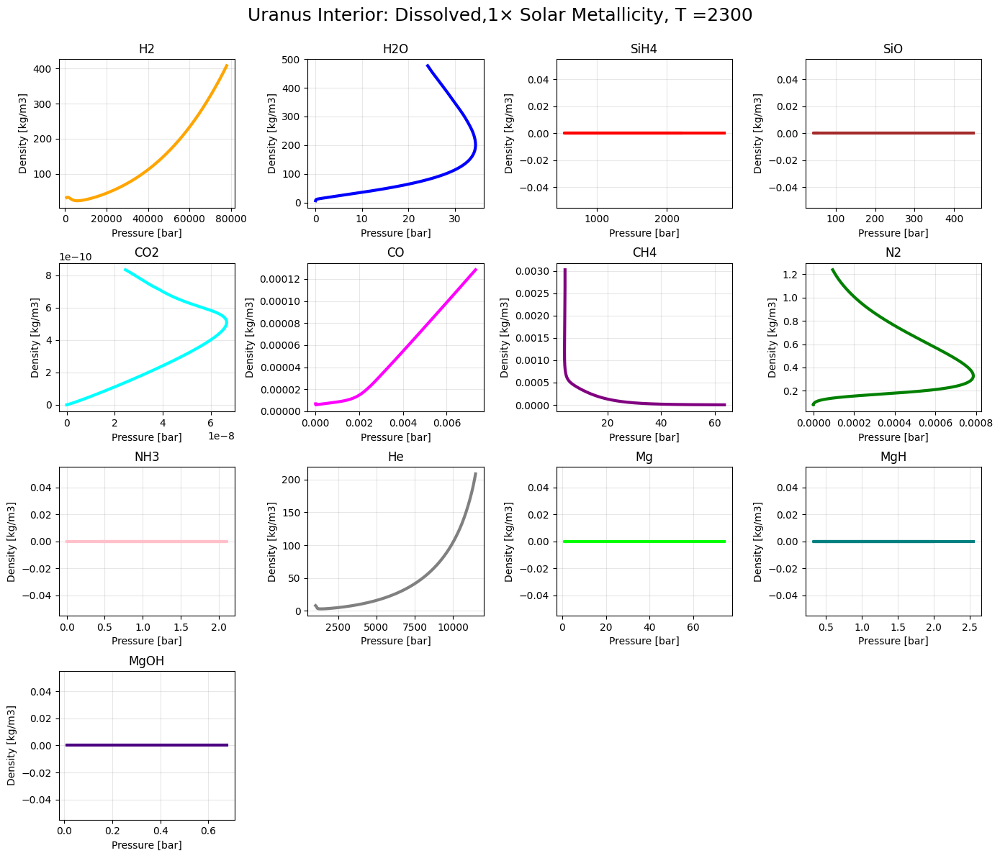

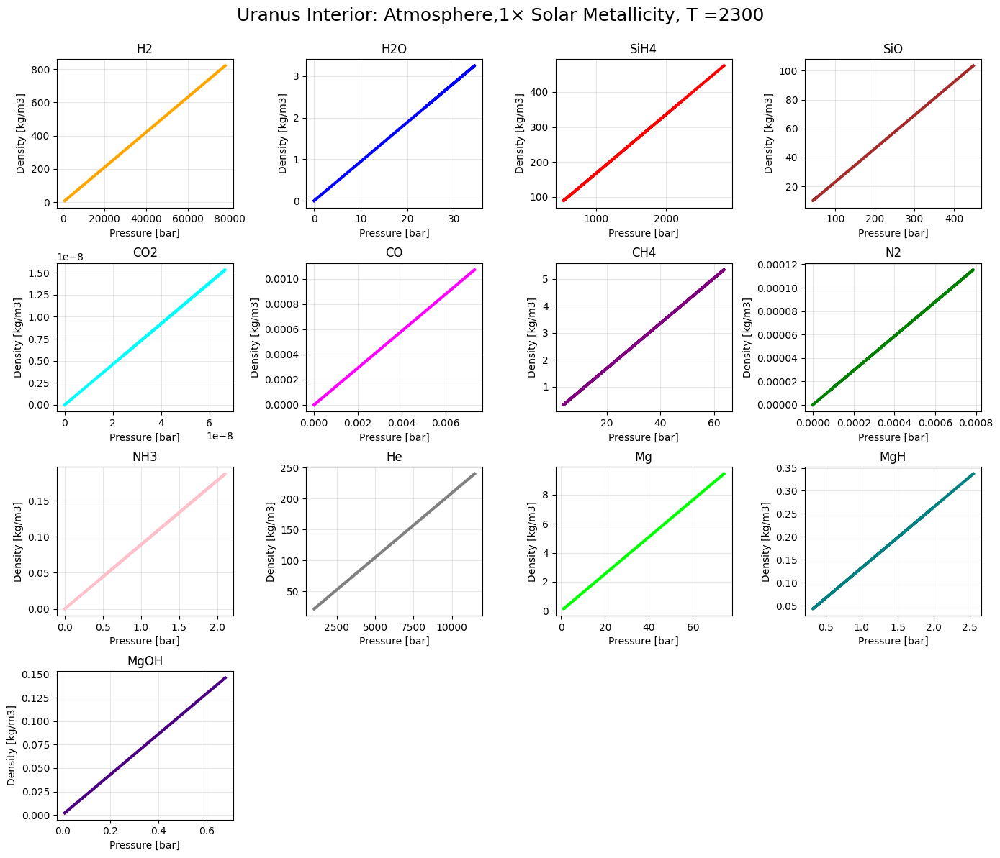

[19:54:50 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:54:50 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

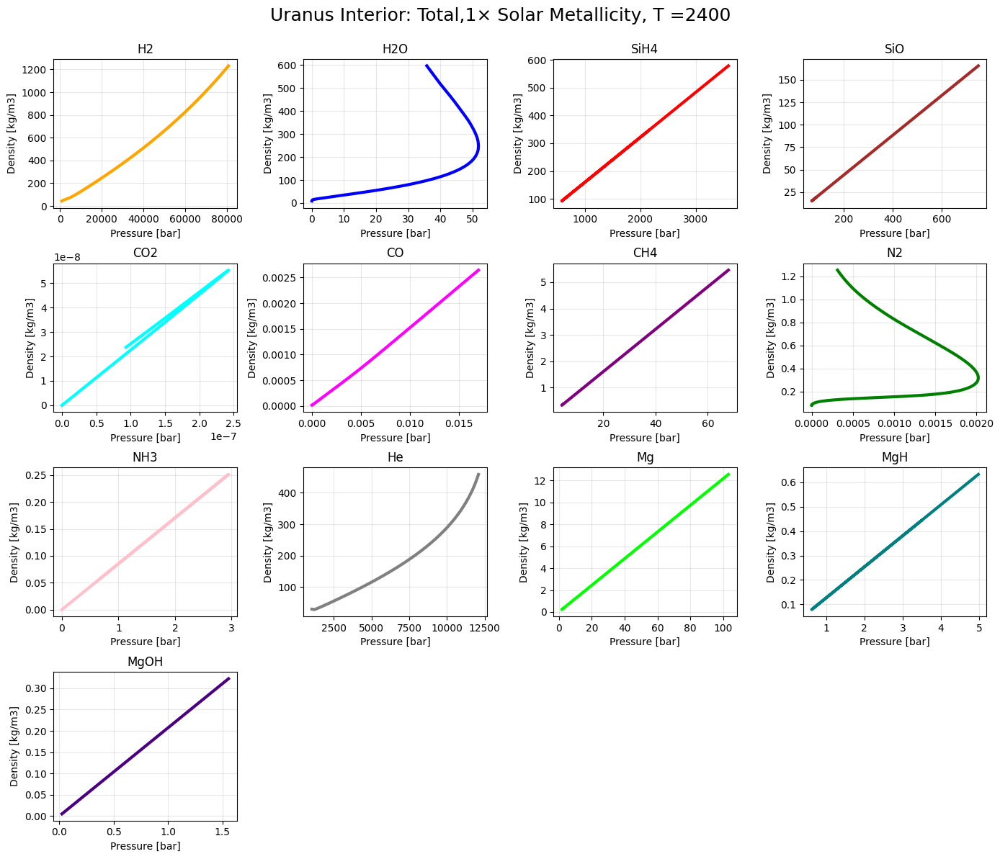

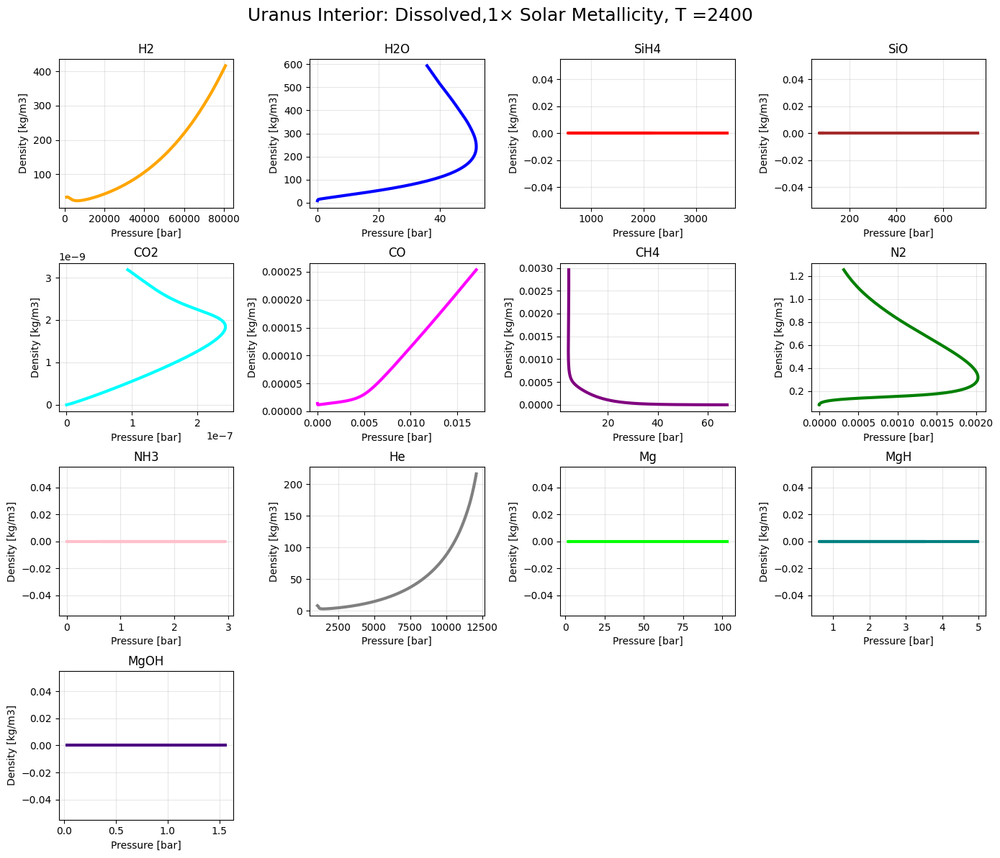

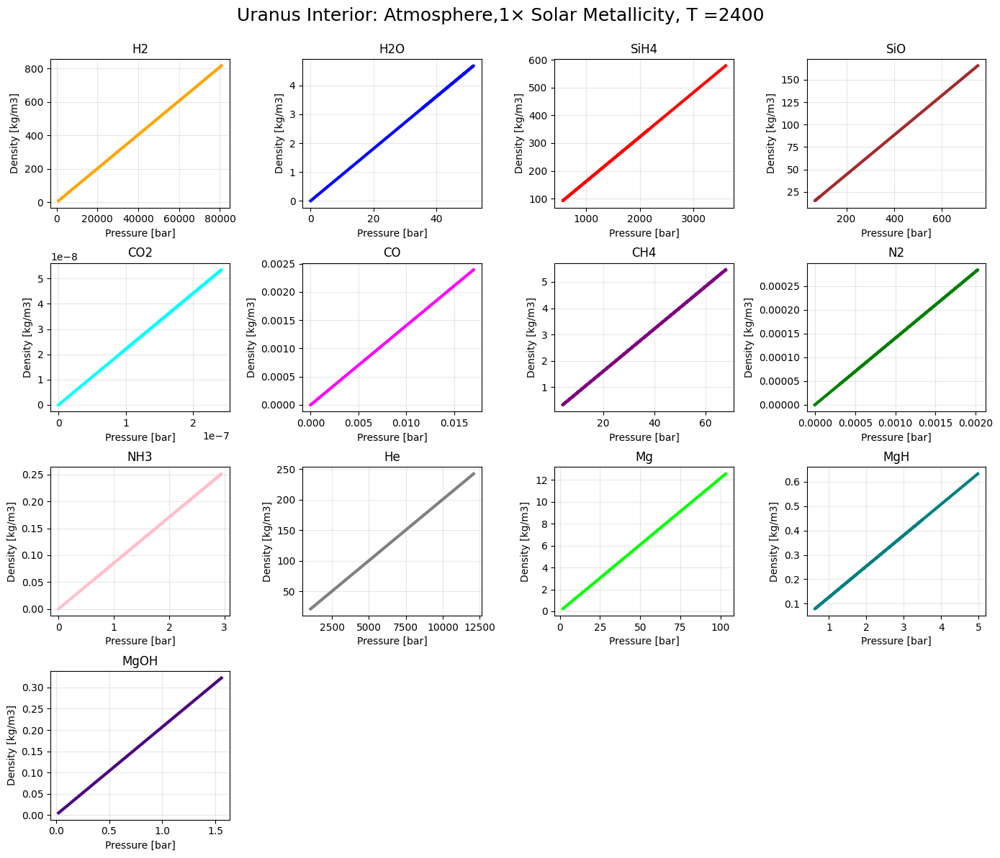

[19:56:01 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:56:01 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

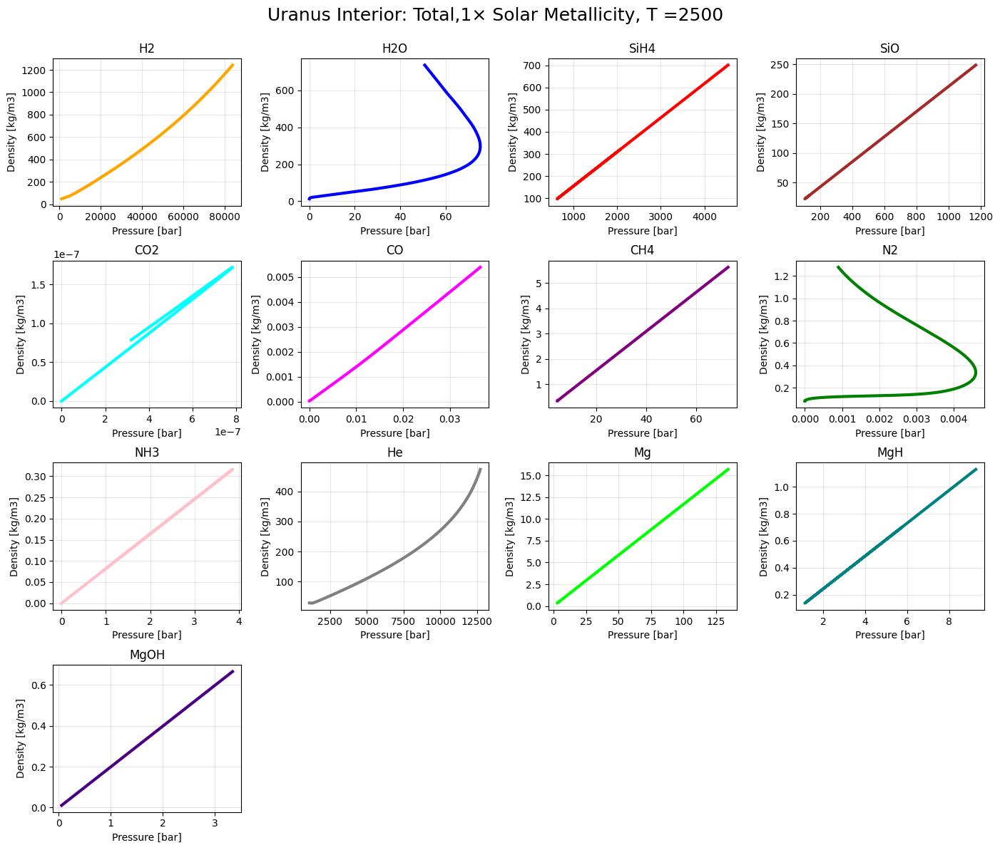

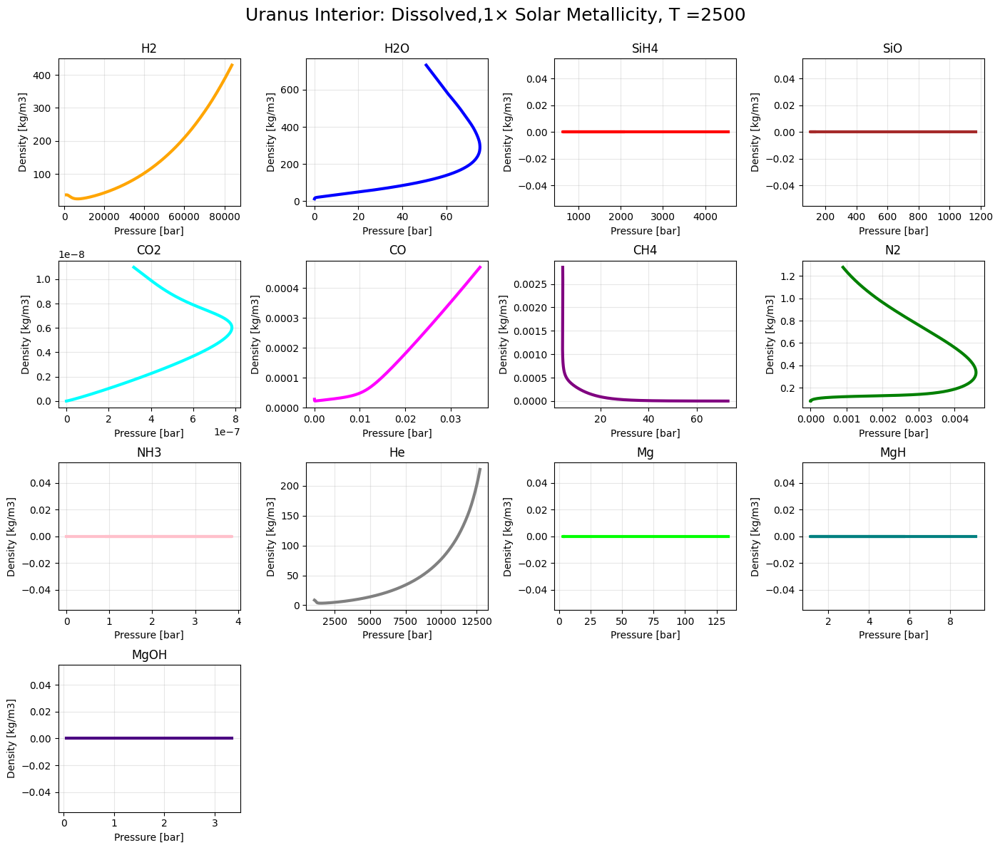

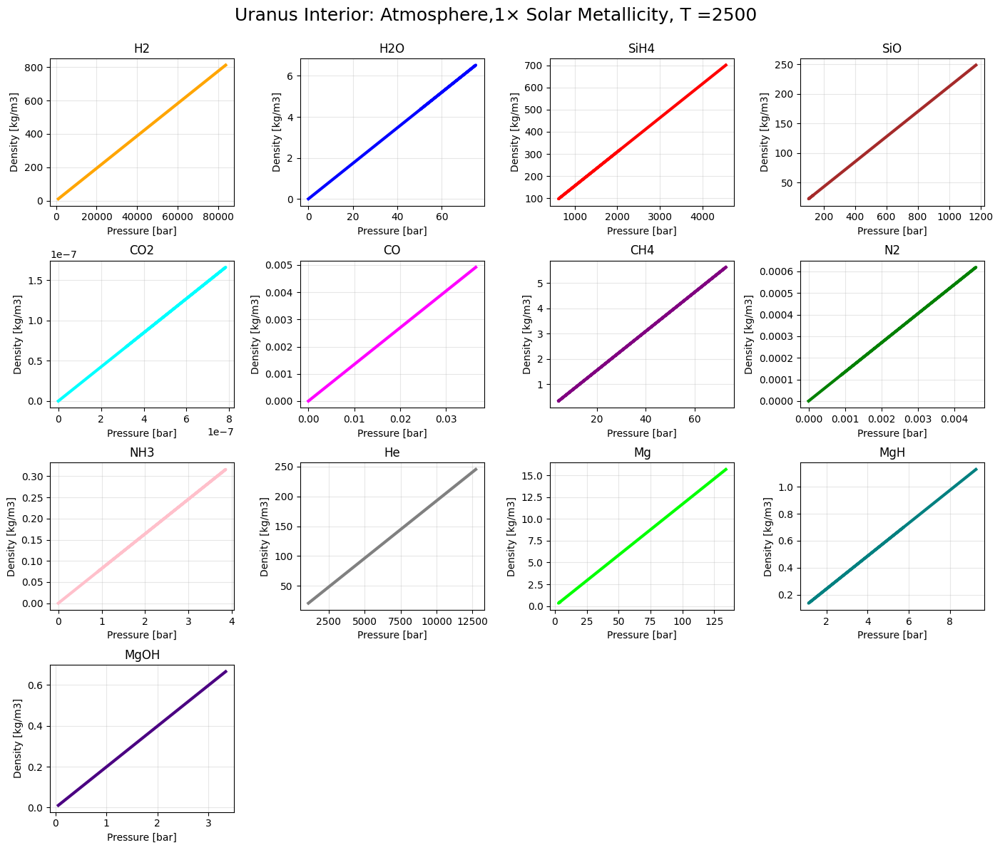

[19:57:15 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:57:15 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

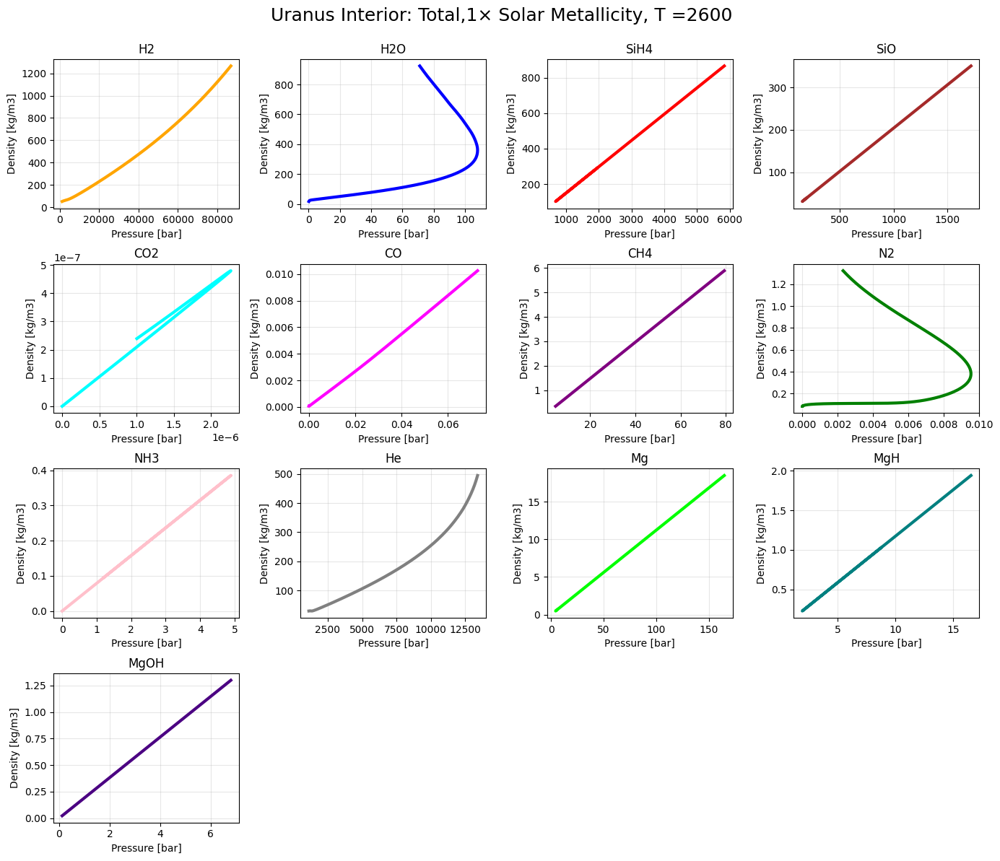

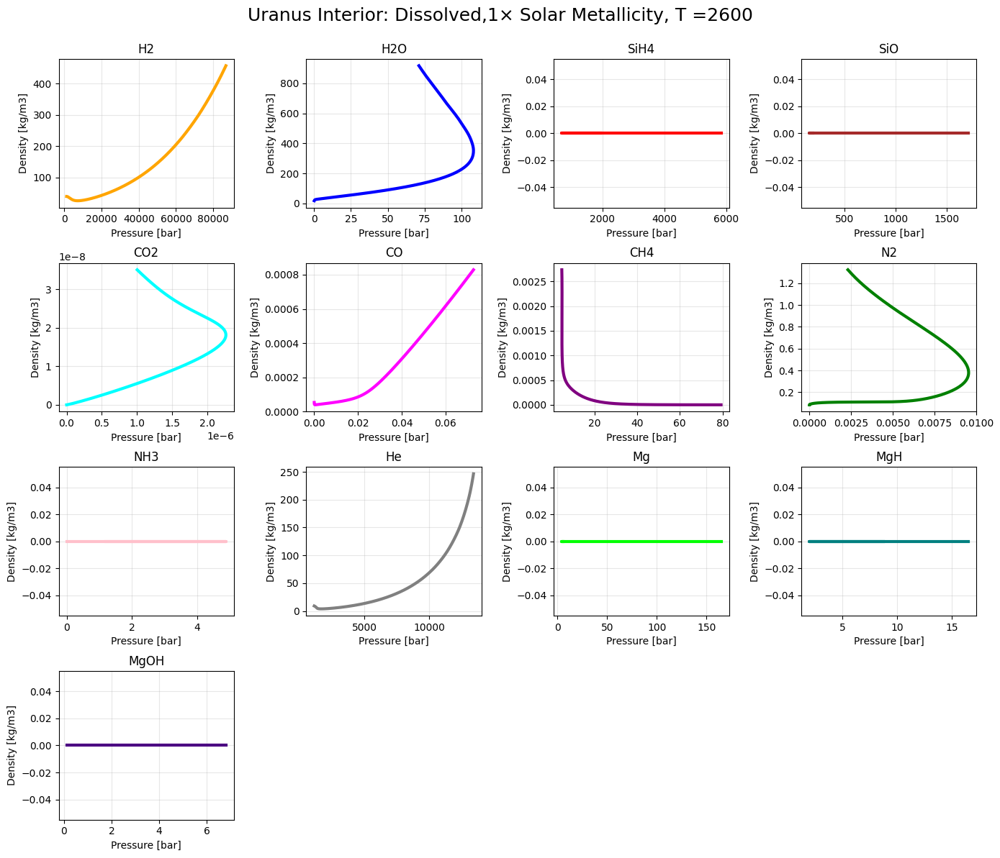

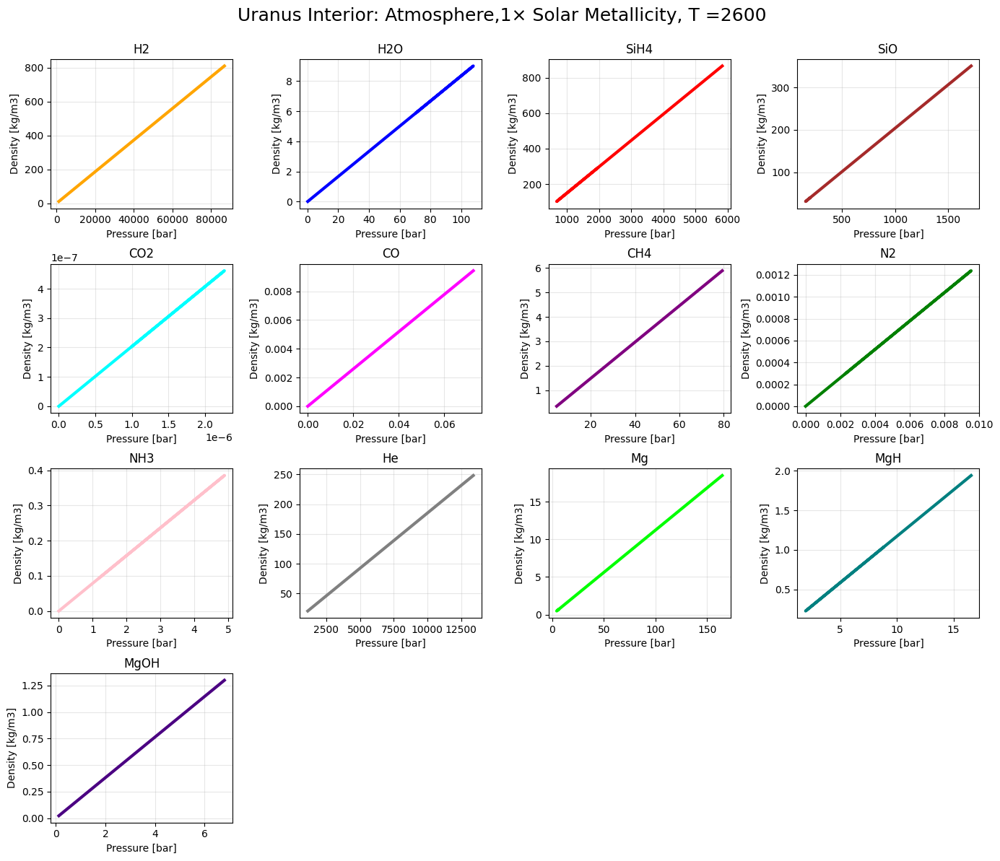

[19:58:05 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:58:05 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

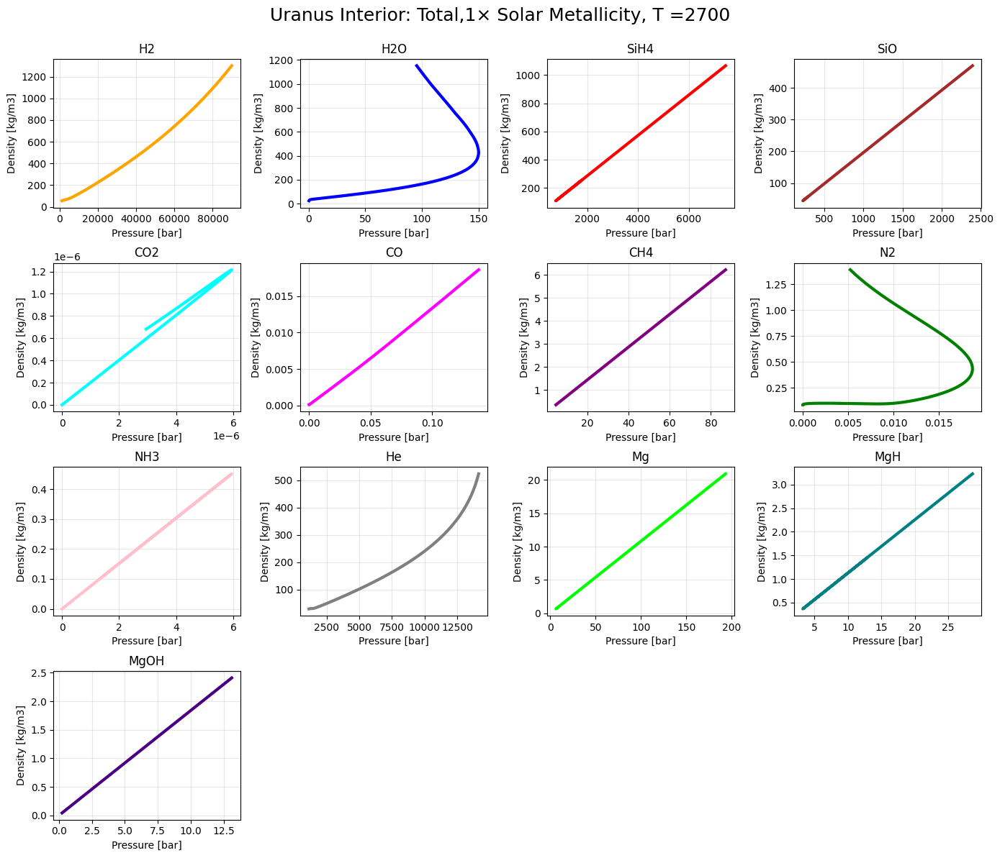

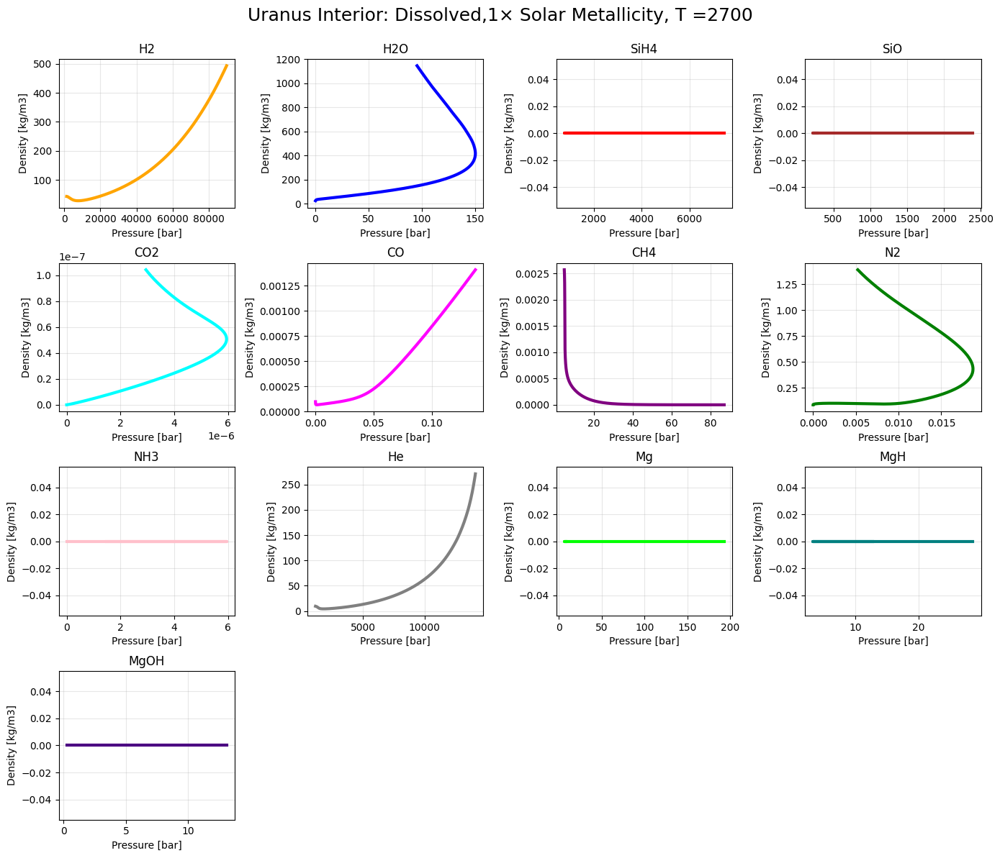

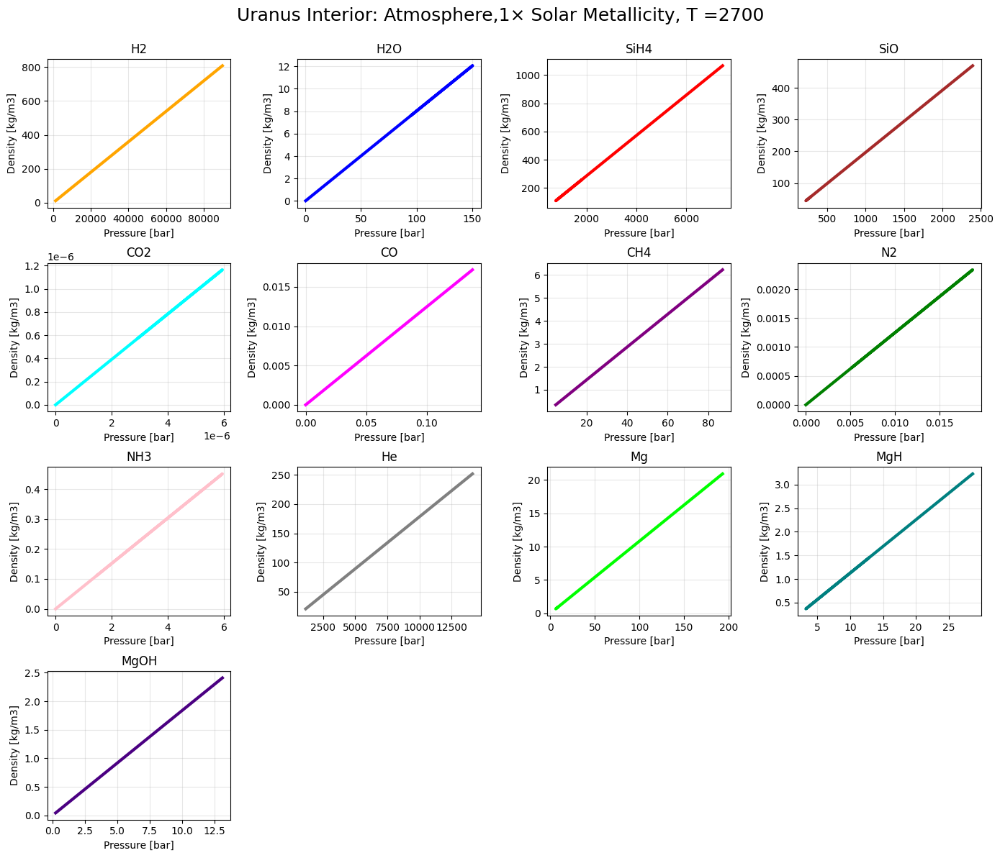

[19:58:54 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:58:54 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

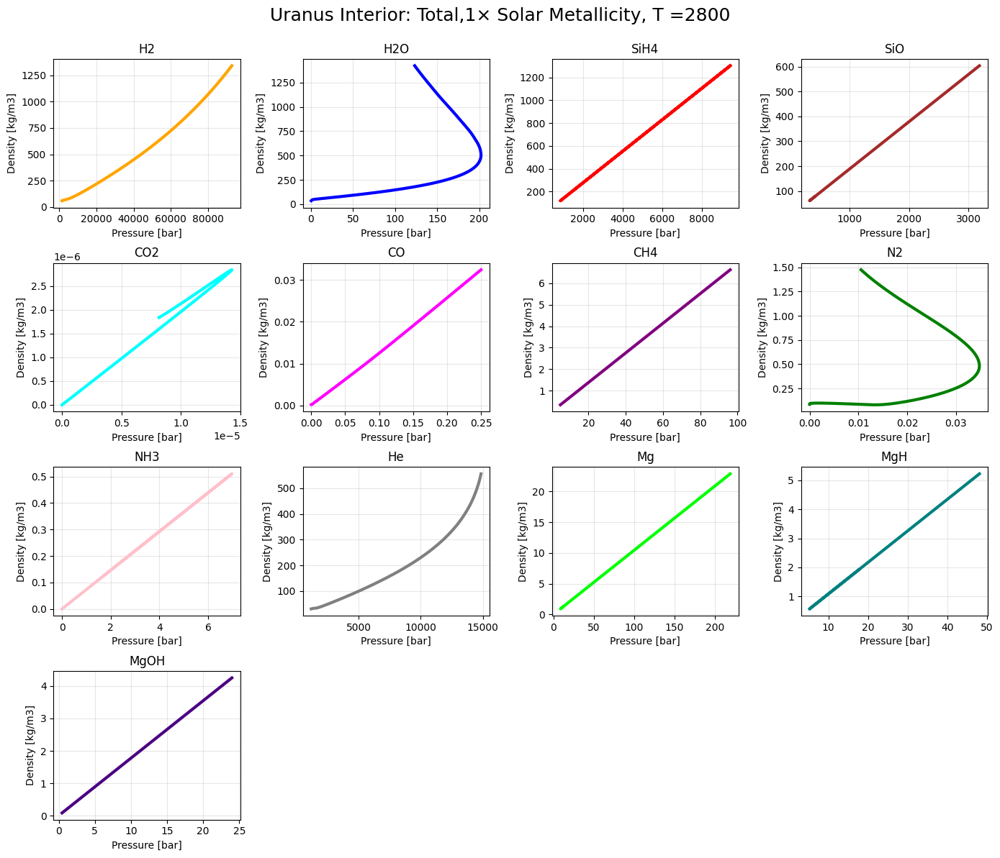

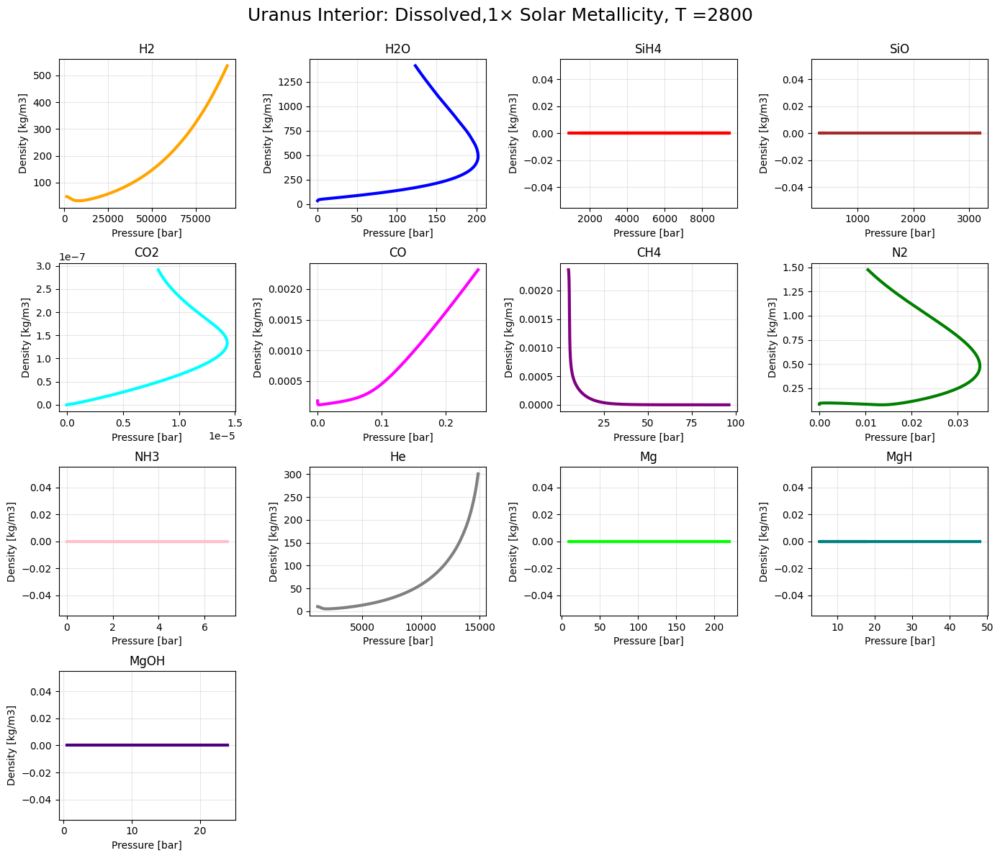

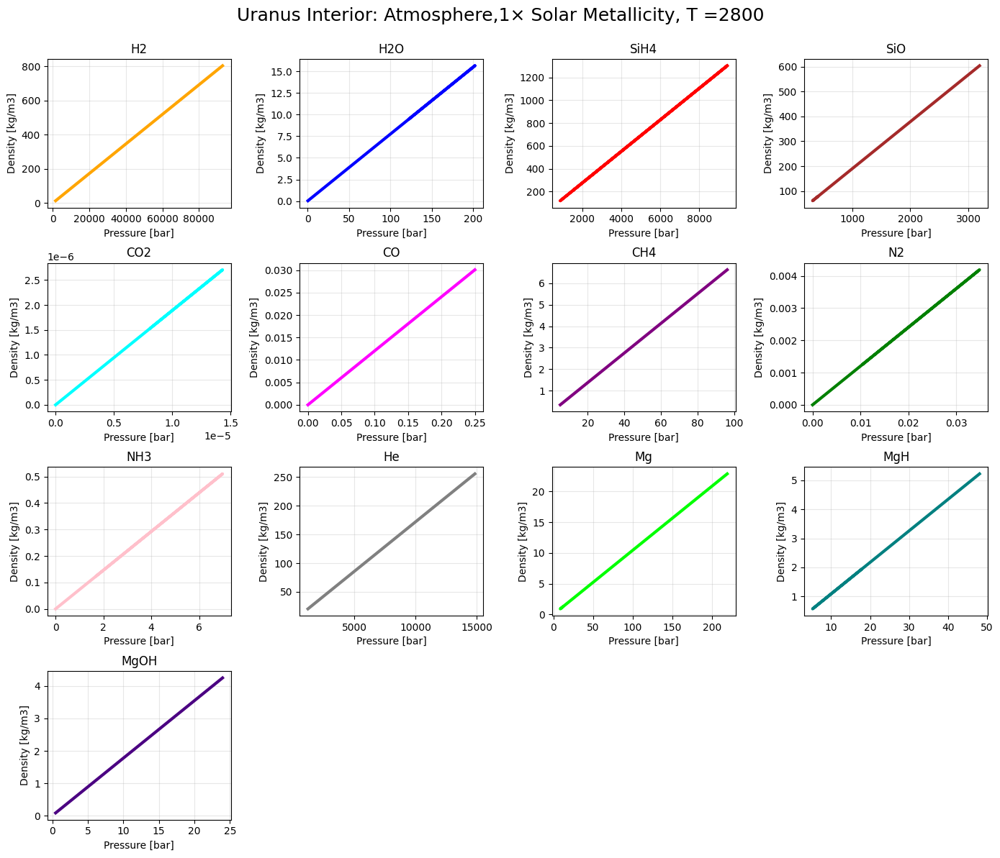

[19:59:43 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[19:59:43 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

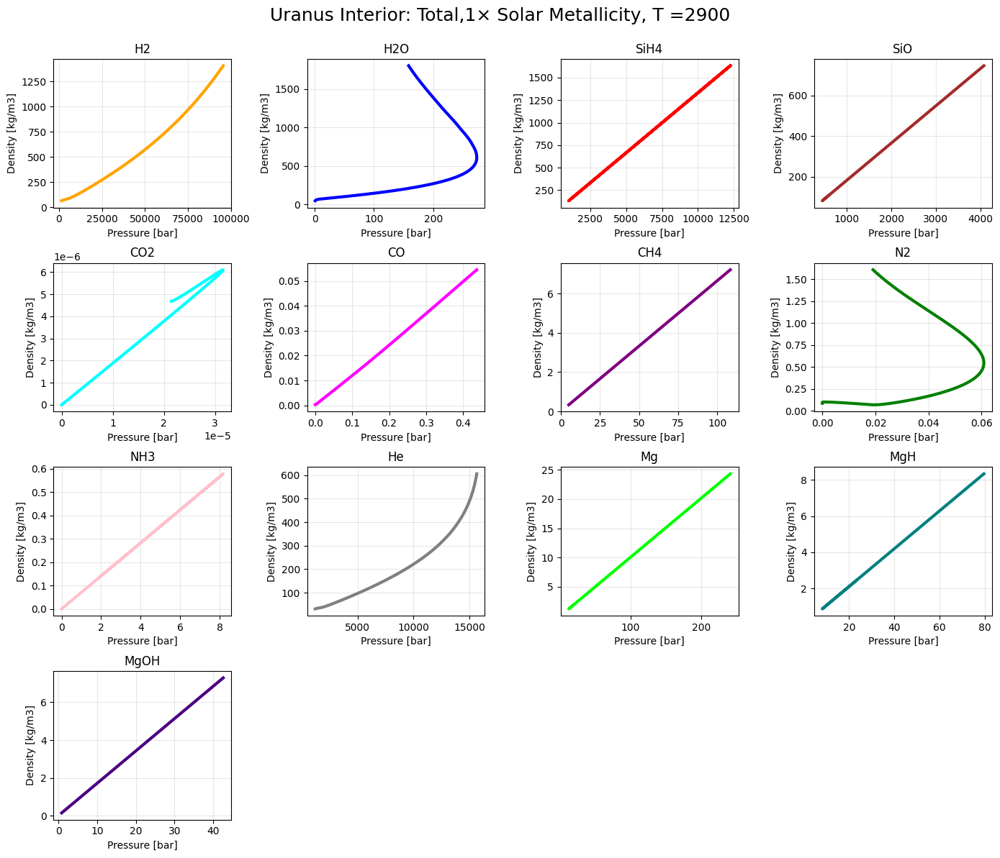

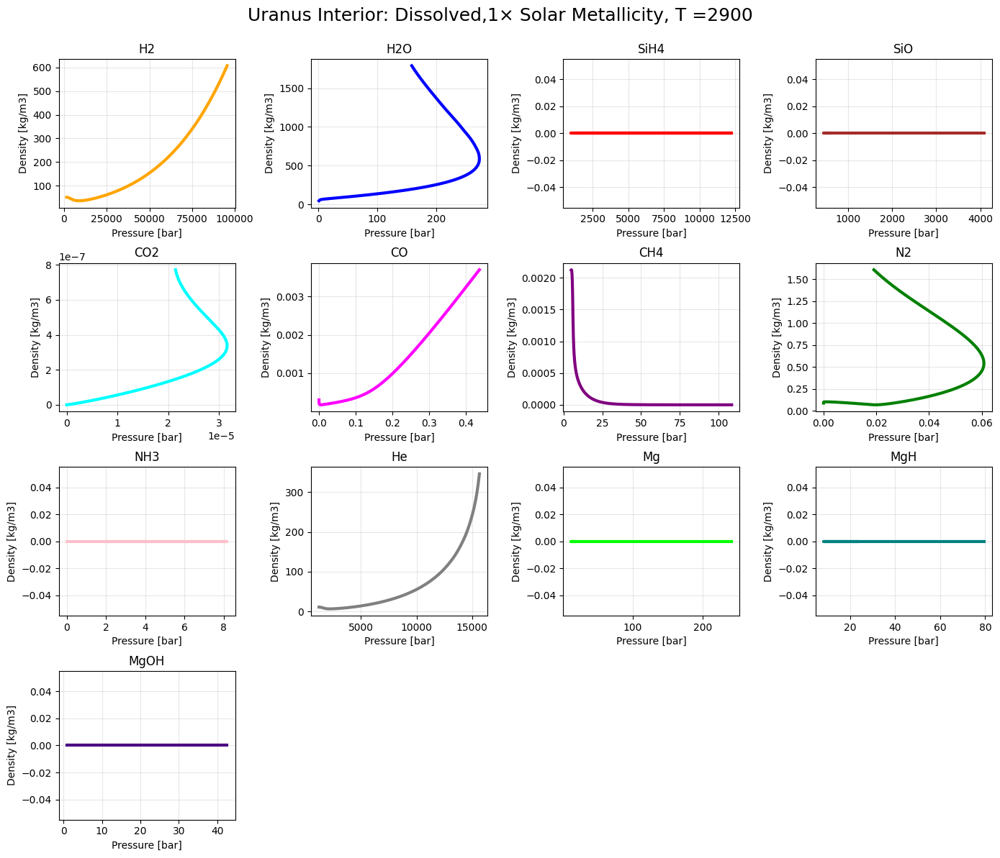

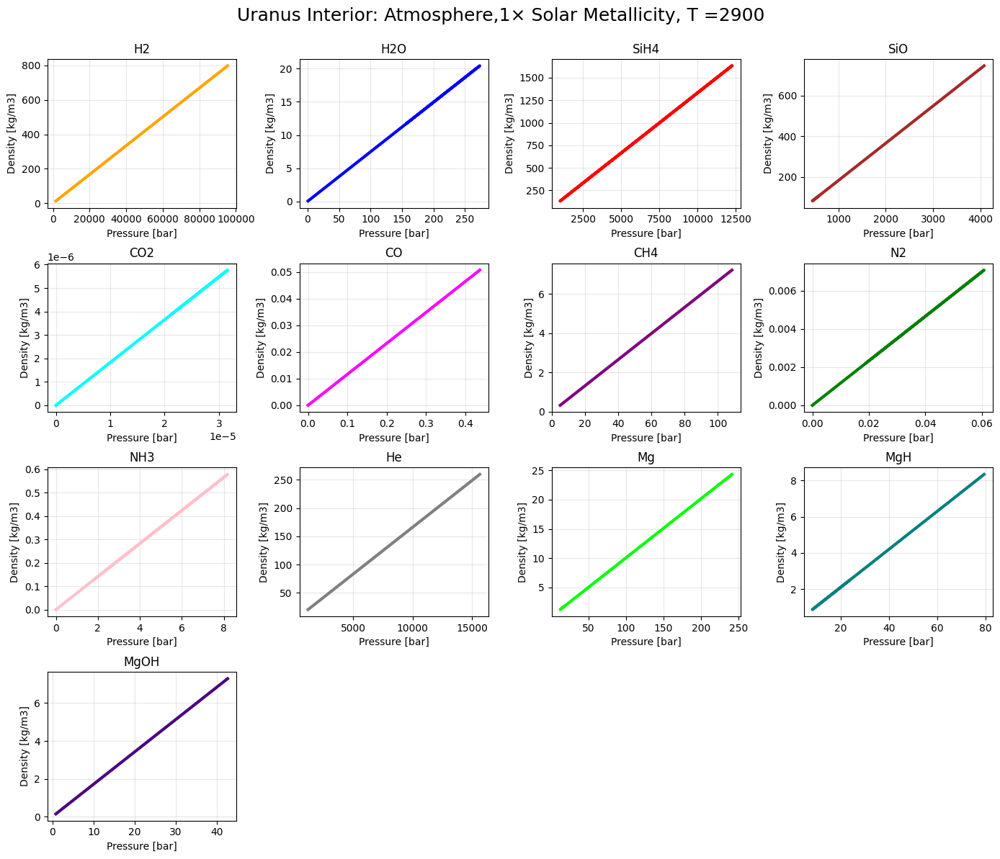

[20:00:34 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:00:34 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

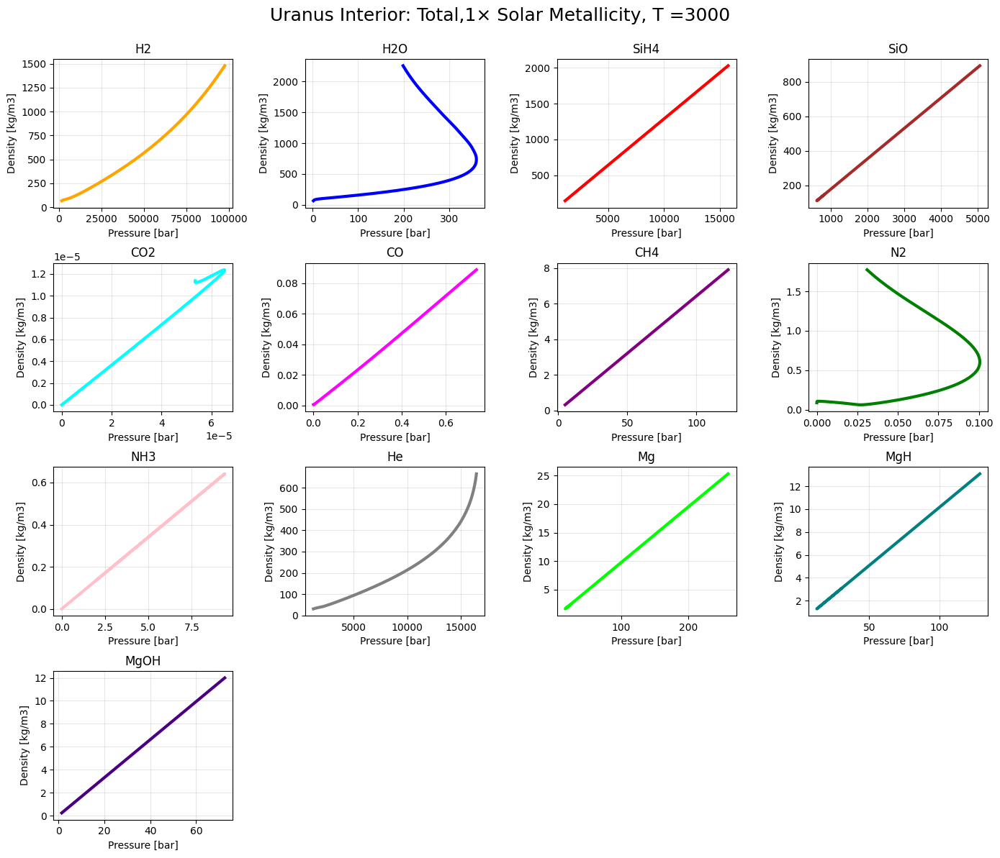

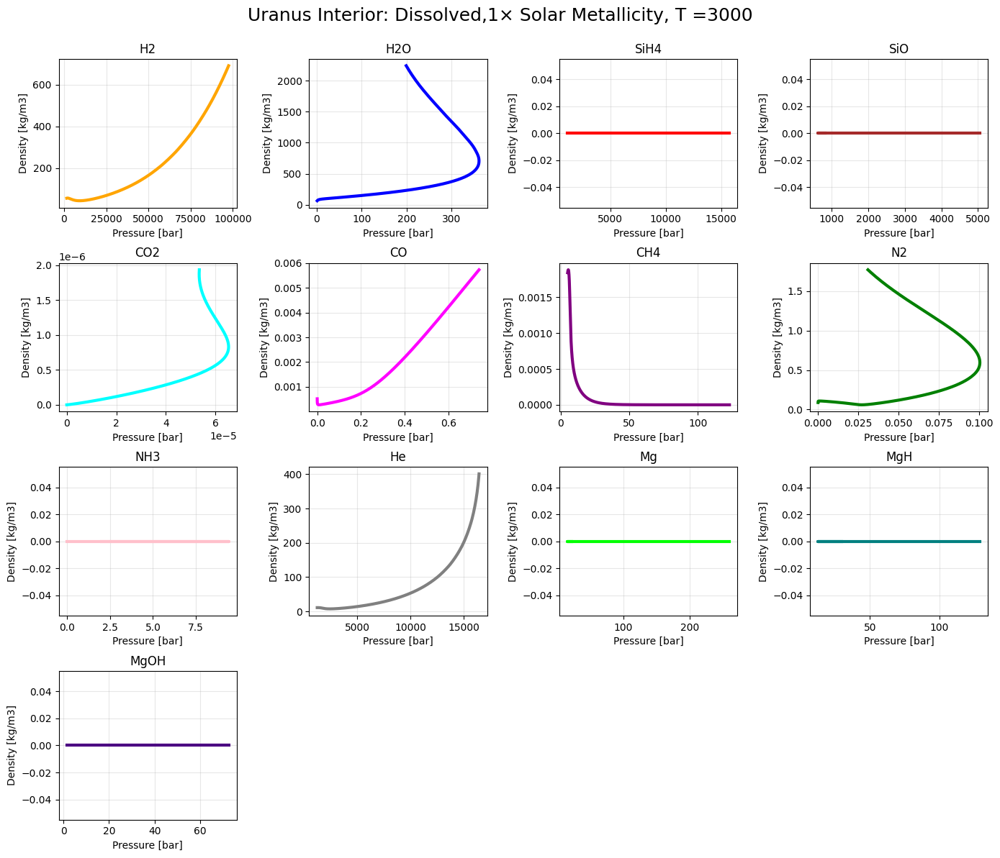

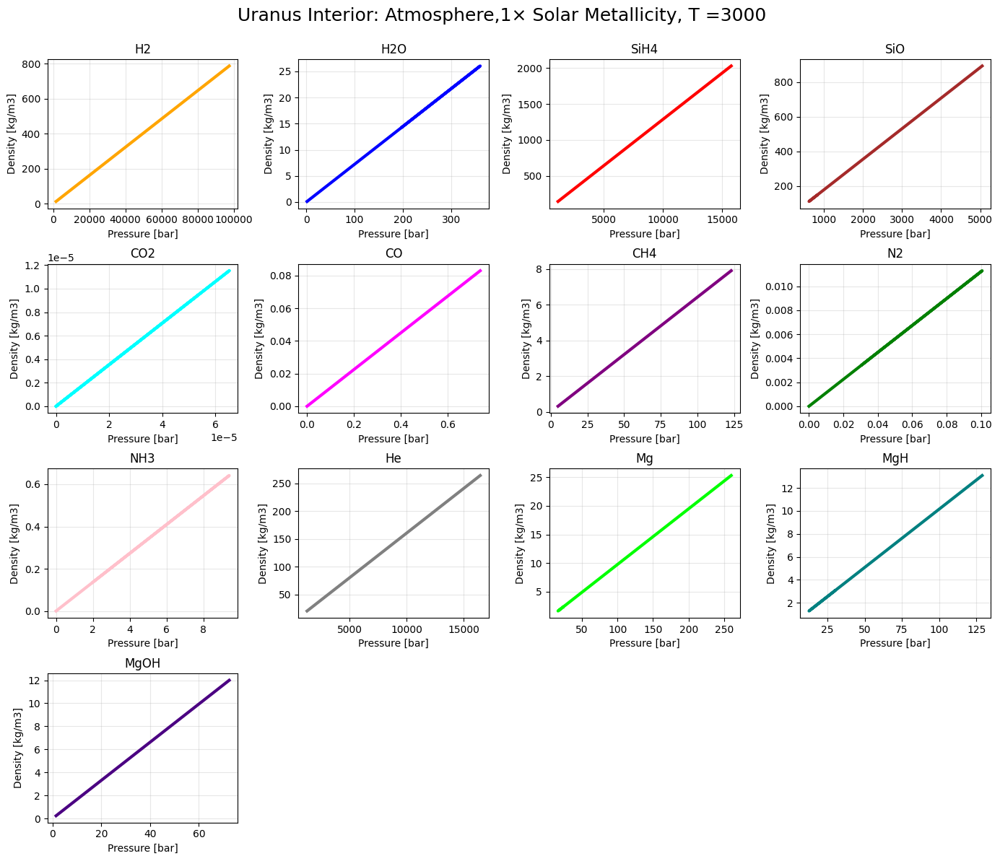

[20:01:25 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:01:25 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

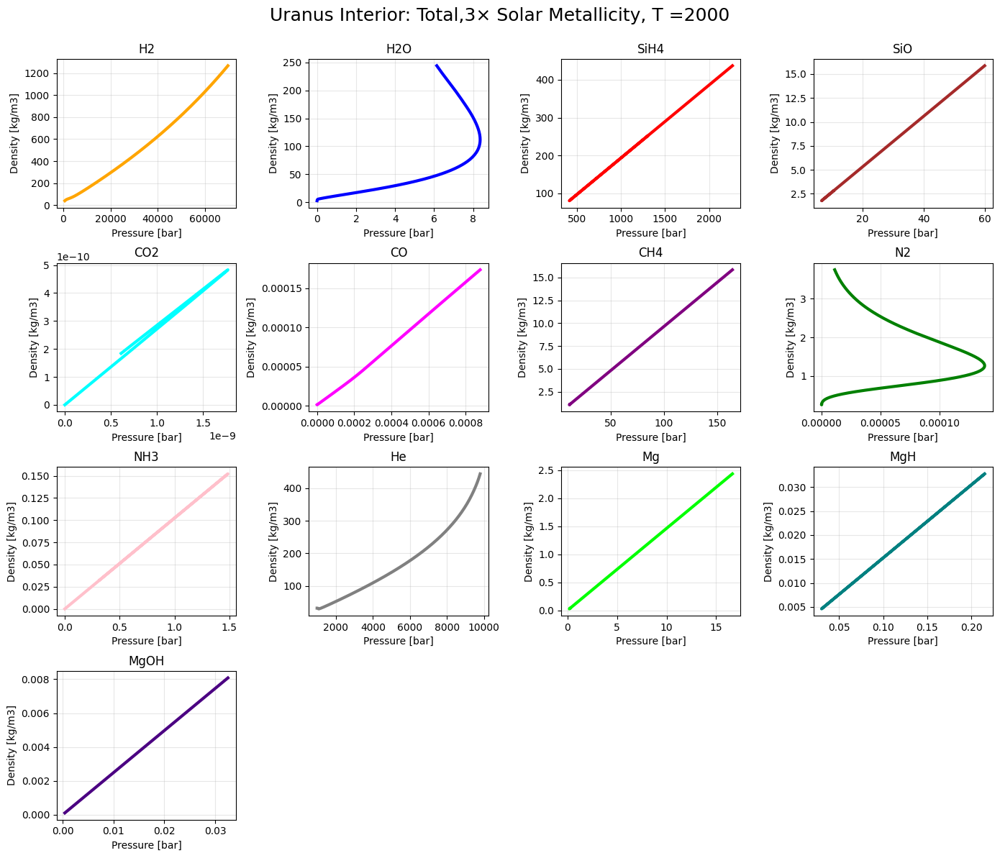

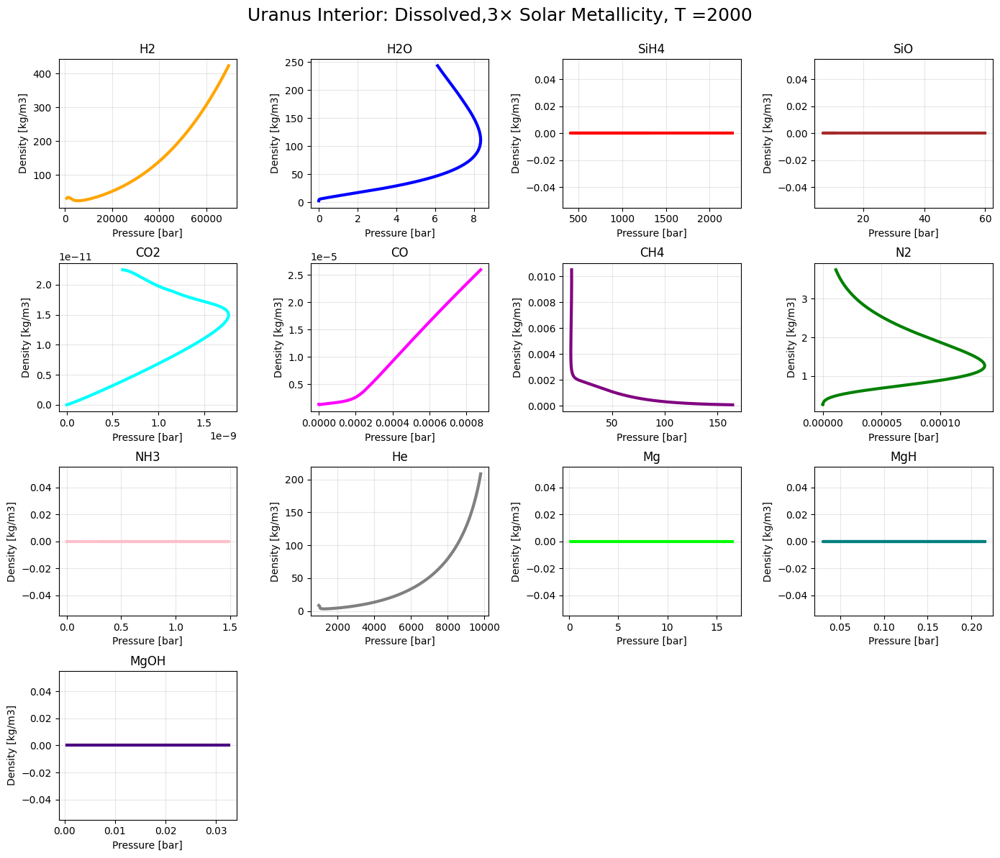

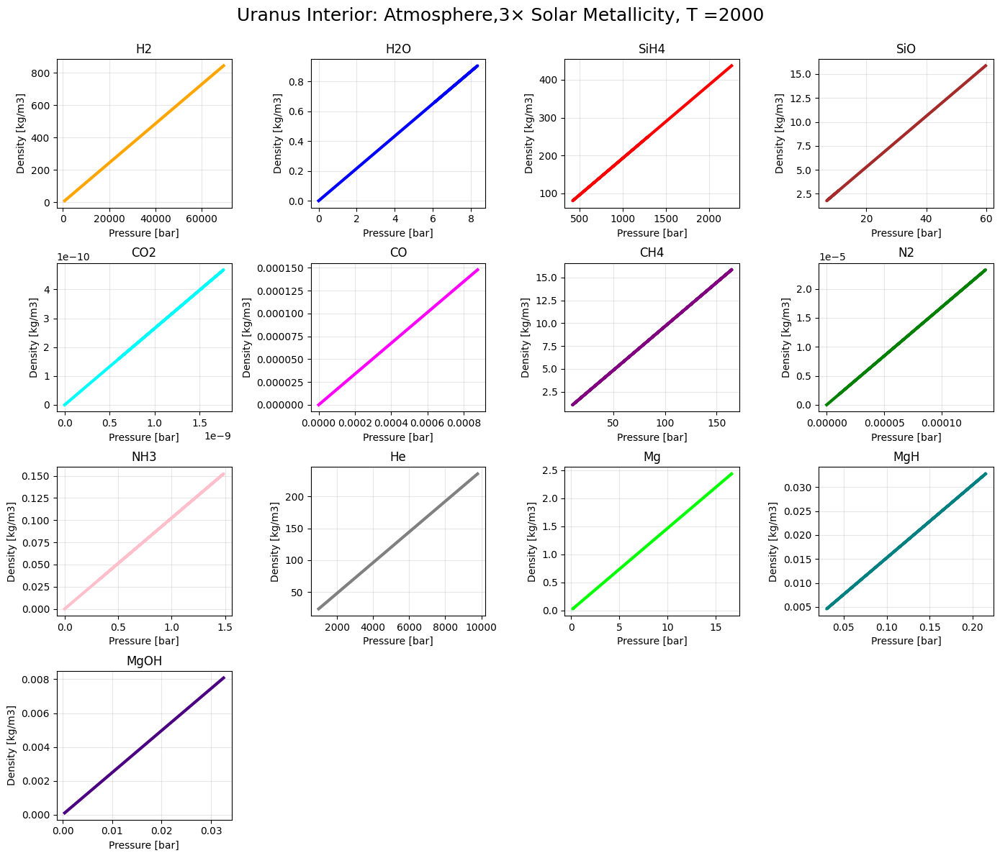

[20:02:39 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:02:39 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

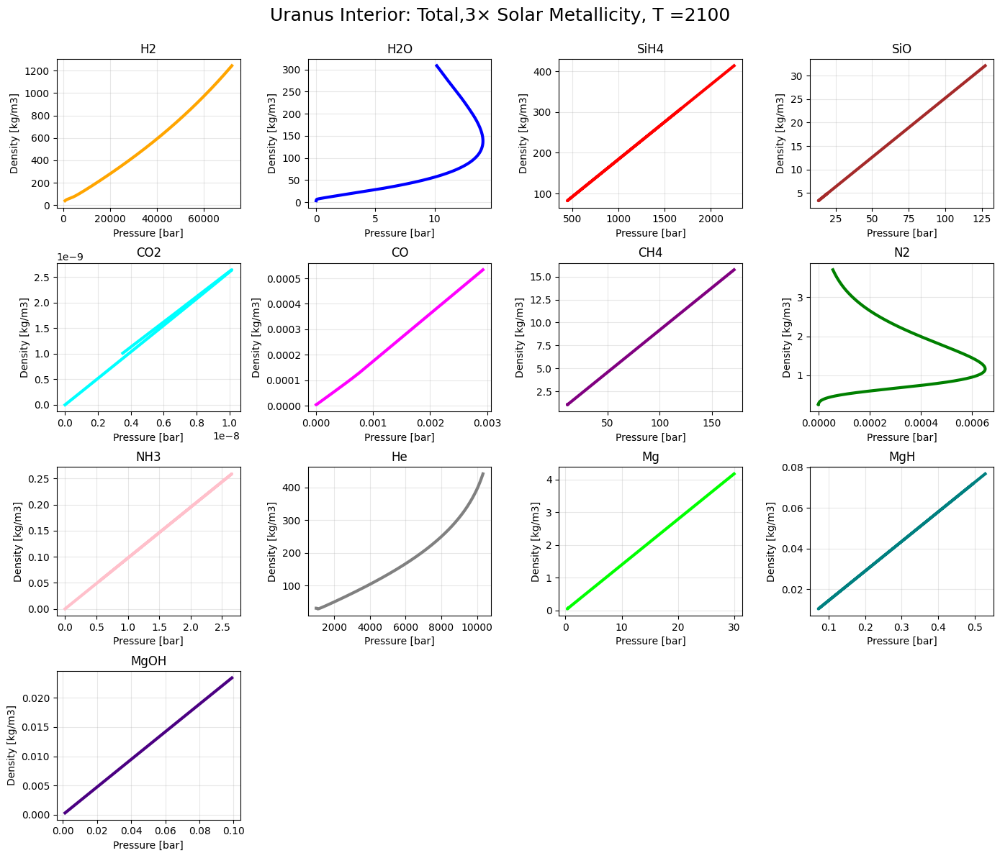

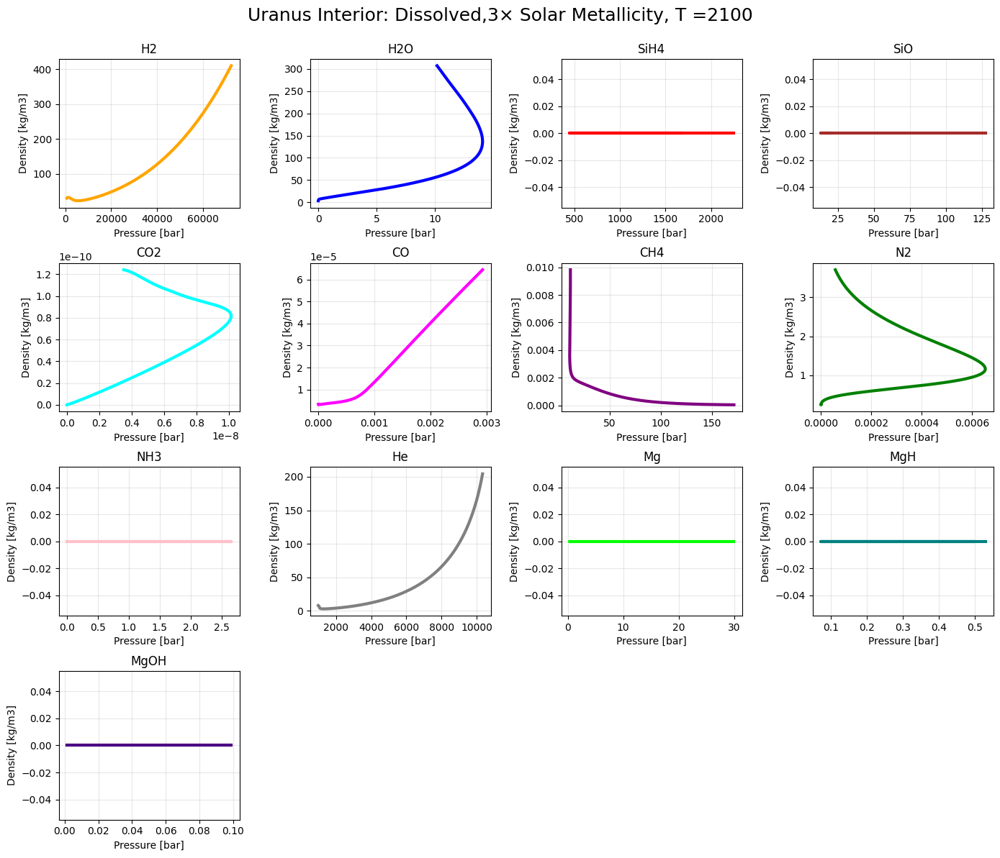

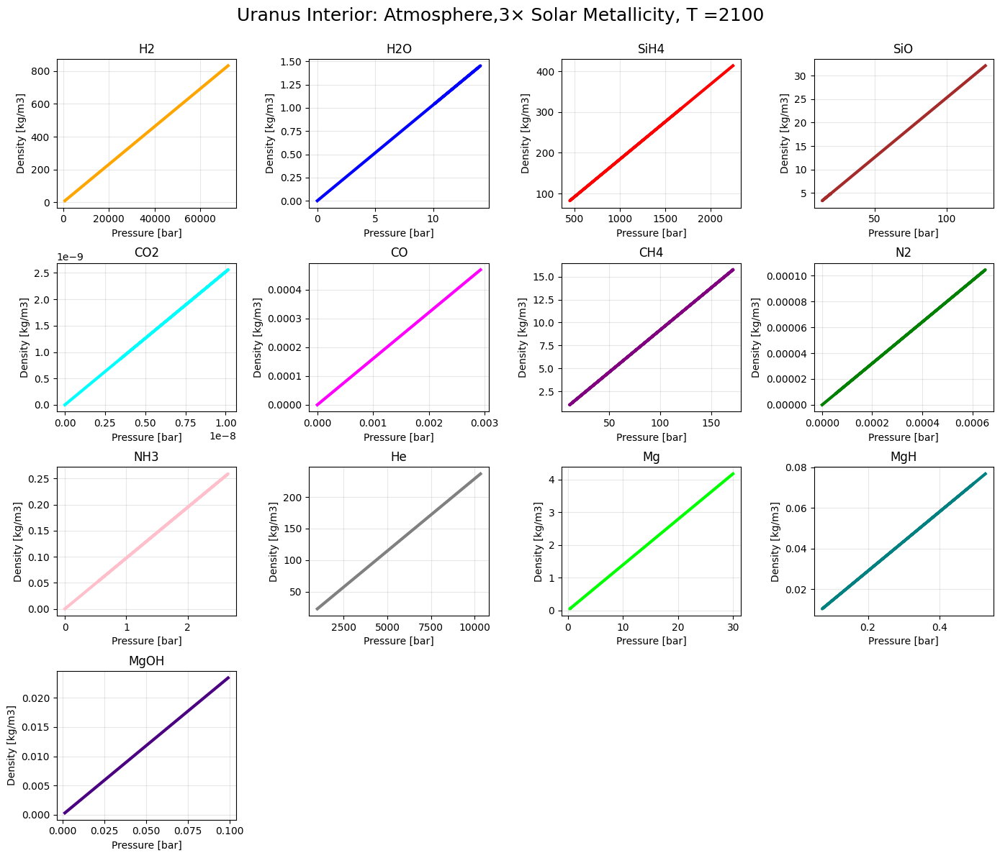

[20:03:50 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:03:50 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

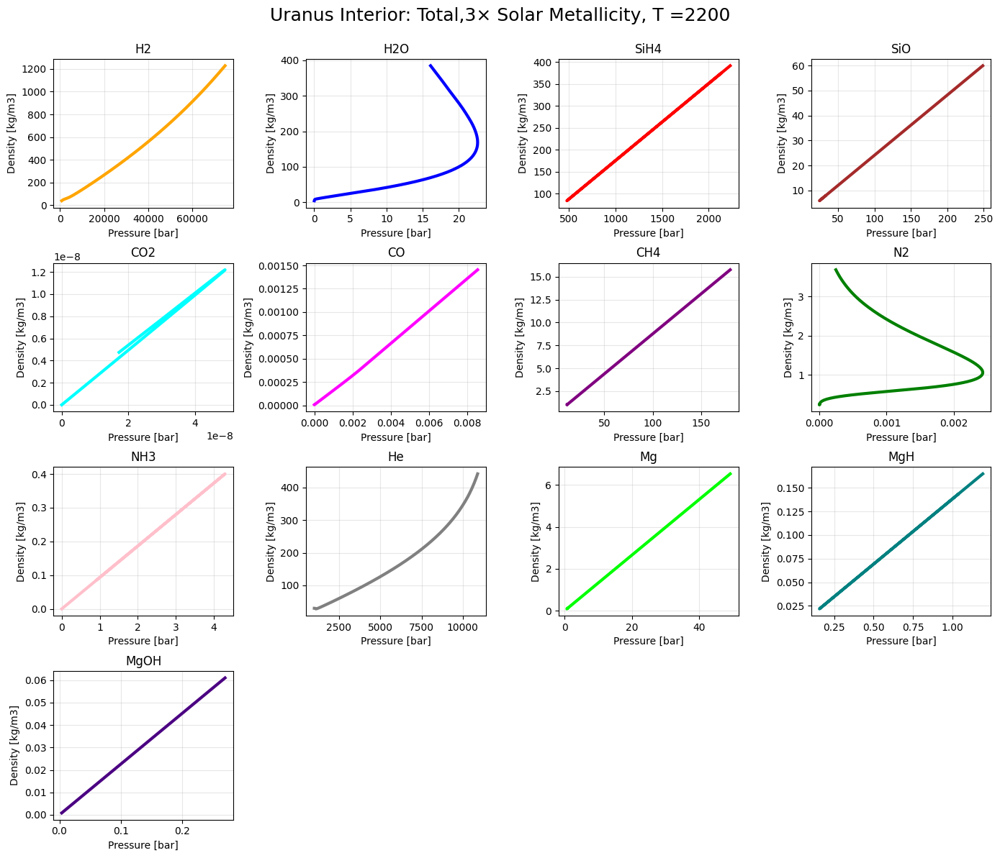

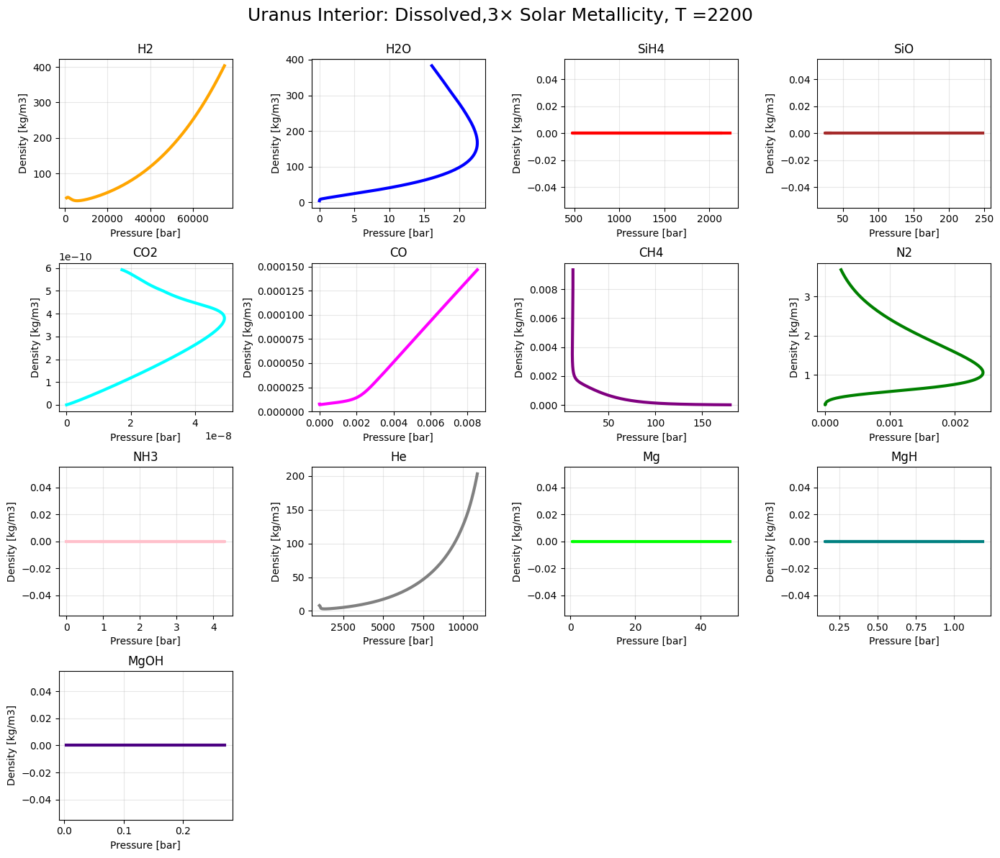

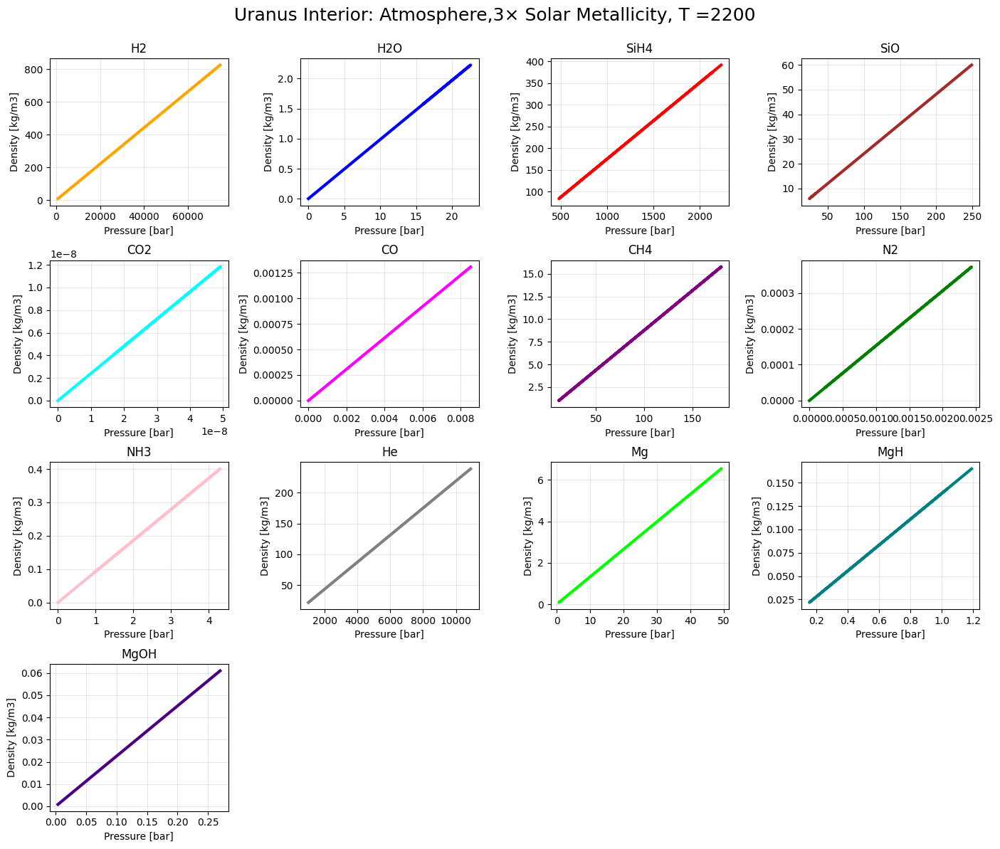

[20:05:03 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:05:03 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

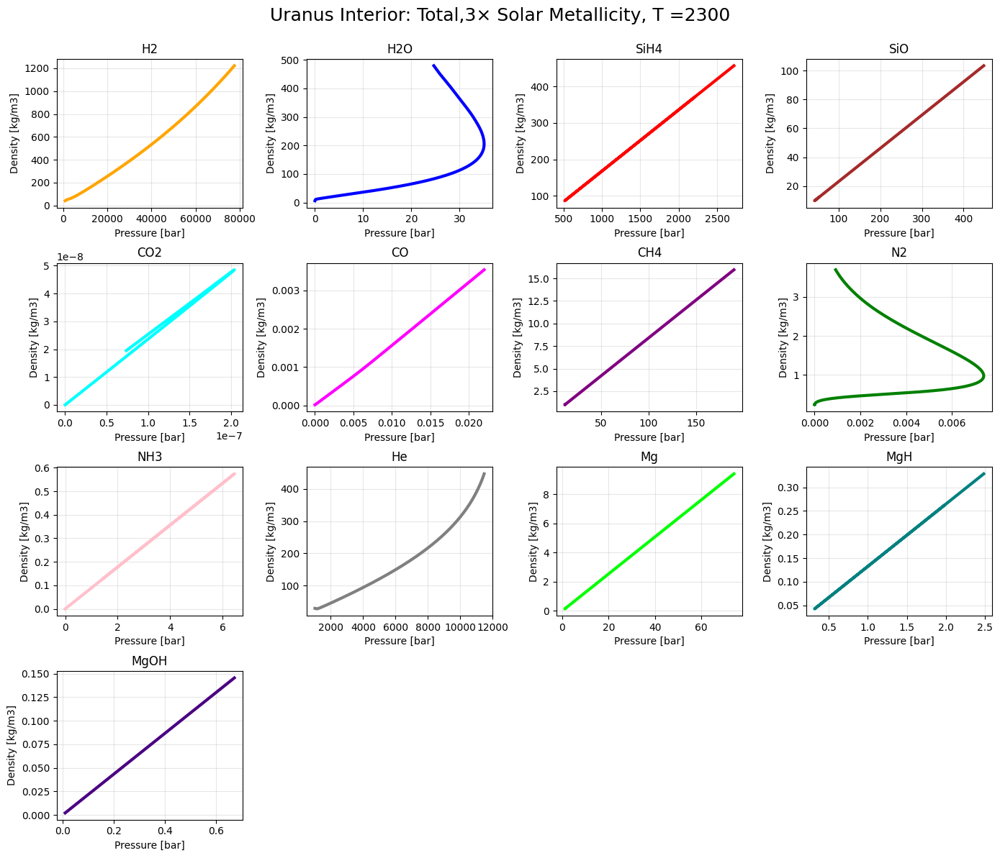

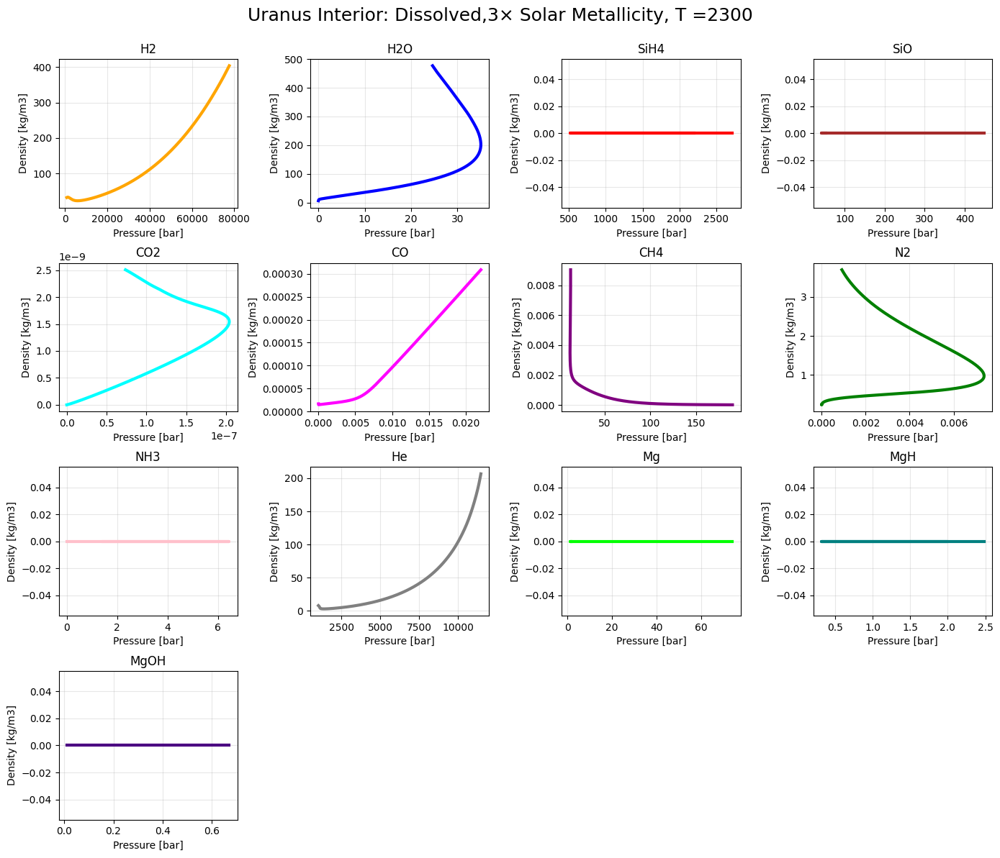

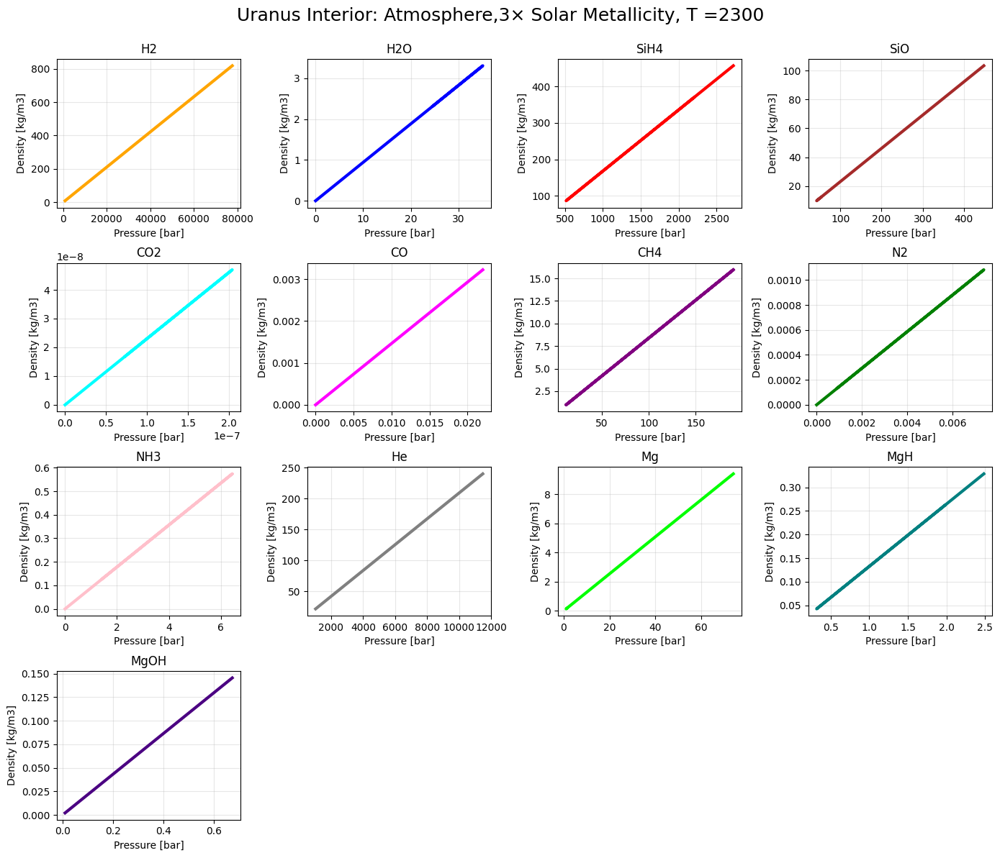

[20:06:16 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:06:16 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

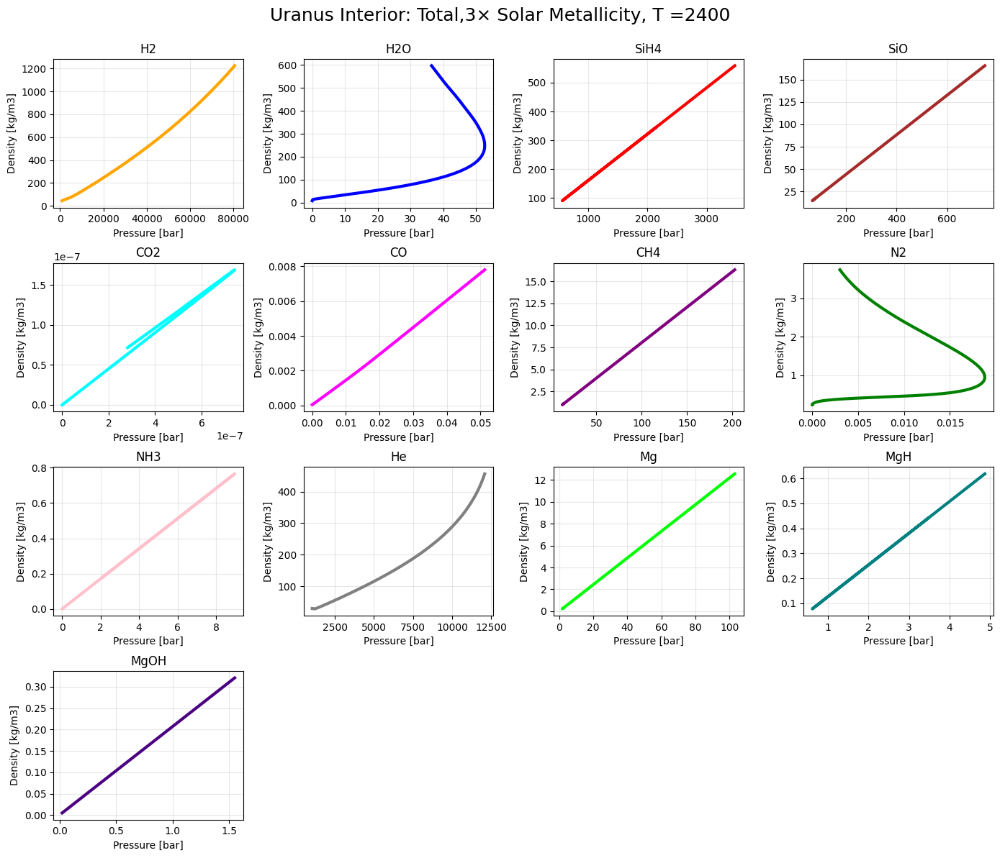

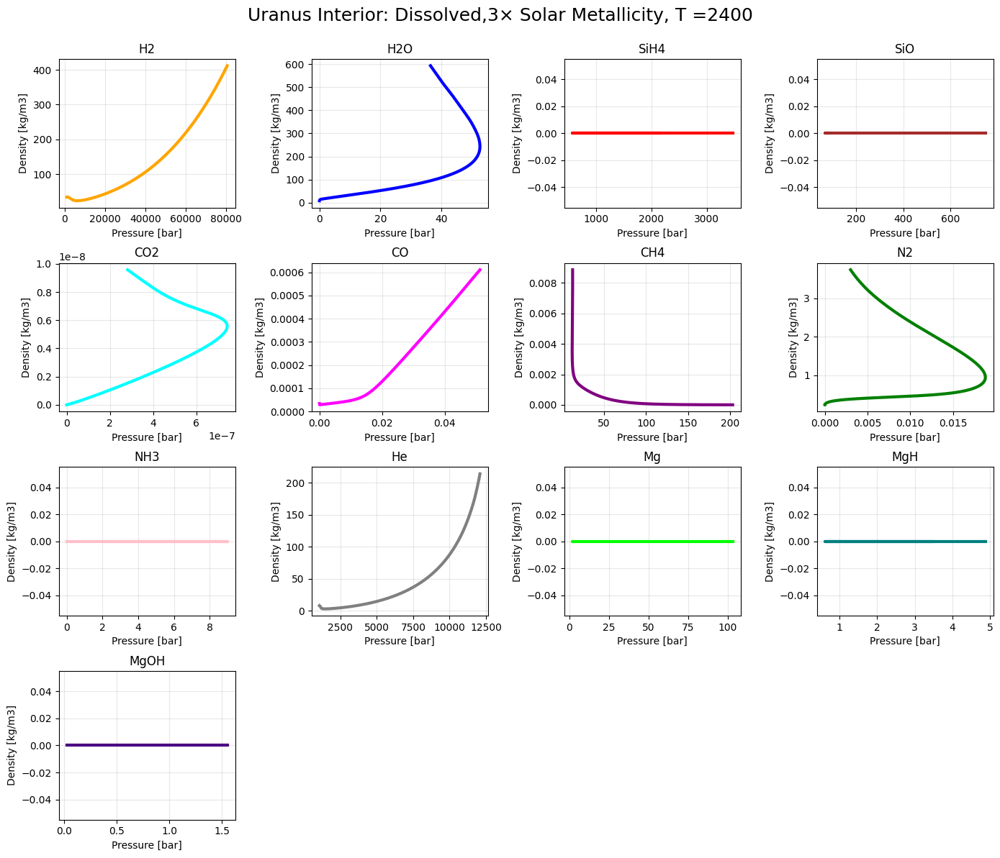

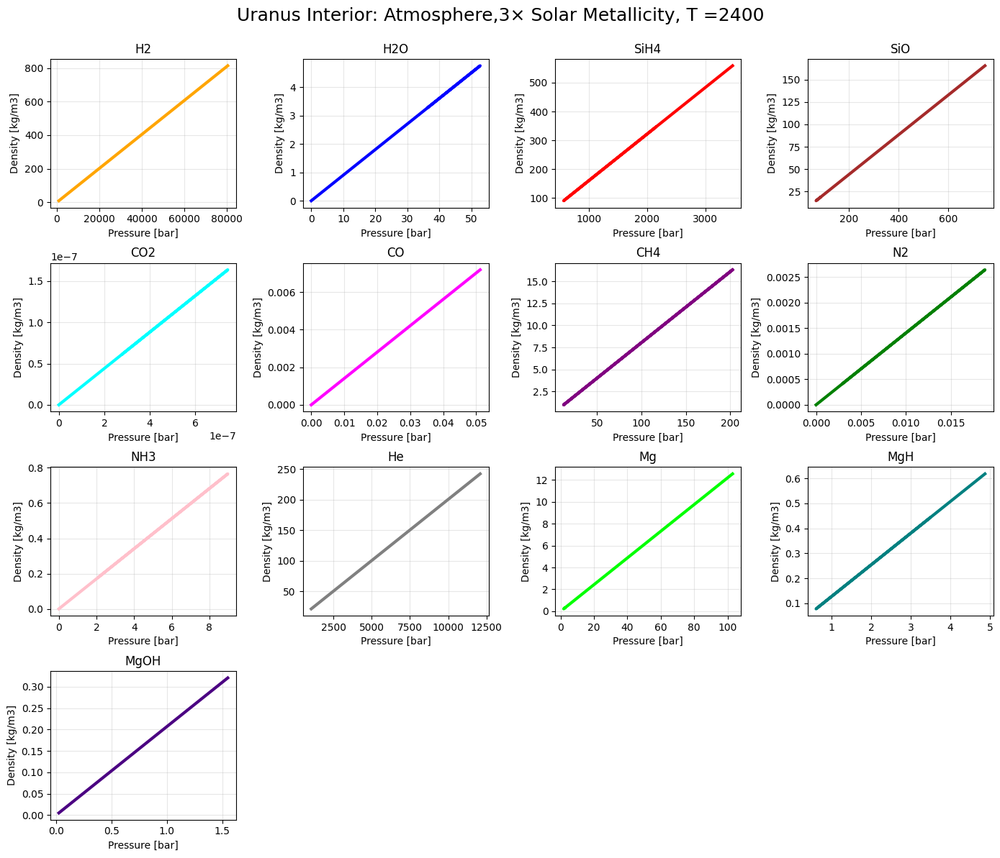

[20:07:29 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:07:29 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

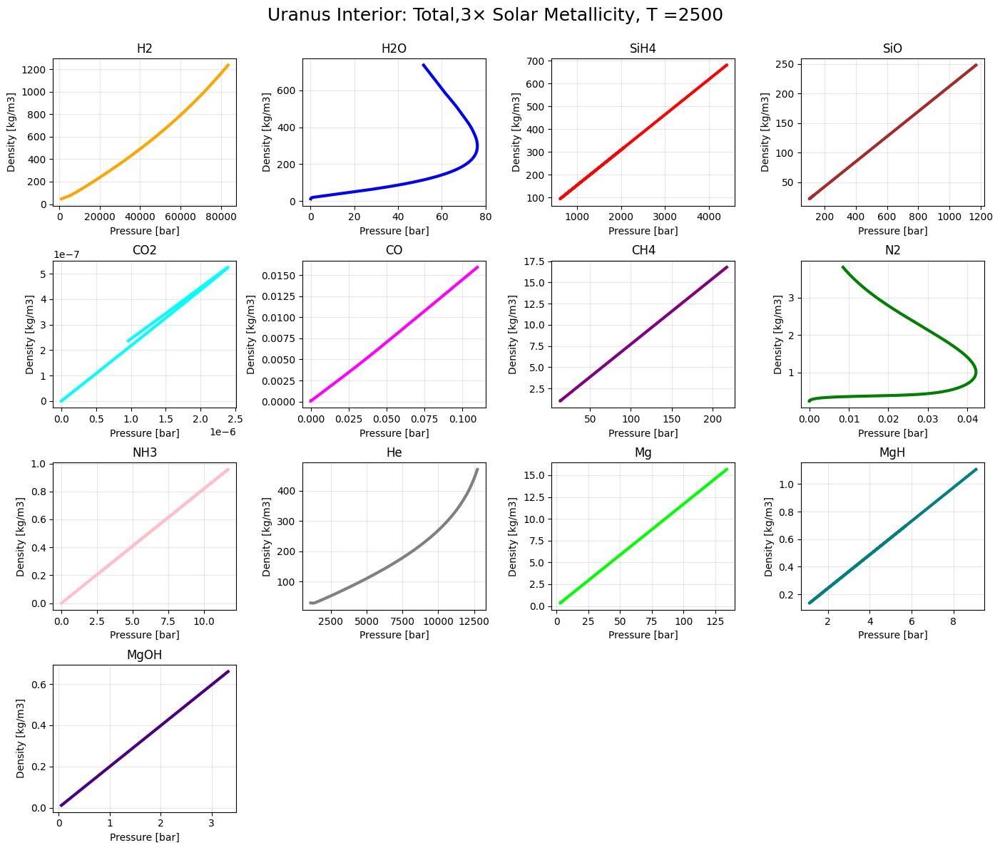

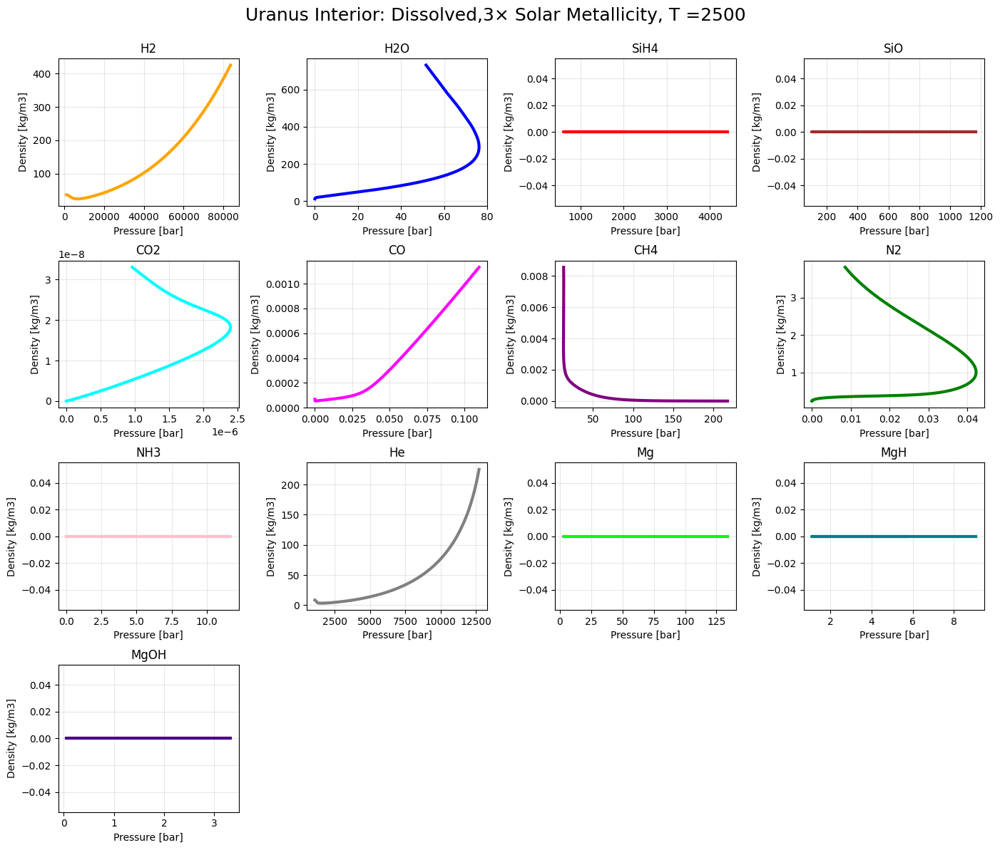

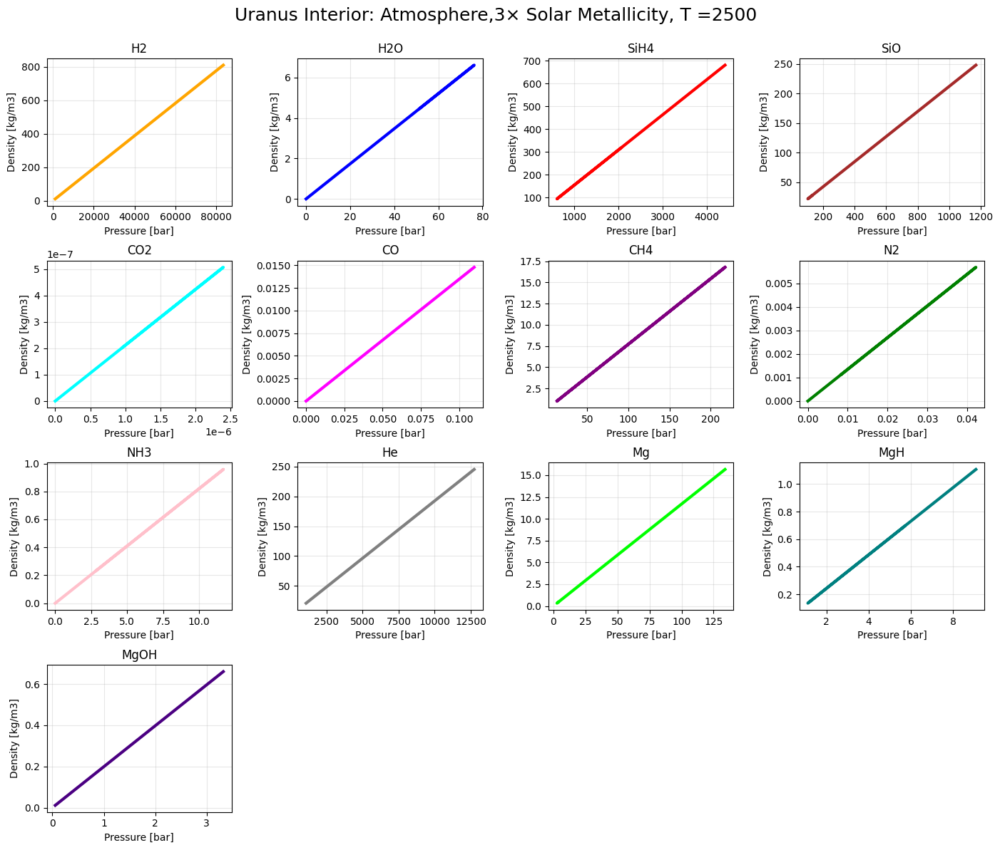

[20:08:28 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:08:28 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

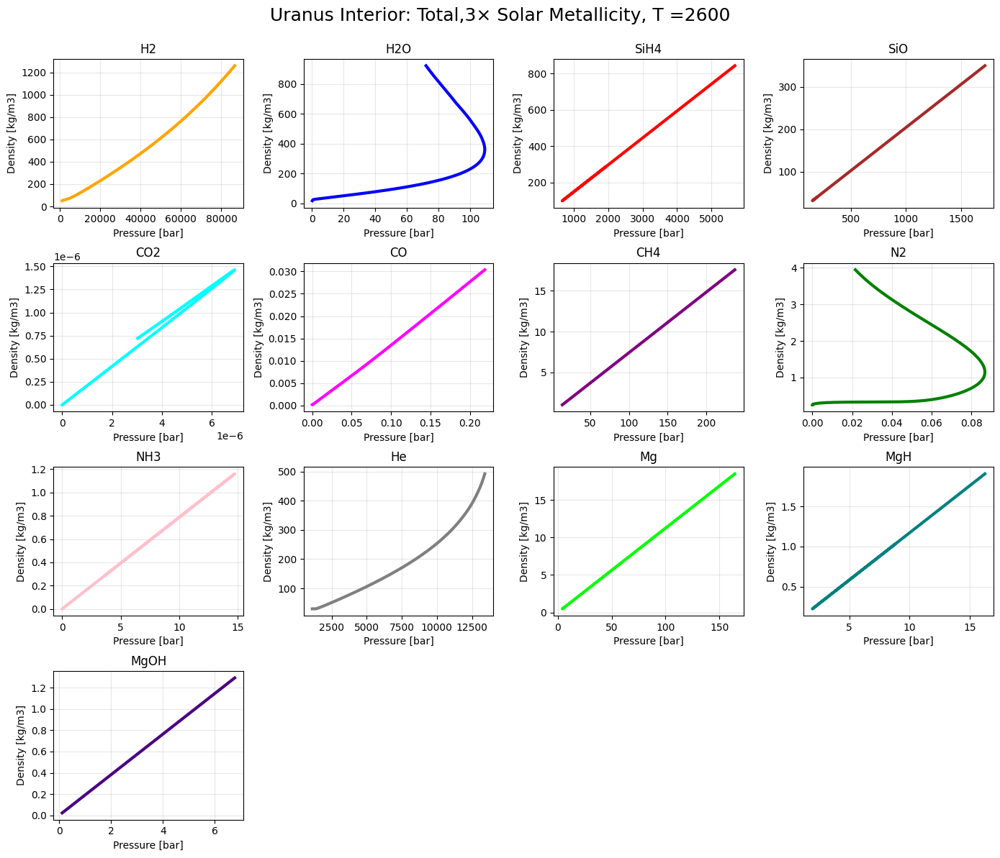

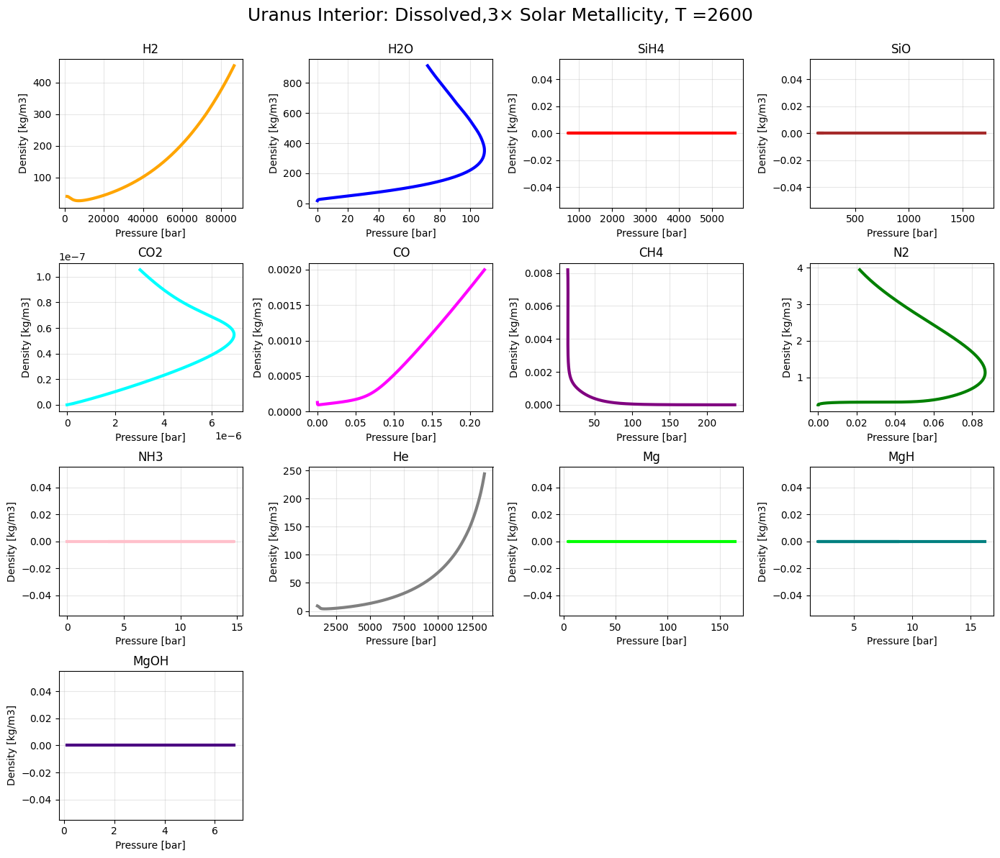

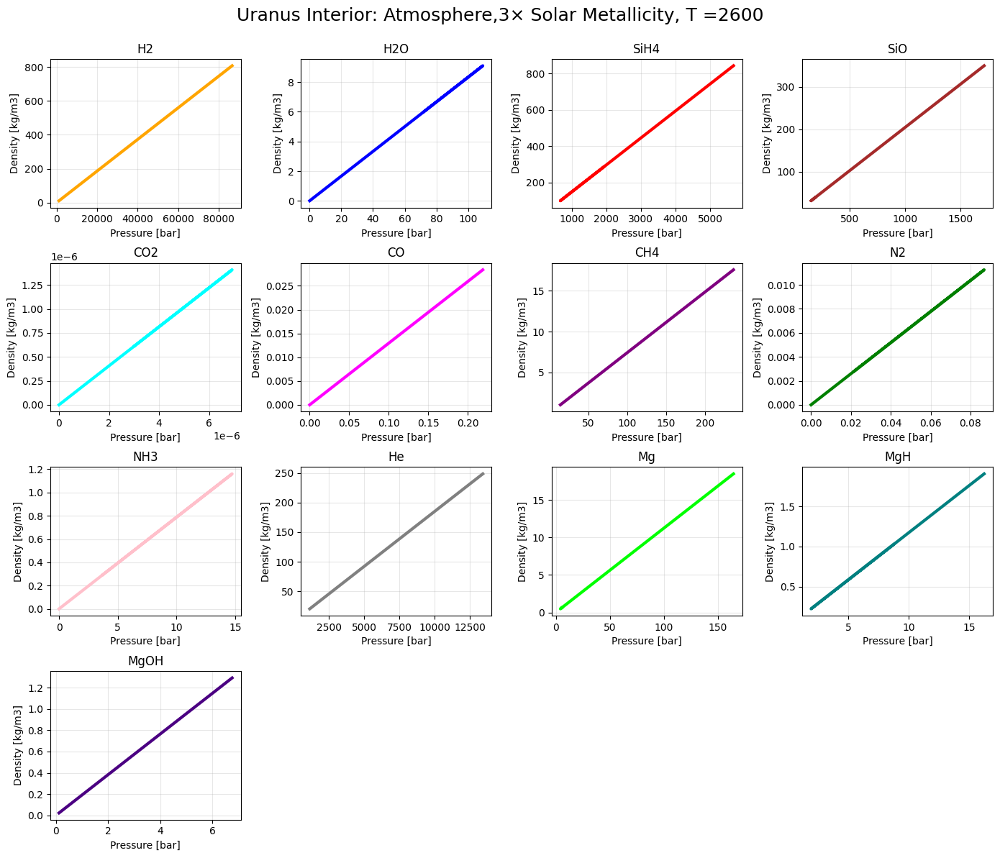

[20:09:22 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:09:22 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

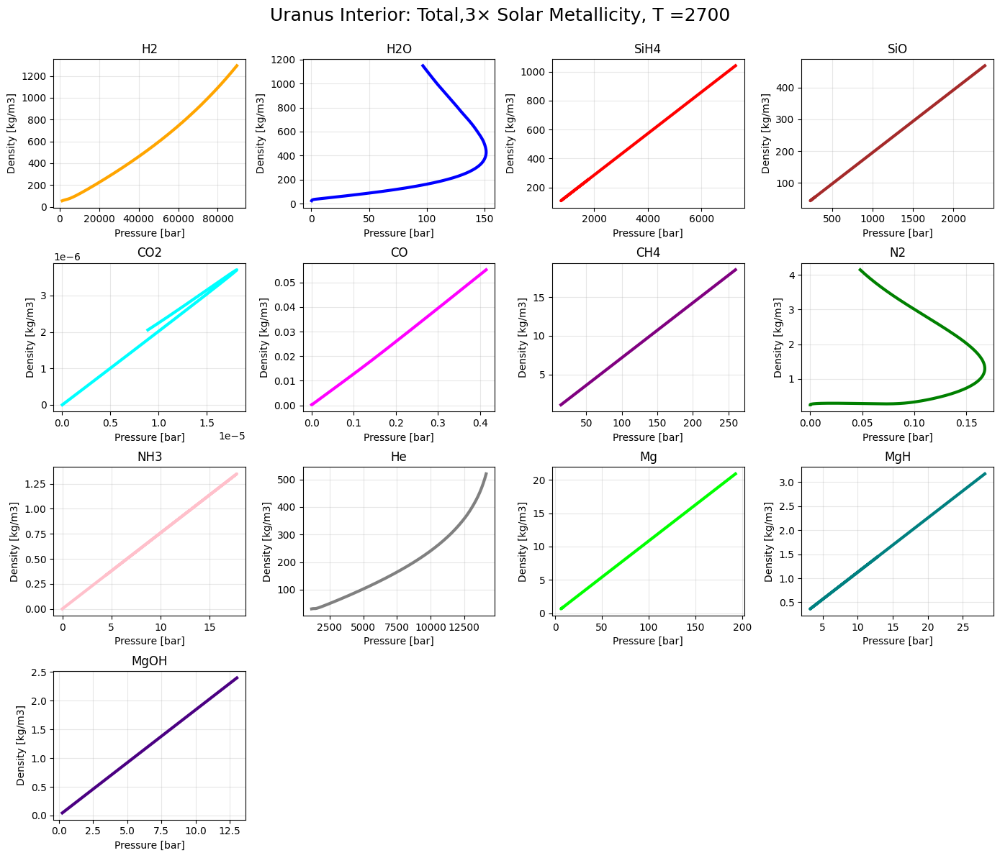

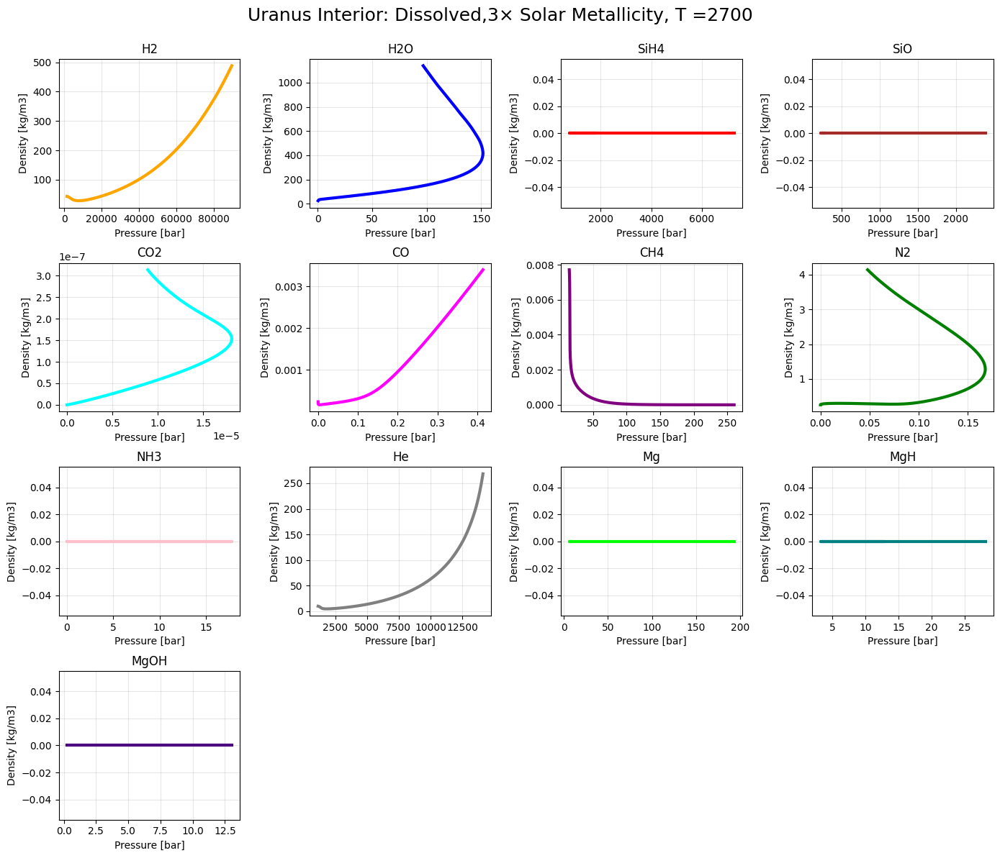

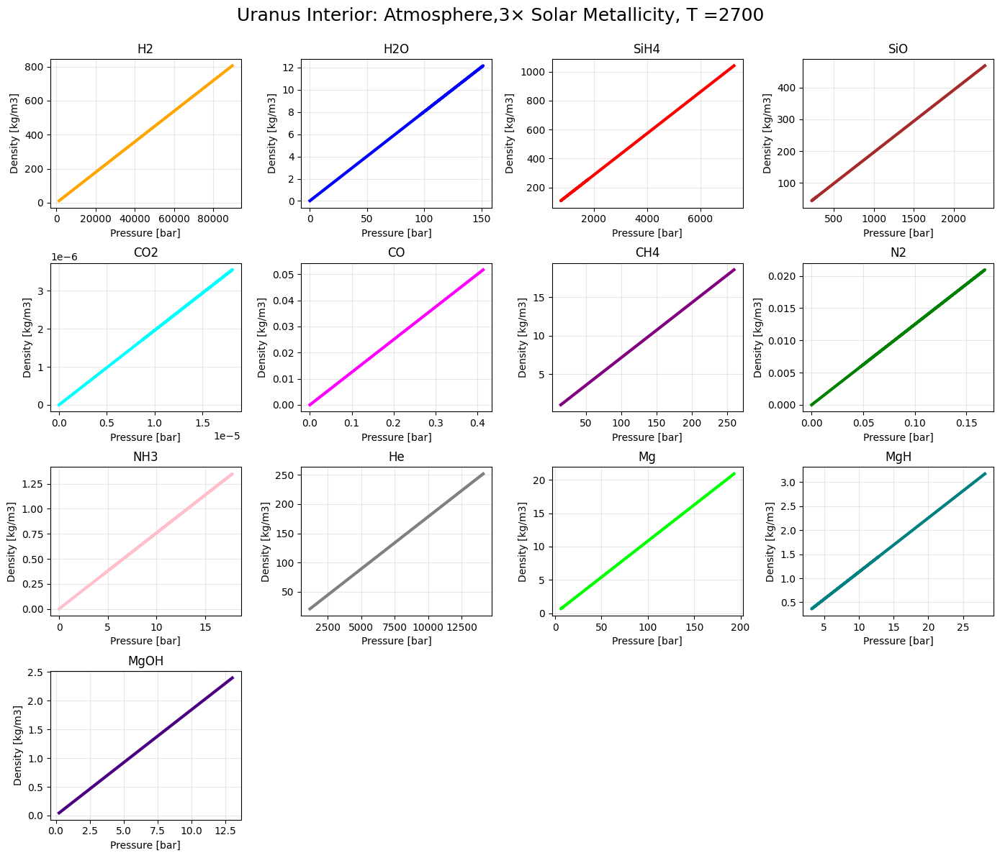

[20:10:13 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:10:13 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

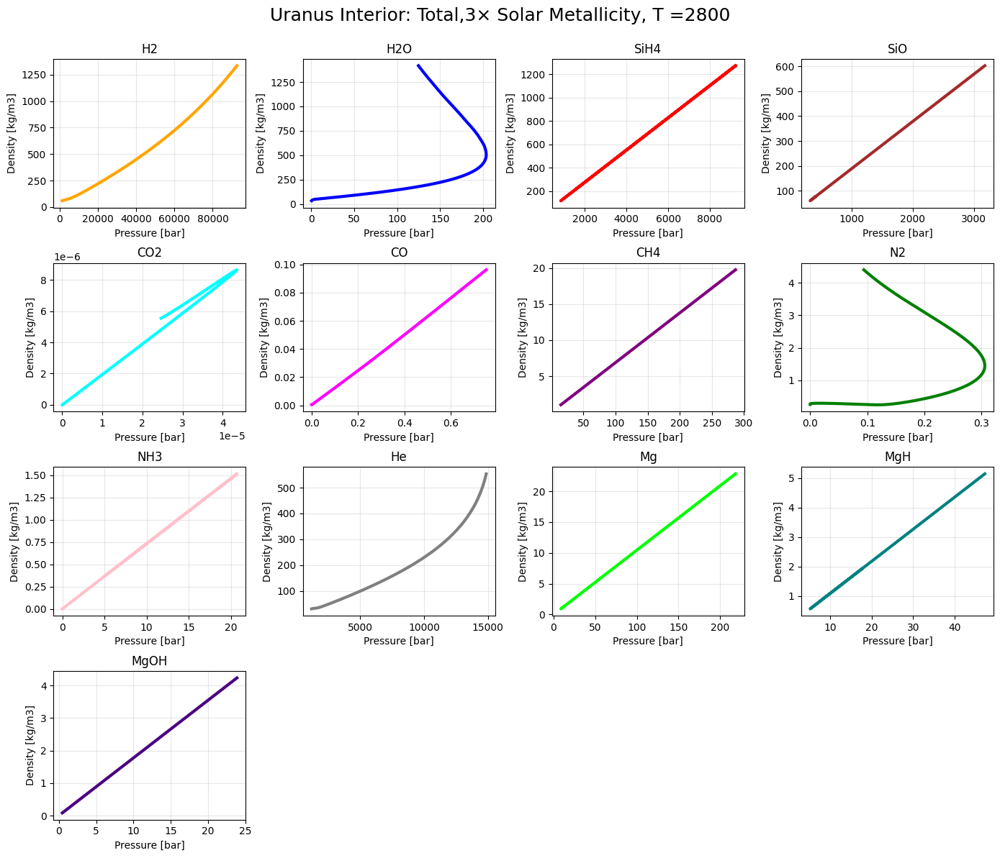

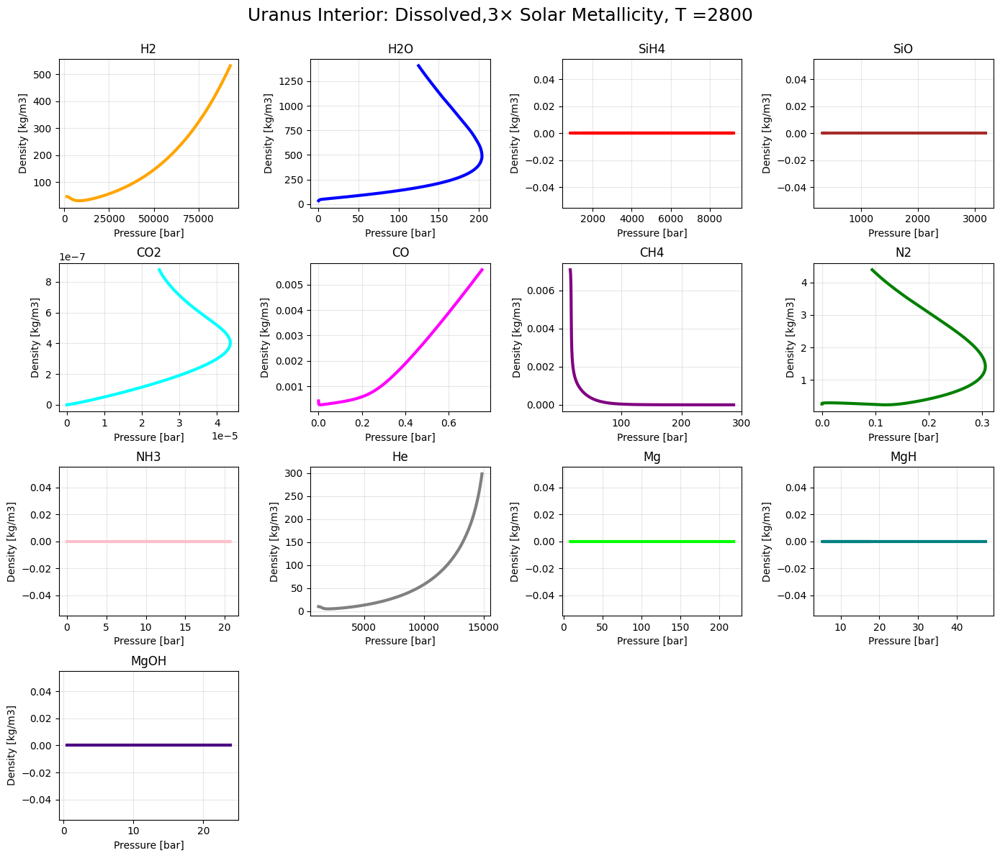

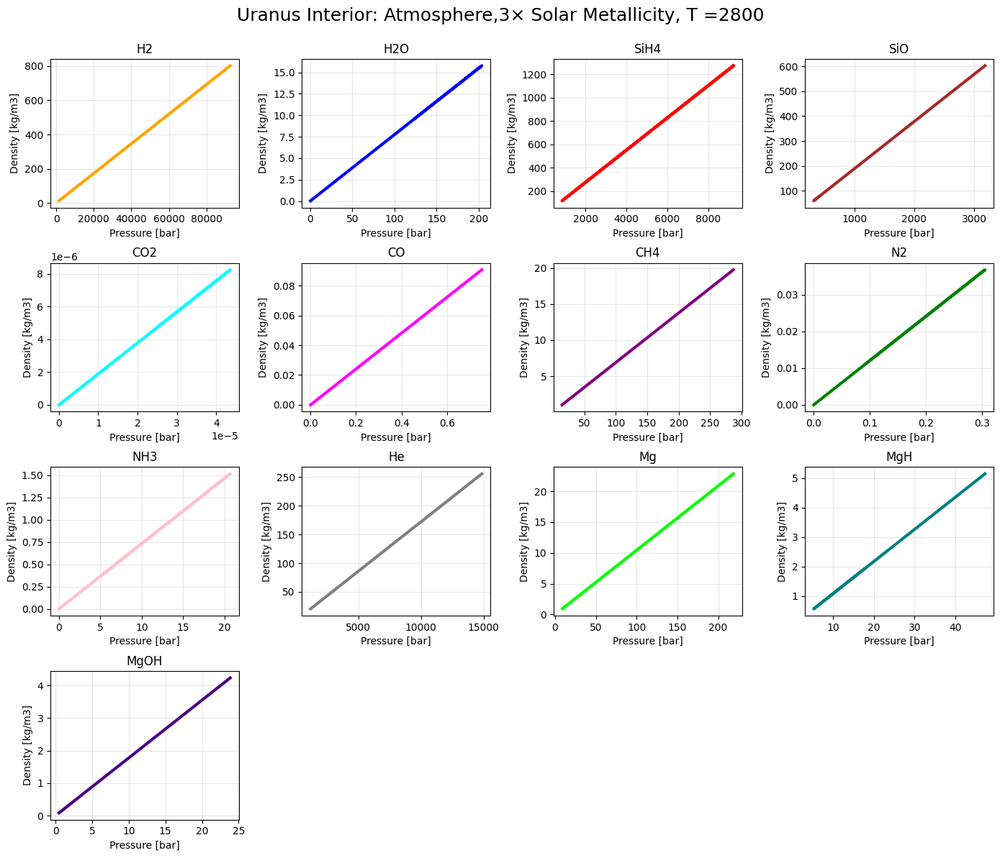

[20:11:04 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:11:04 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

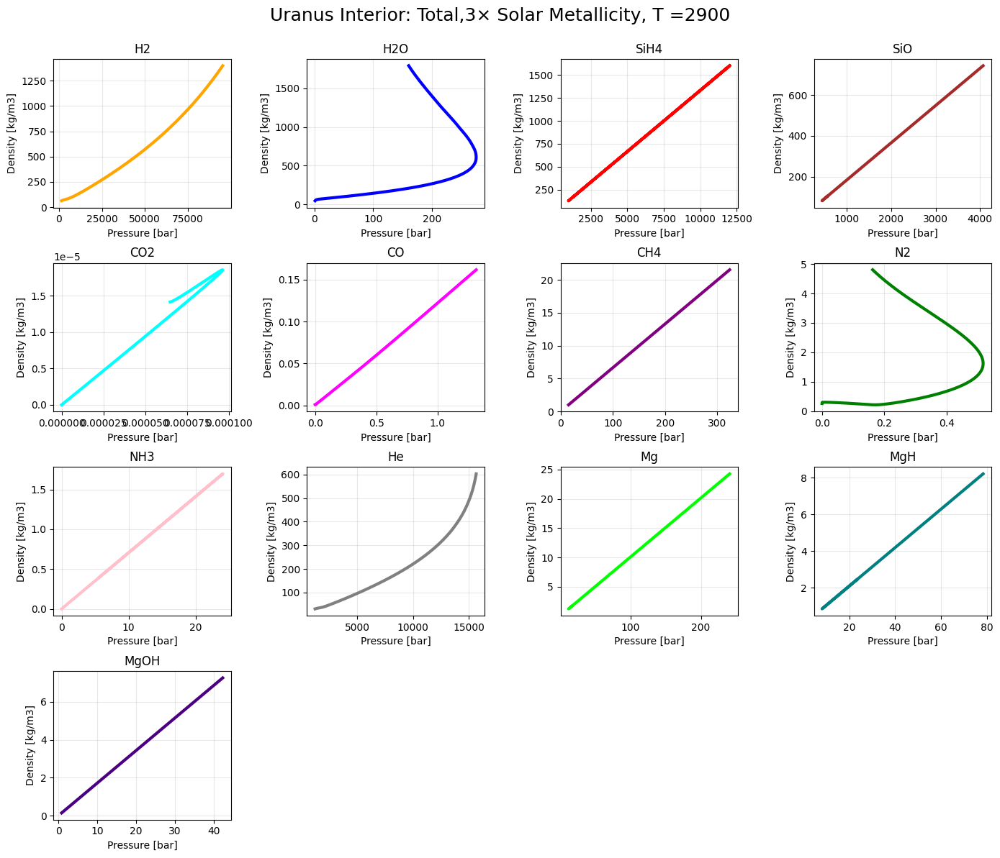

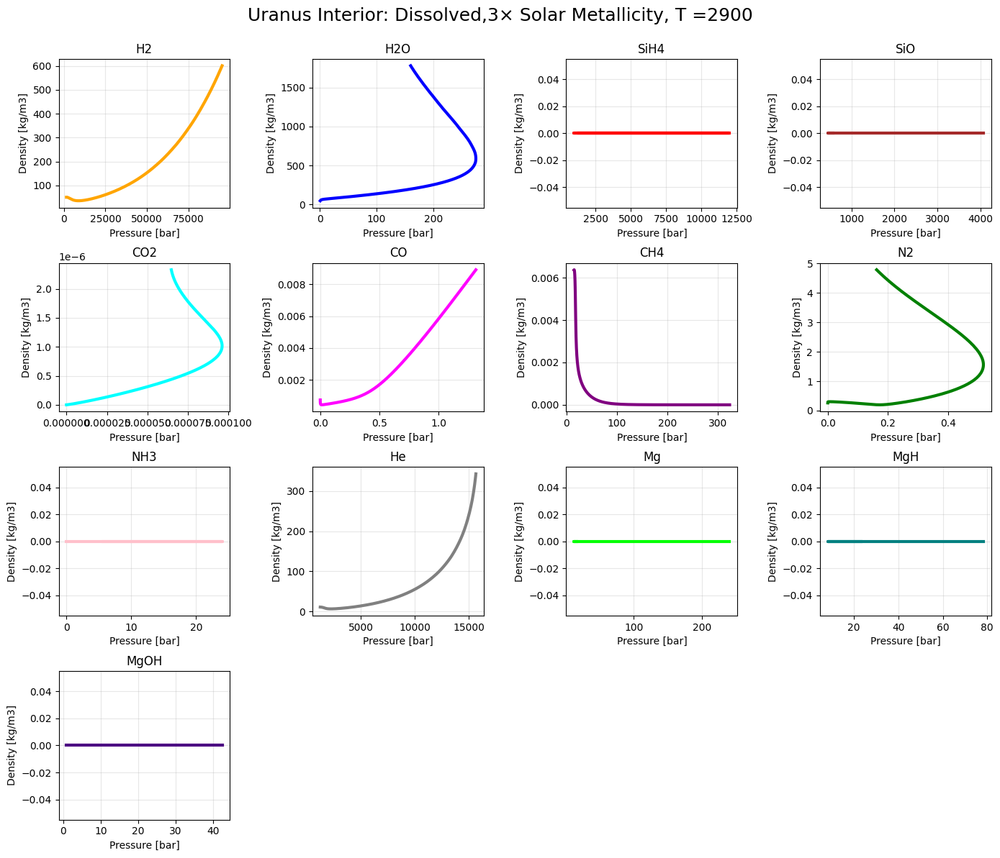

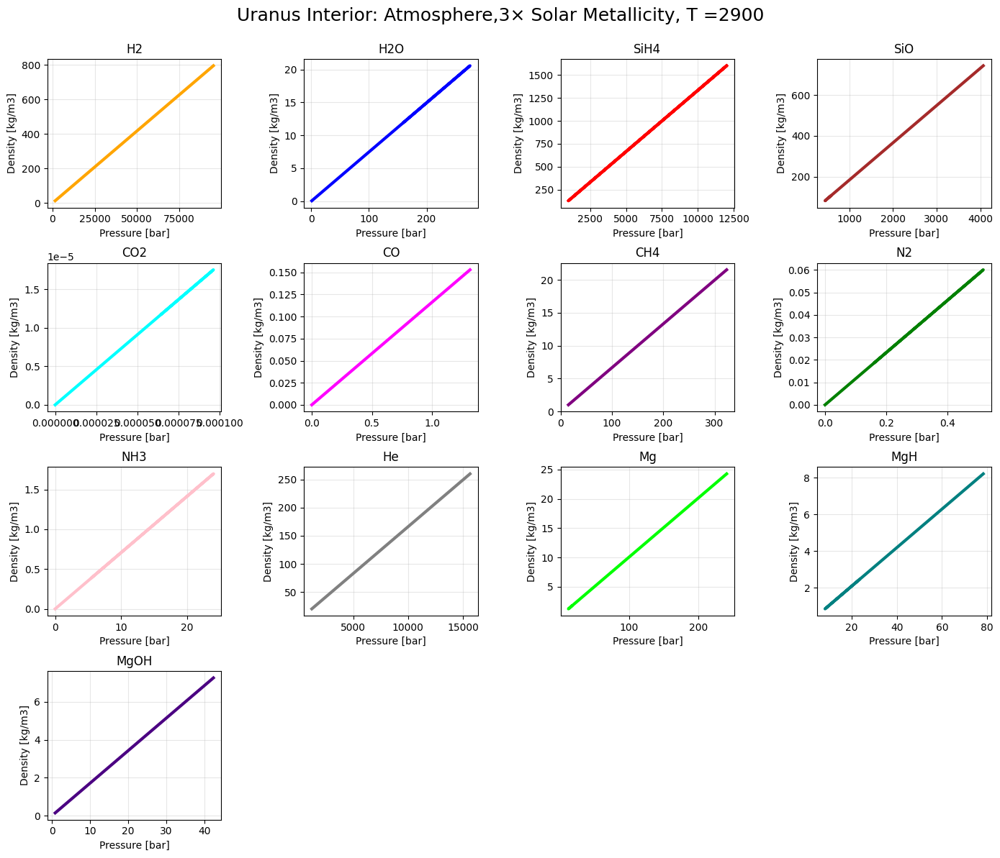

[20:11:54 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:11:54 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

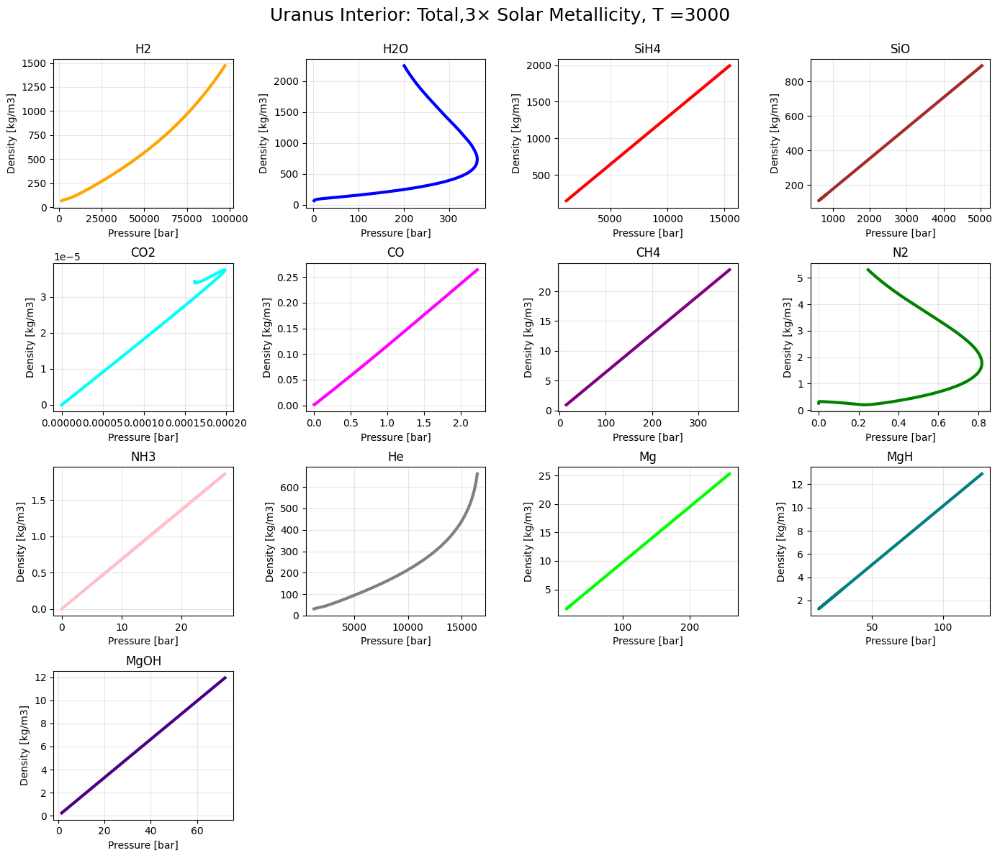

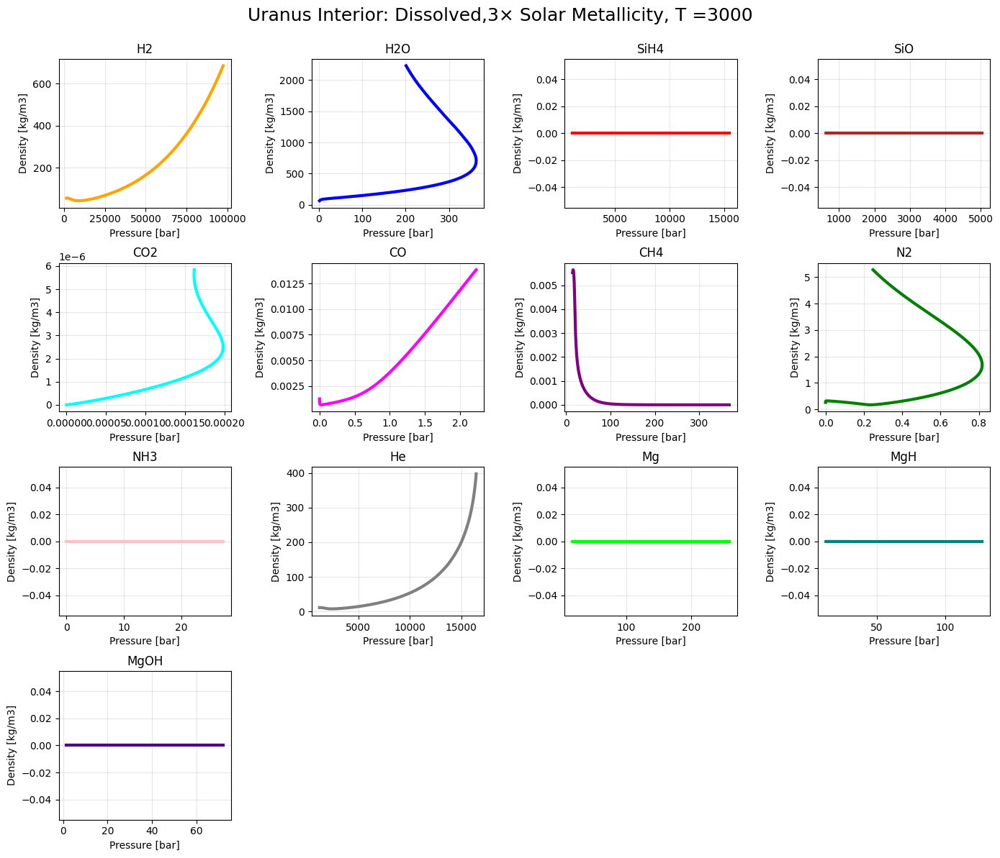

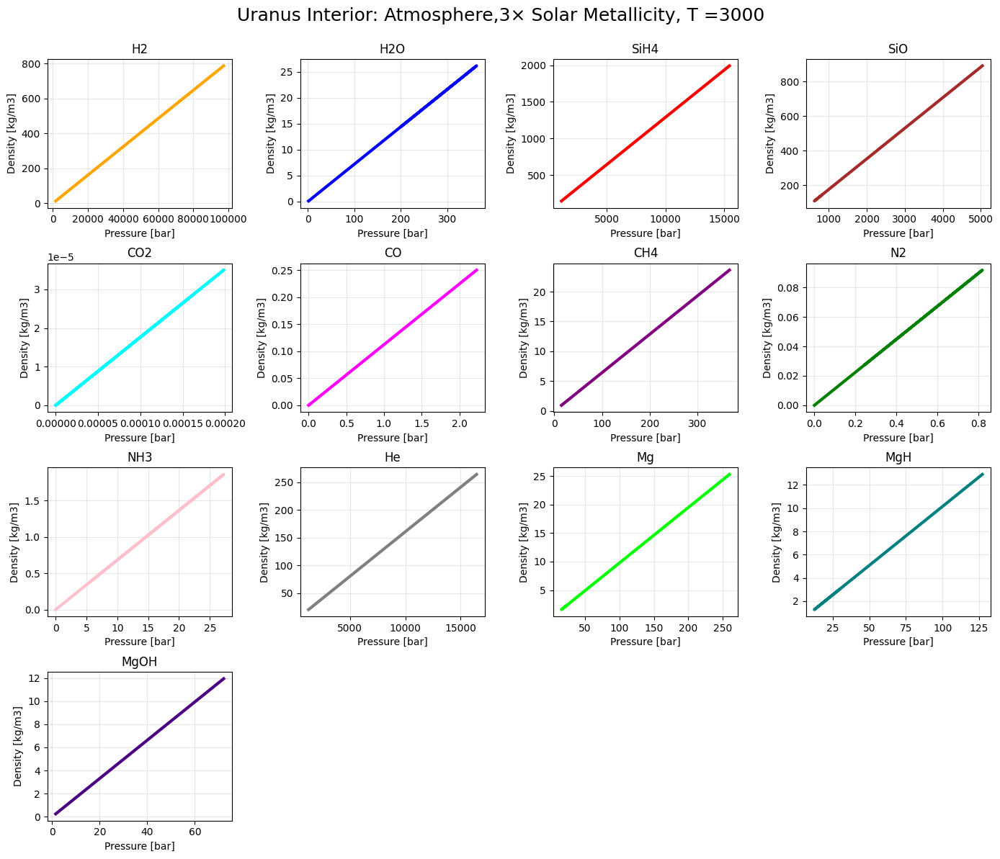

[20:12:46 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:12:46 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

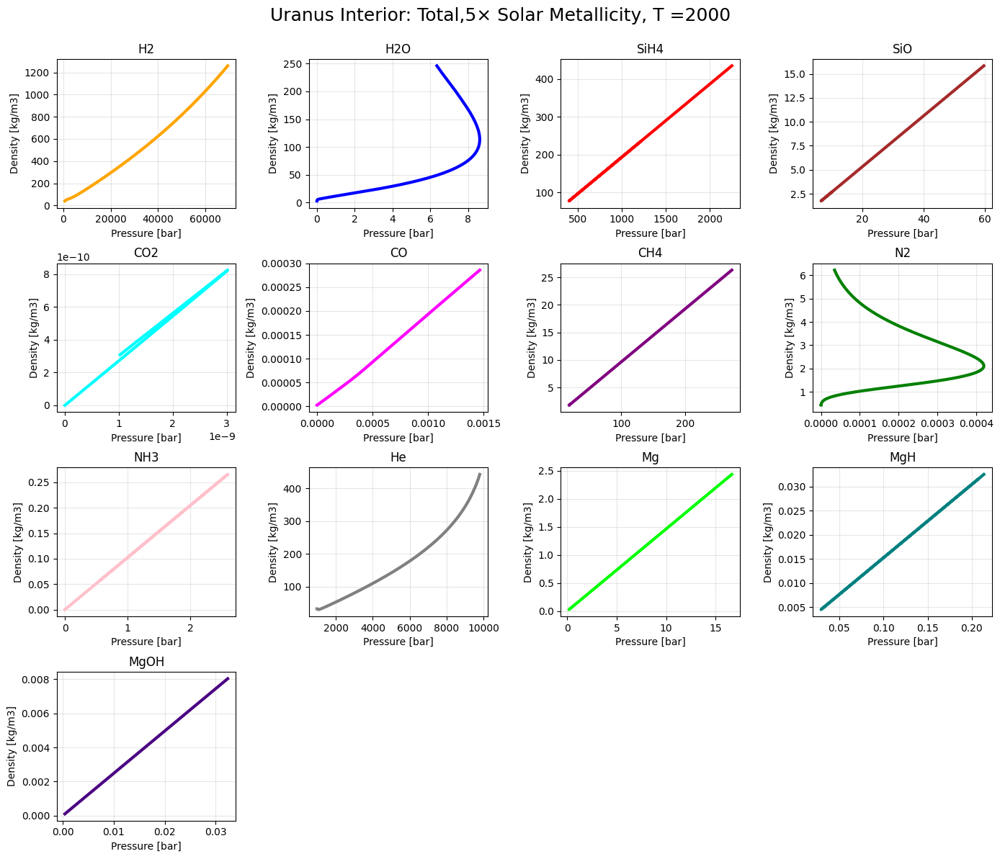

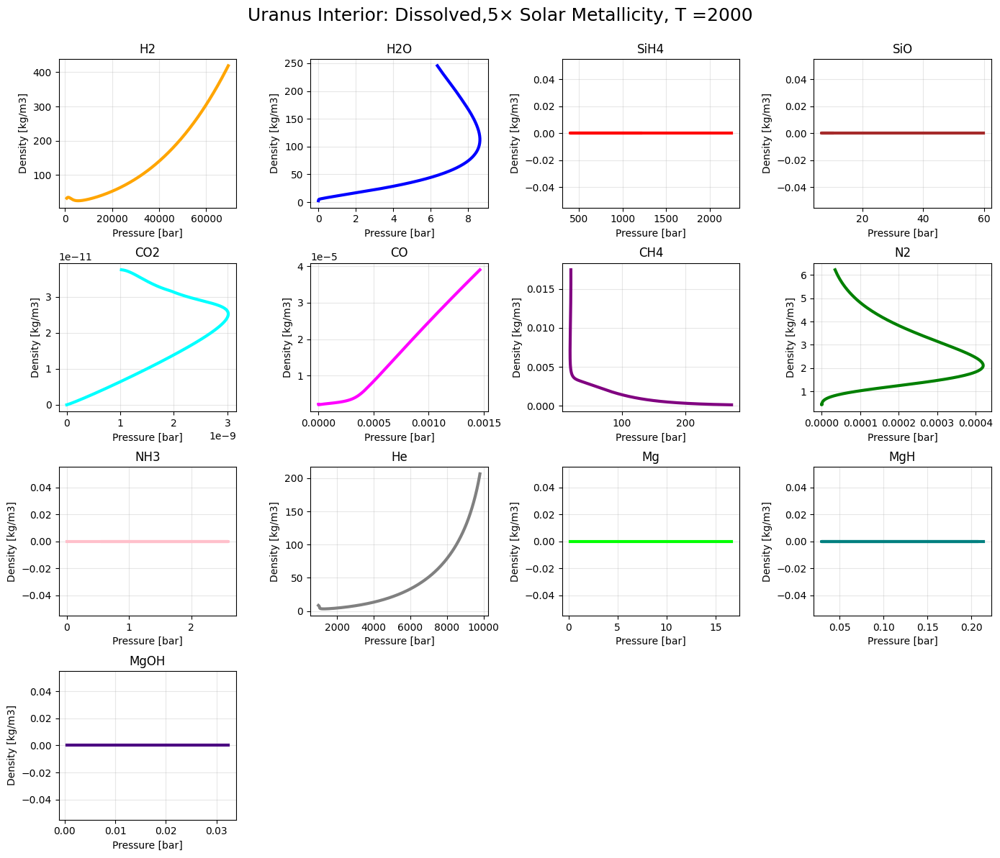

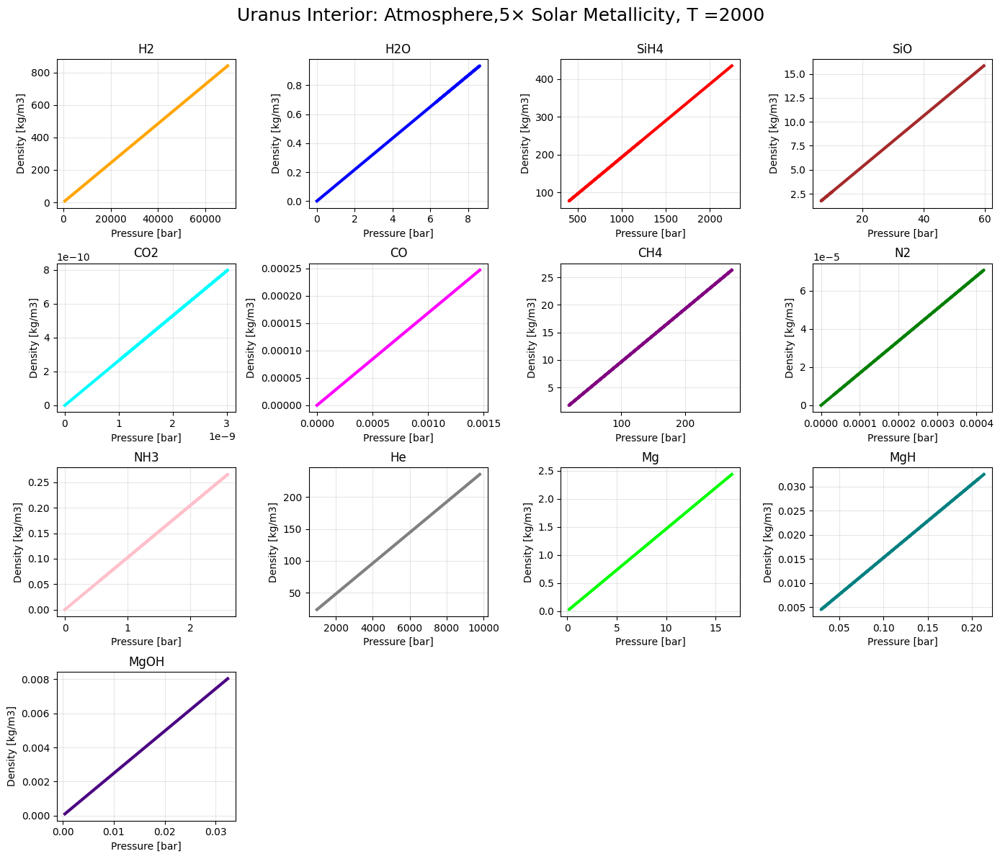

[20:14:02 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:14:02 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

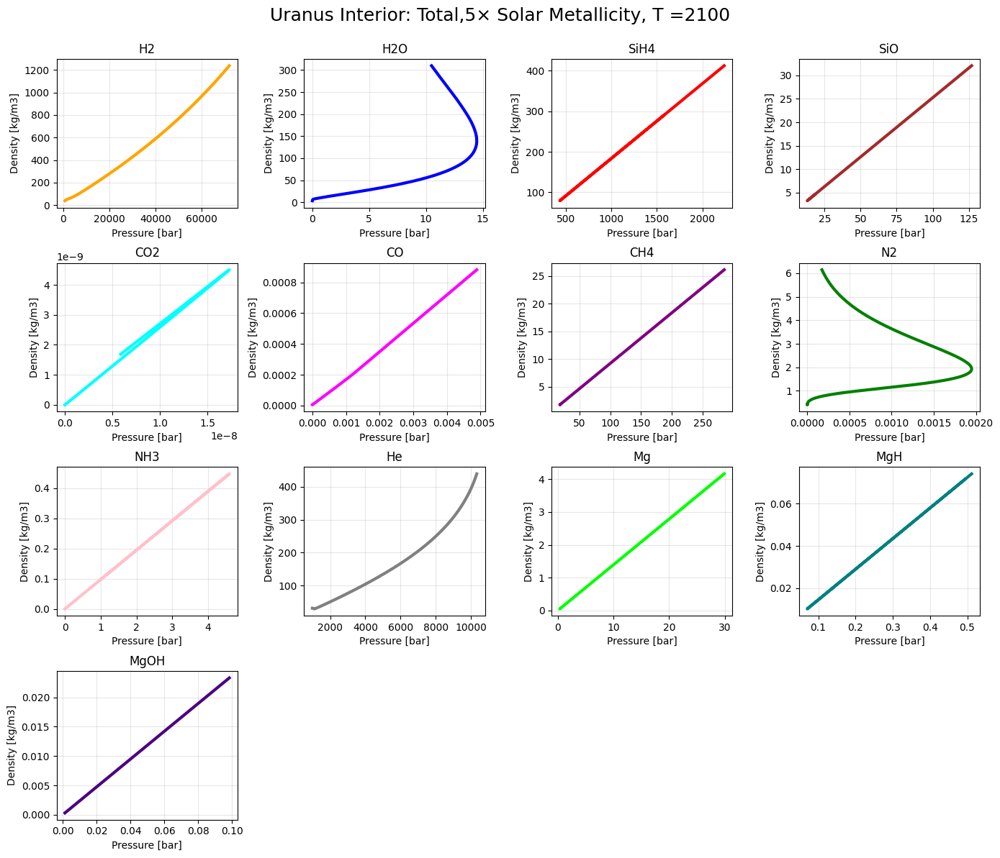

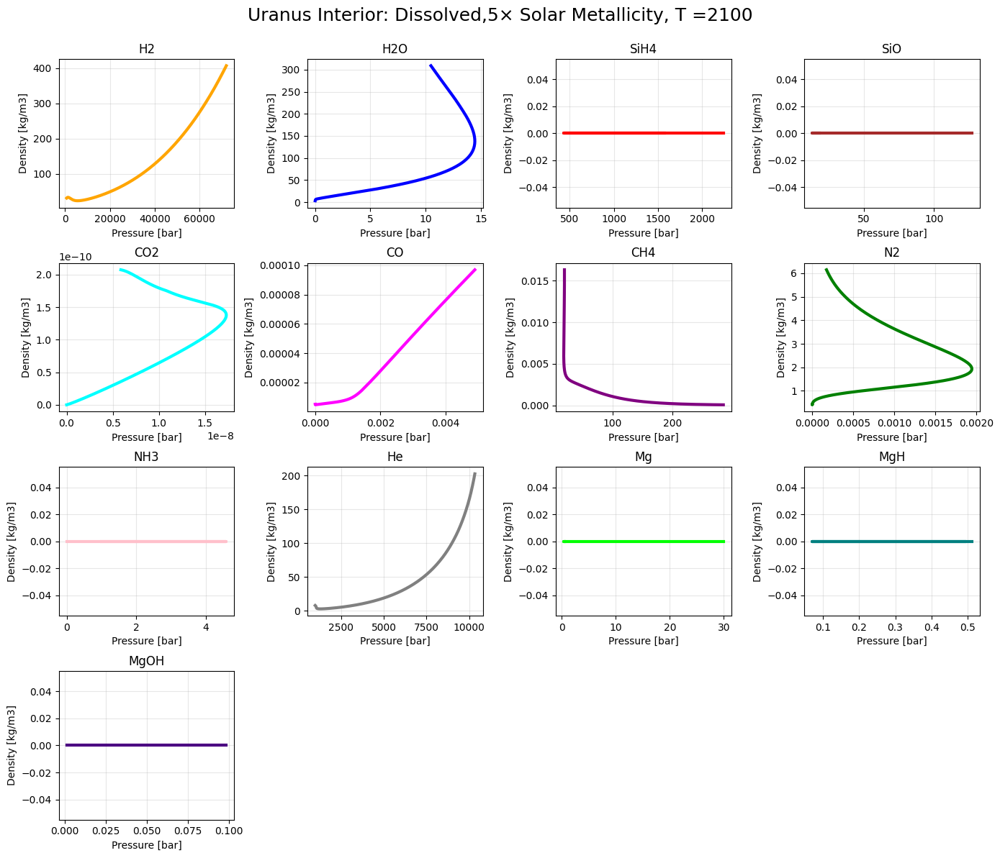

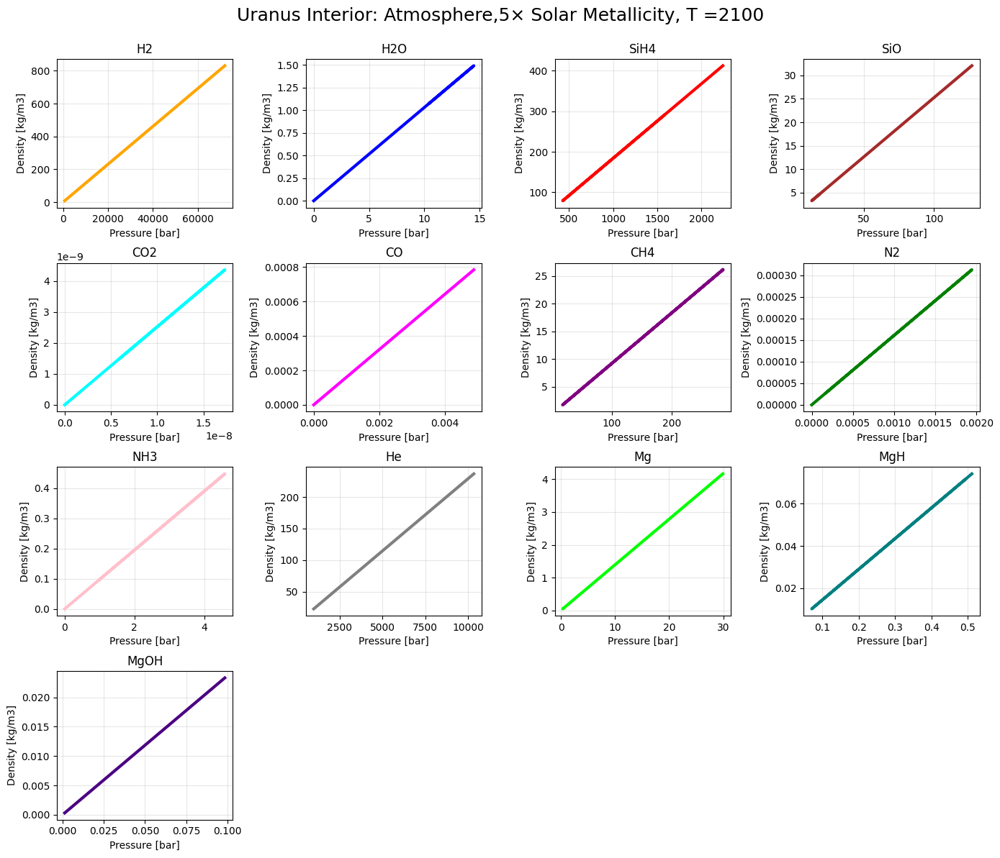

[20:15:13 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:15:13 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

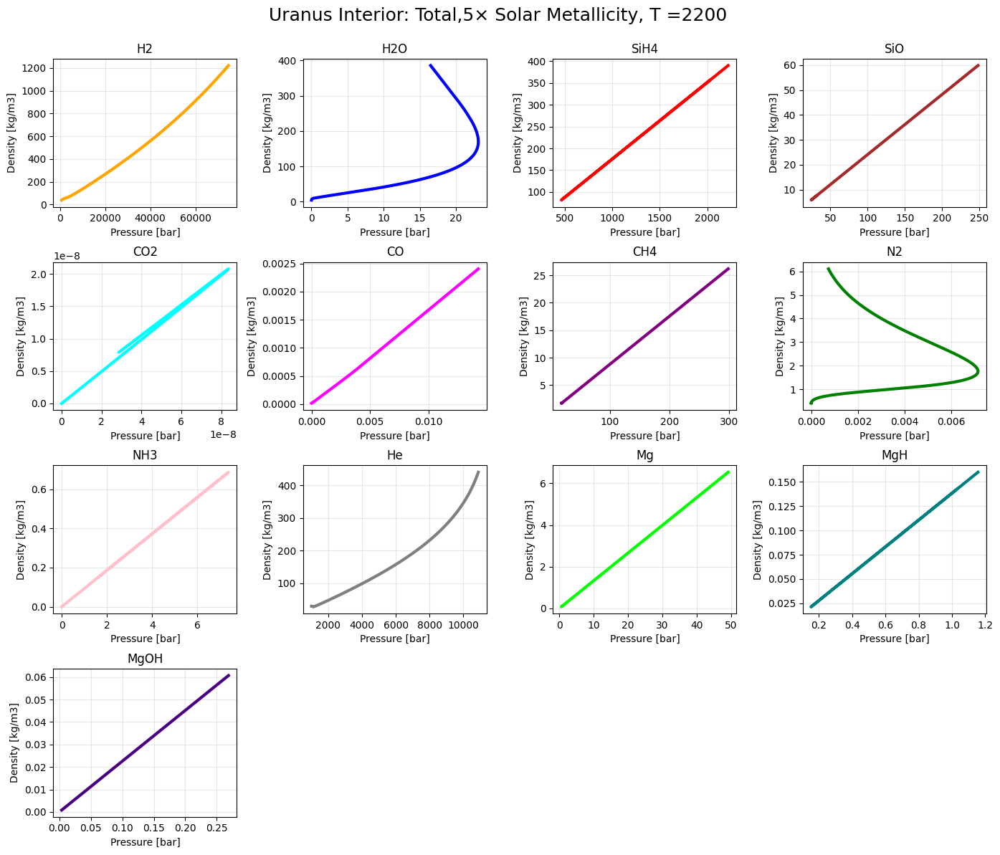

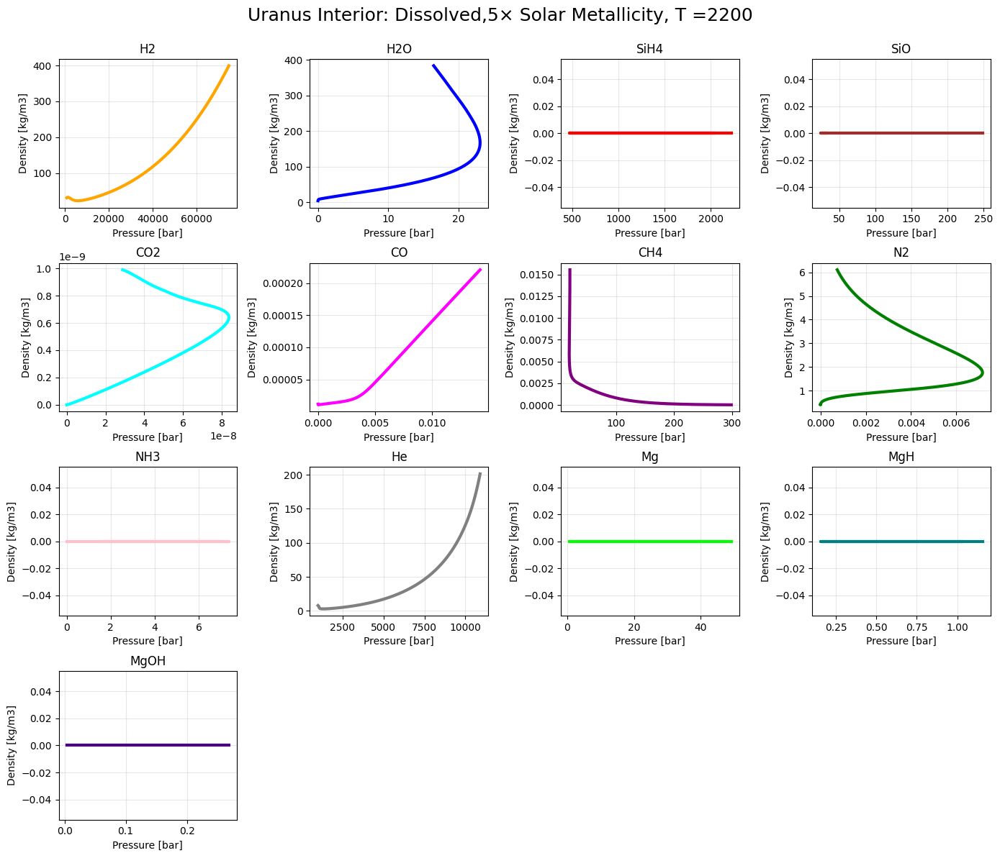

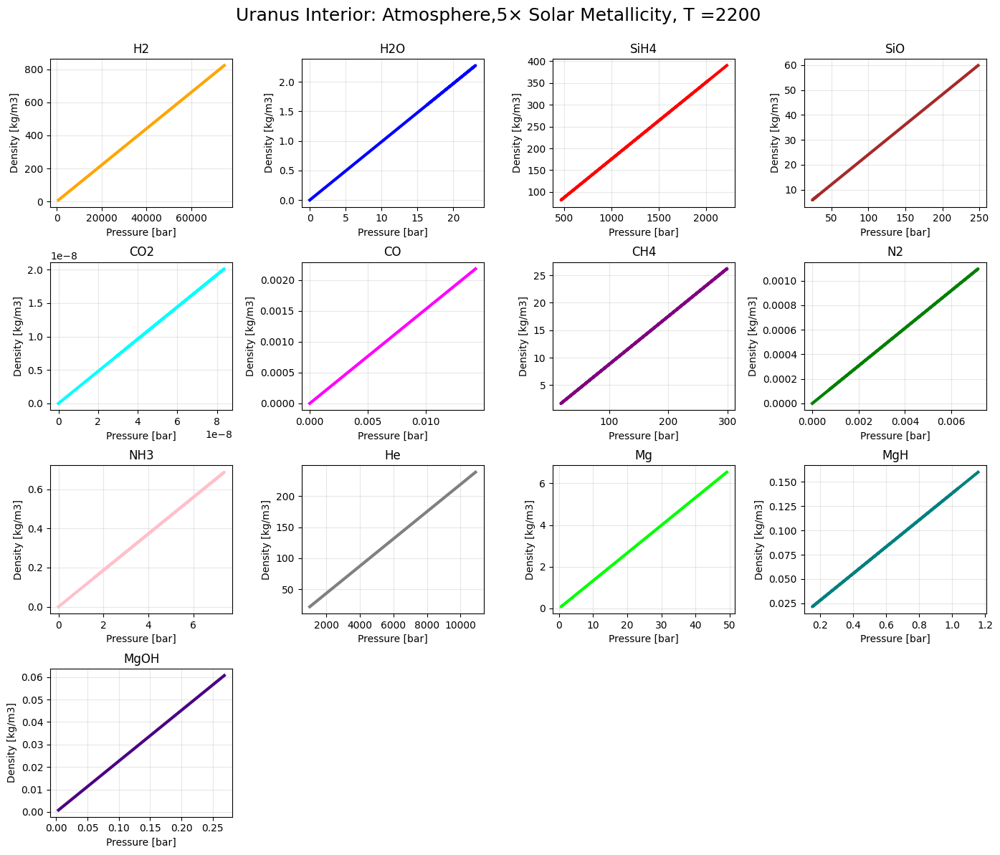

[20:16:28 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:16:28 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

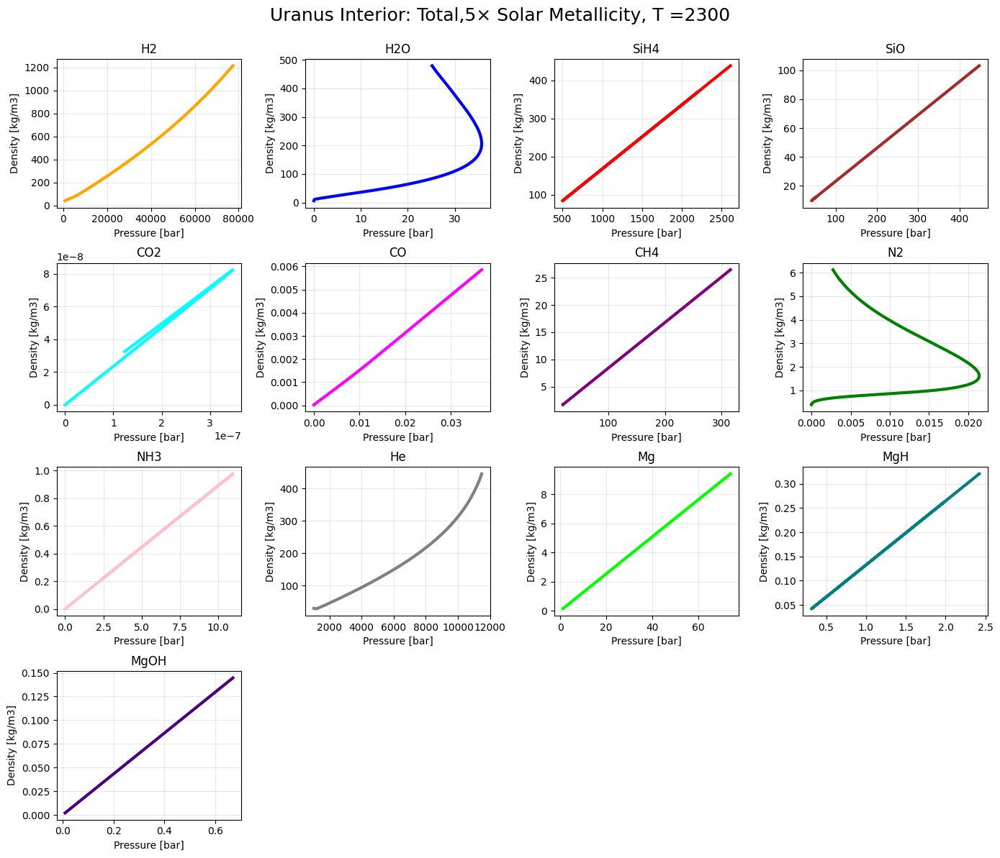

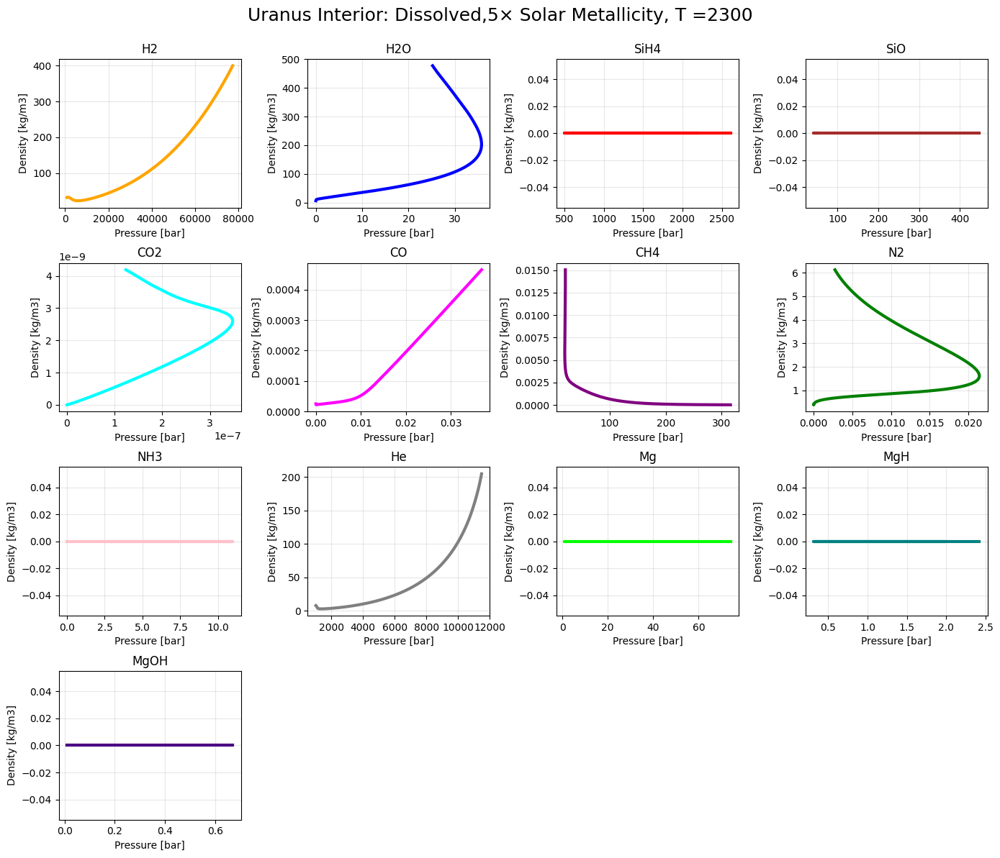

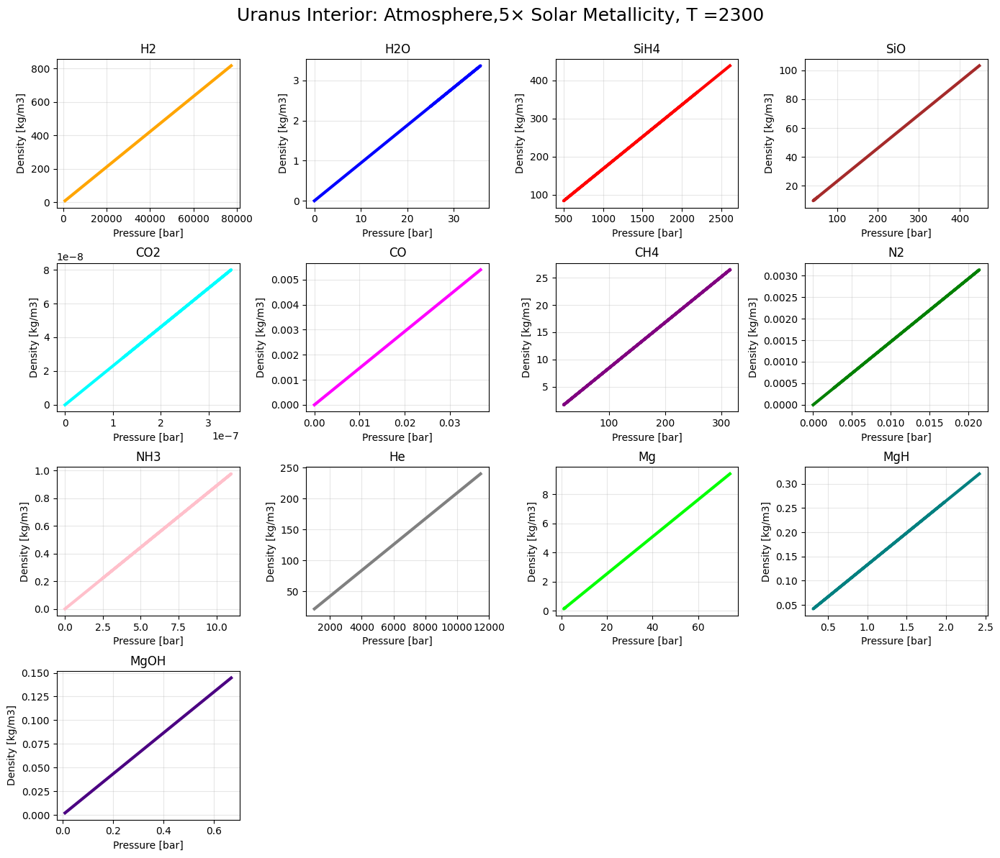

[20:17:37 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:17:37 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

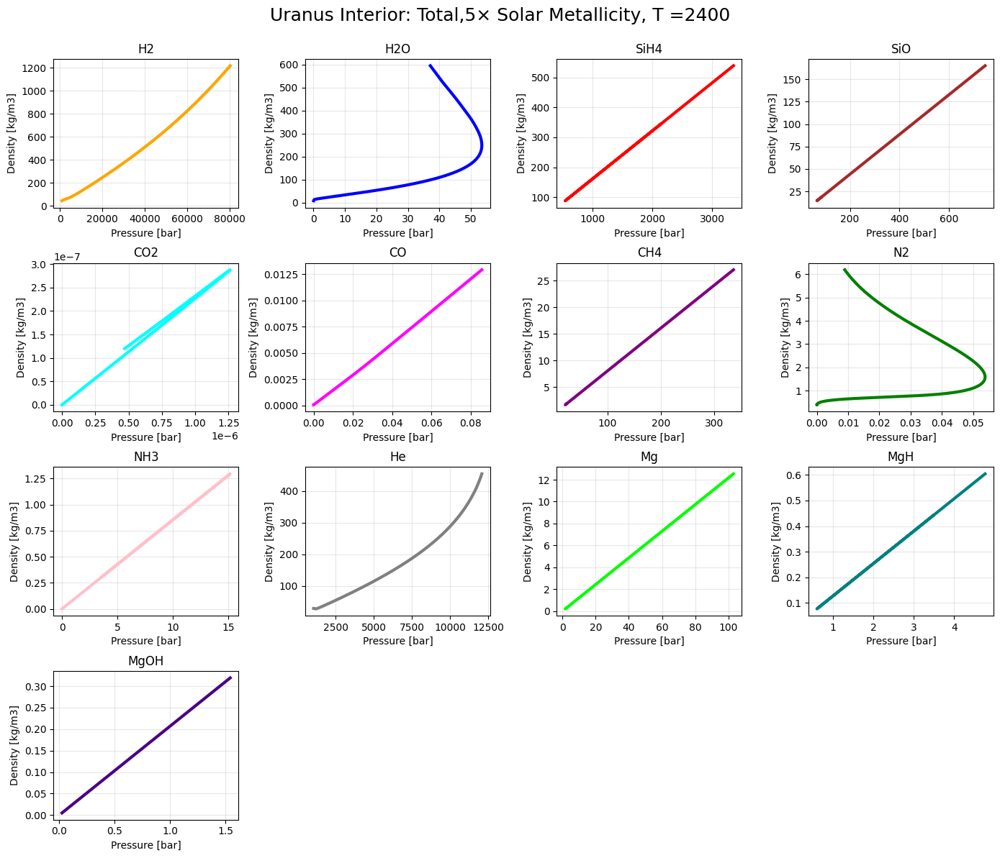

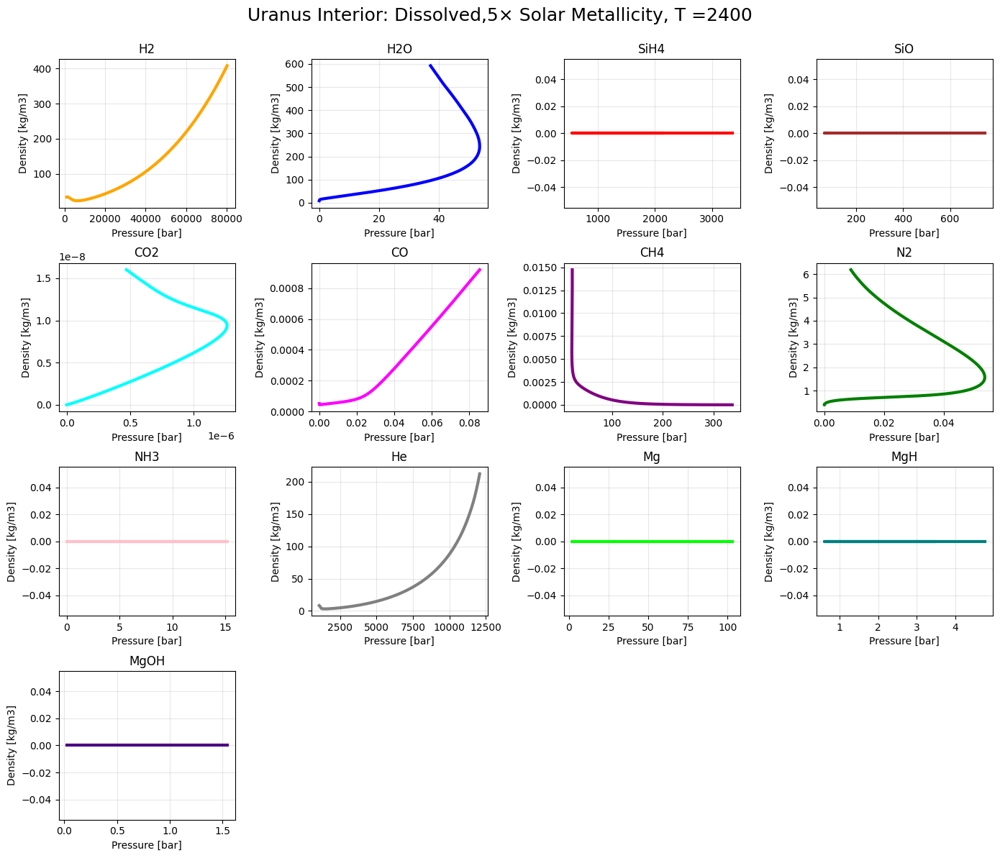

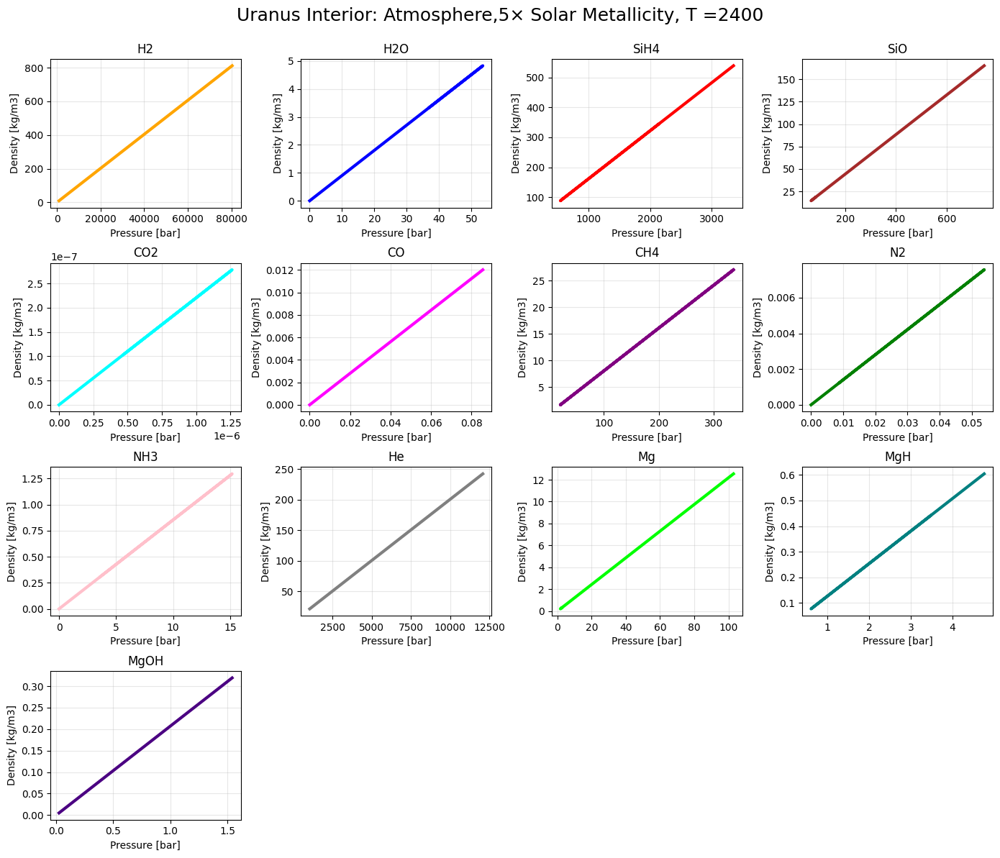

[20:18:51 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:18:51 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

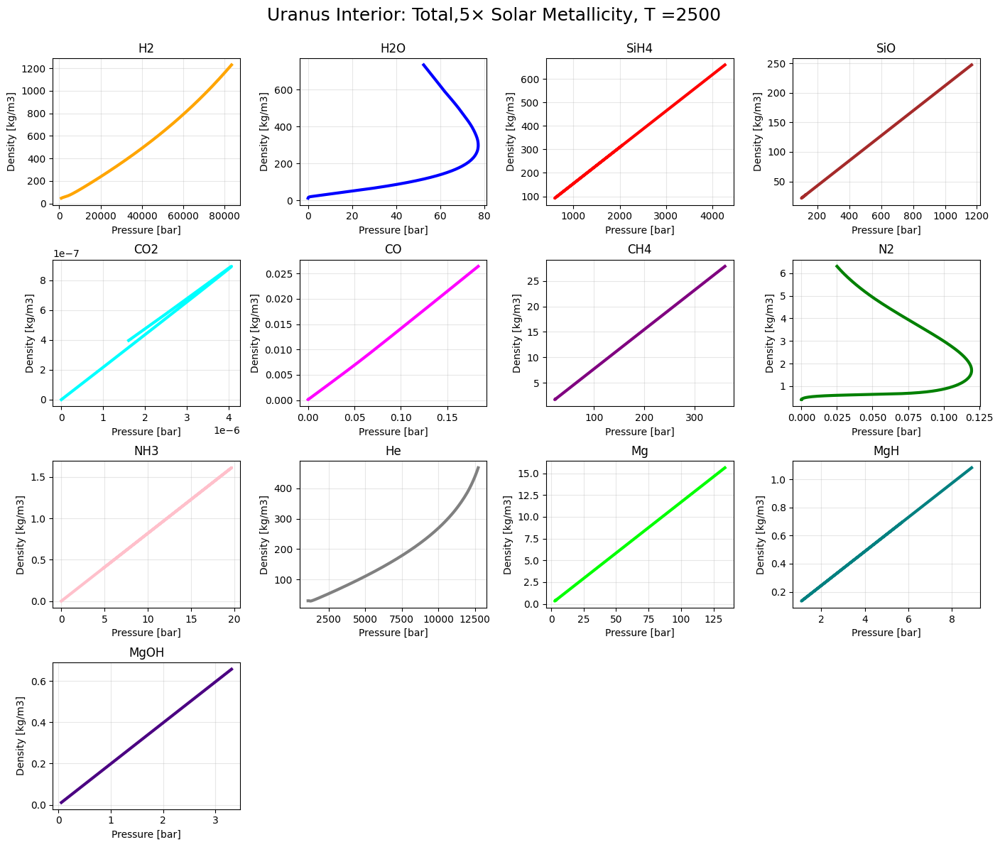

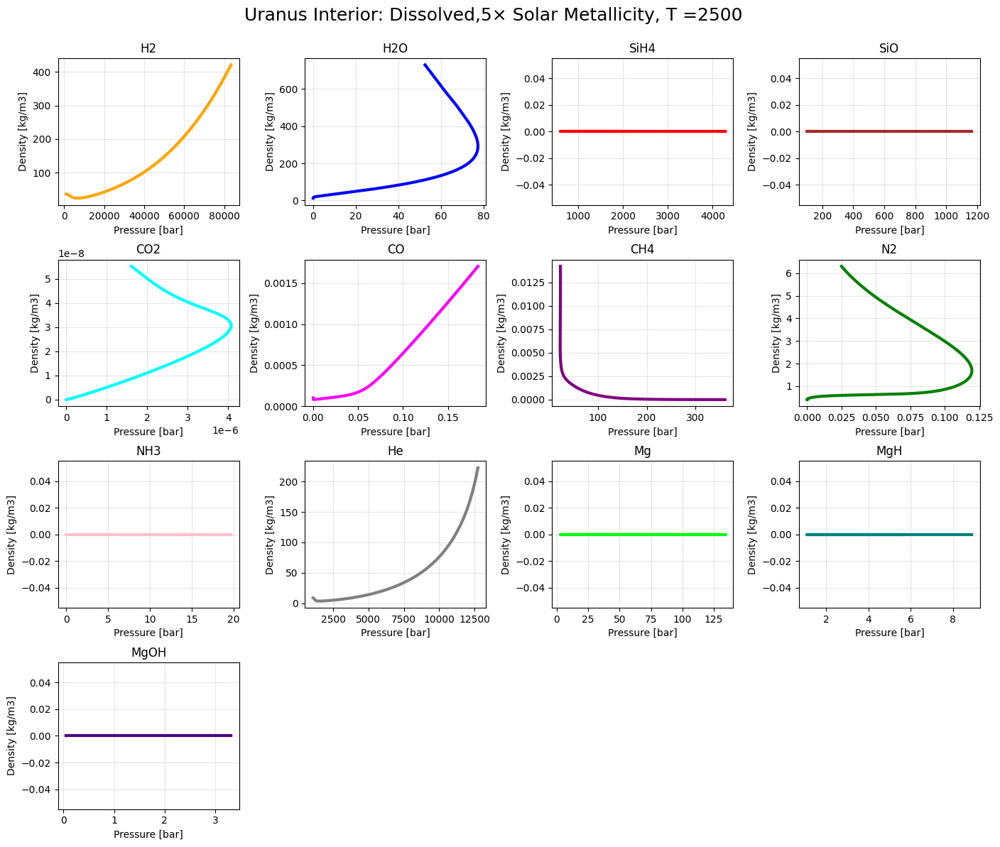

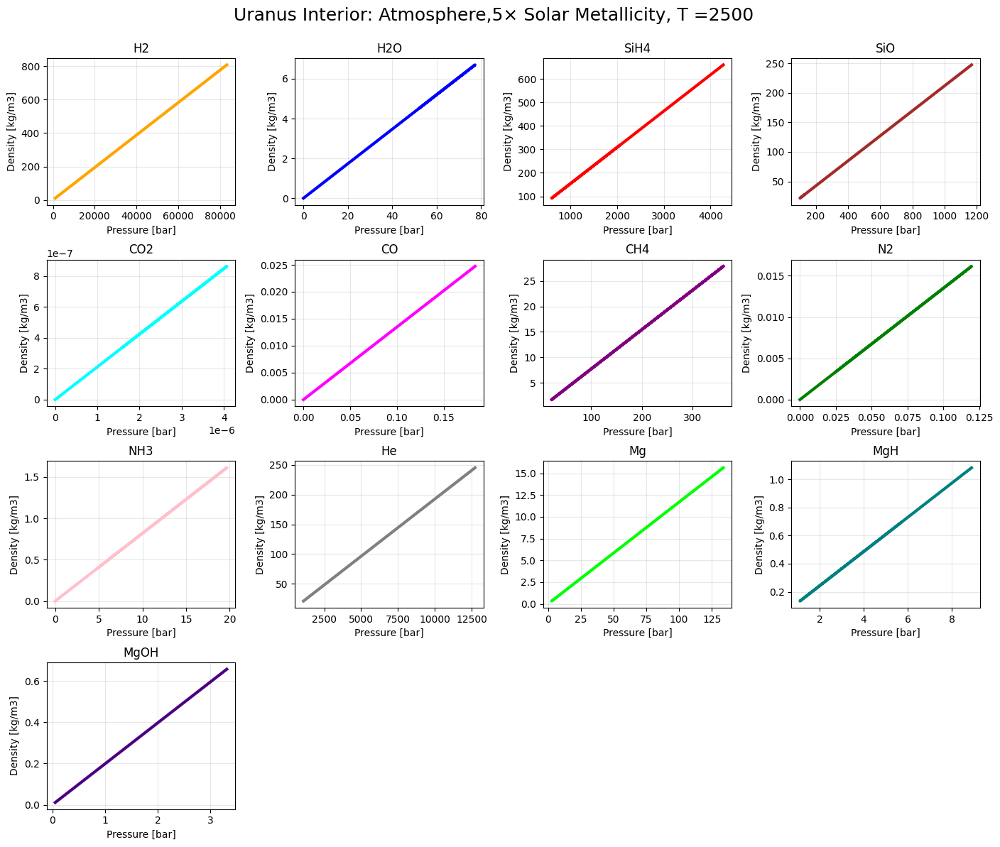

[20:20:03 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:20:03 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

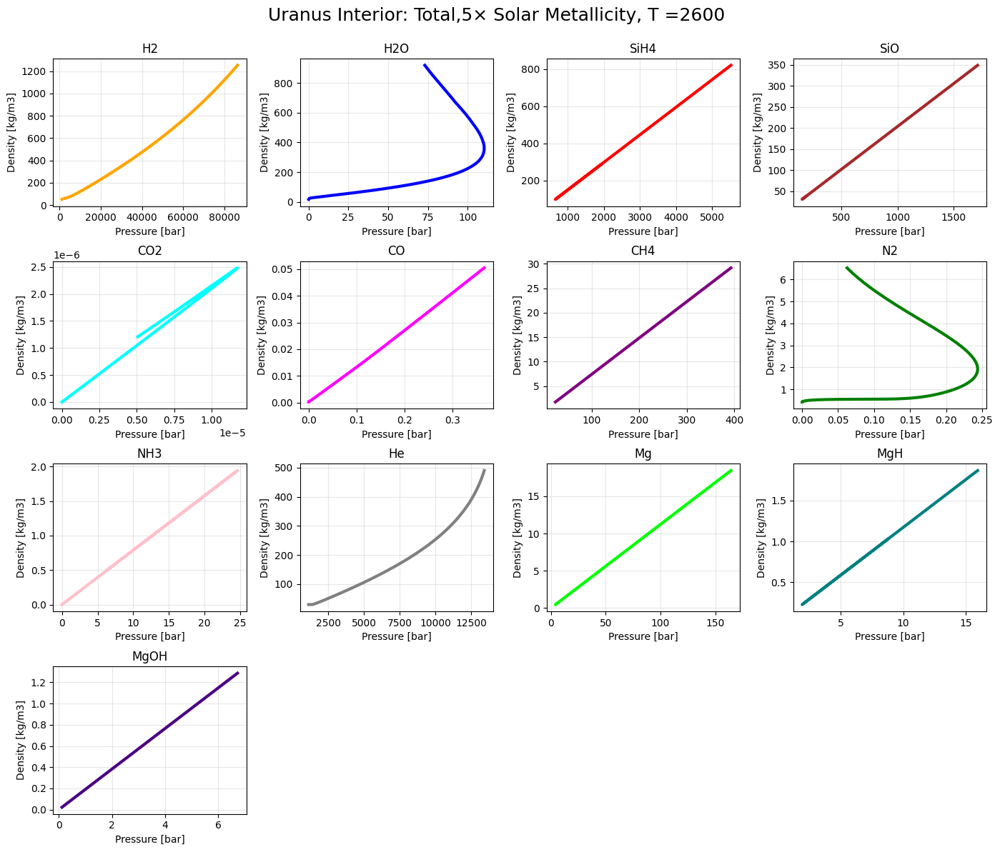

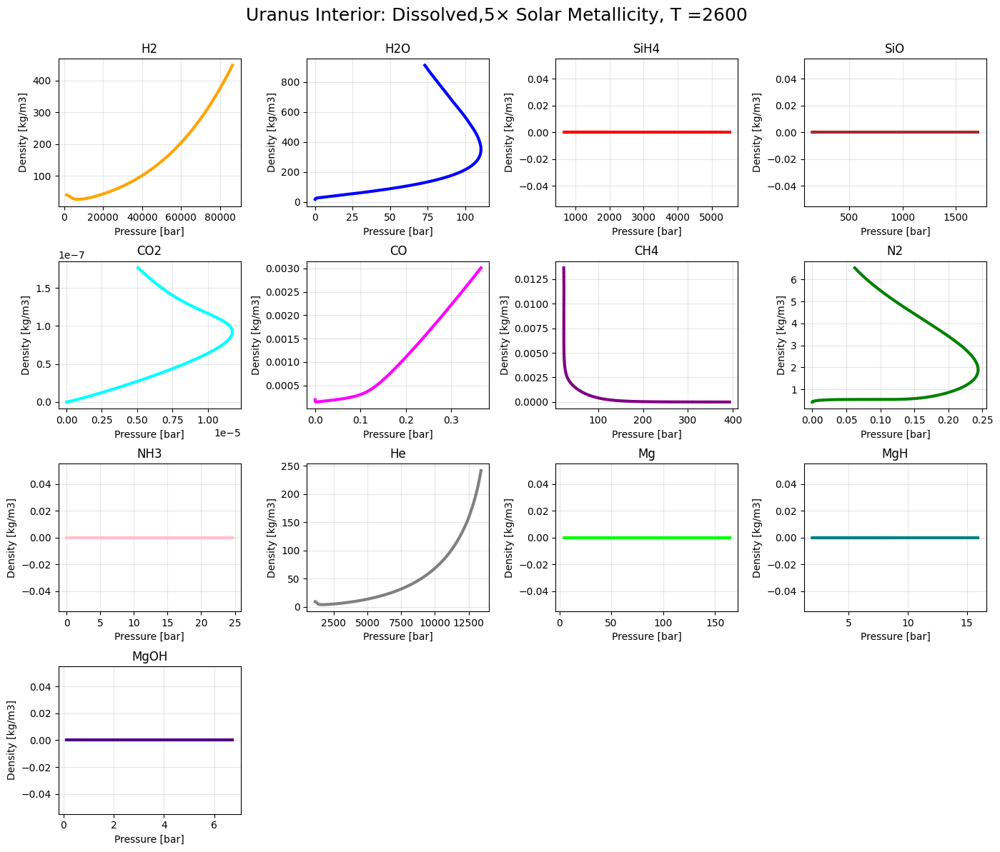

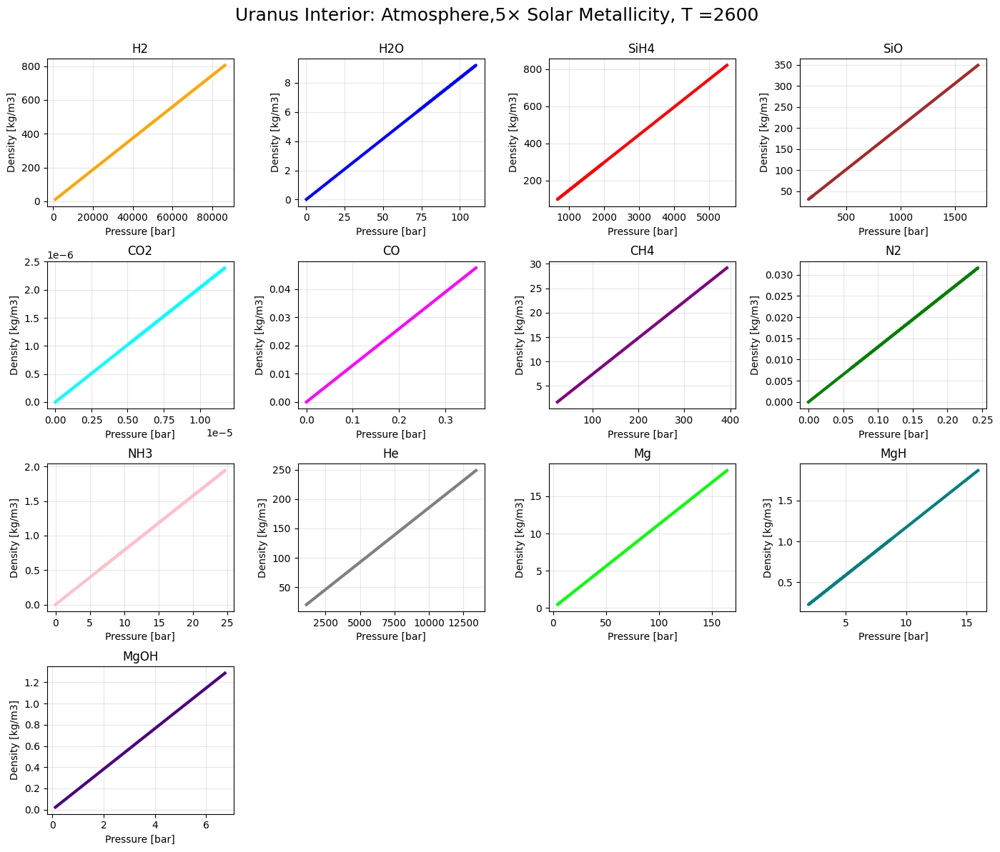

[20:20:59 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:20:59 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

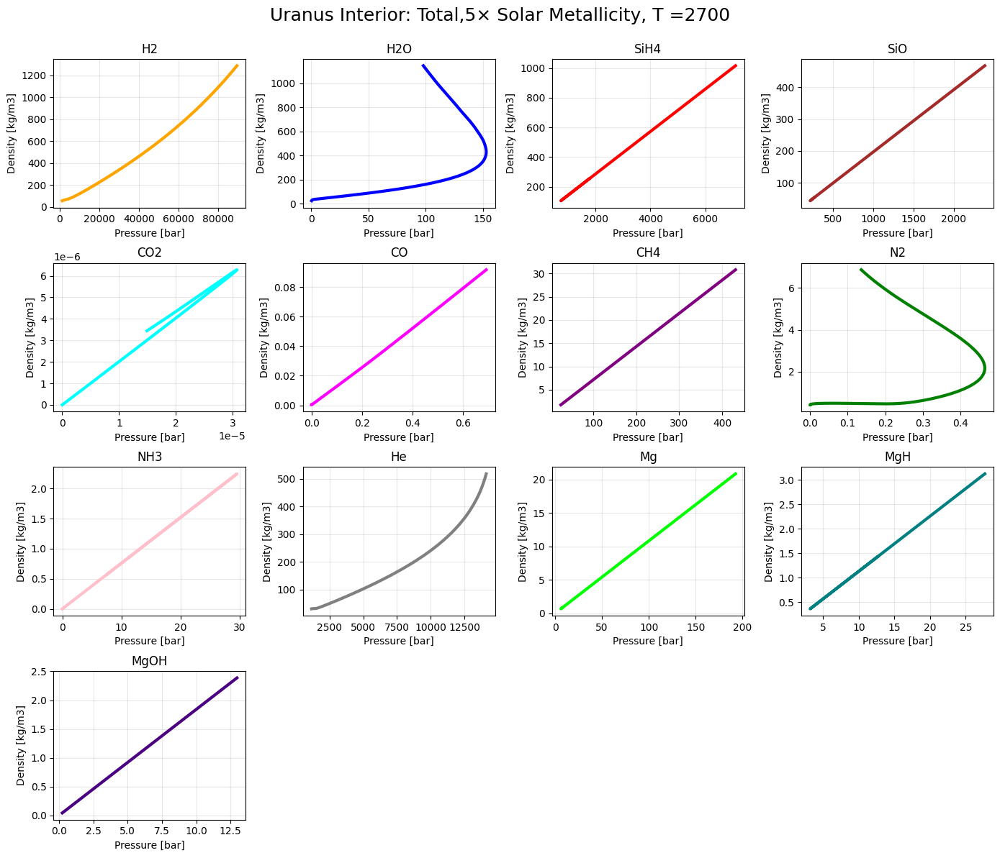

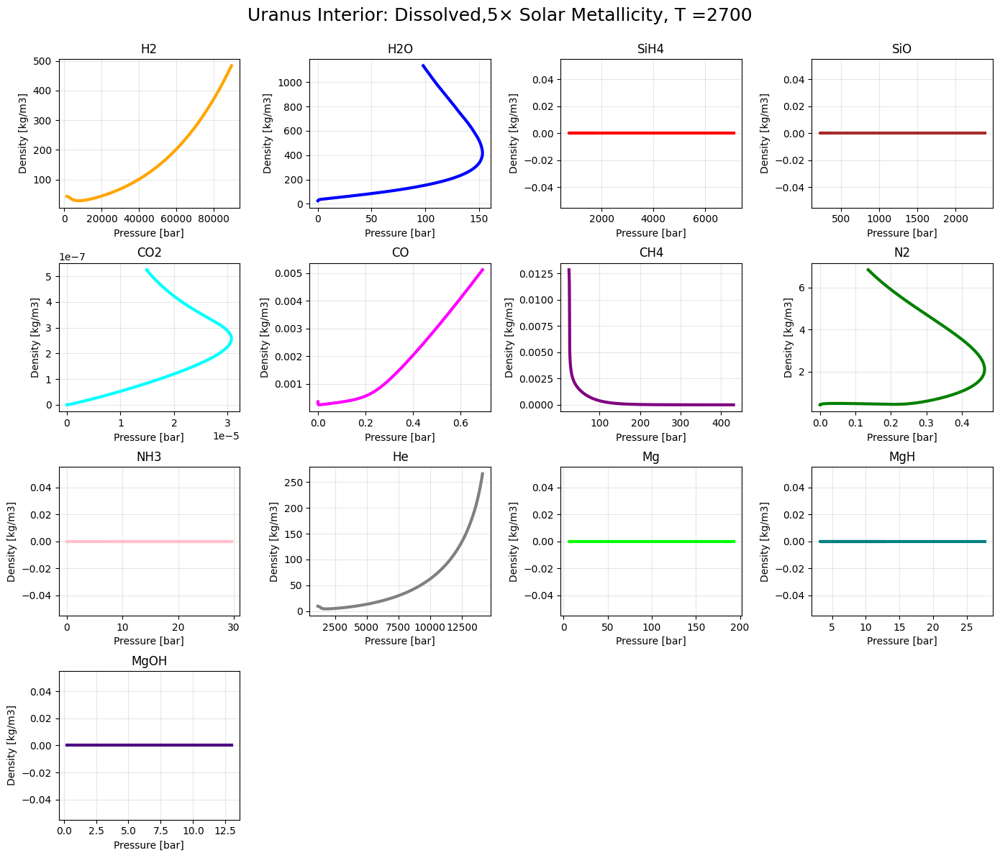

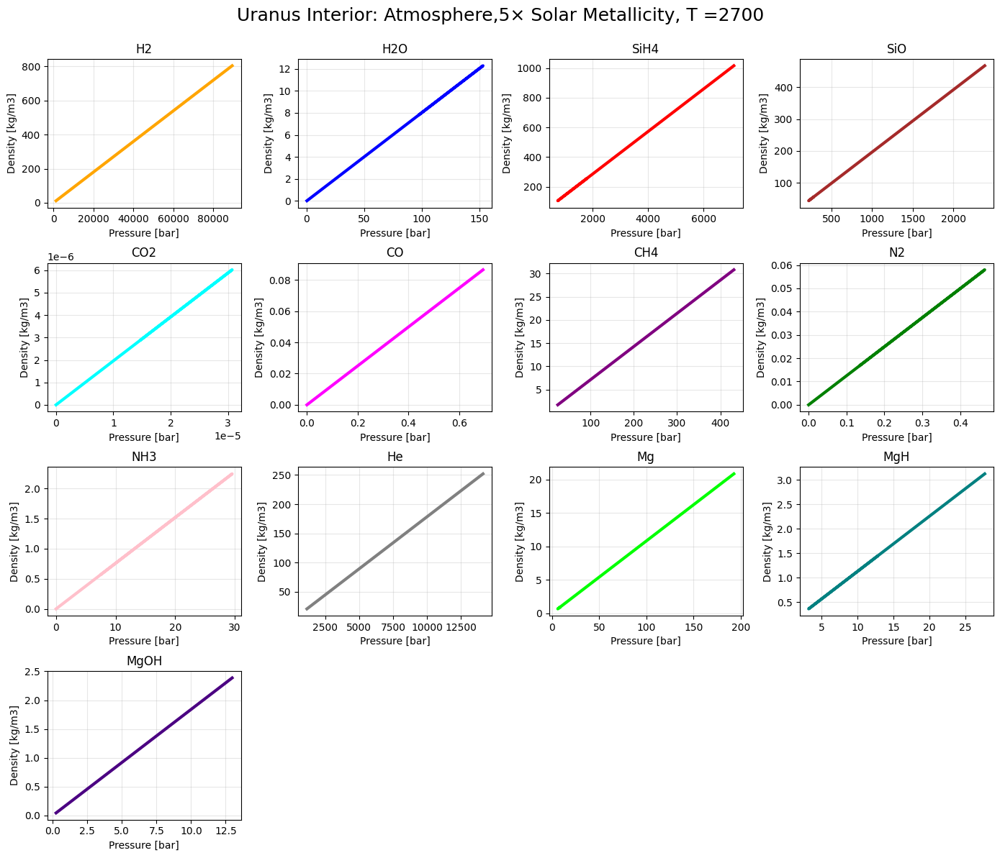

[20:21:50 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:21:50 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

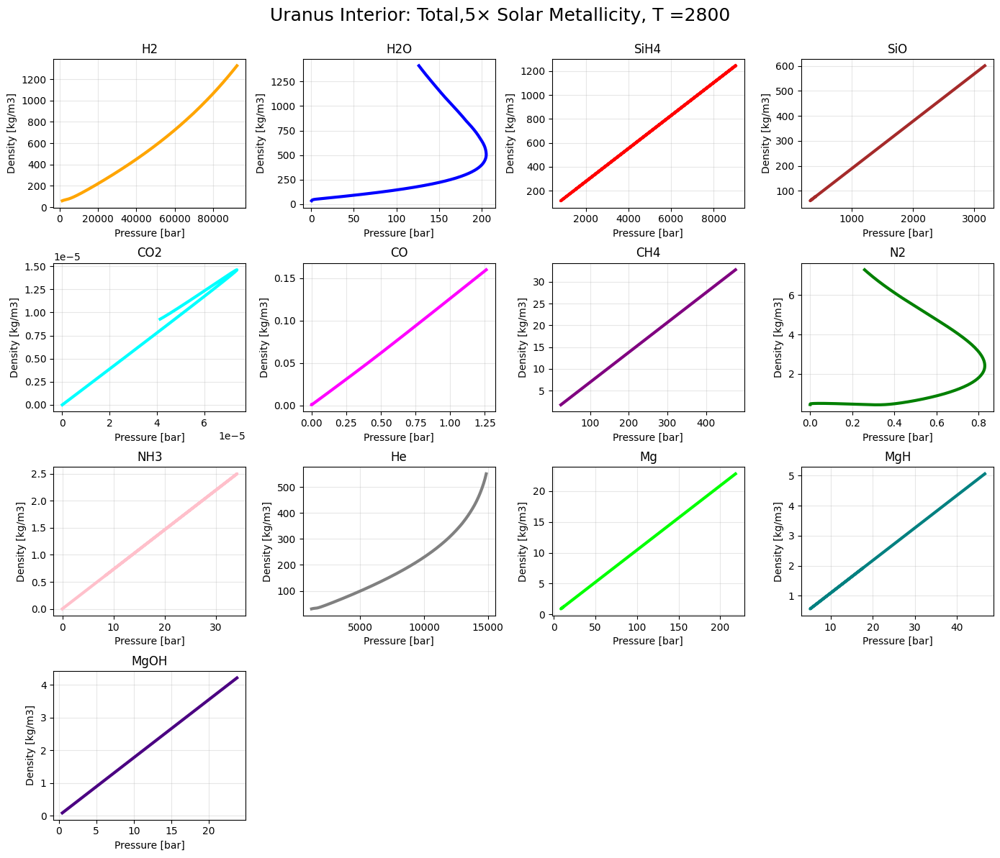

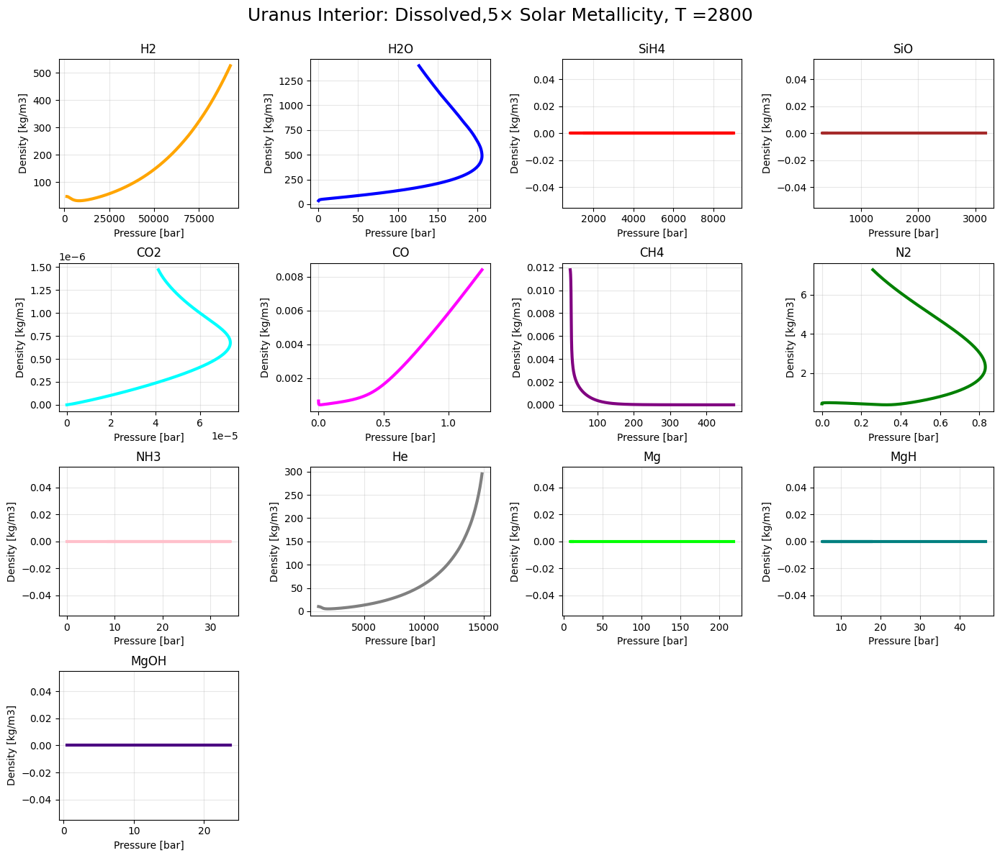

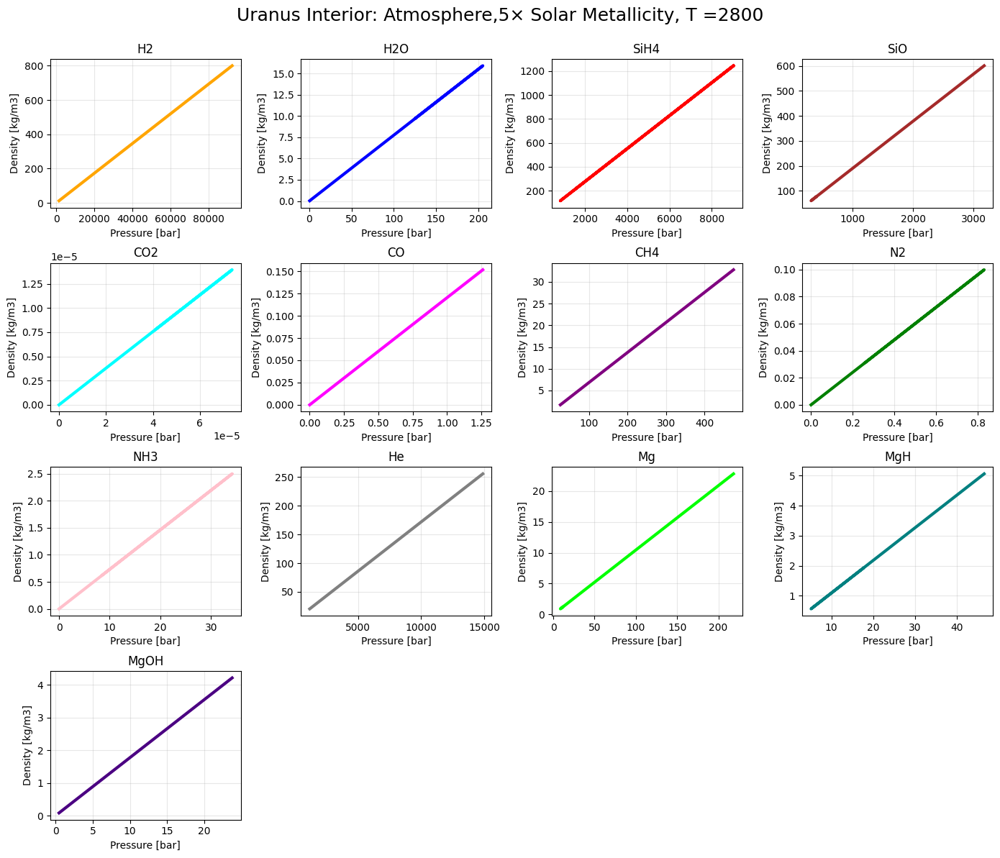

[20:22:41 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:22:41 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

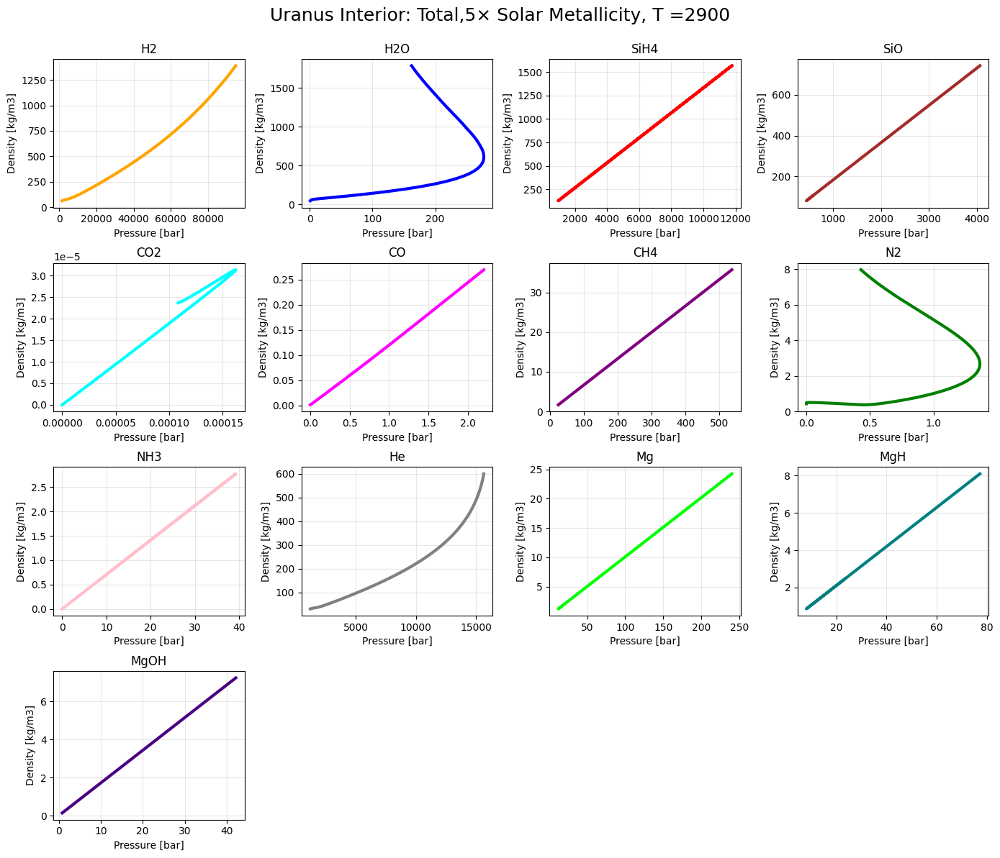

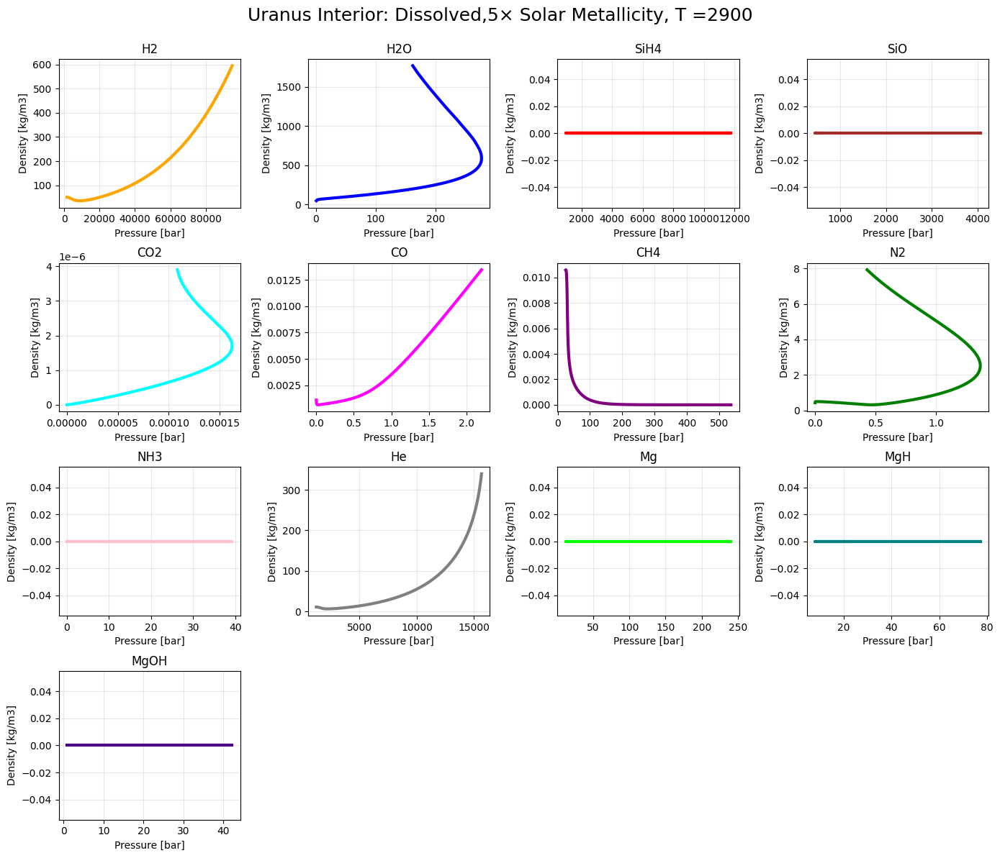

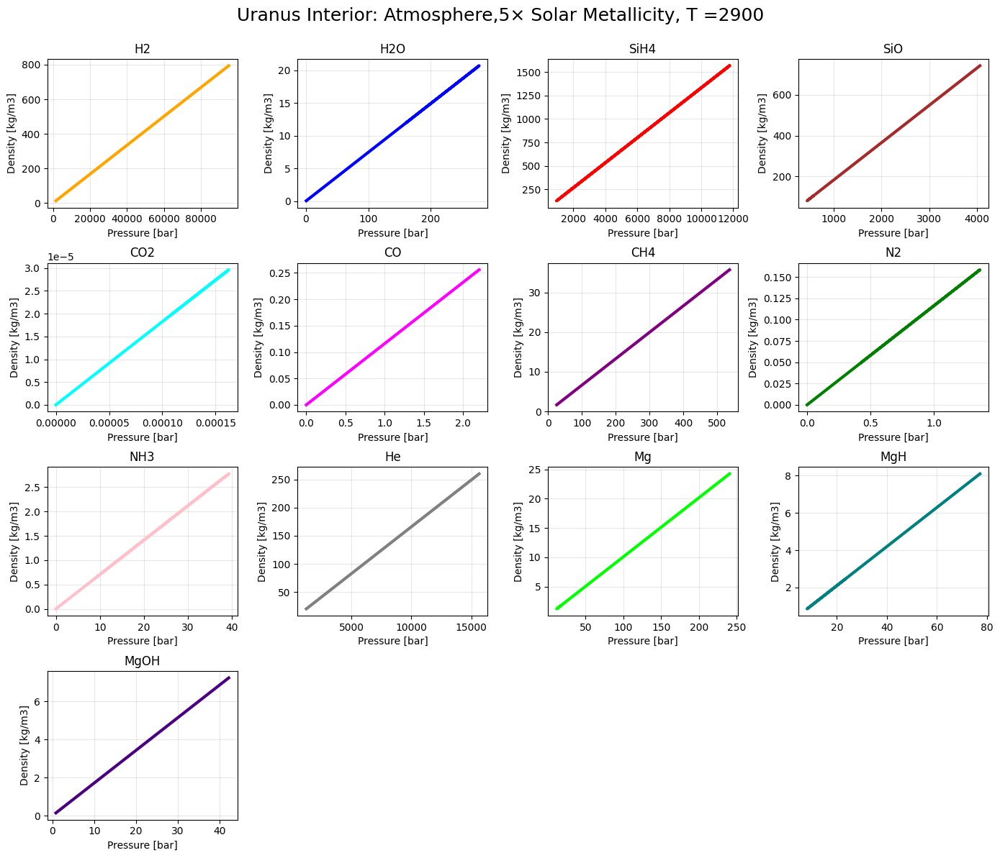

[20:23:34 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:23:34 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

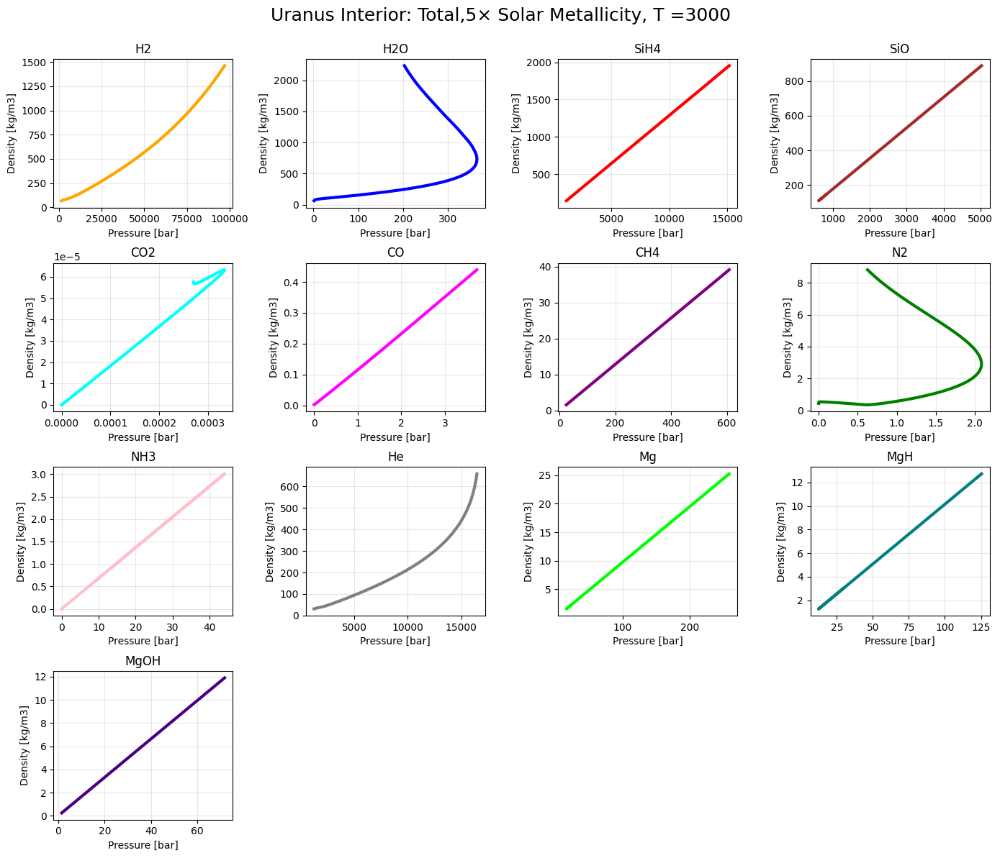

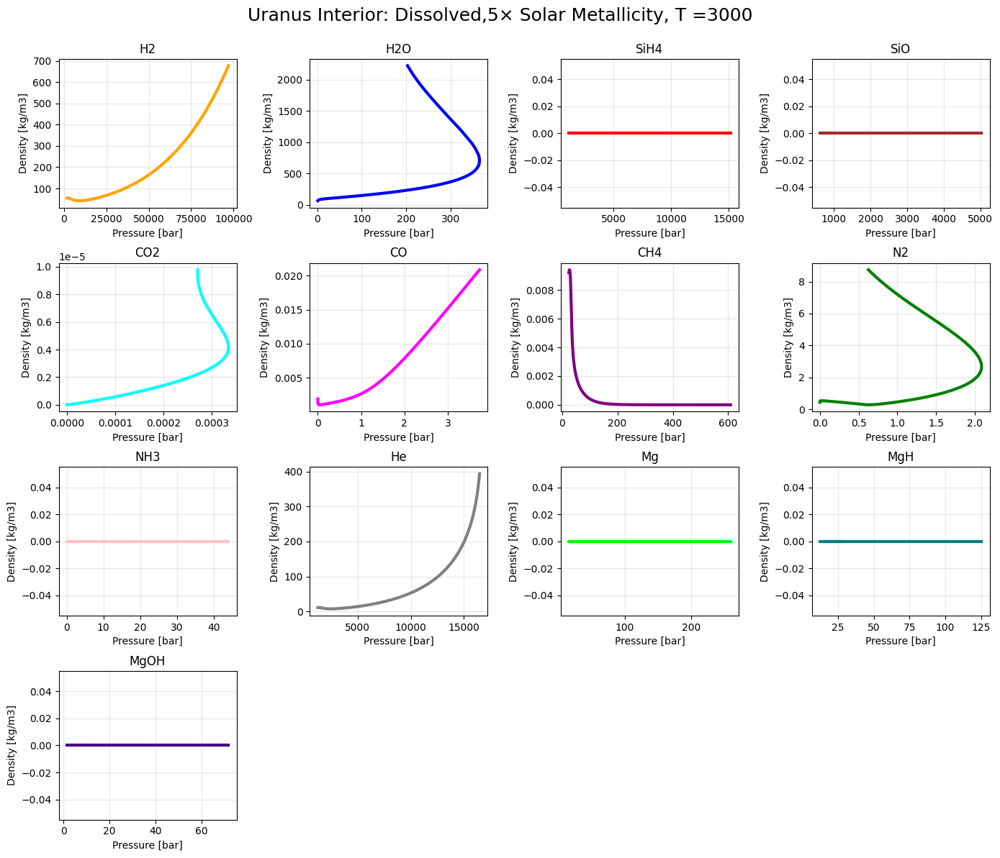

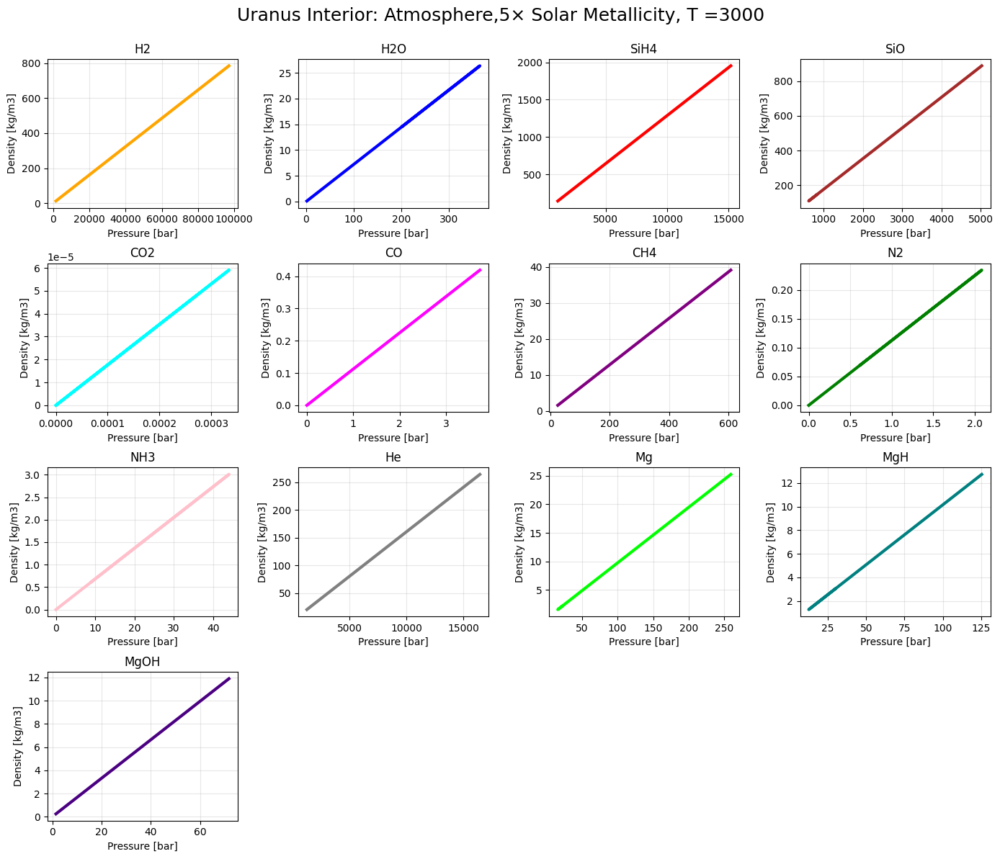

[20:24:29 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:24:29 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

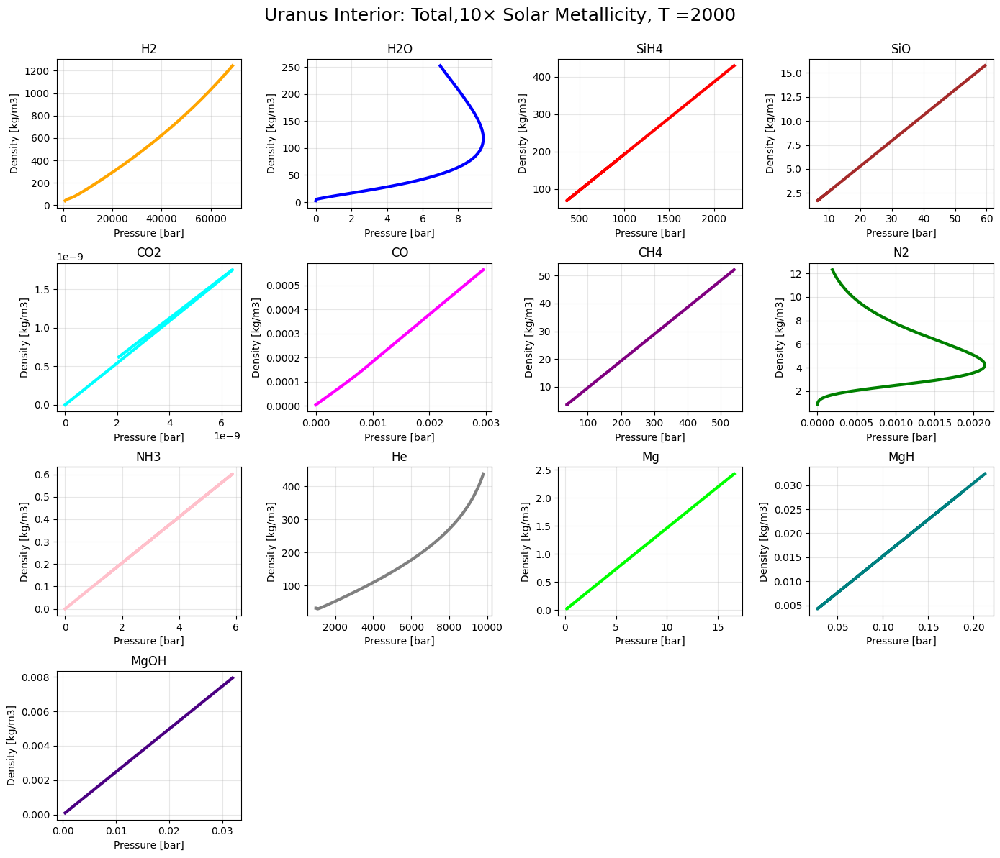

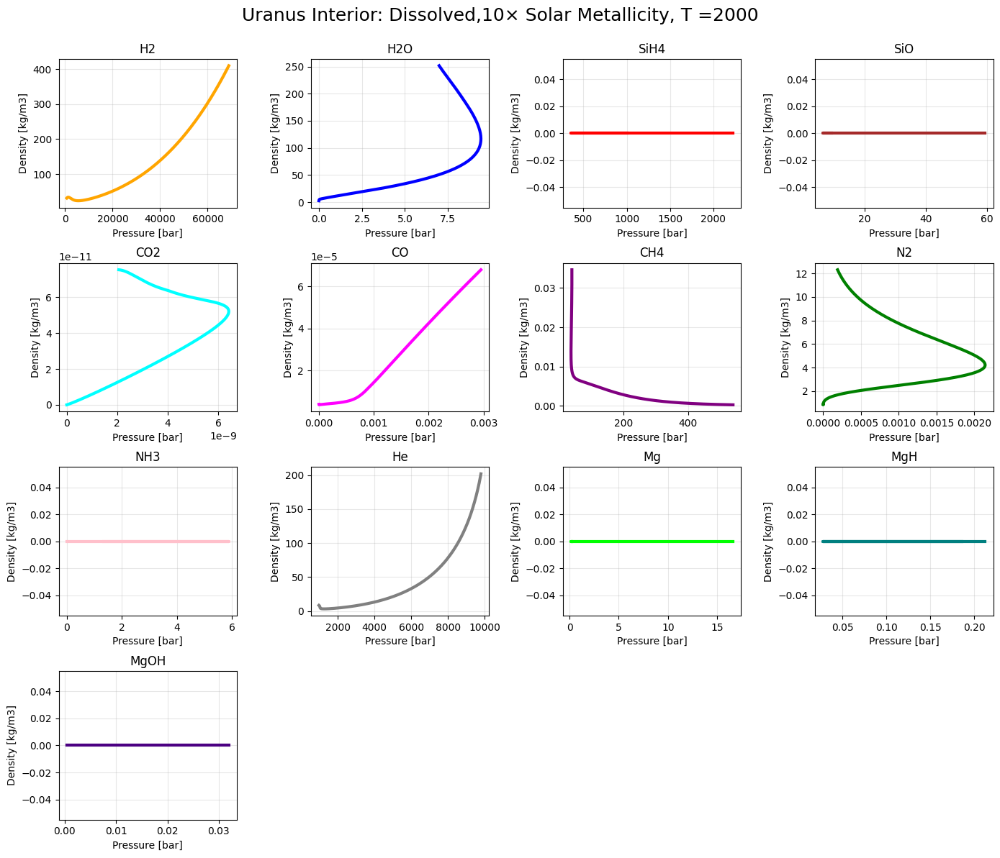

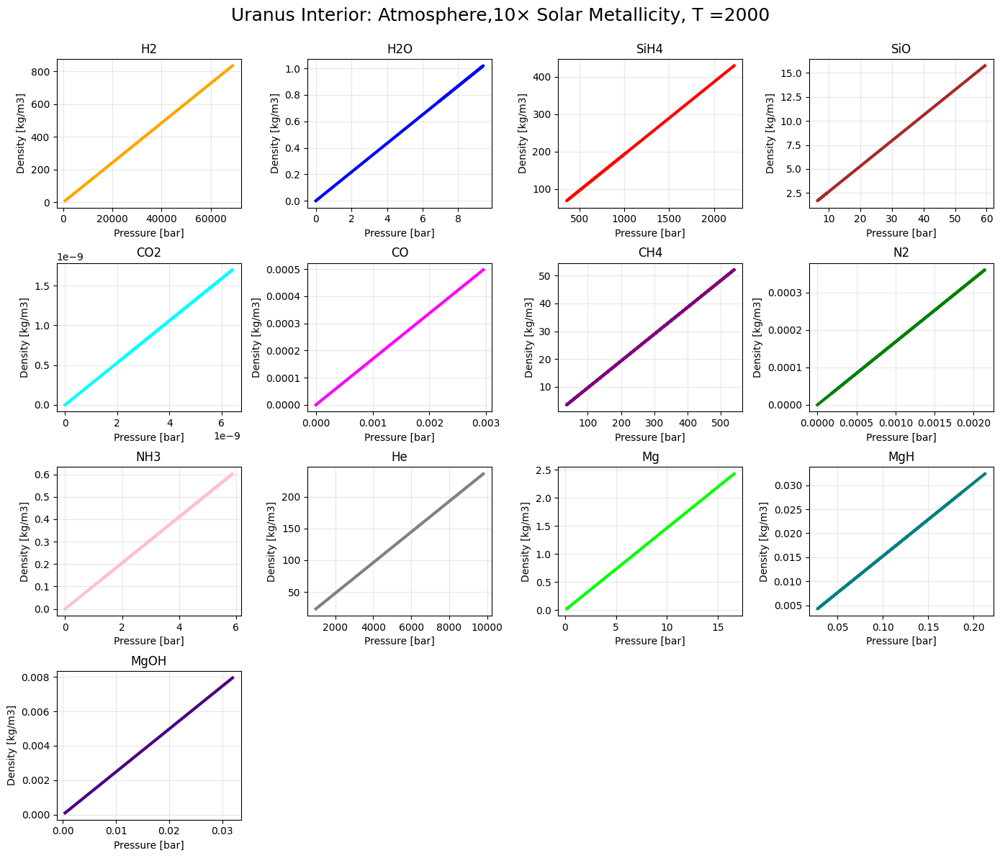

[20:25:44 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:25:44 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

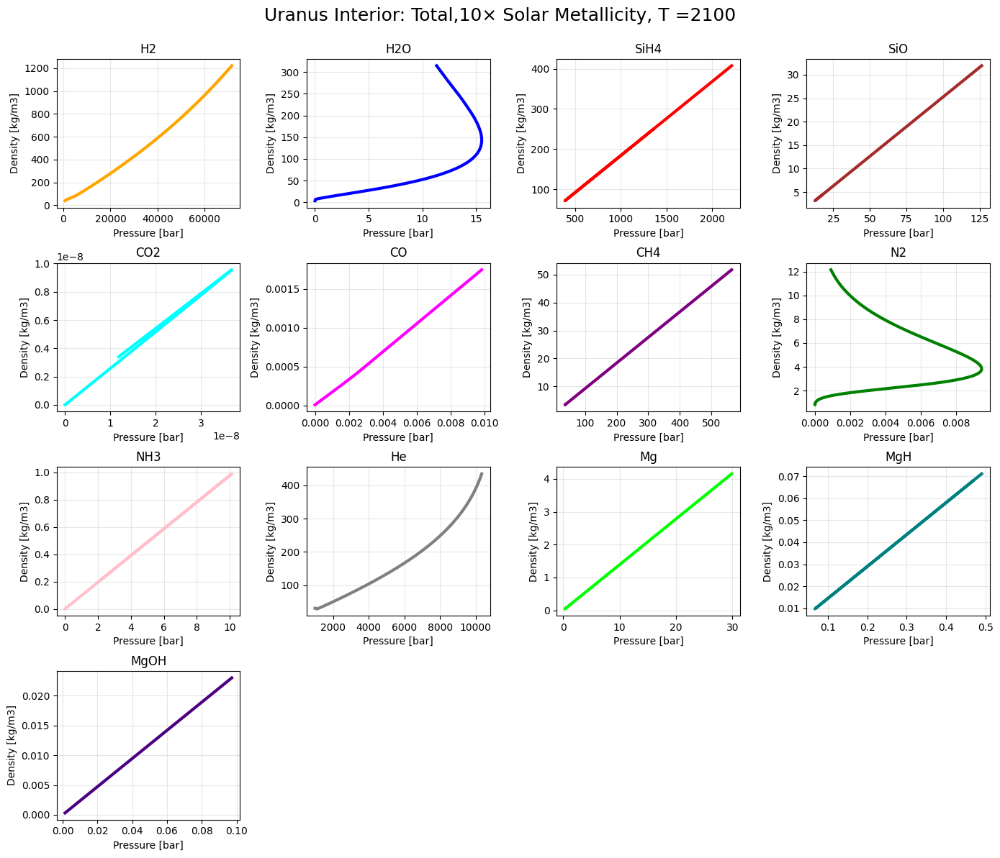

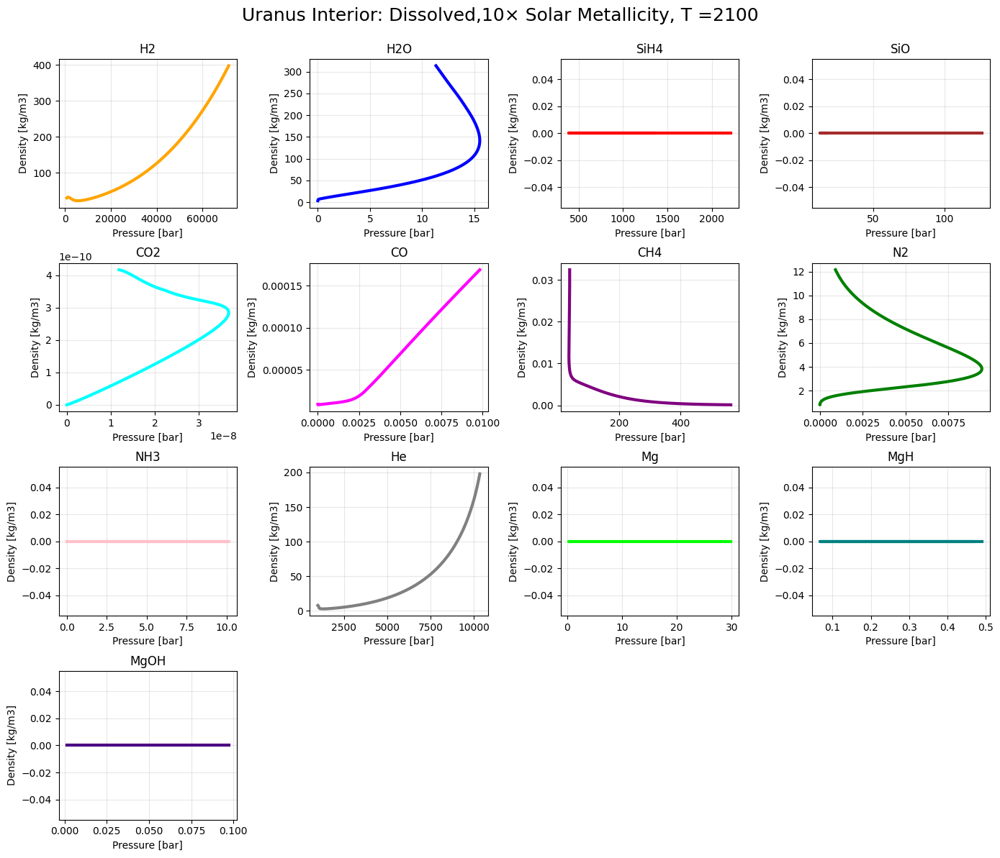

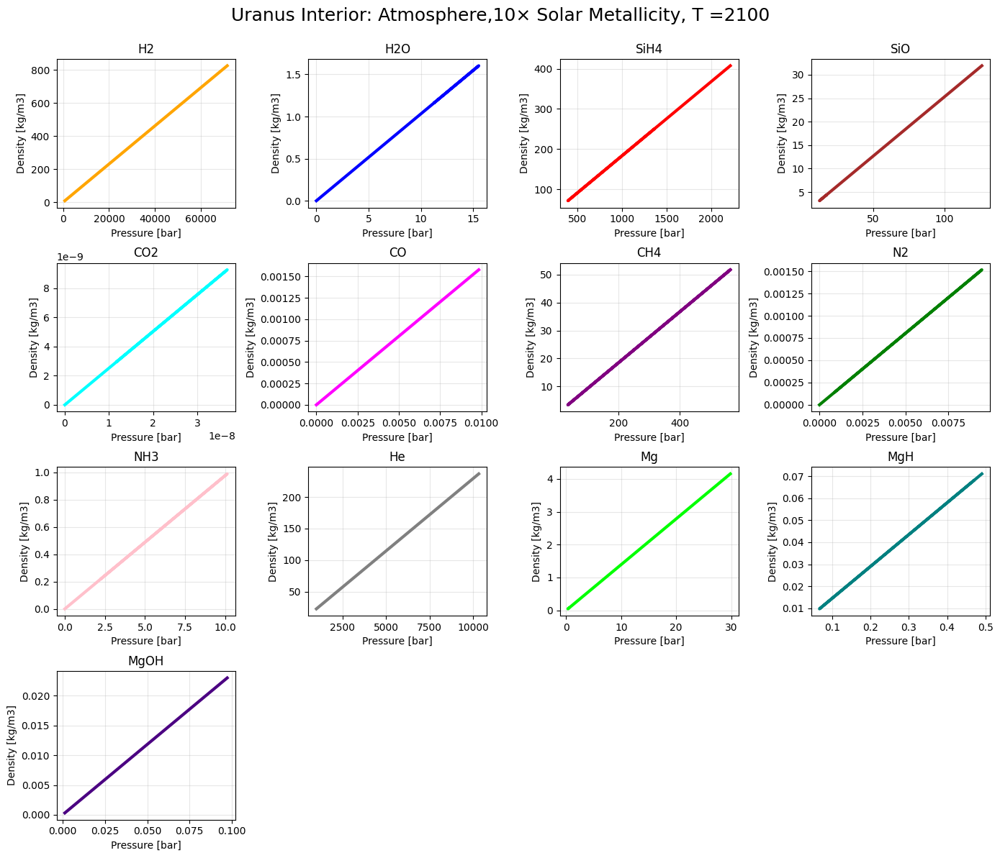

[20:26:58 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:26:58 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

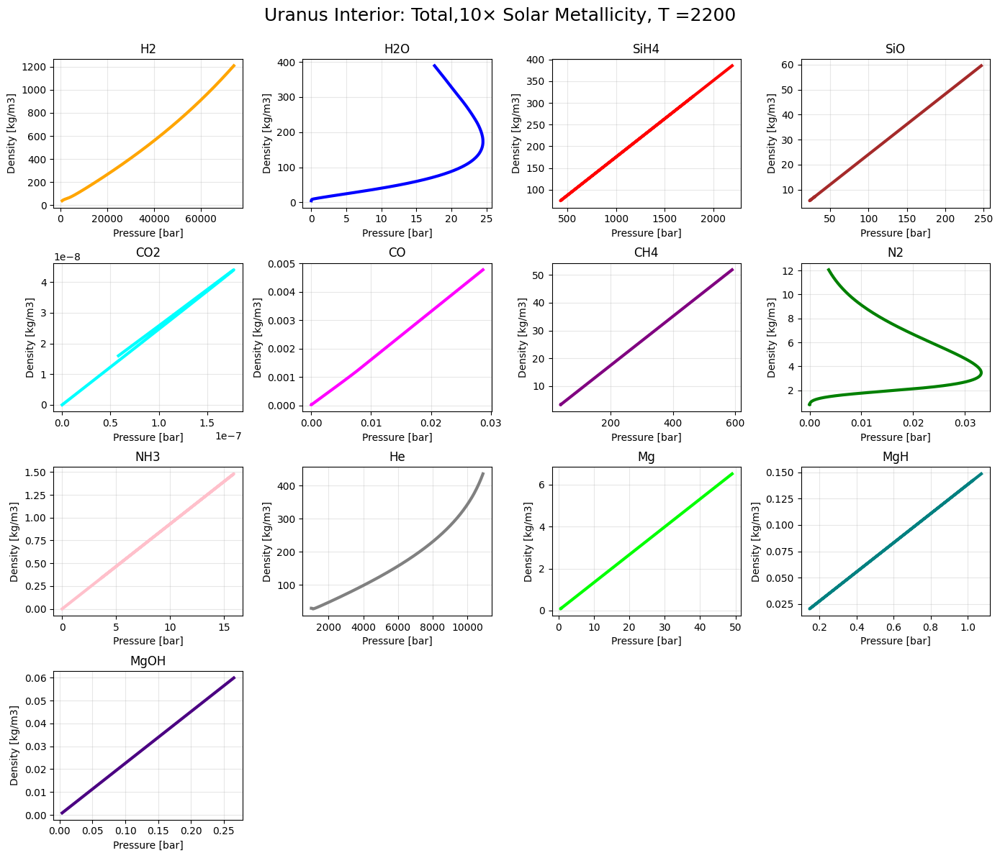

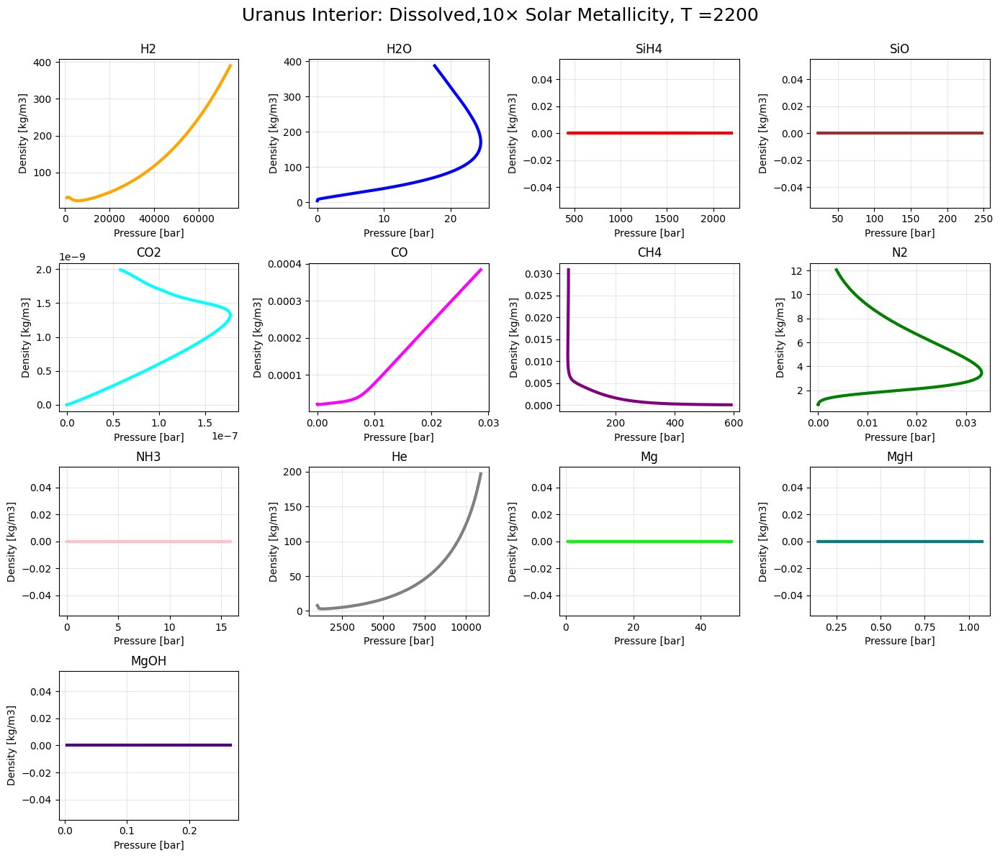

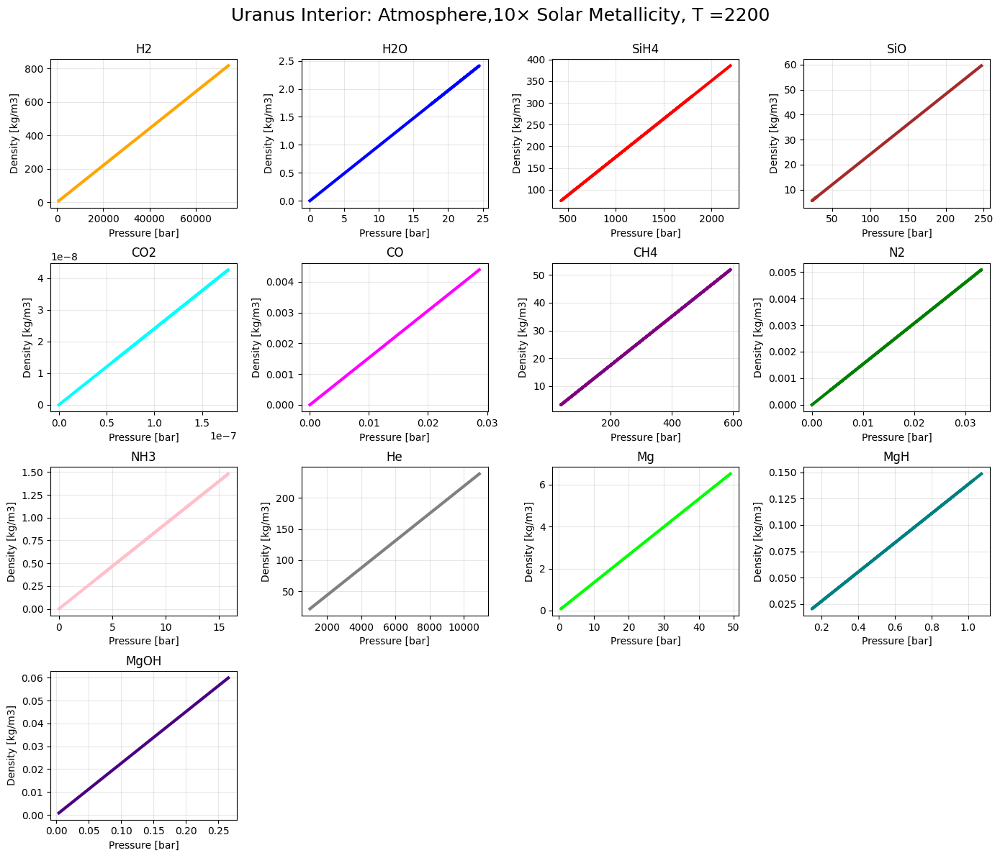

[20:28:12 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:28:12 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

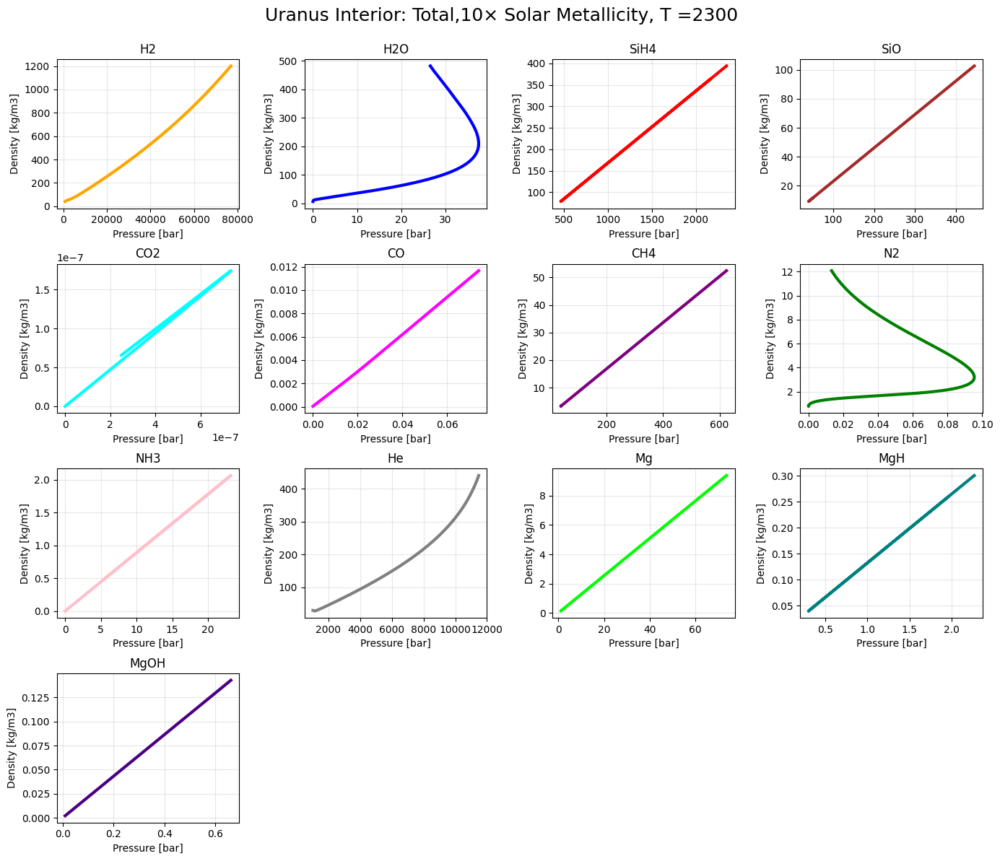

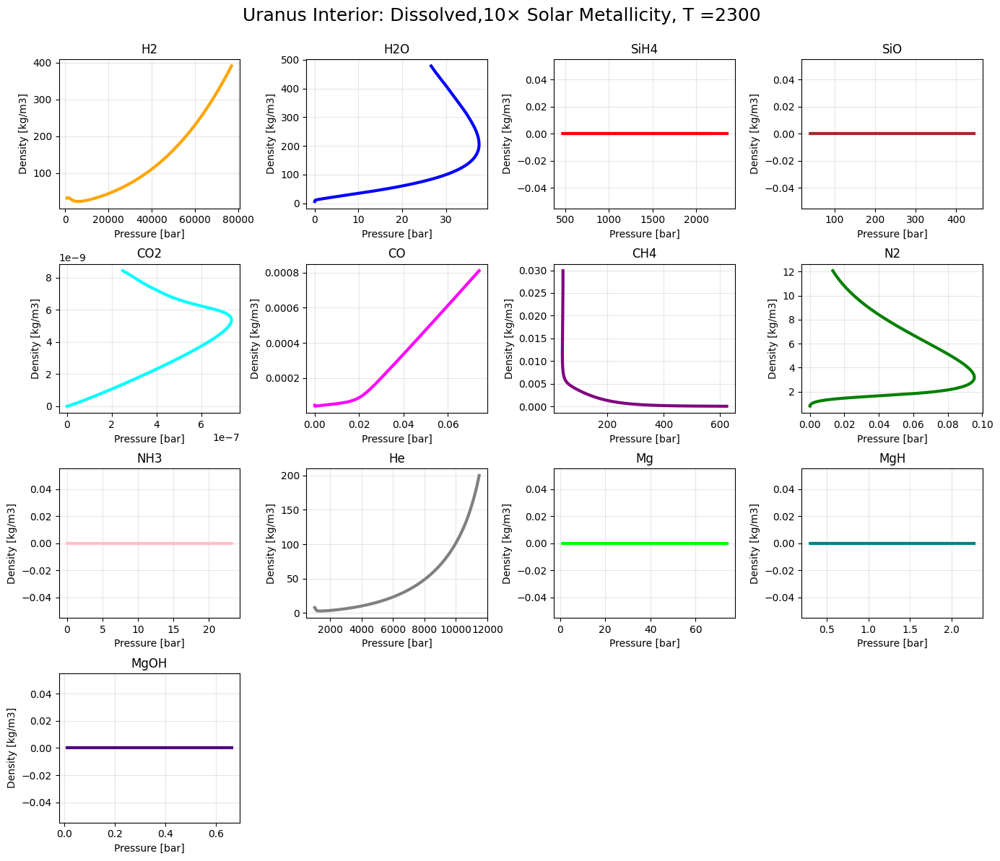

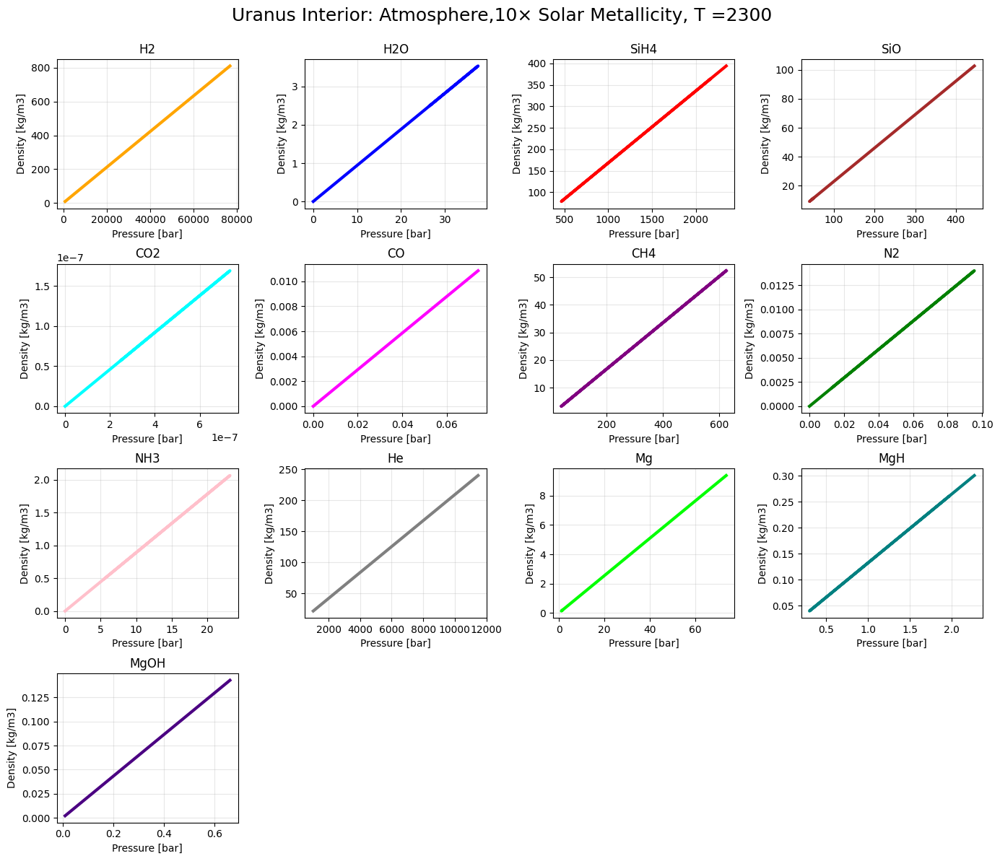

[20:29:25 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:29:25 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

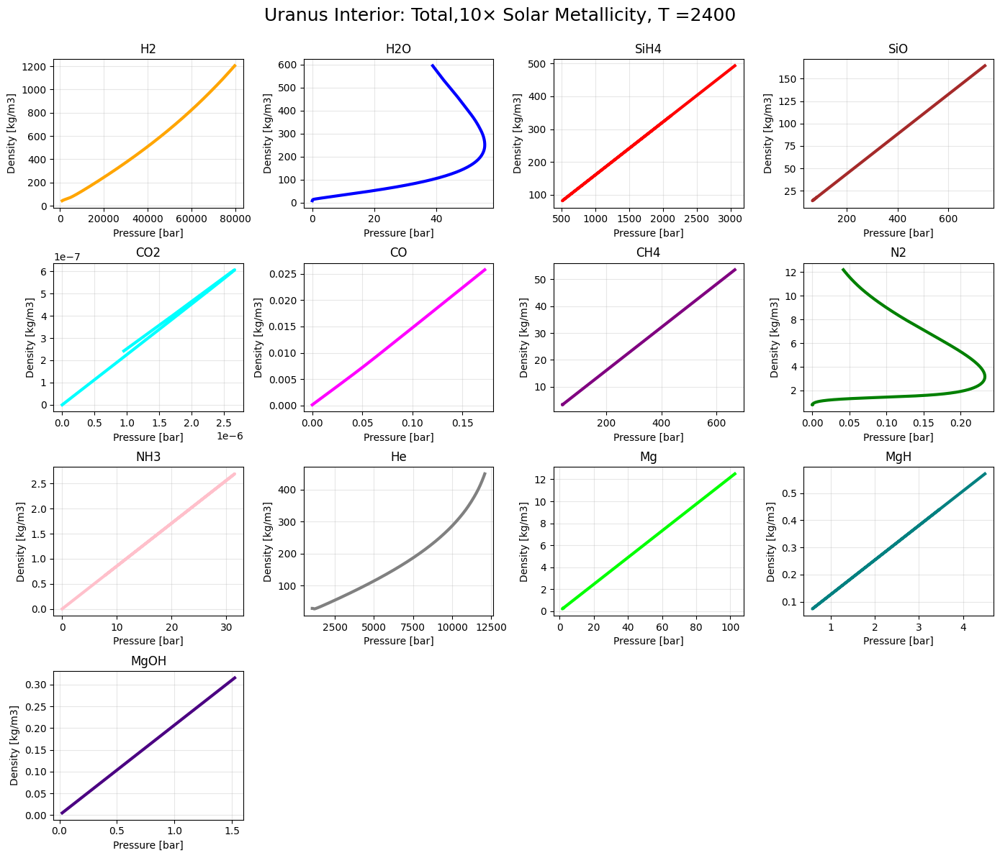

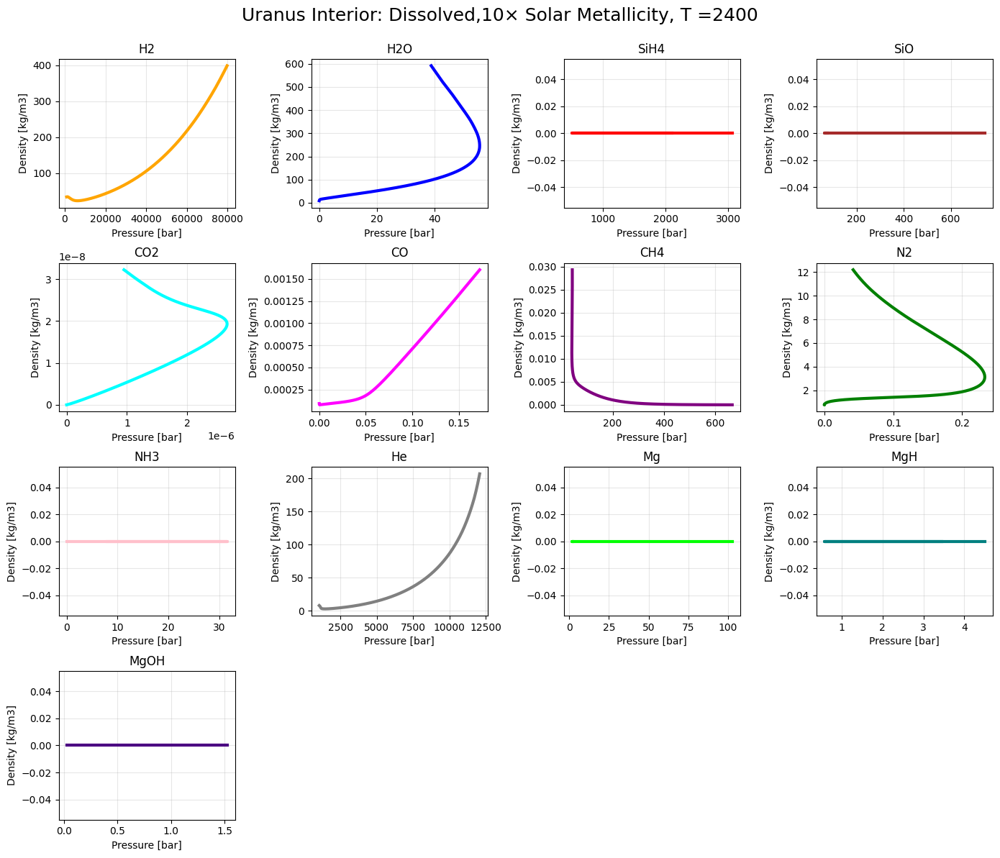

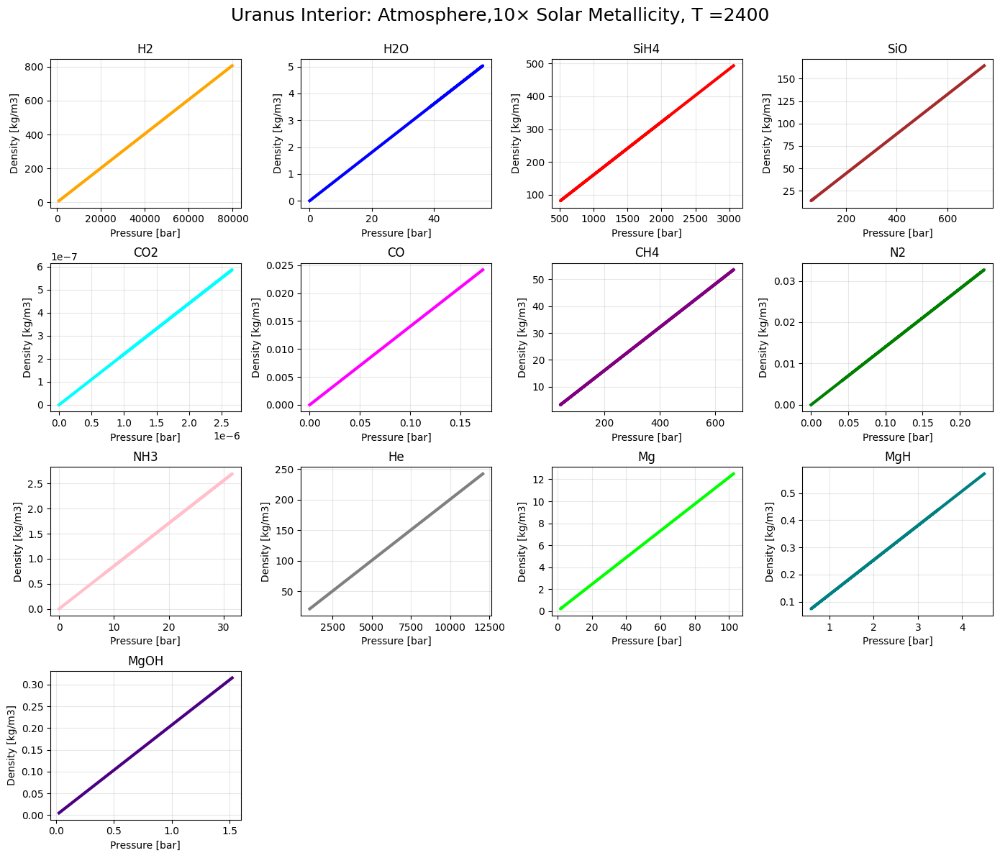

[20:30:39 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:30:39 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

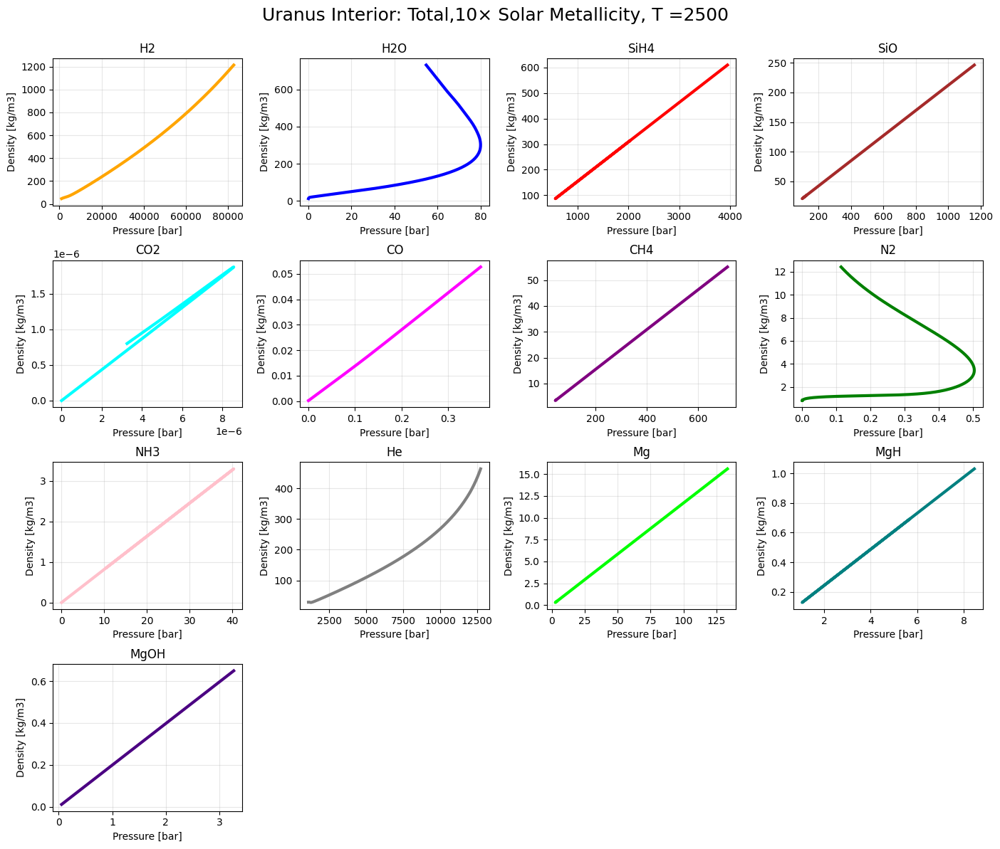

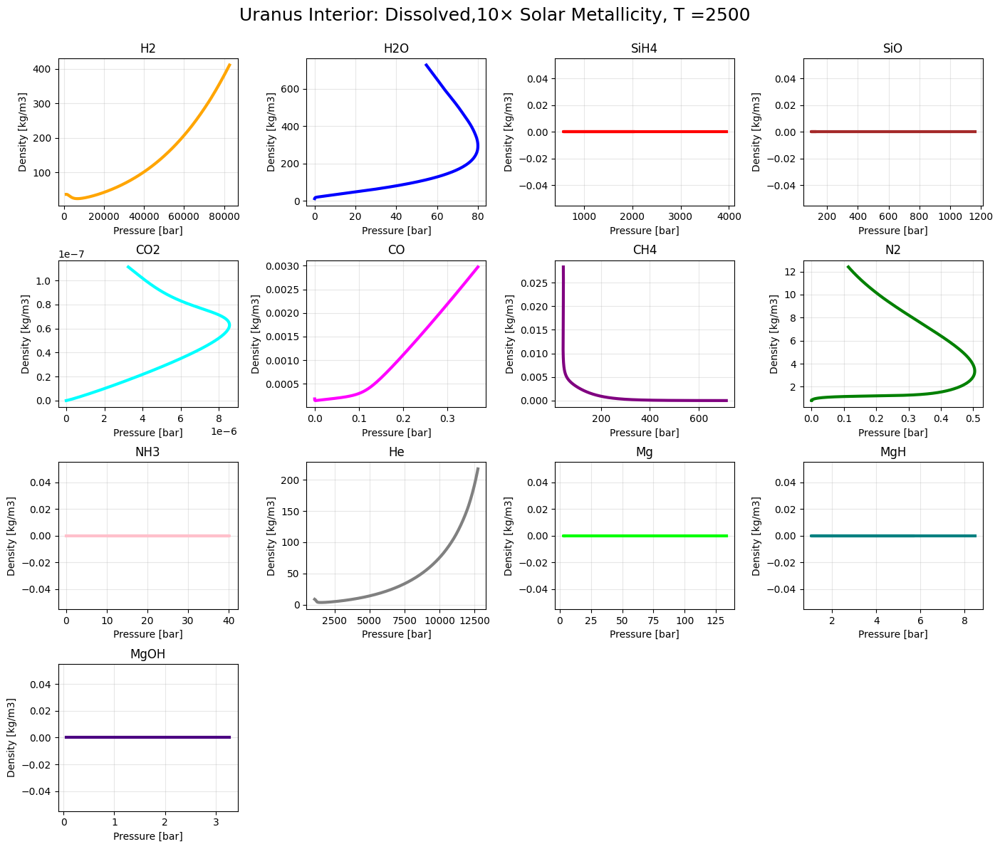

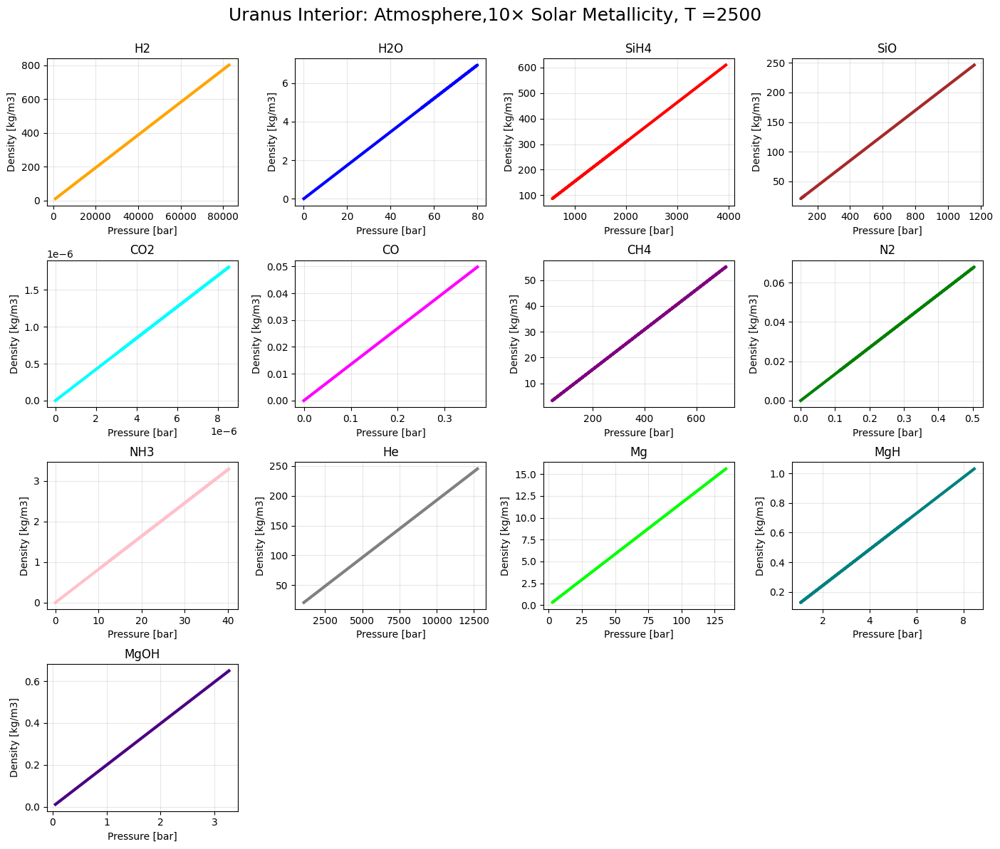

[20:31:39 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:31:39 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

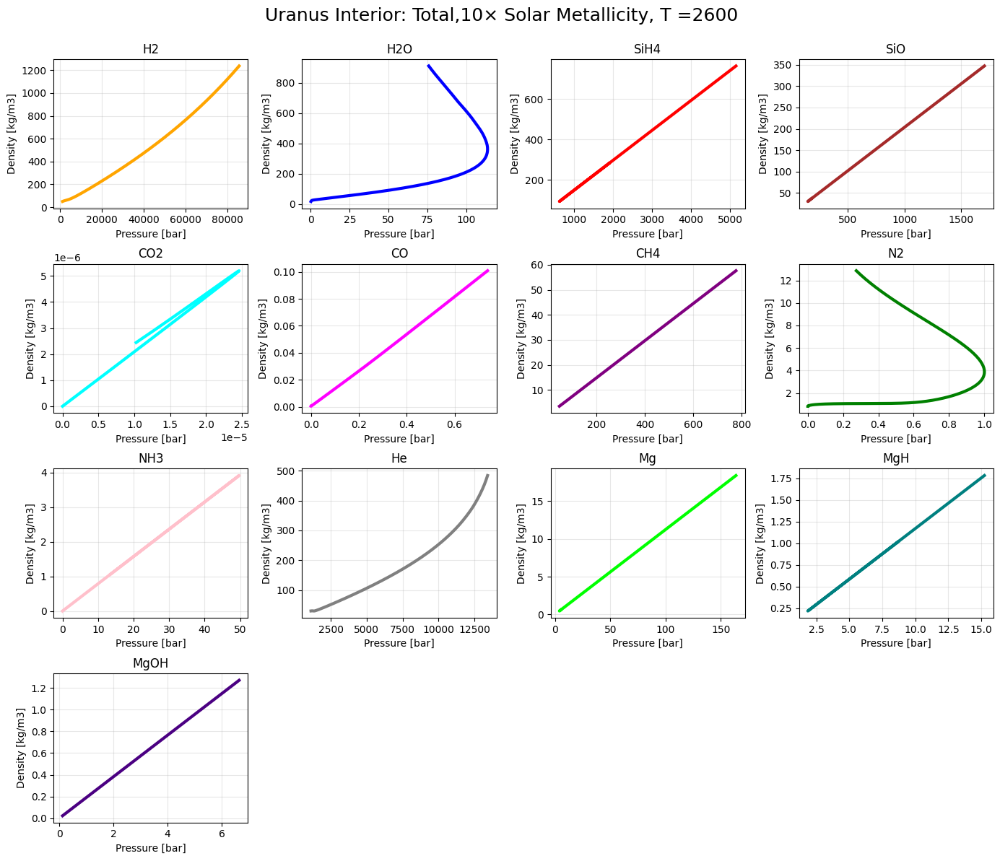

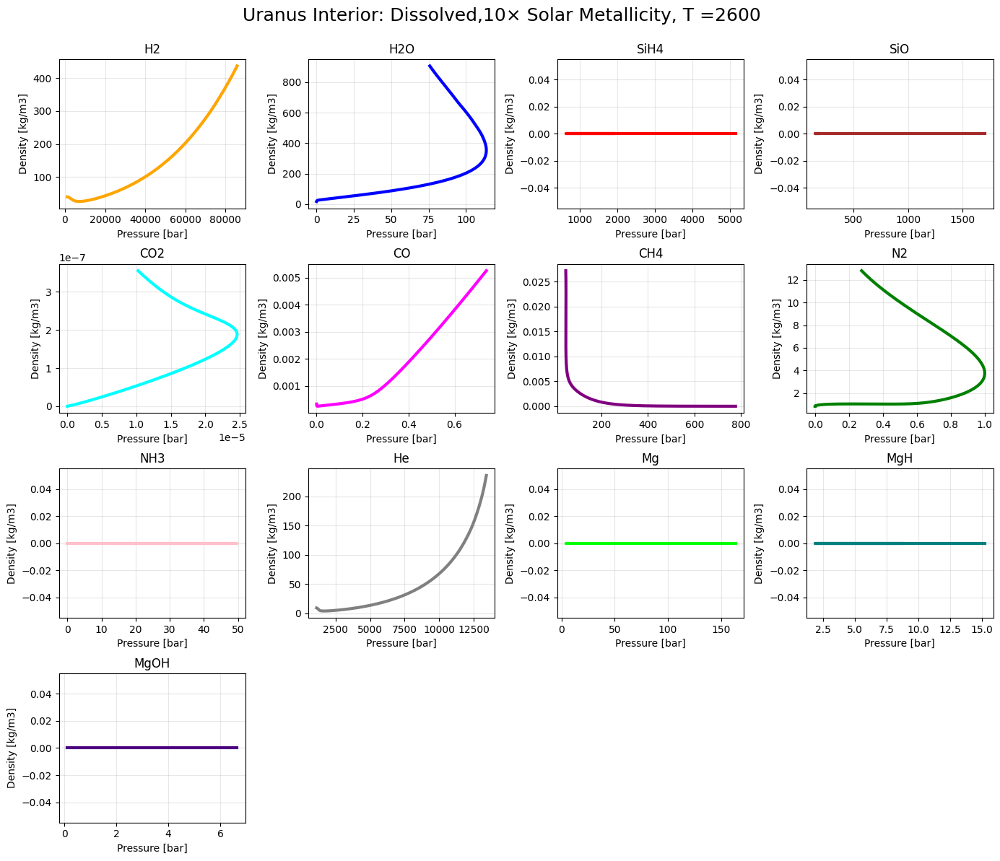

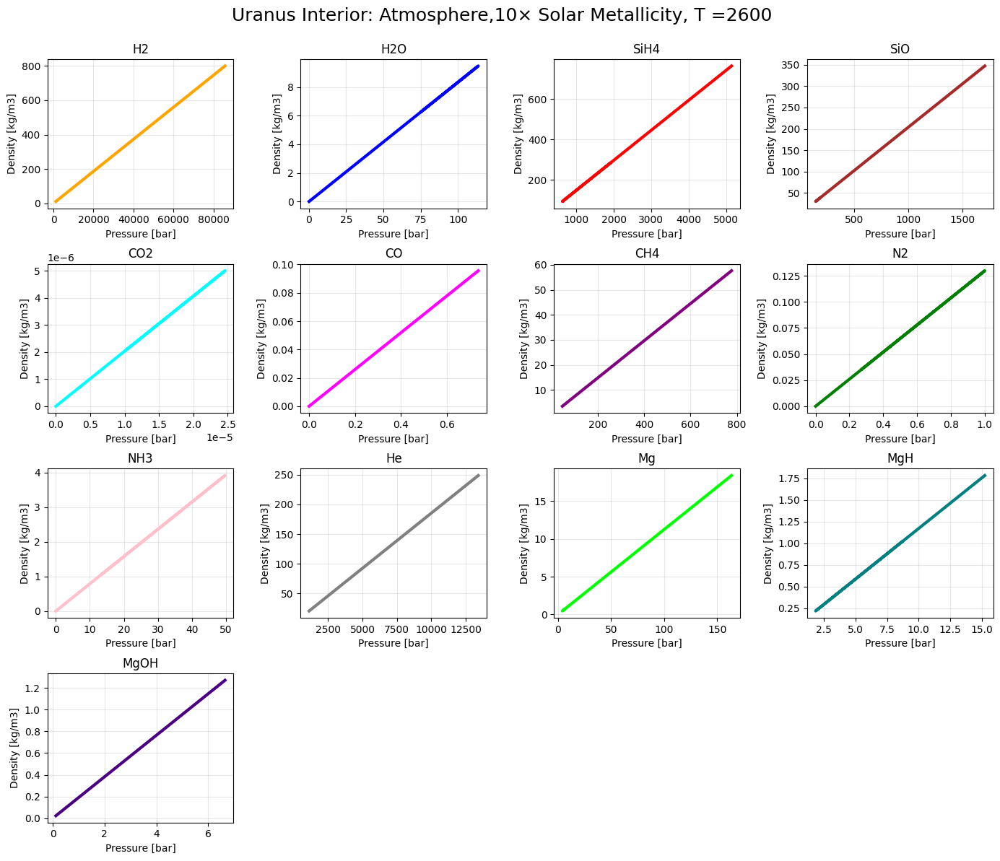

[20:32:33 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:32:33 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

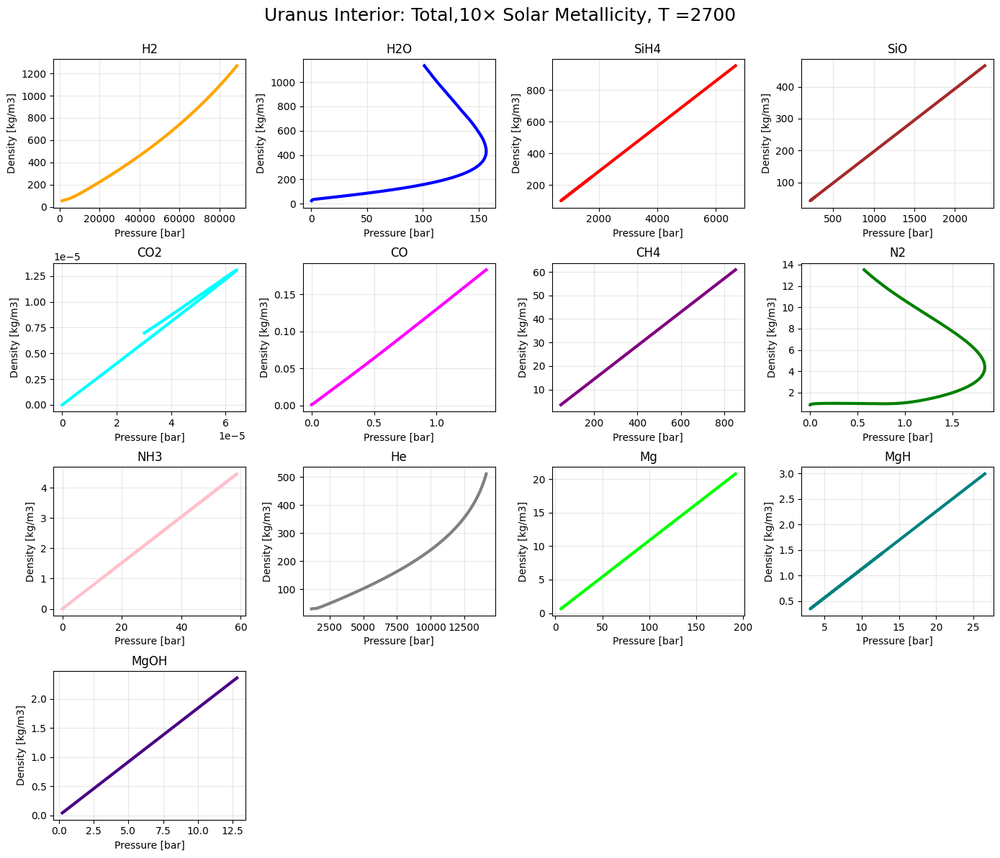

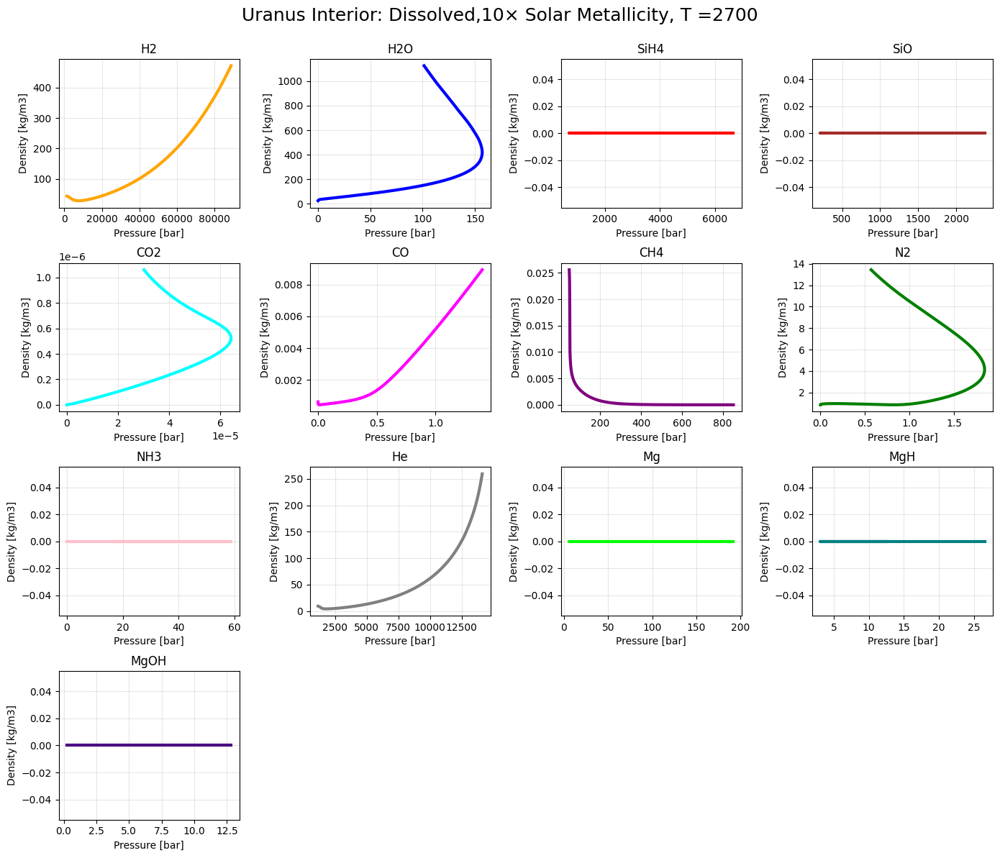

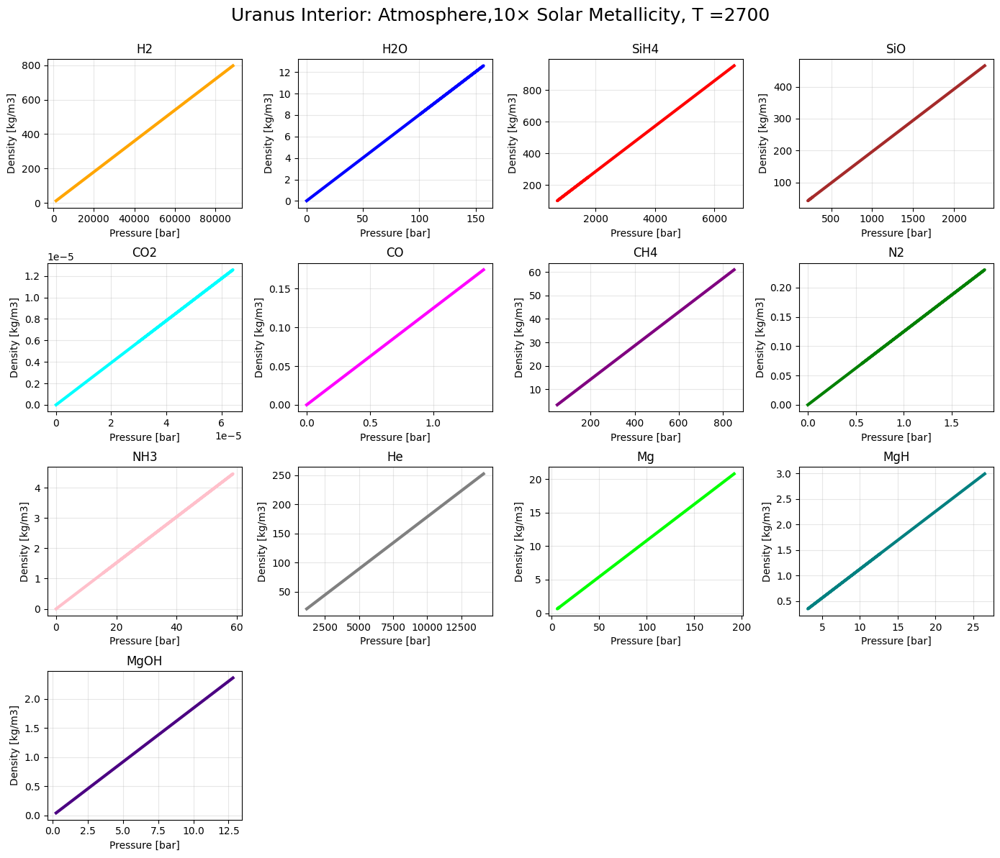

[20:33:22 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:33:22 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

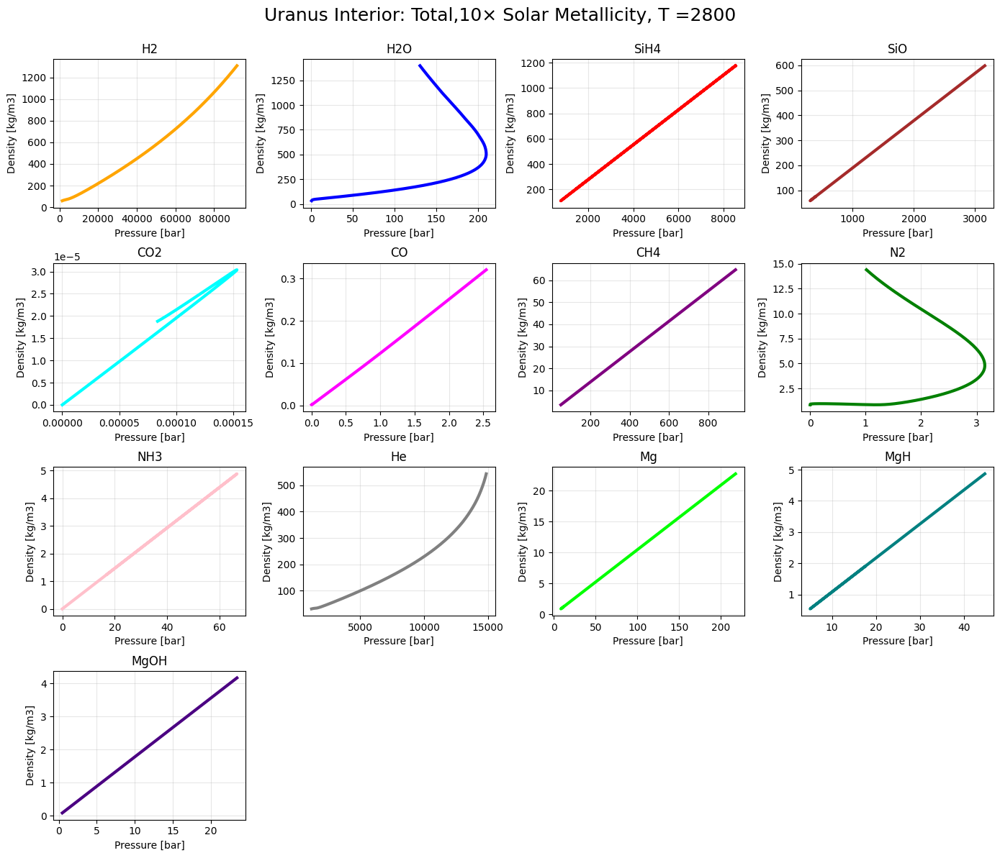

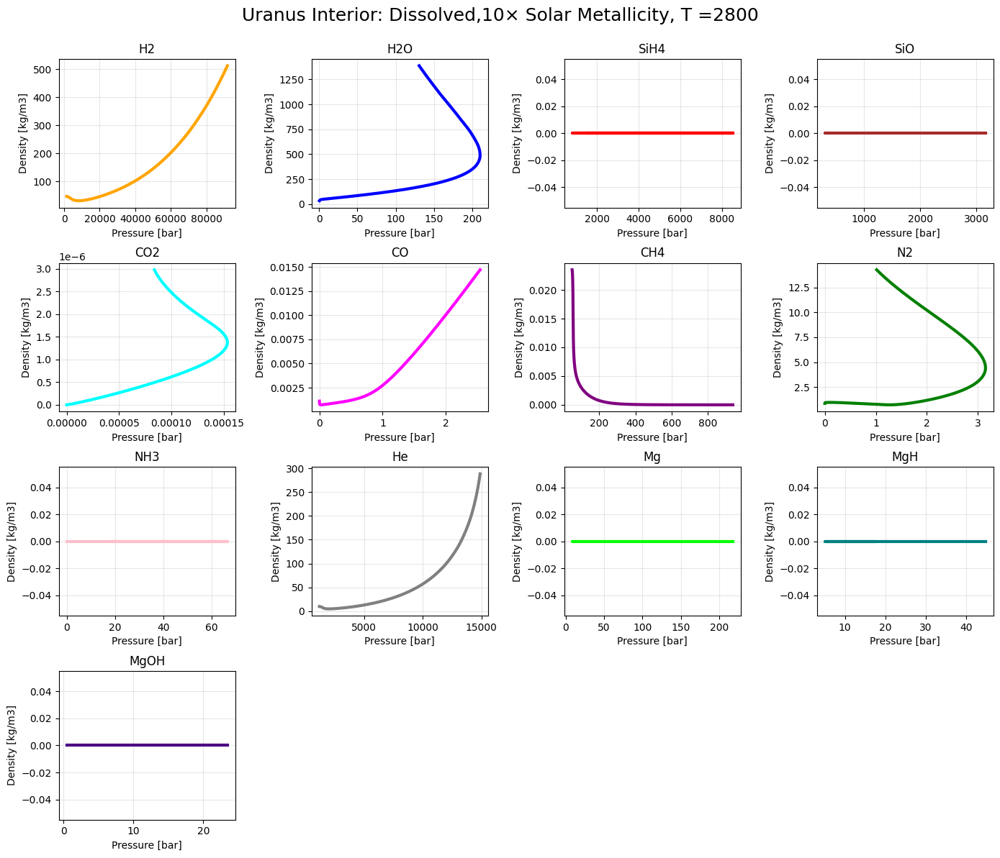

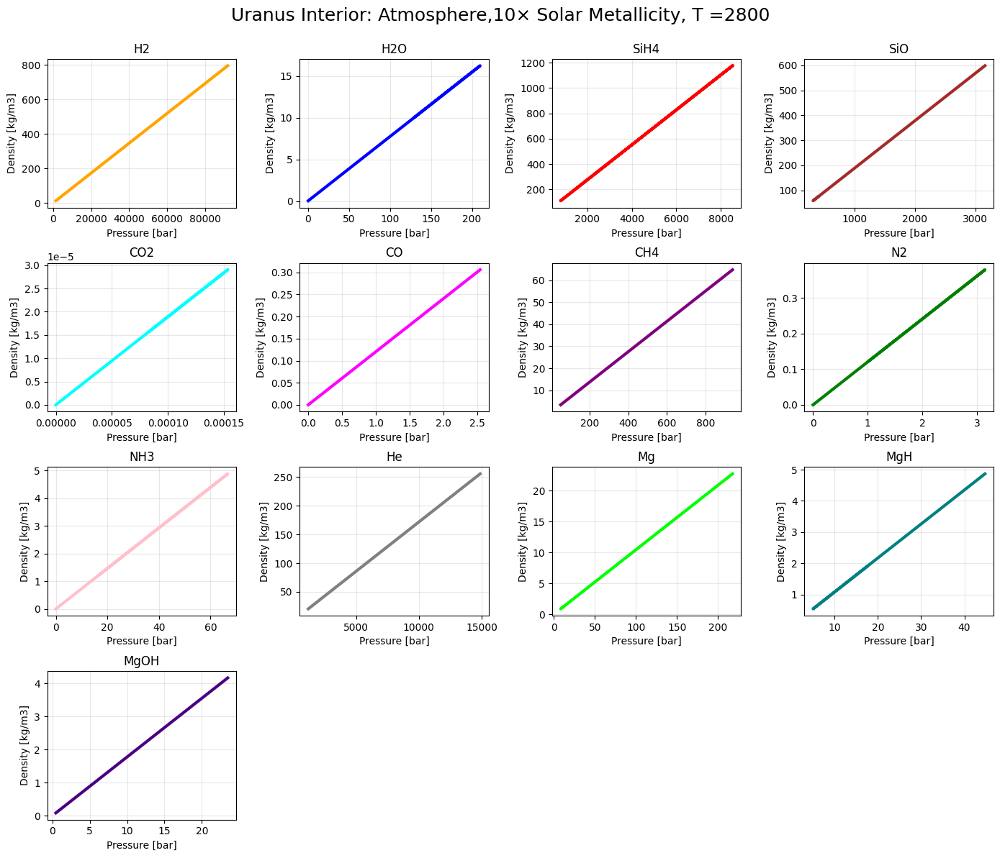

[20:34:14 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:34:14 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

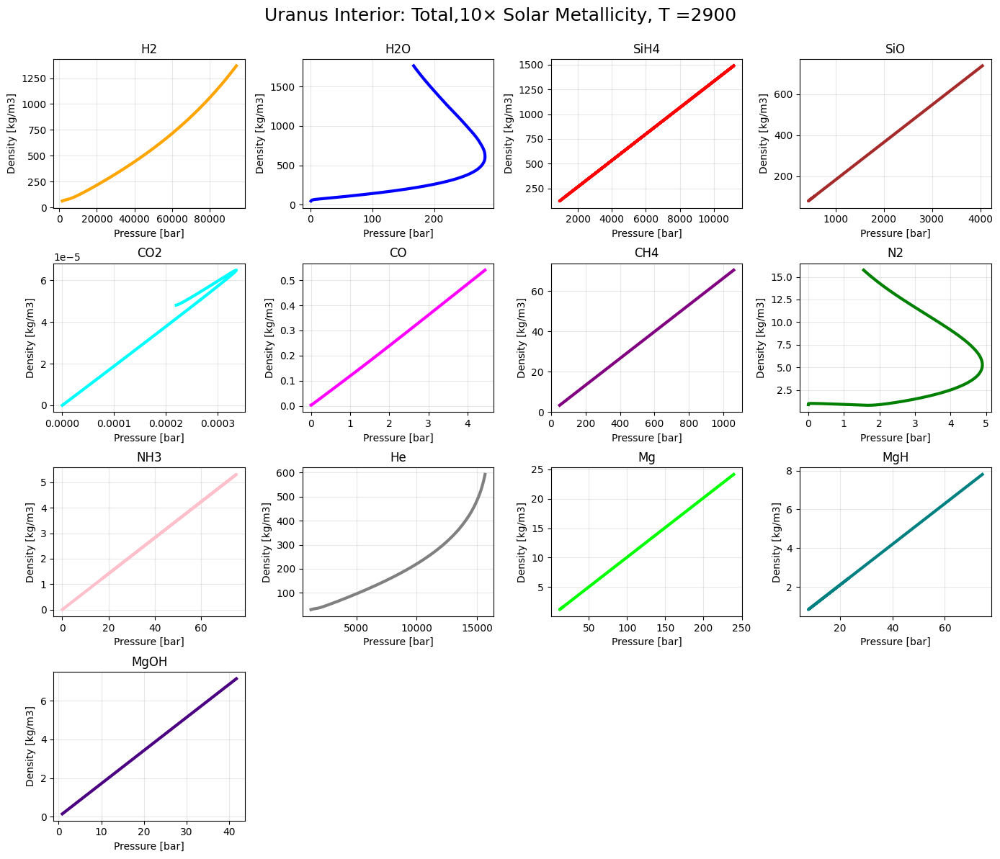

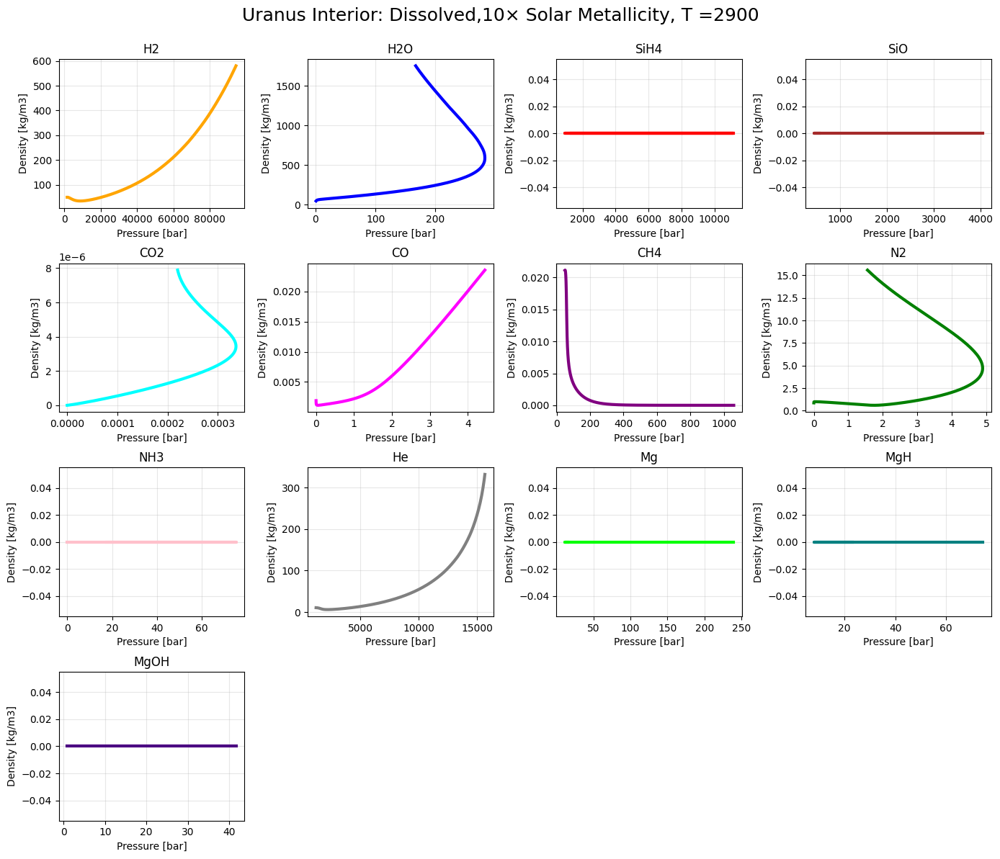

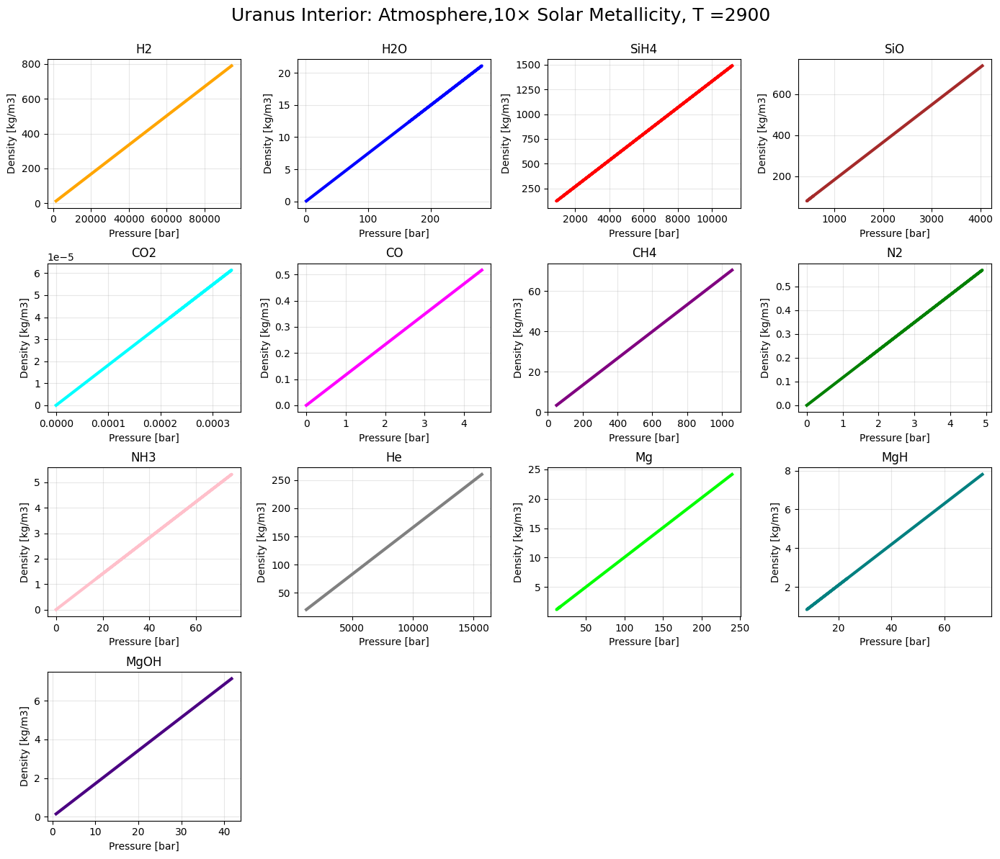

[20:35:04 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:35:04 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

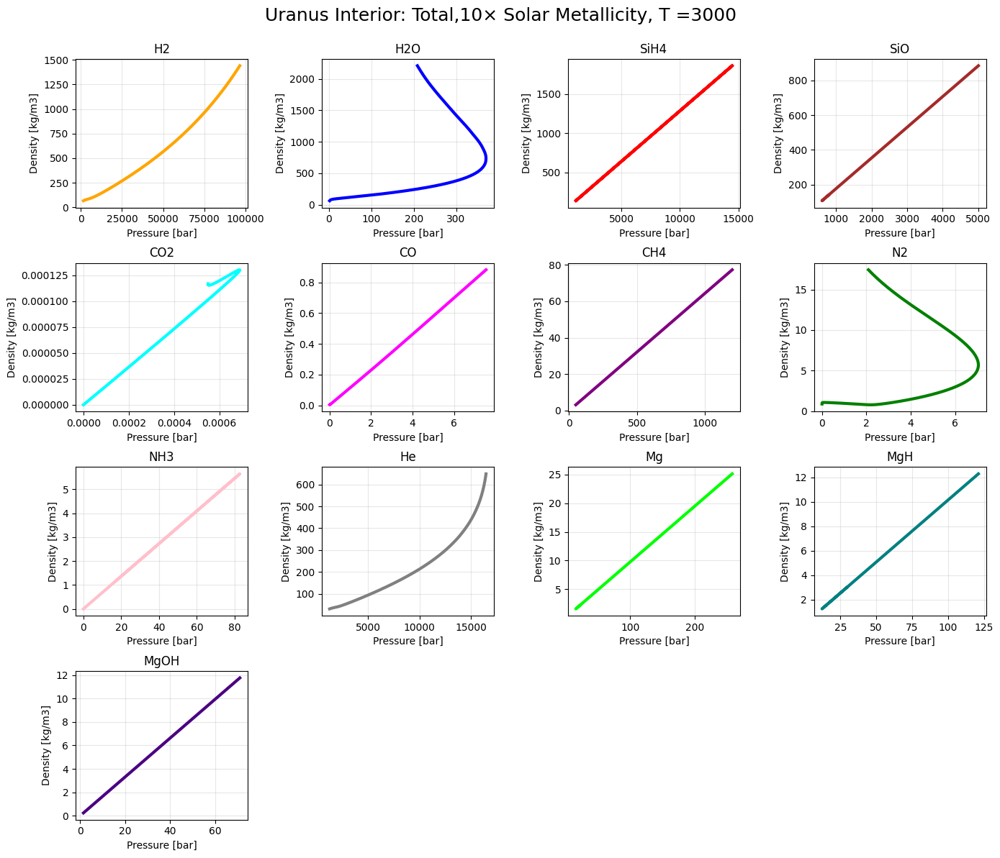

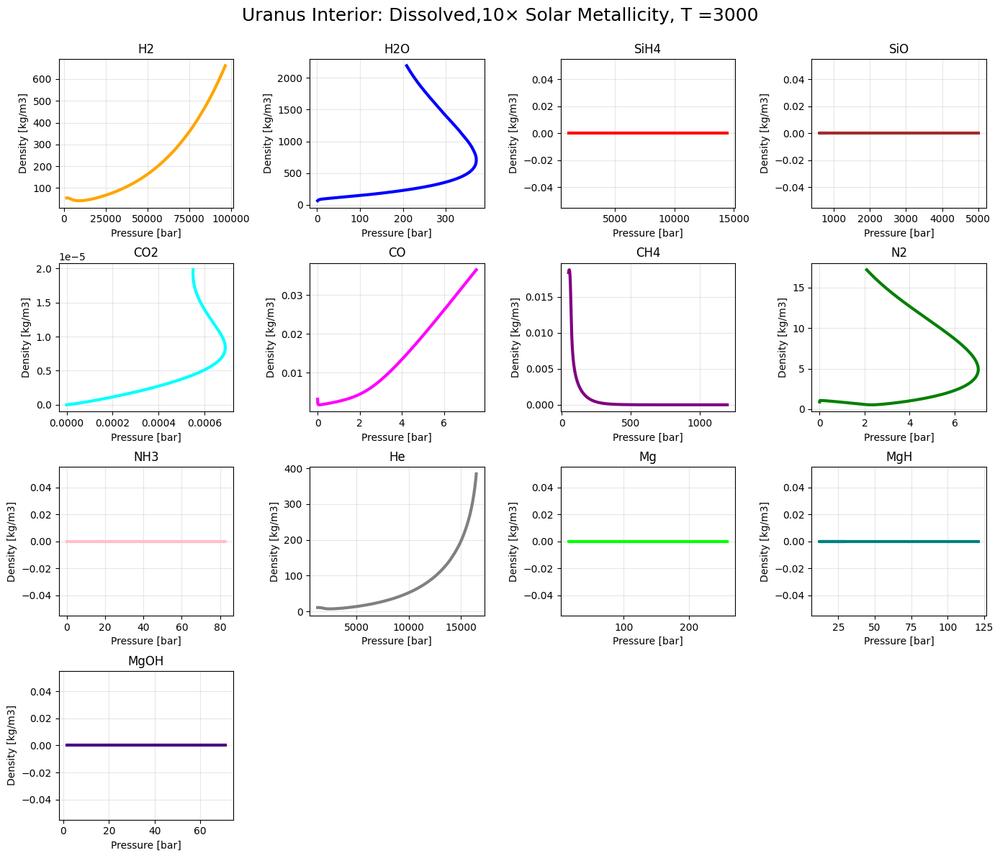

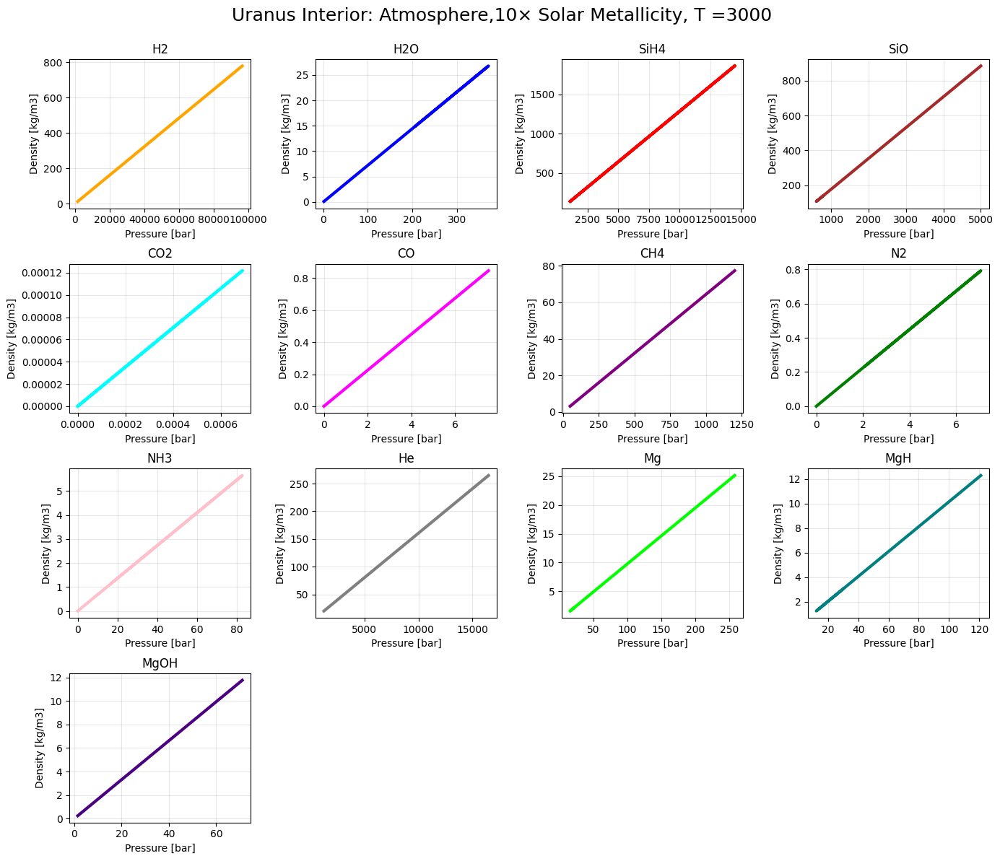

[20:35:54 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:35:54 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

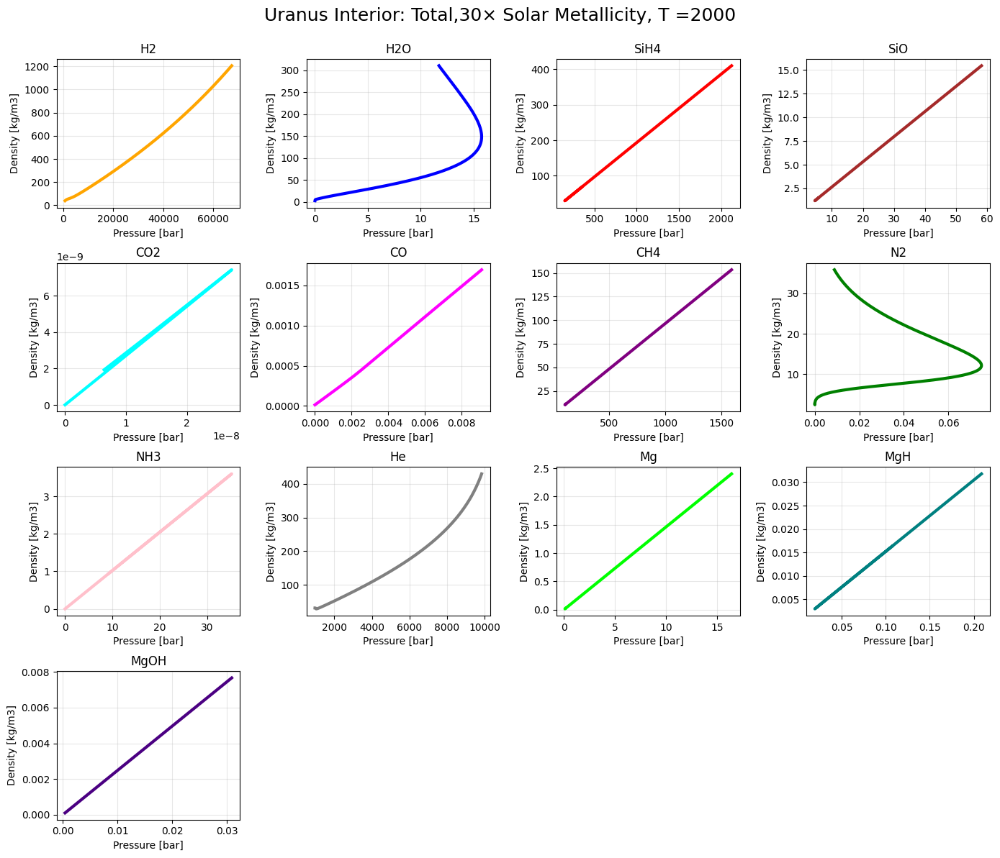

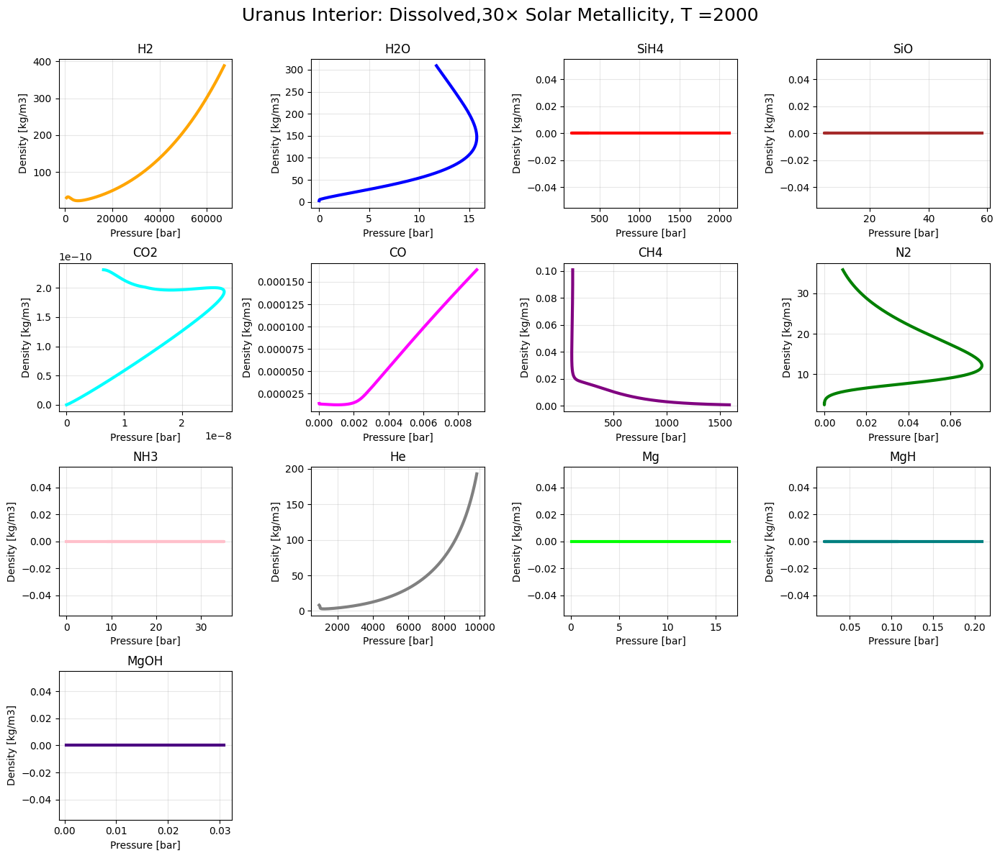

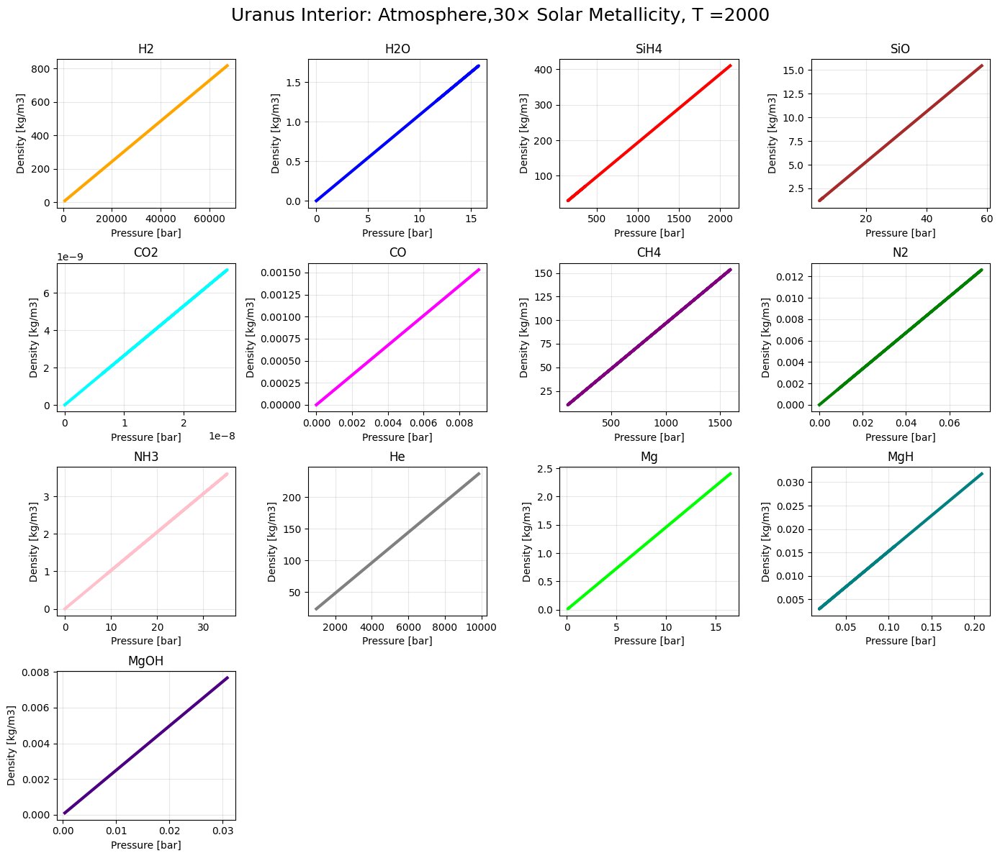

[20:37:20 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:37:20 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

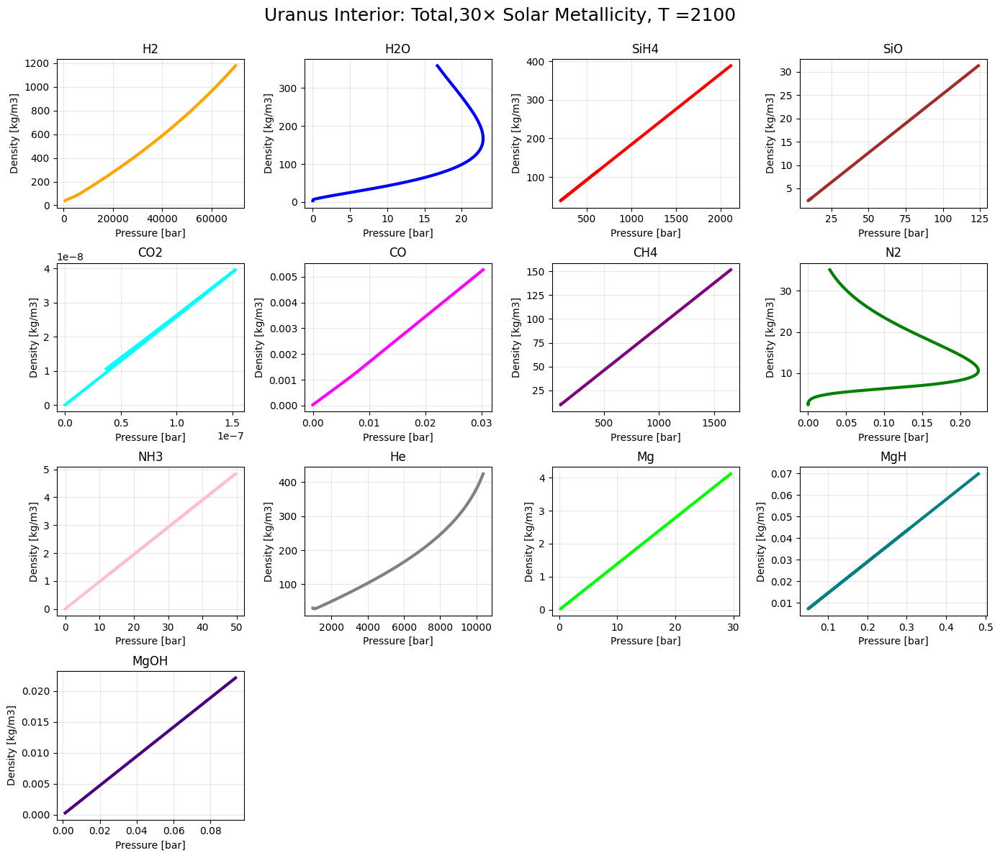

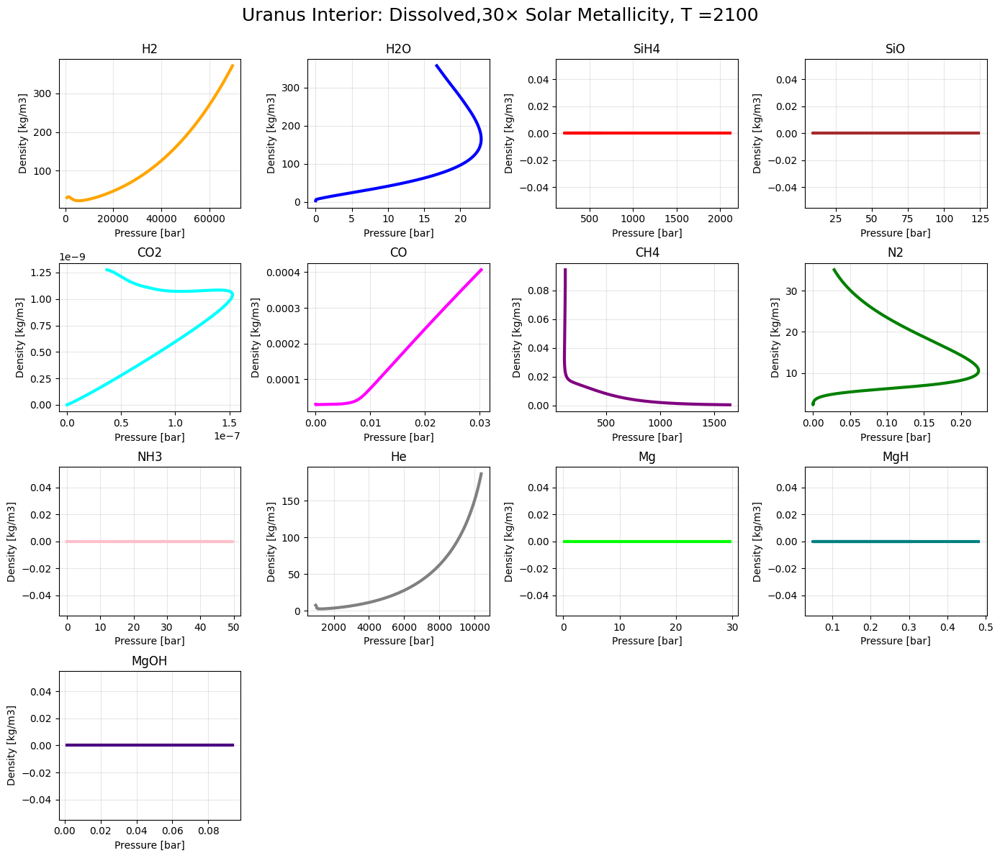

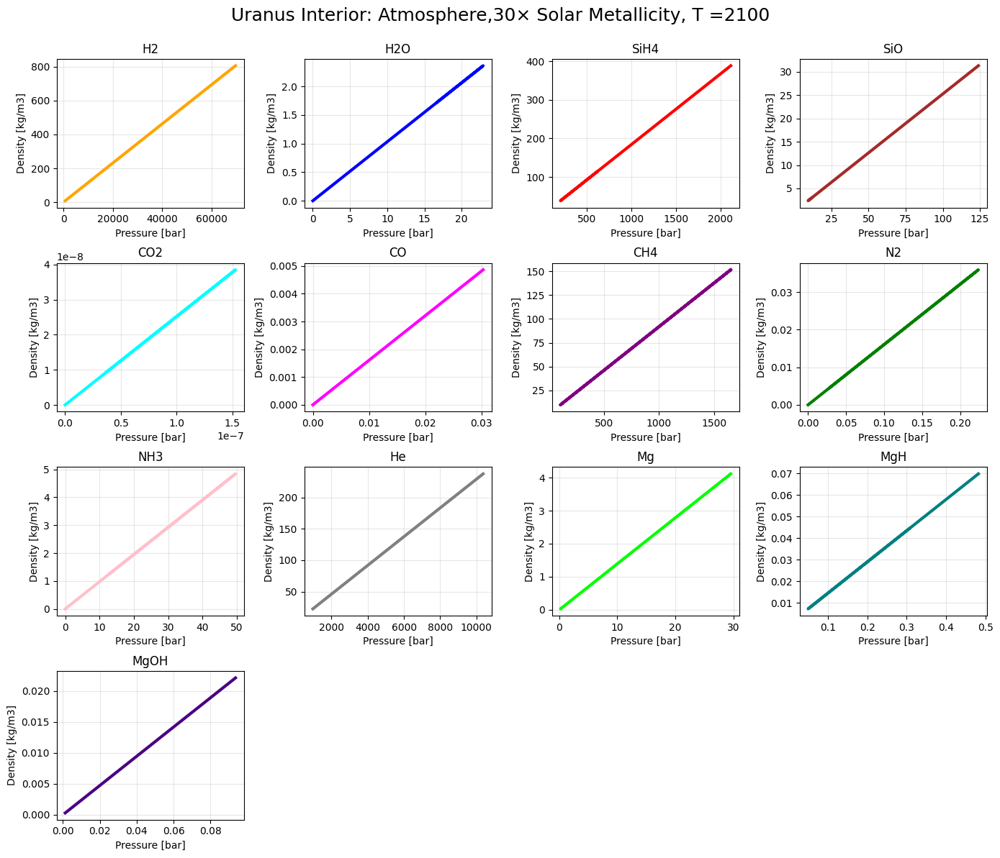

[20:38:36 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:38:36 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

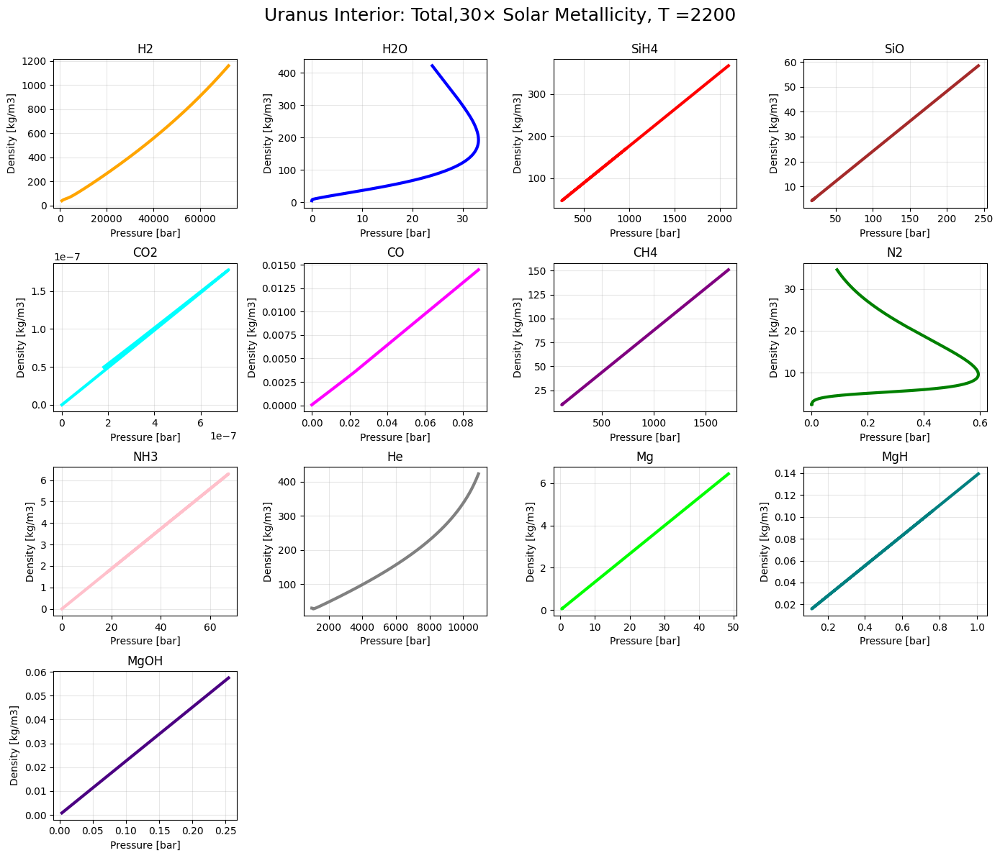

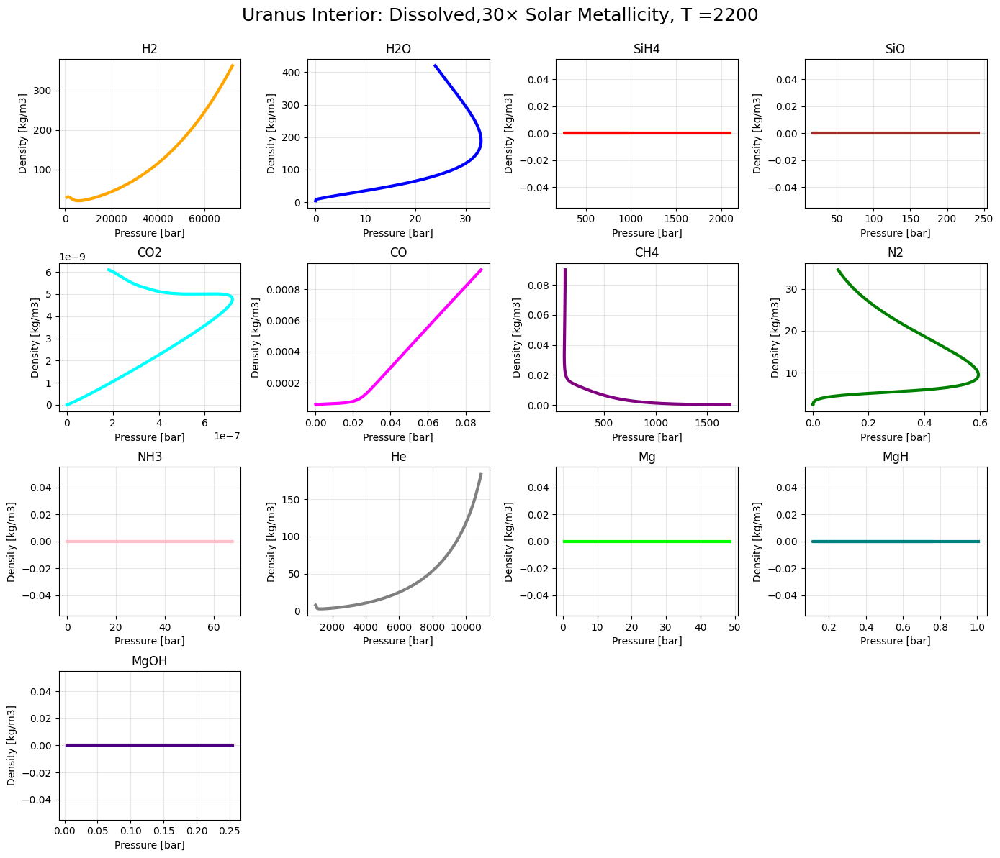

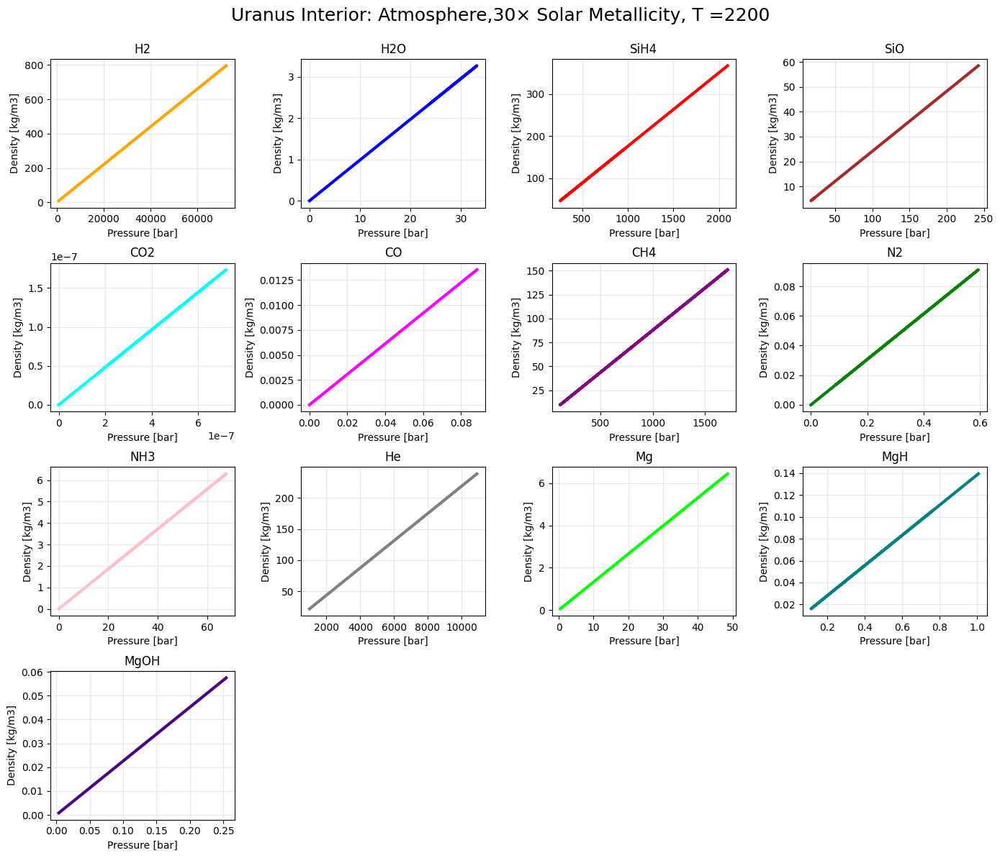

[20:39:49 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:39:49 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

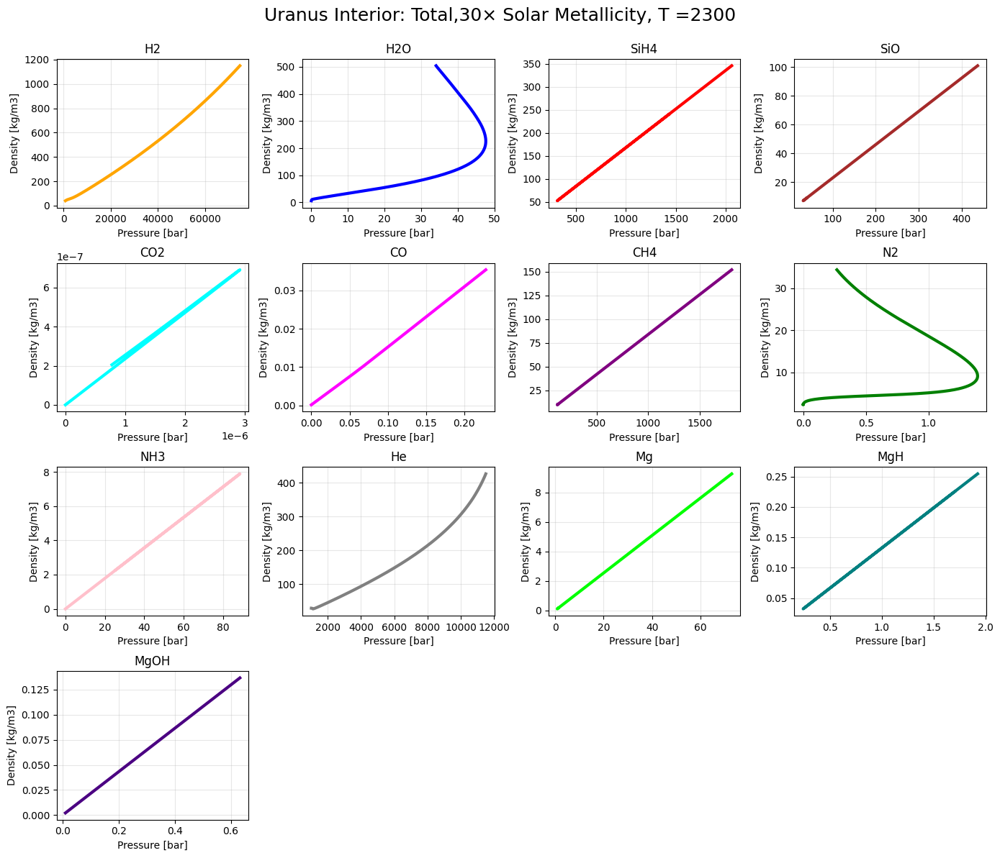

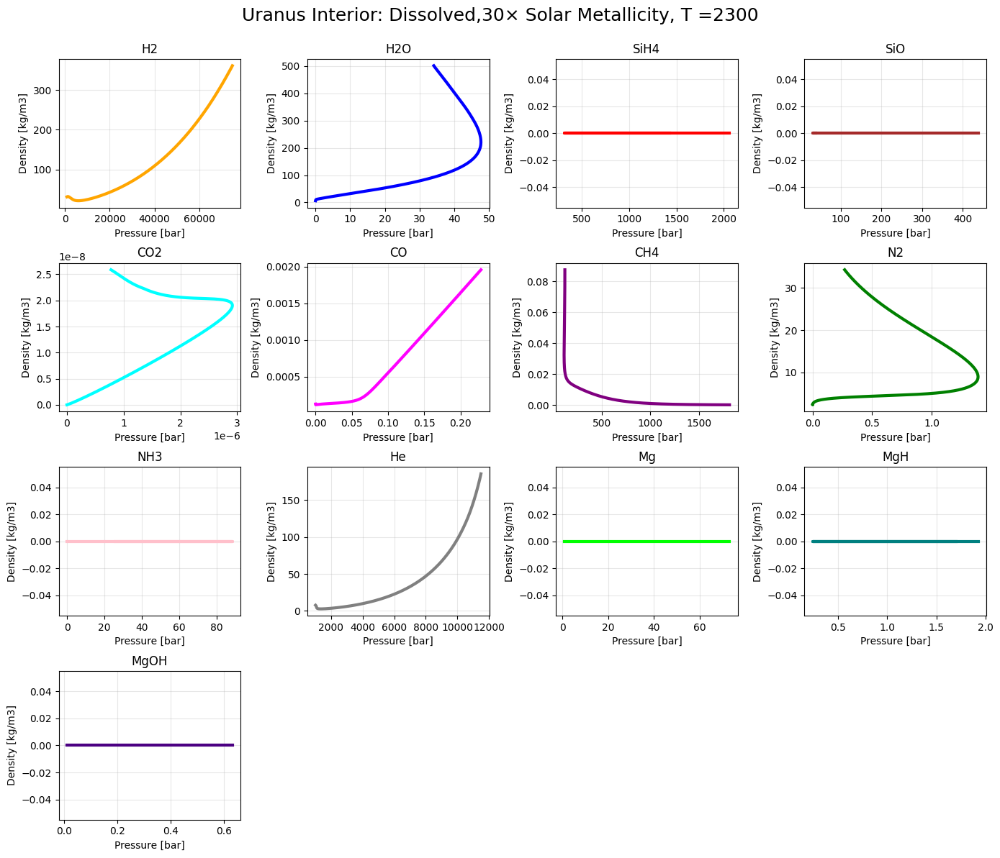

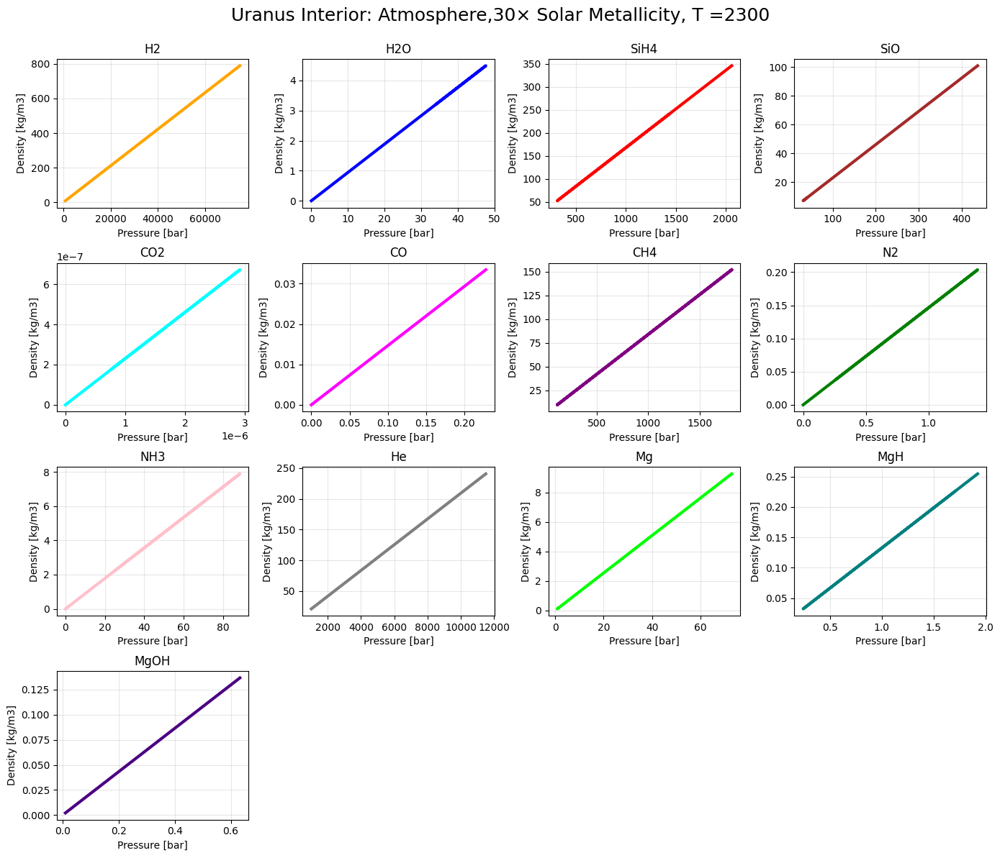

[20:41:03 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:41:03 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

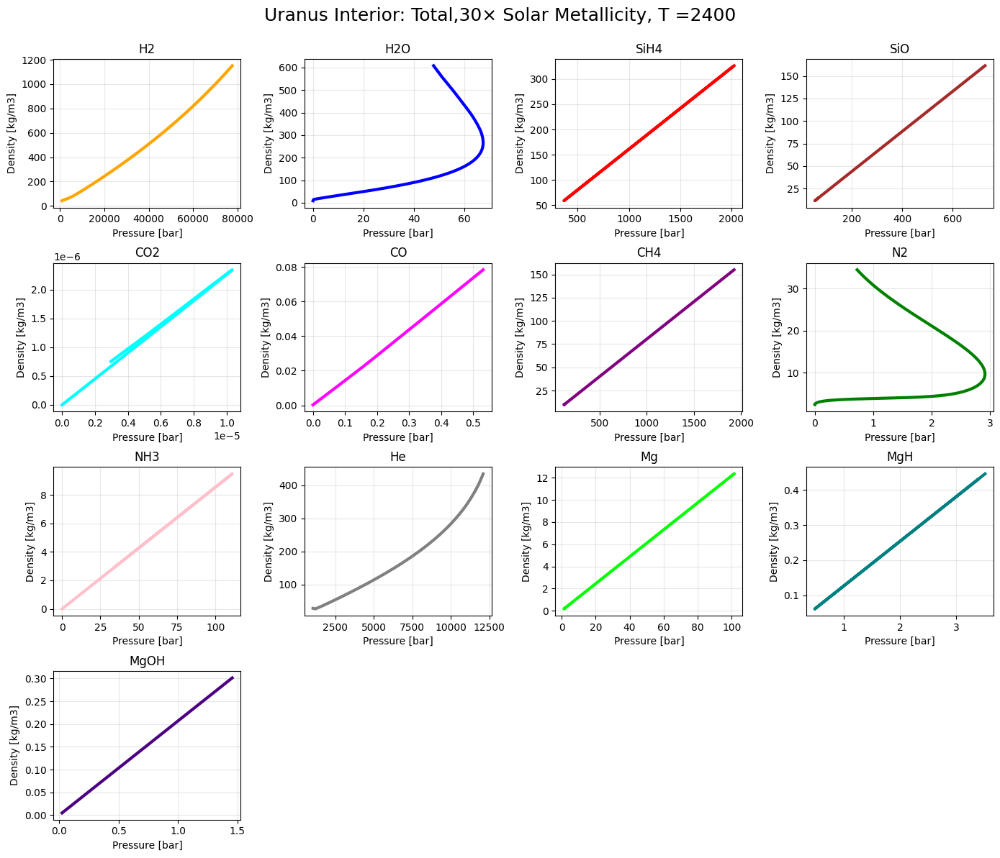

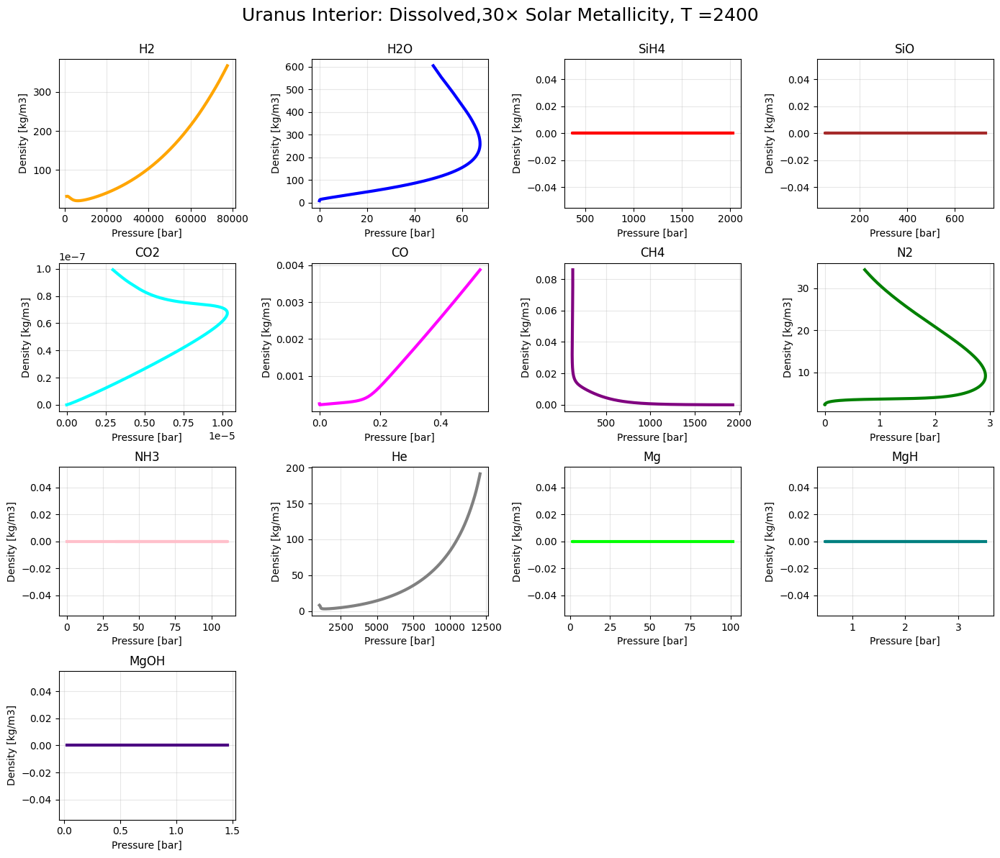

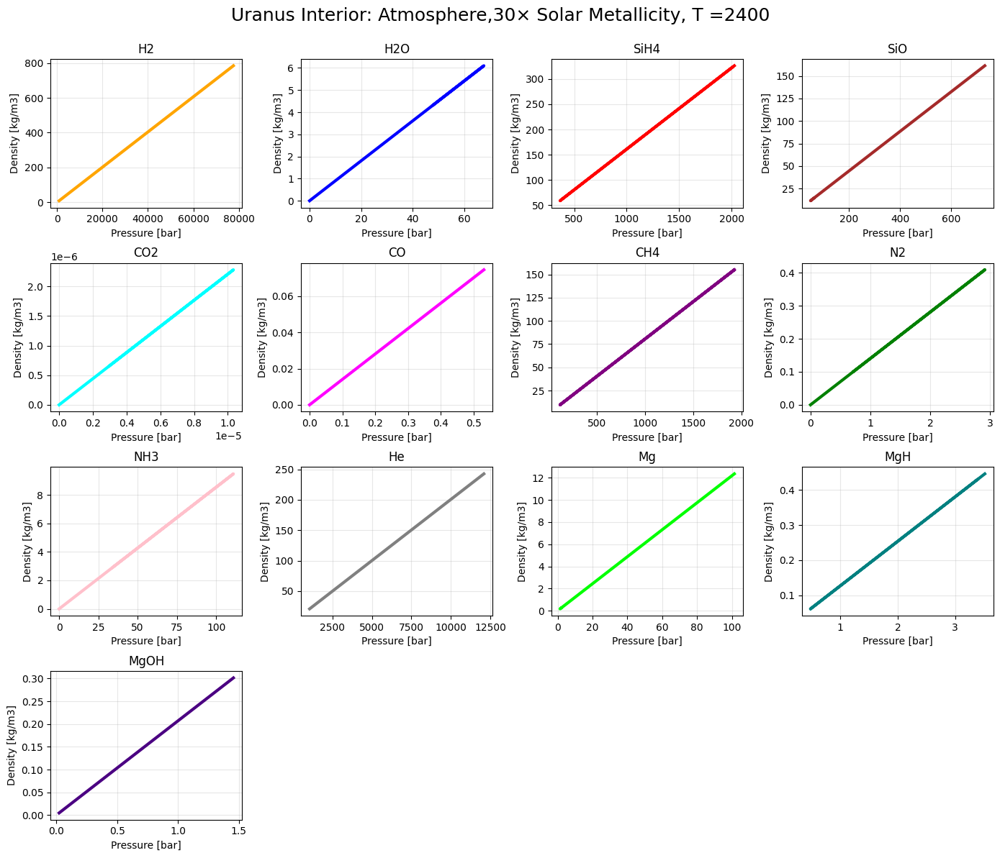

[20:42:01 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:42:01 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

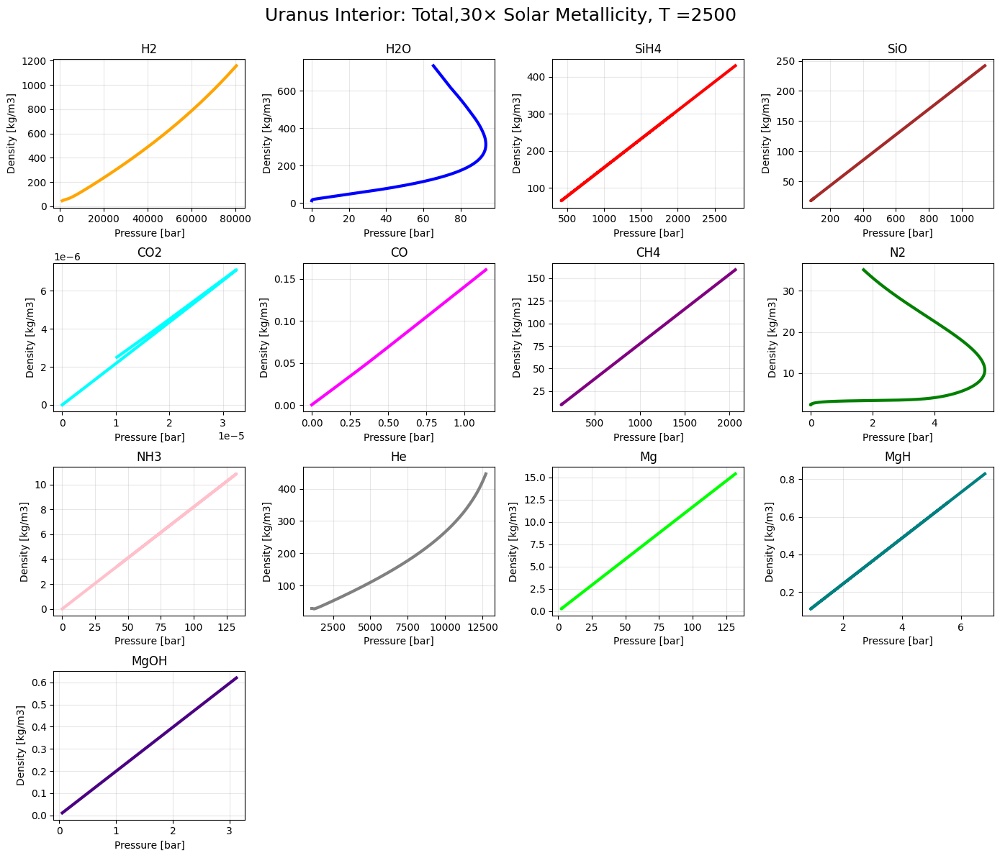

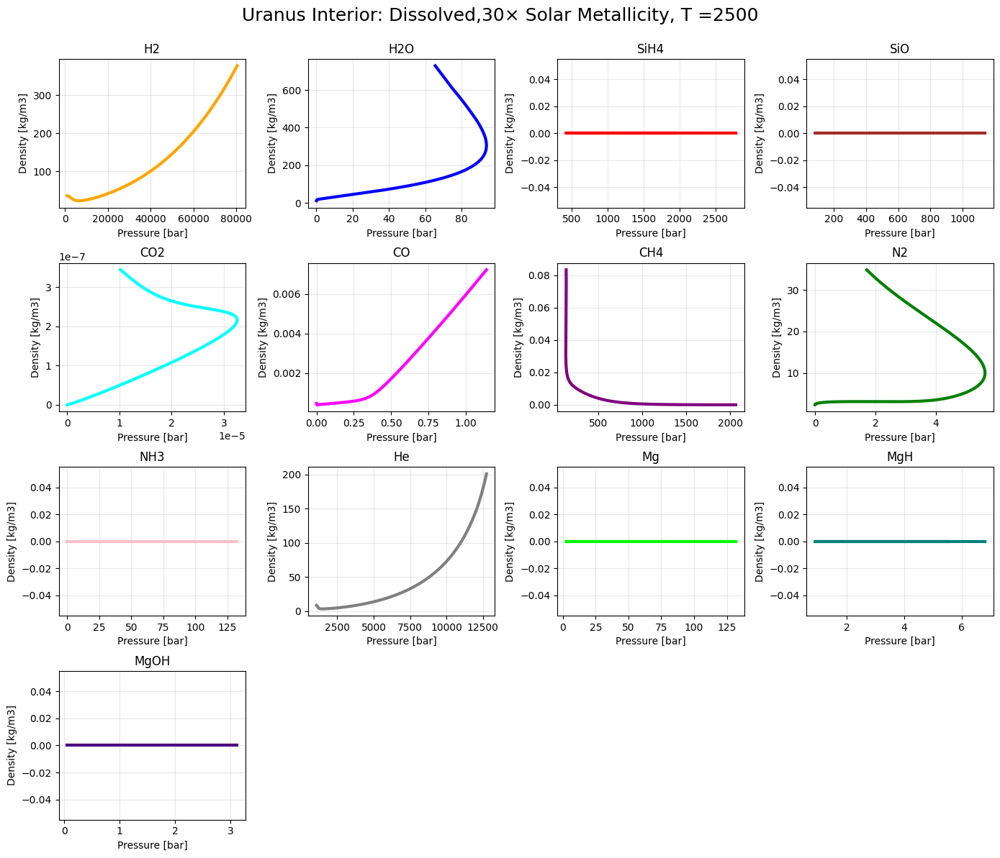

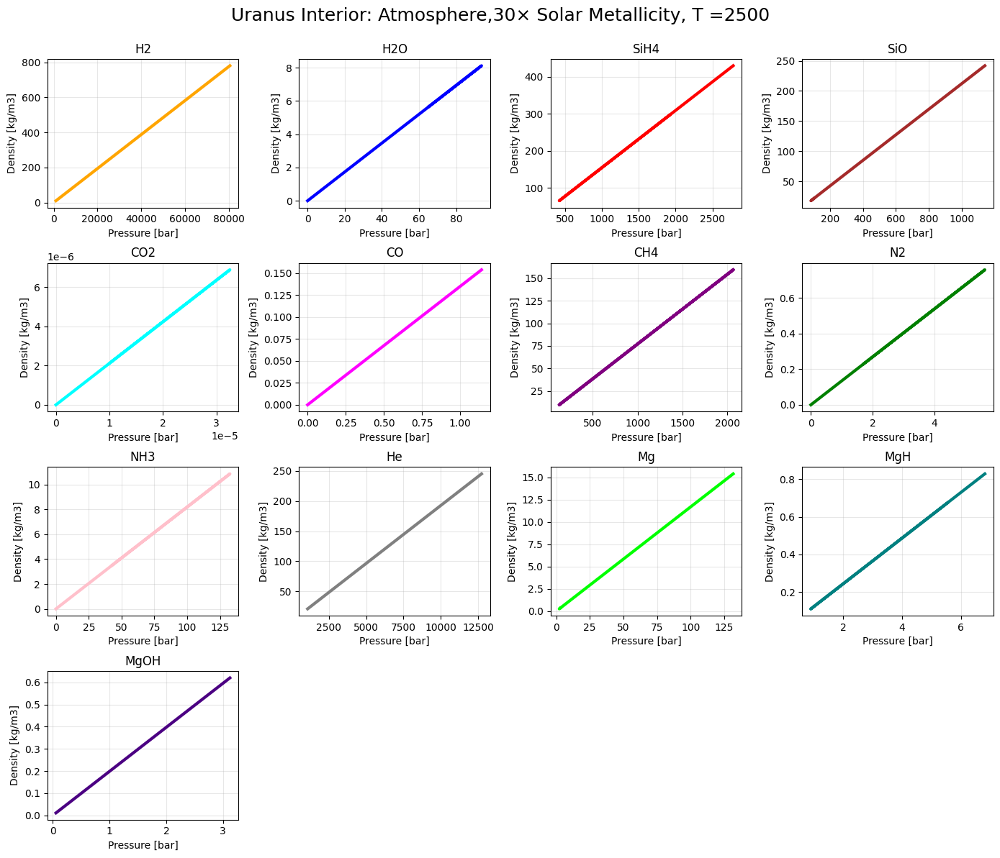

[20:42:55 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:42:55 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

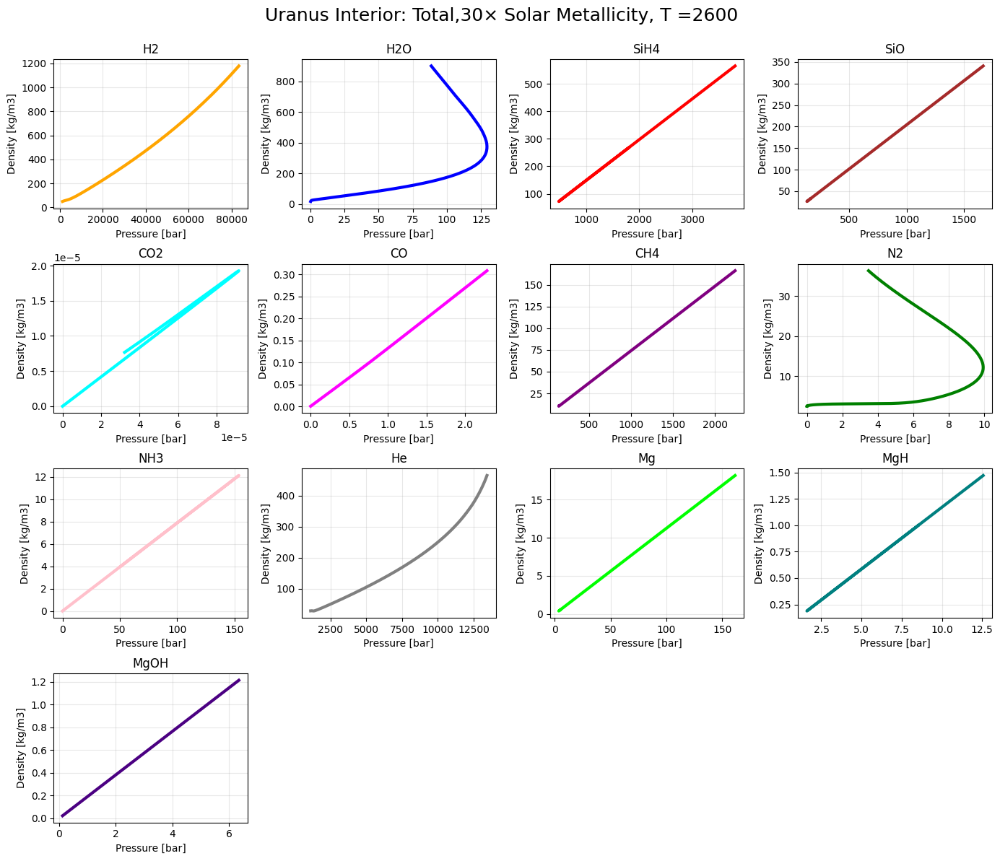

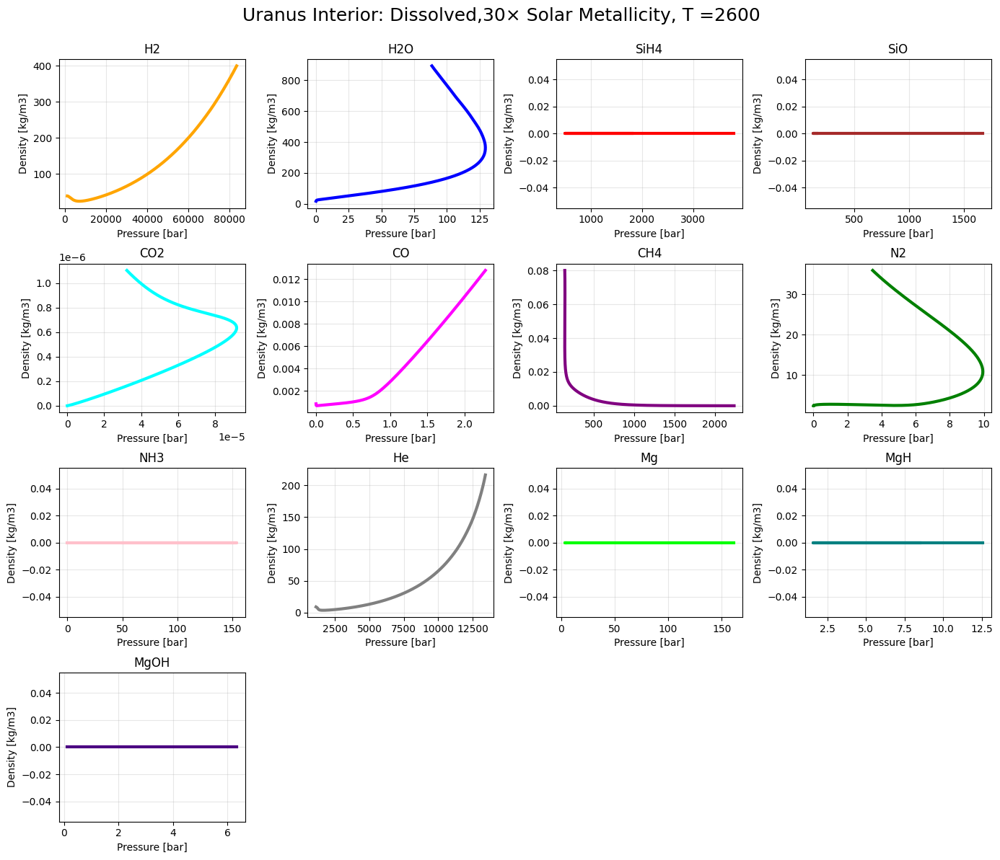

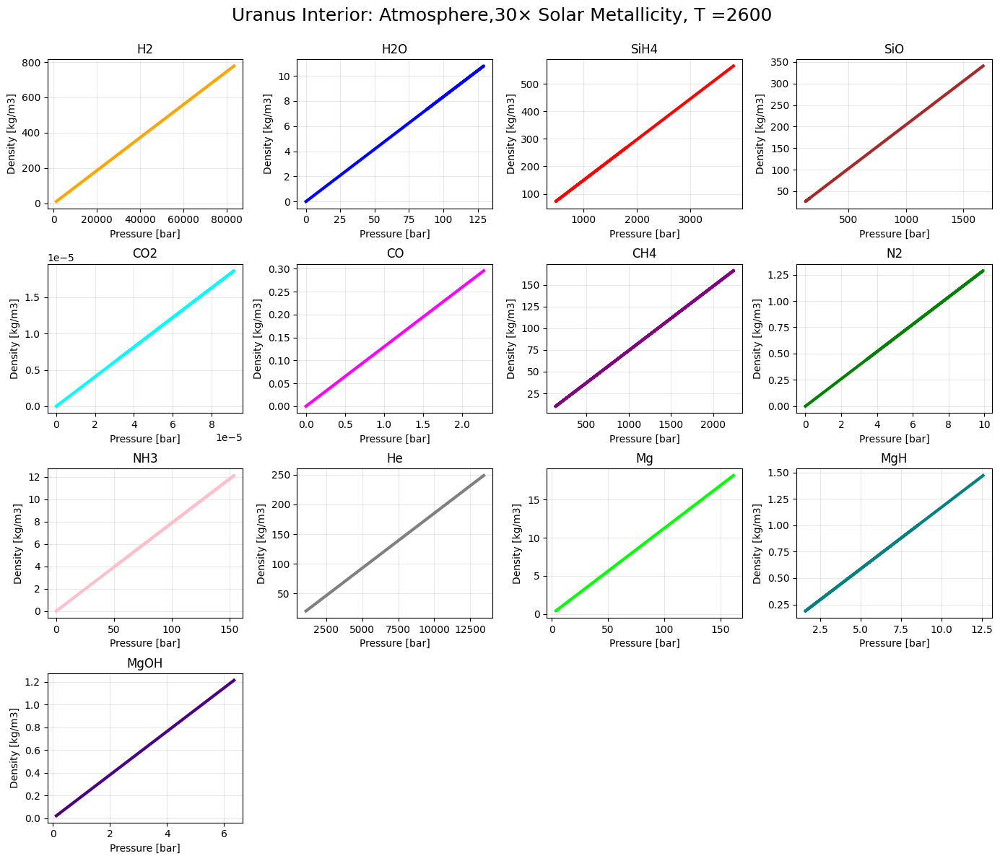

[20:43:46 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:43:46 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

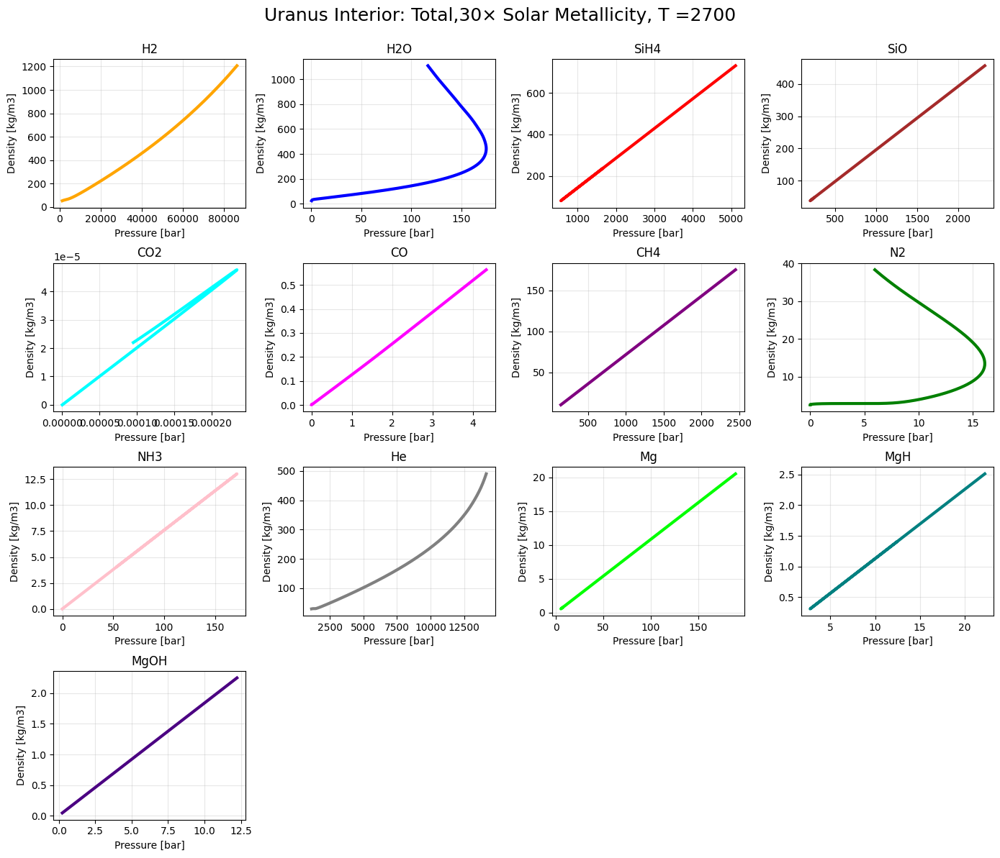

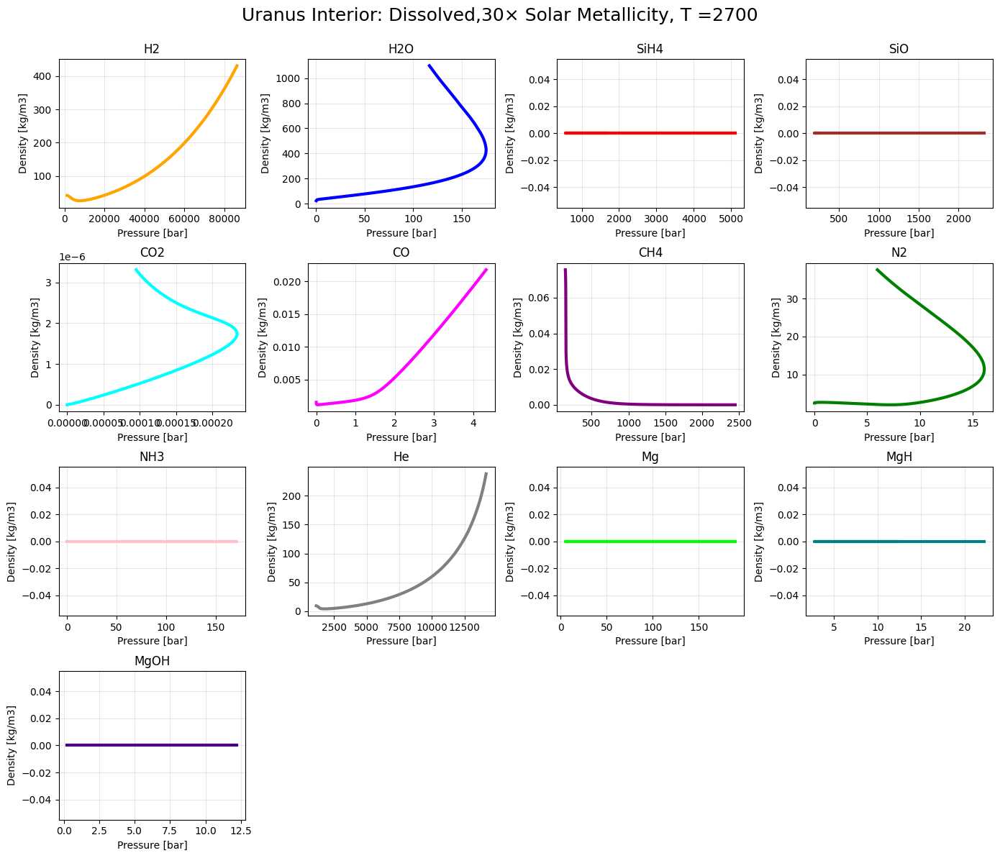

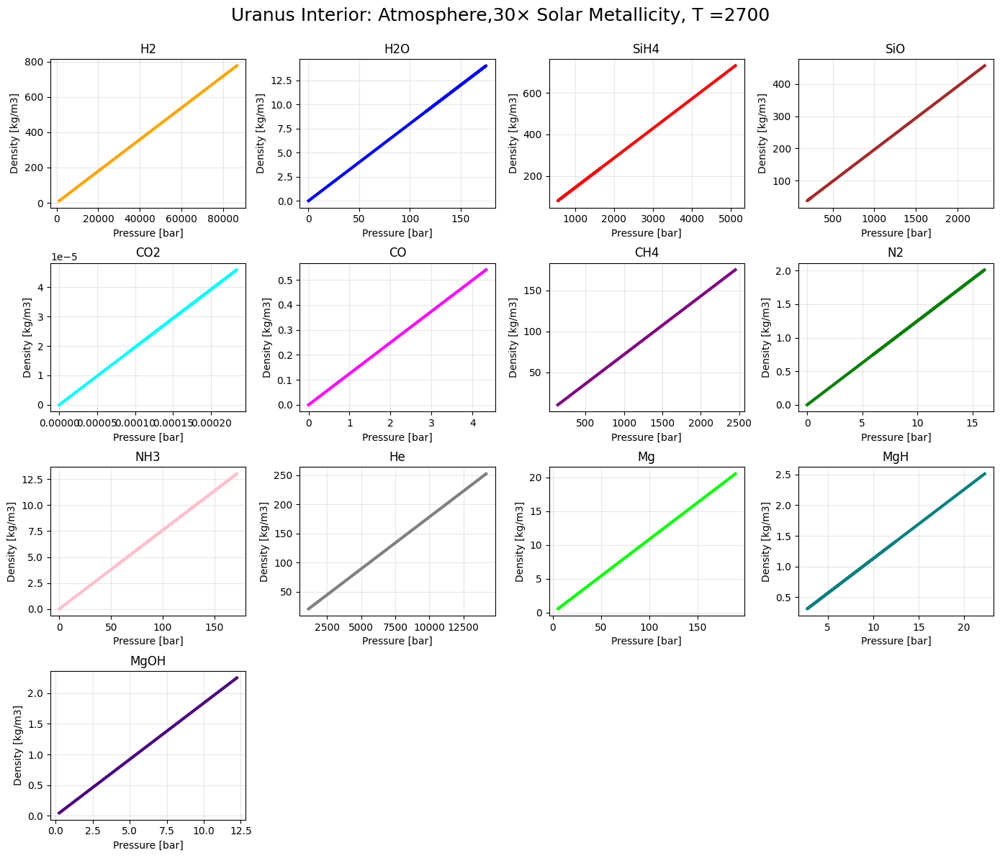

[20:44:35 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:44:35 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

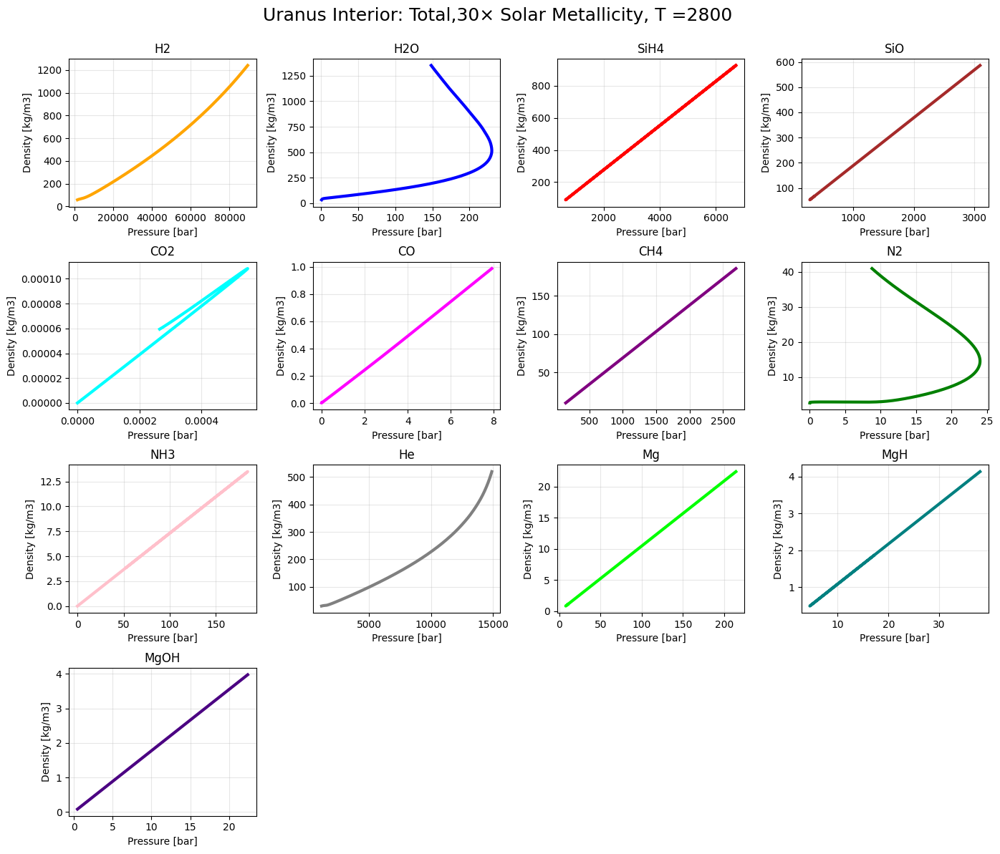

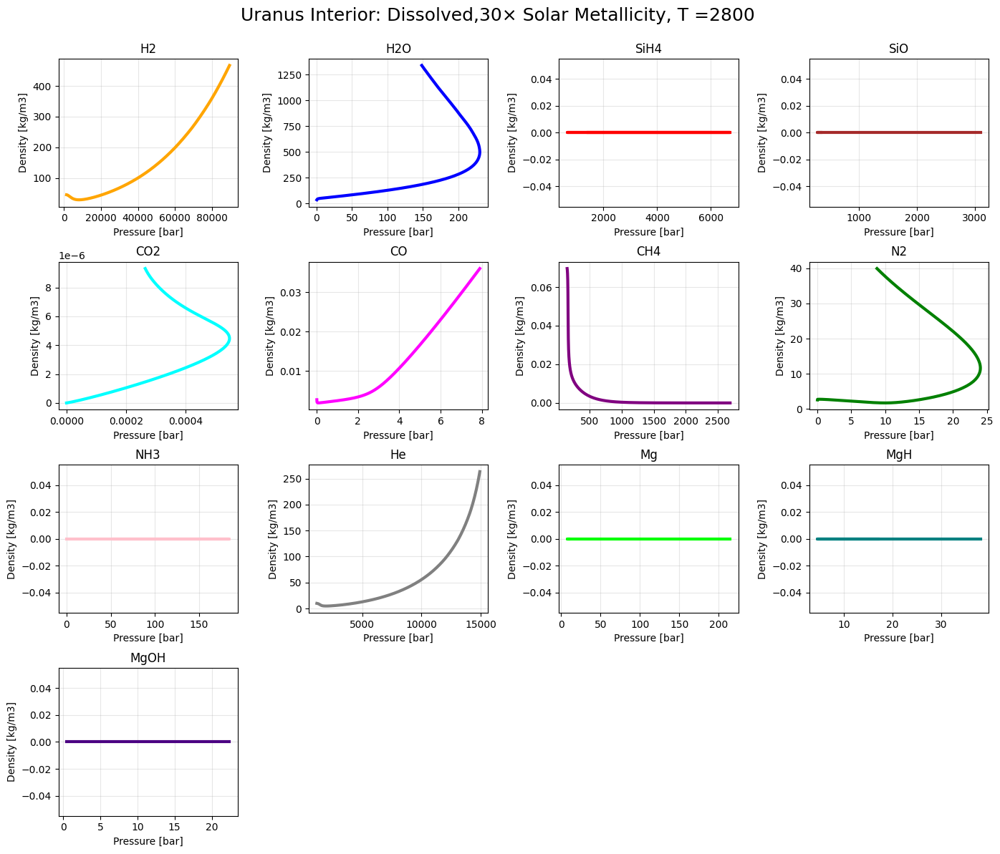

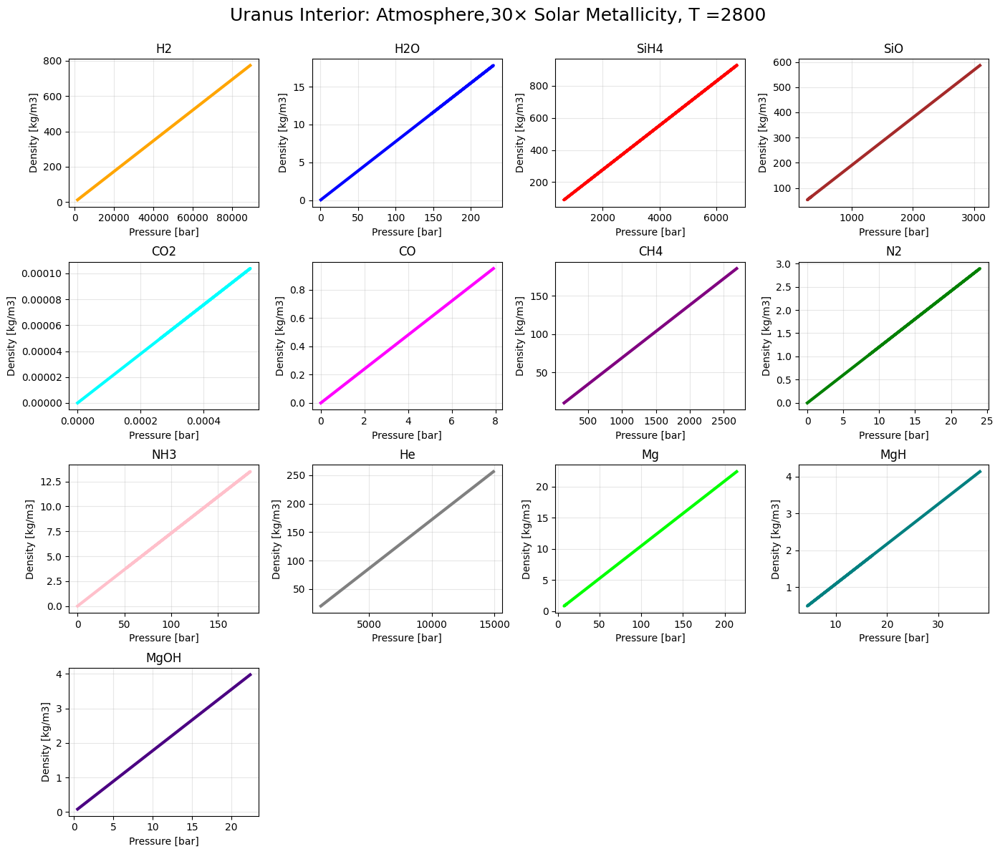

[20:45:26 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:45:26 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

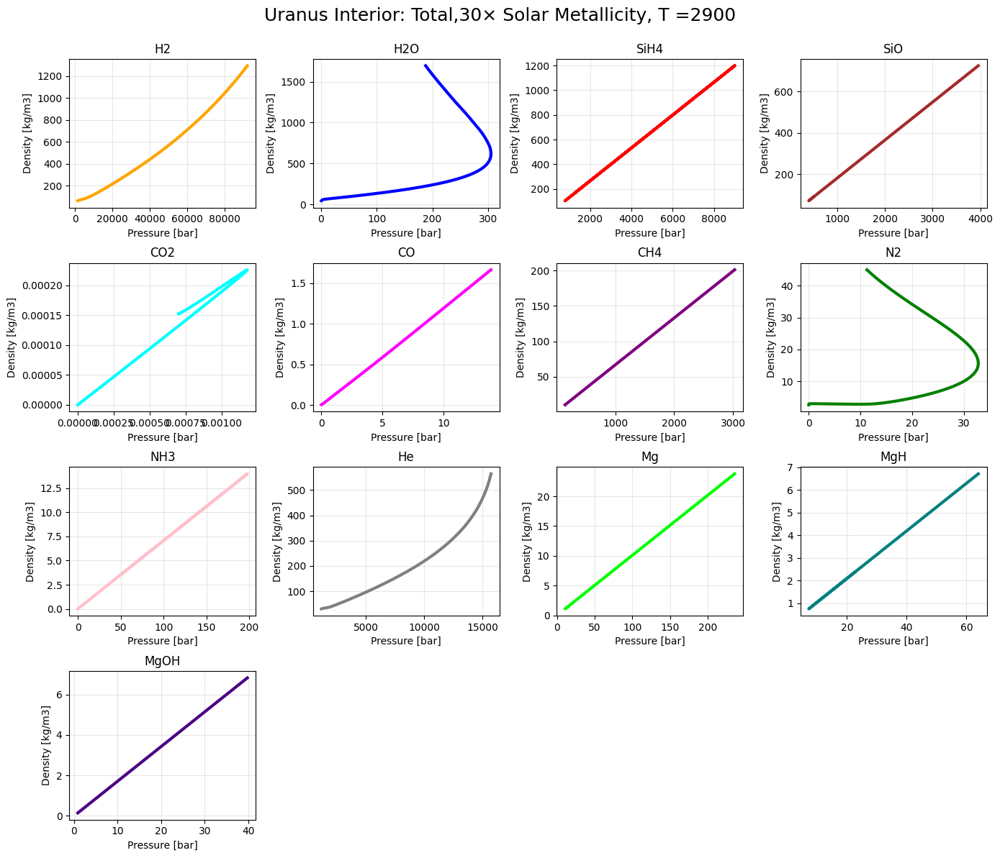

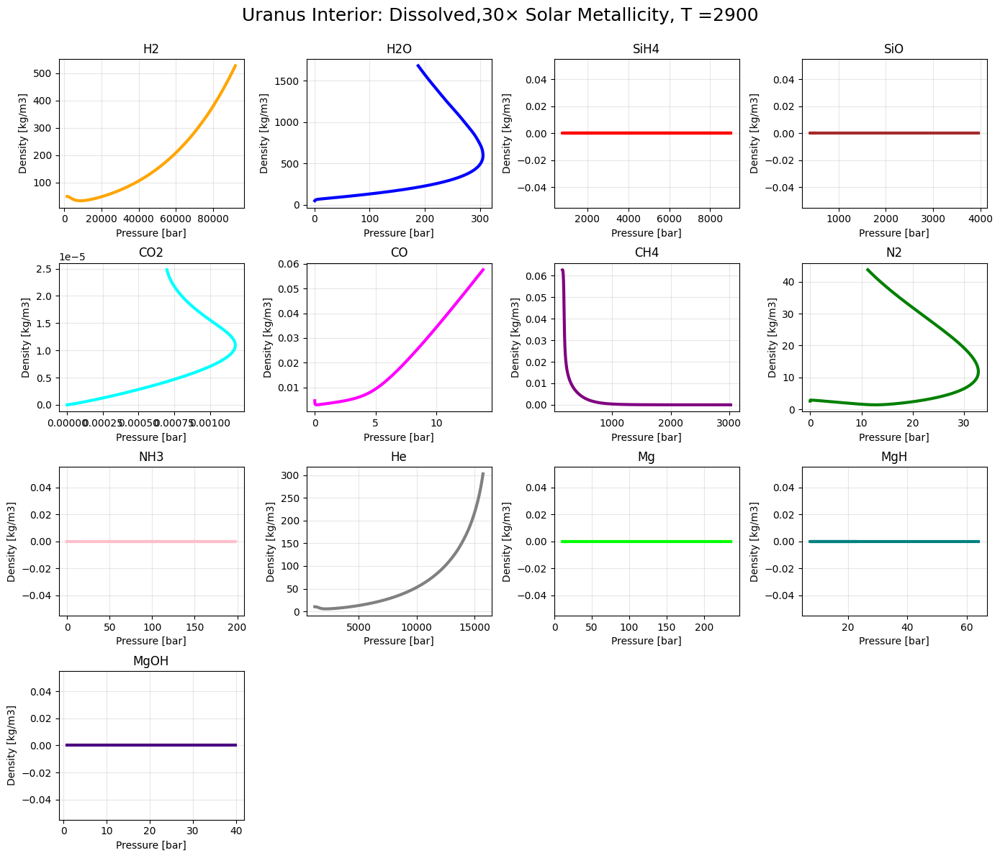

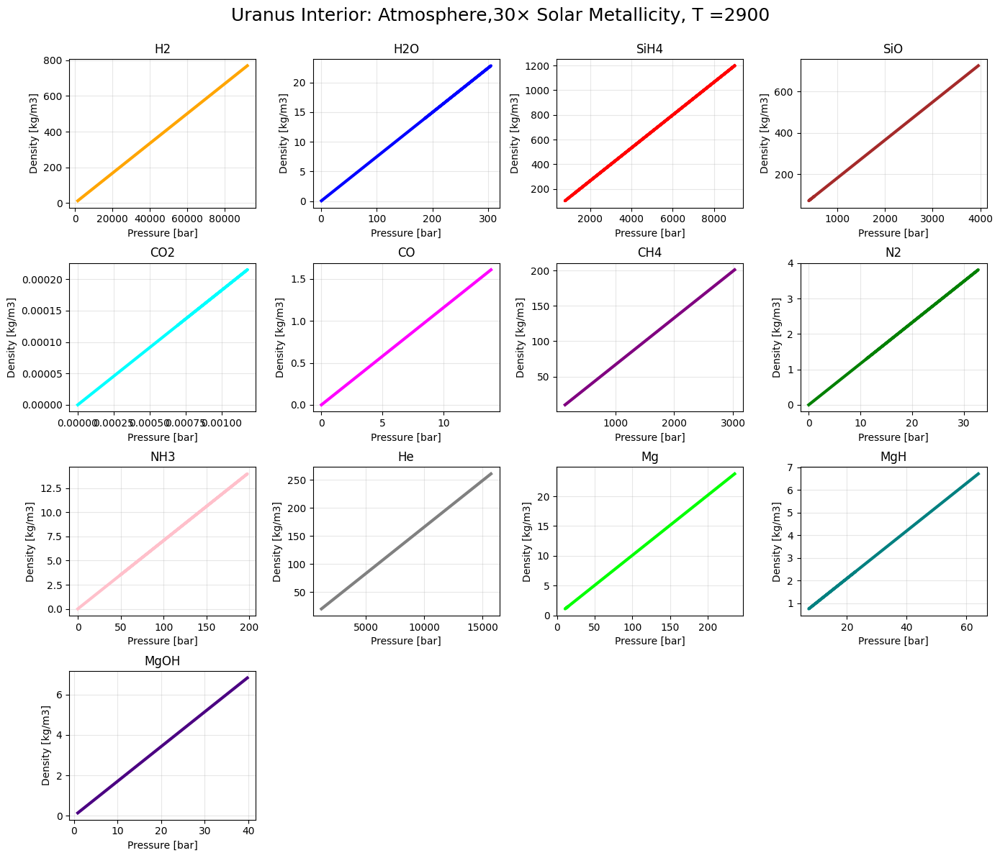

[20:46:15 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:46:15 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

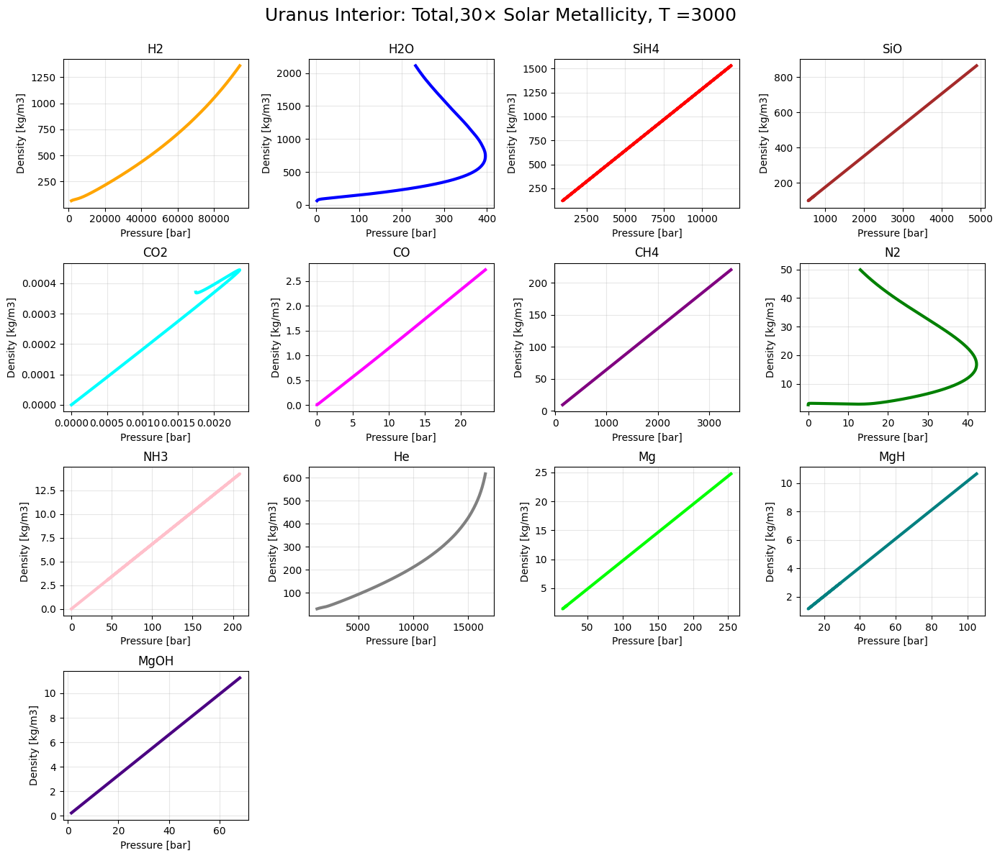

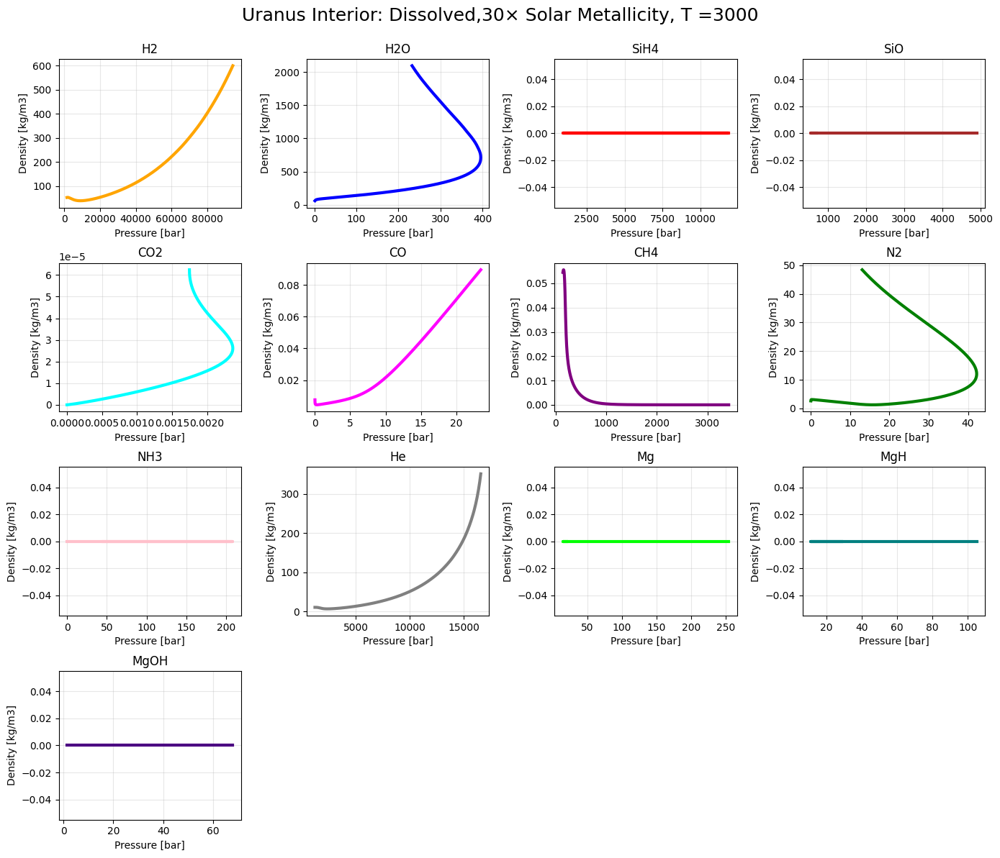

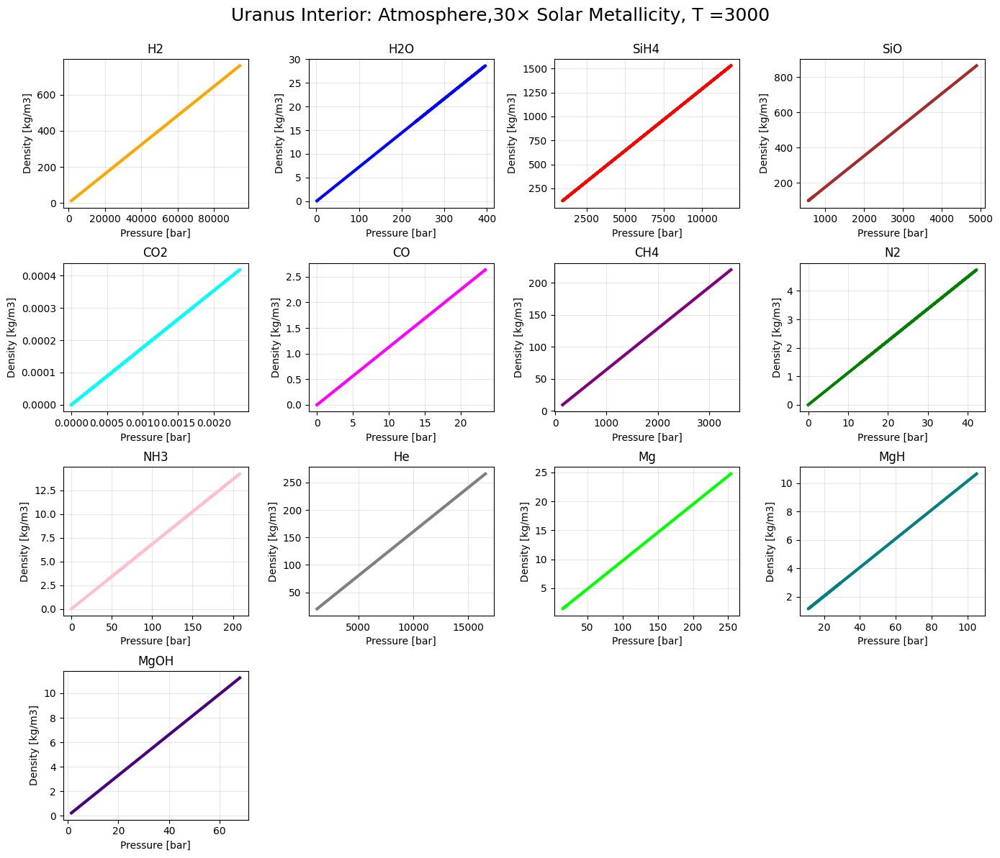

[20:47:06 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:47:06 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

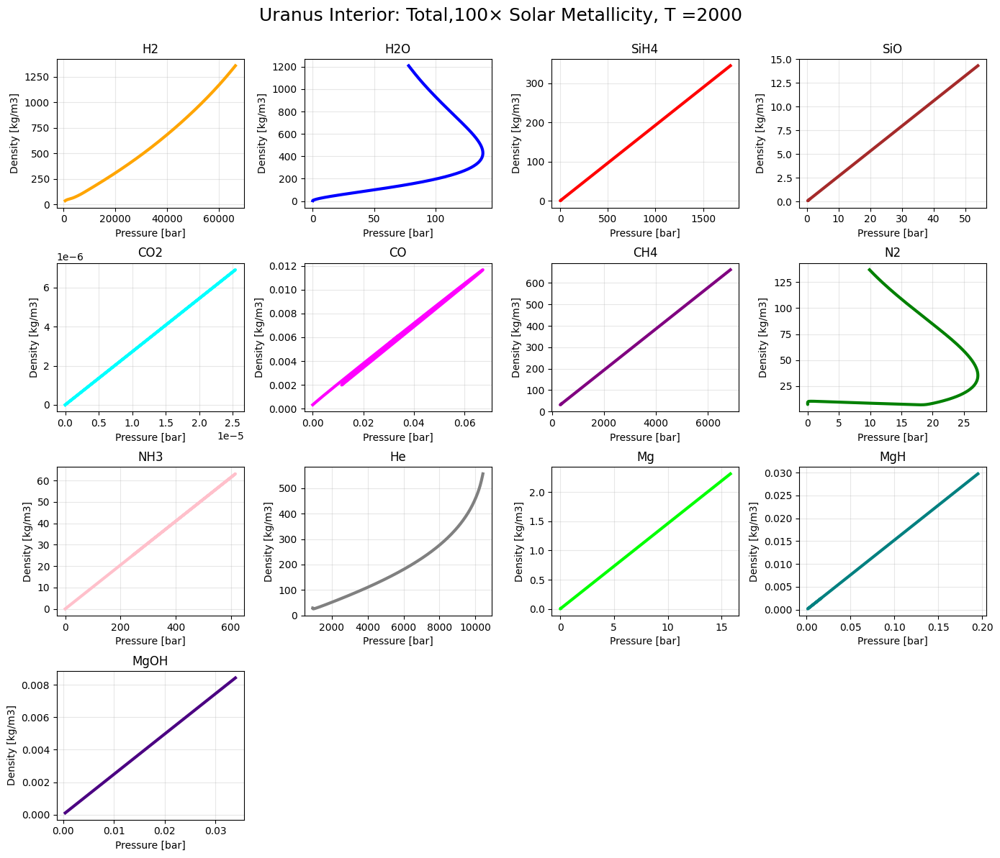

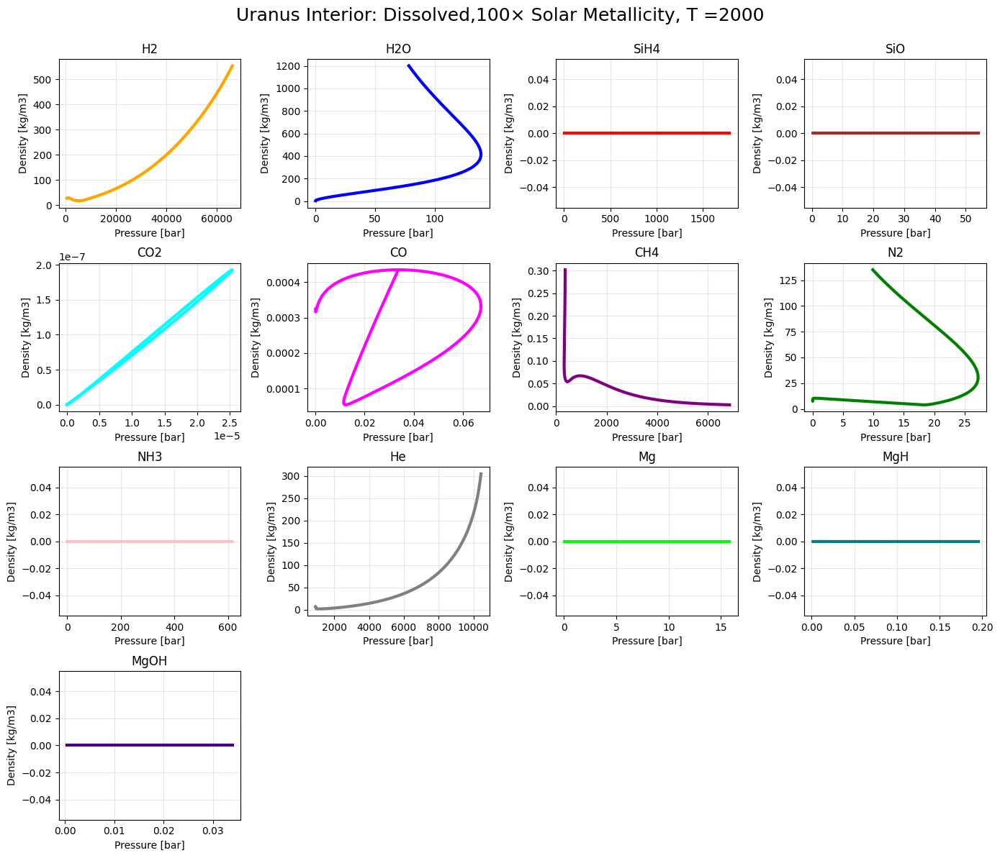

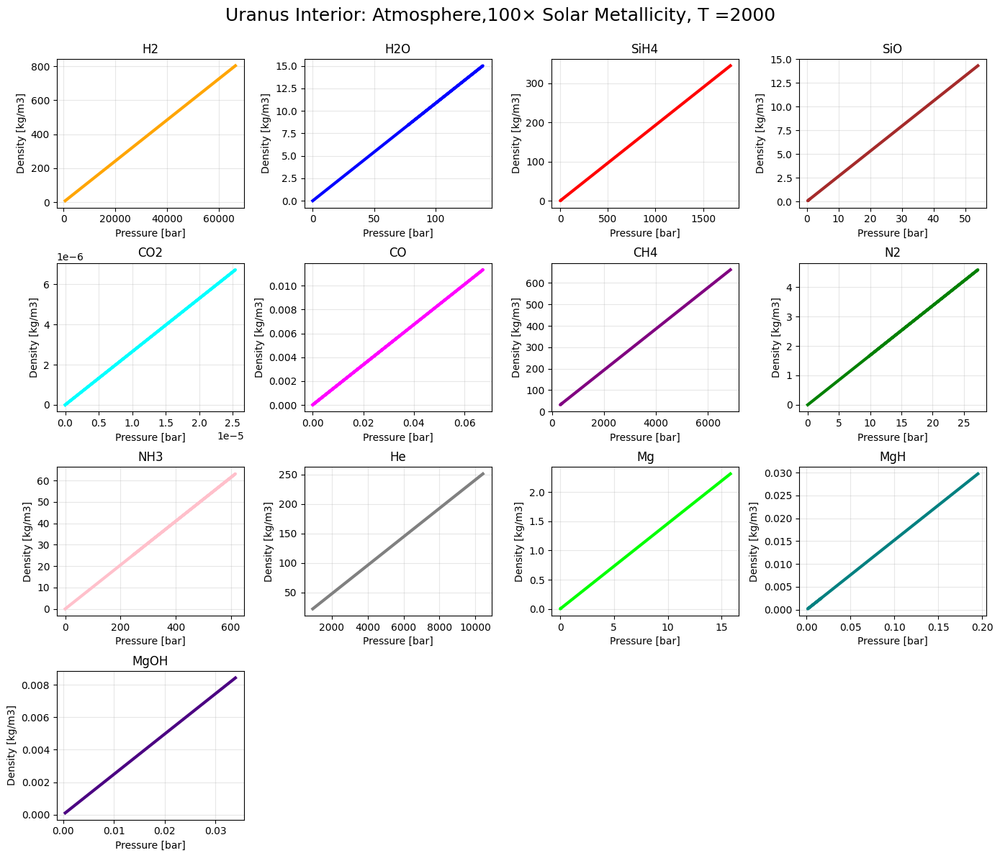

[20:48:22 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:48:22 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

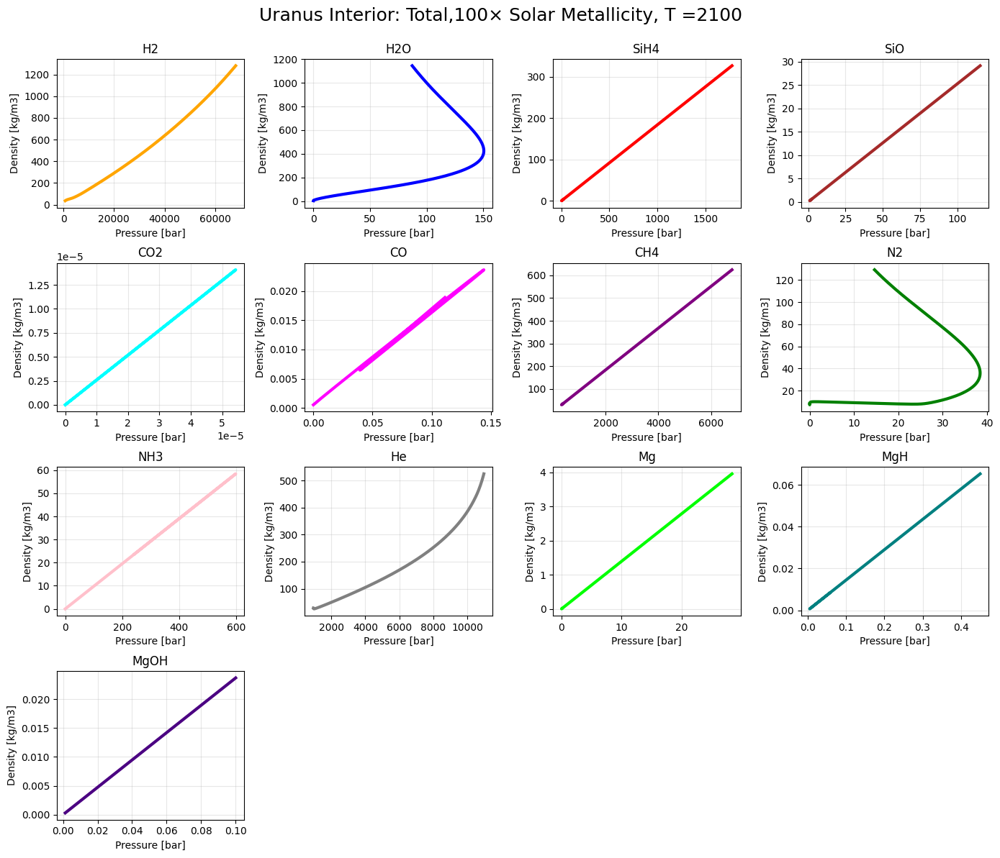

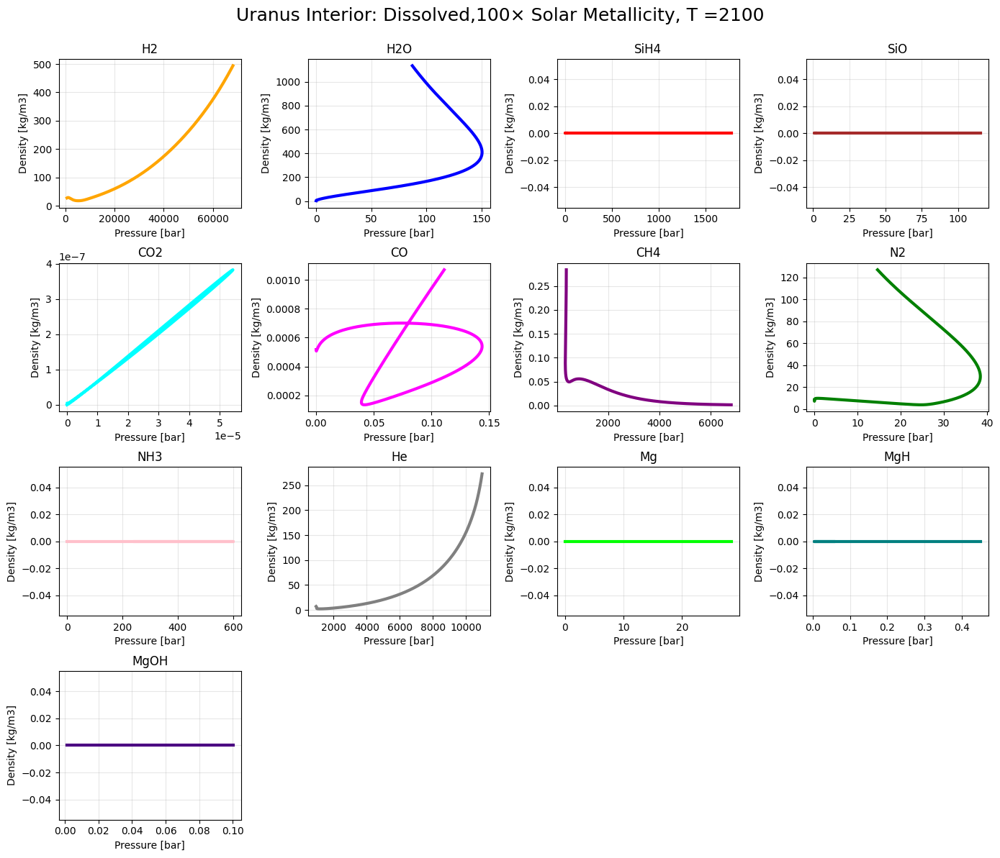

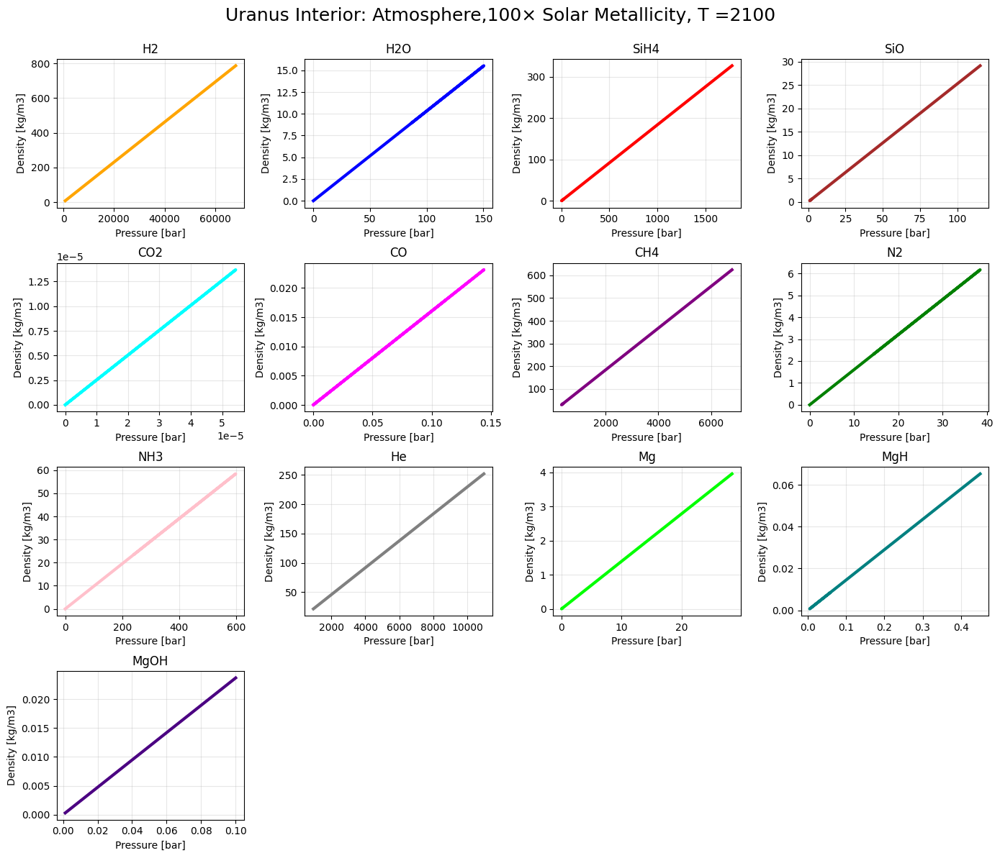

[20:49:38 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:49:38 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

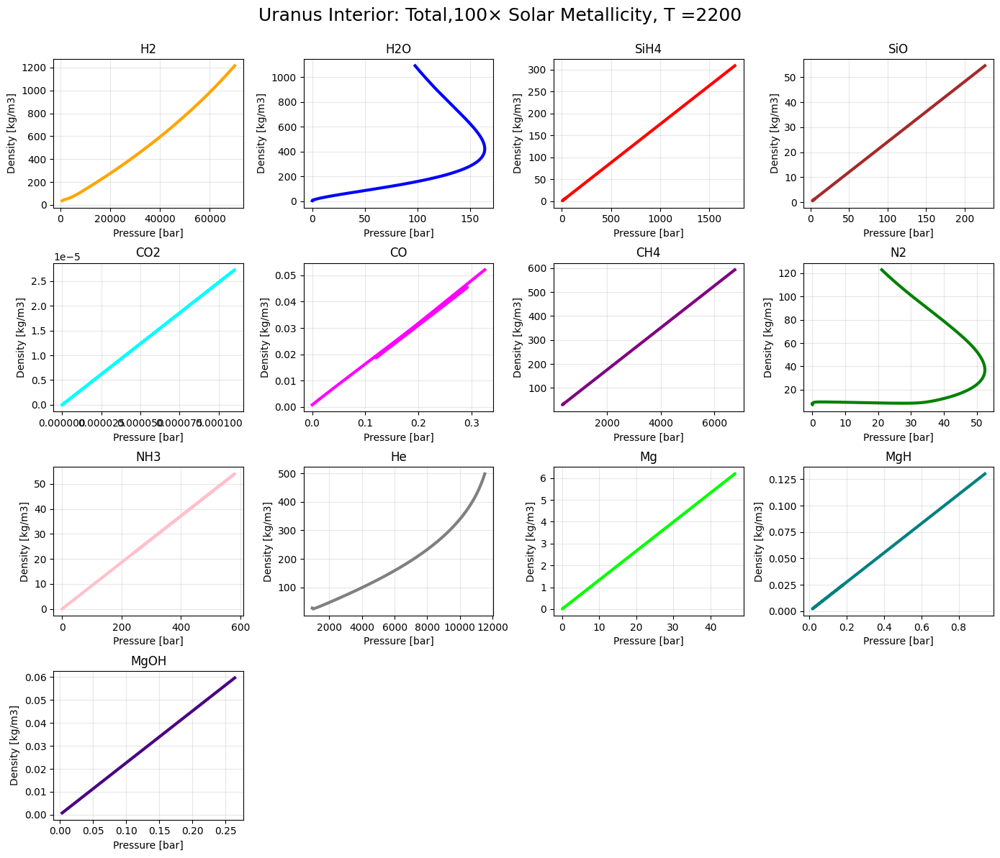

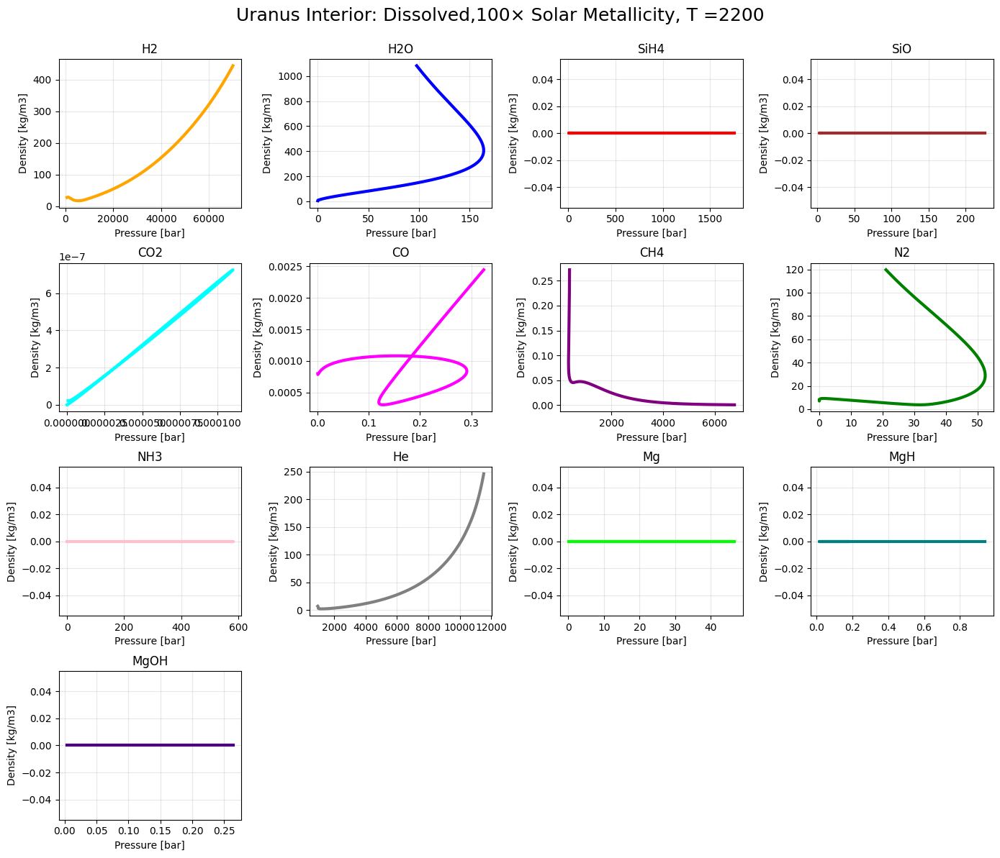

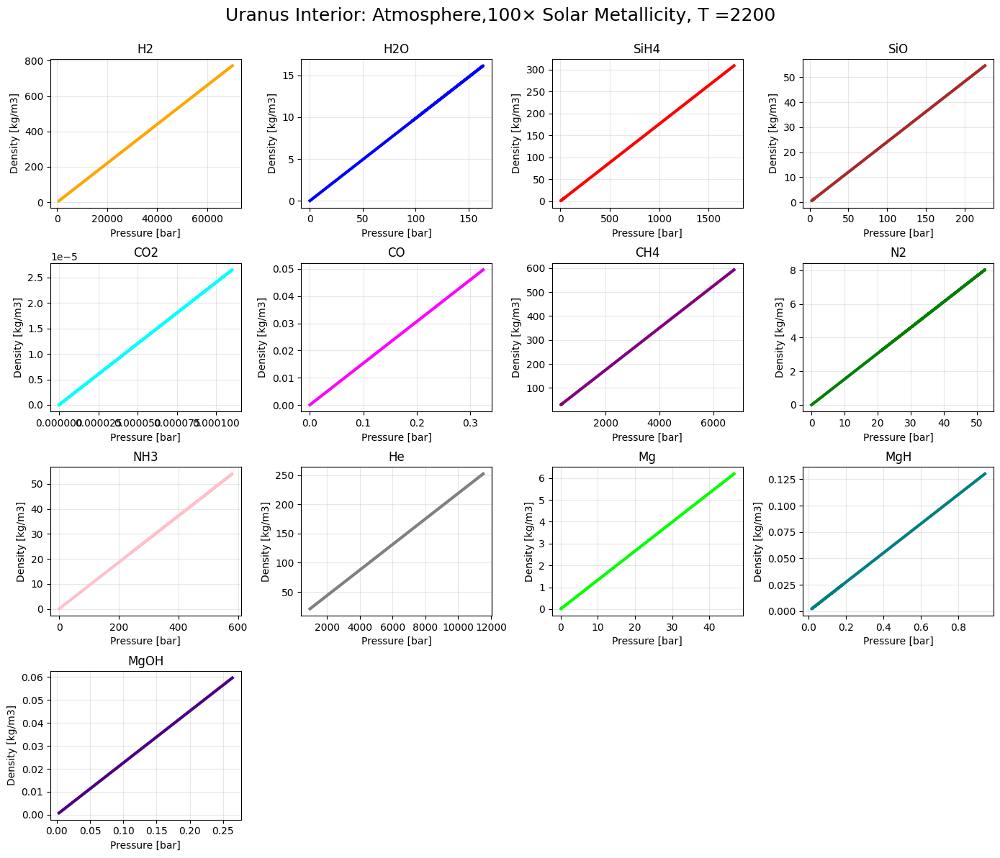

[20:50:50 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:50:50 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

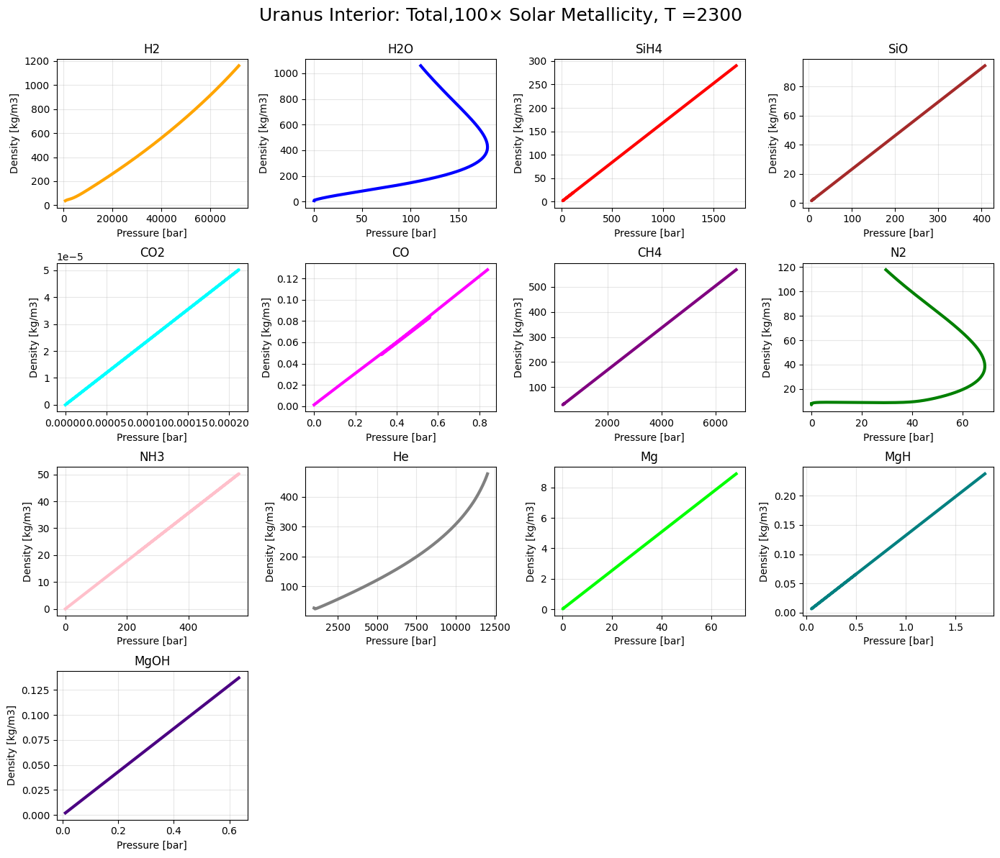

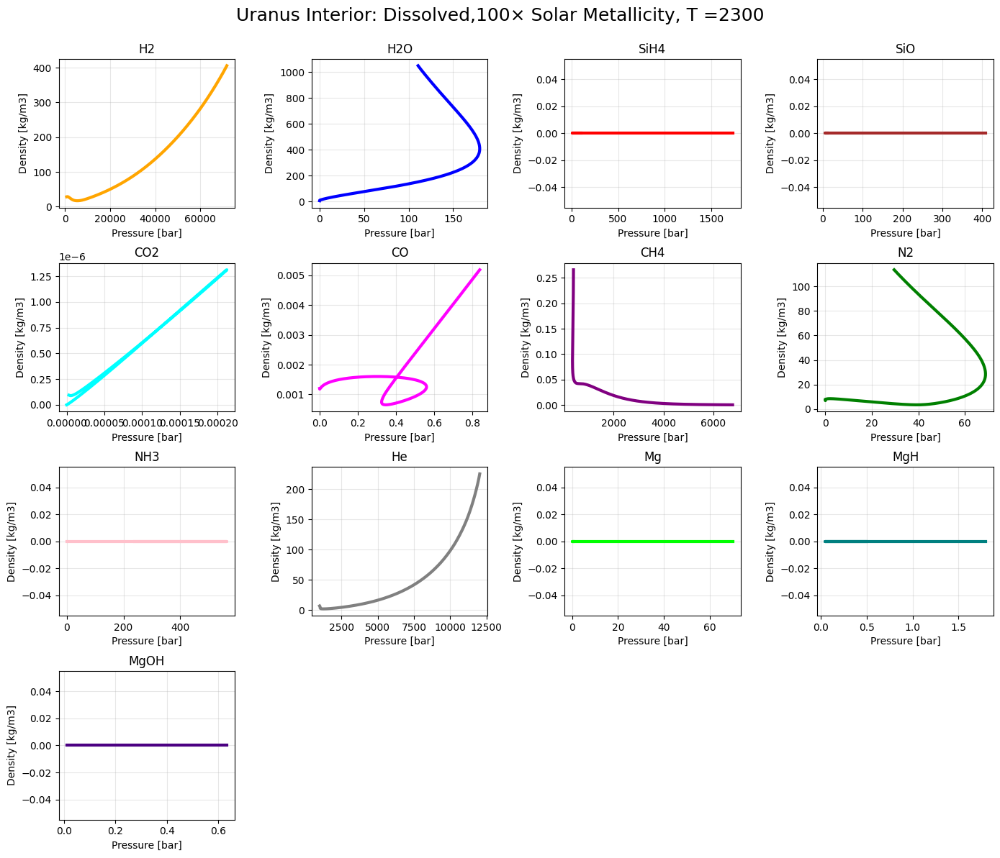

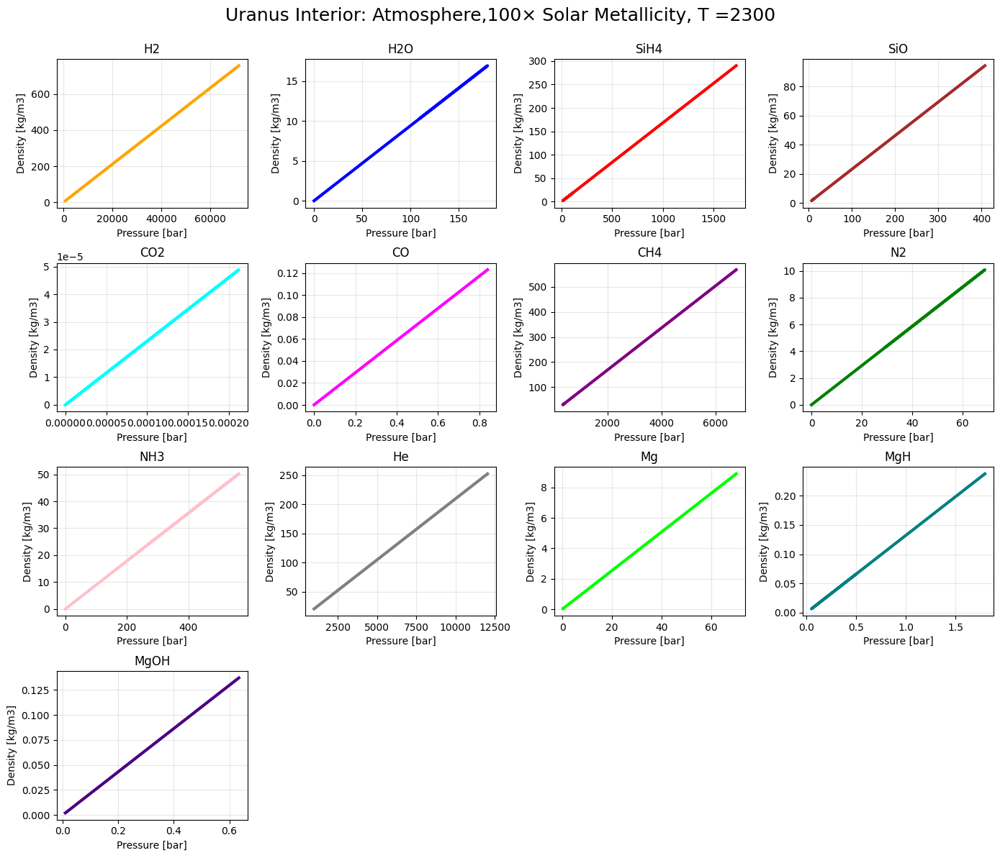

[20:52:05 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:52:05 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

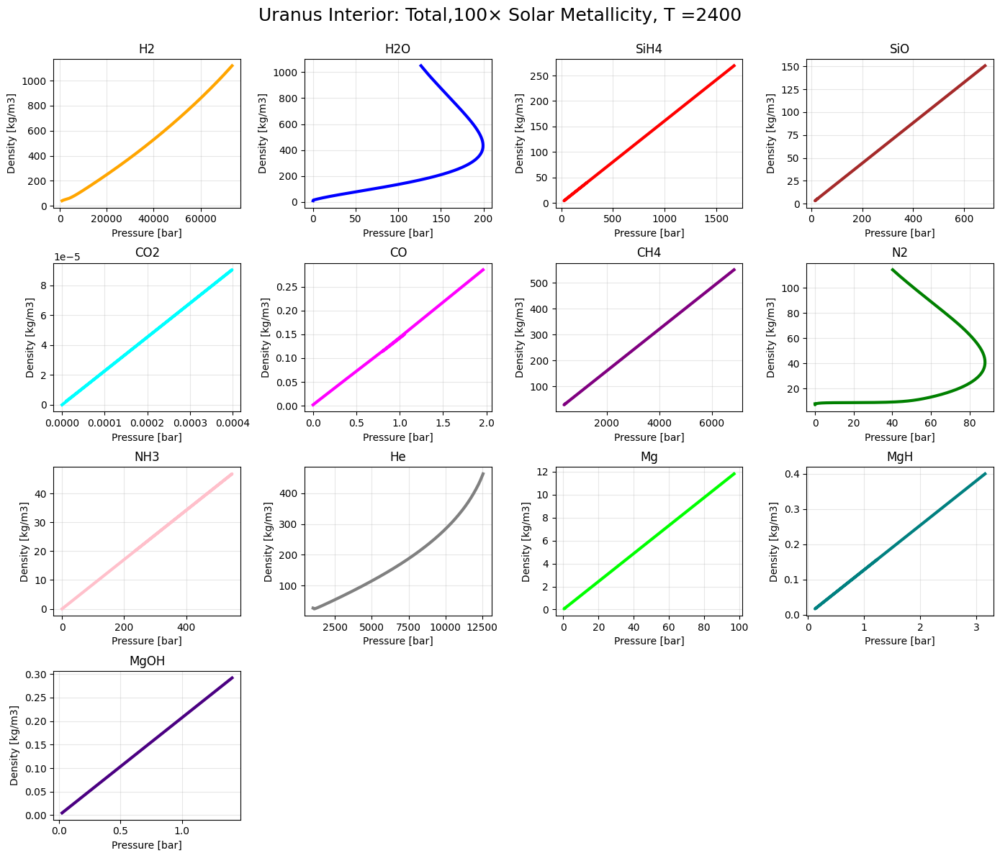

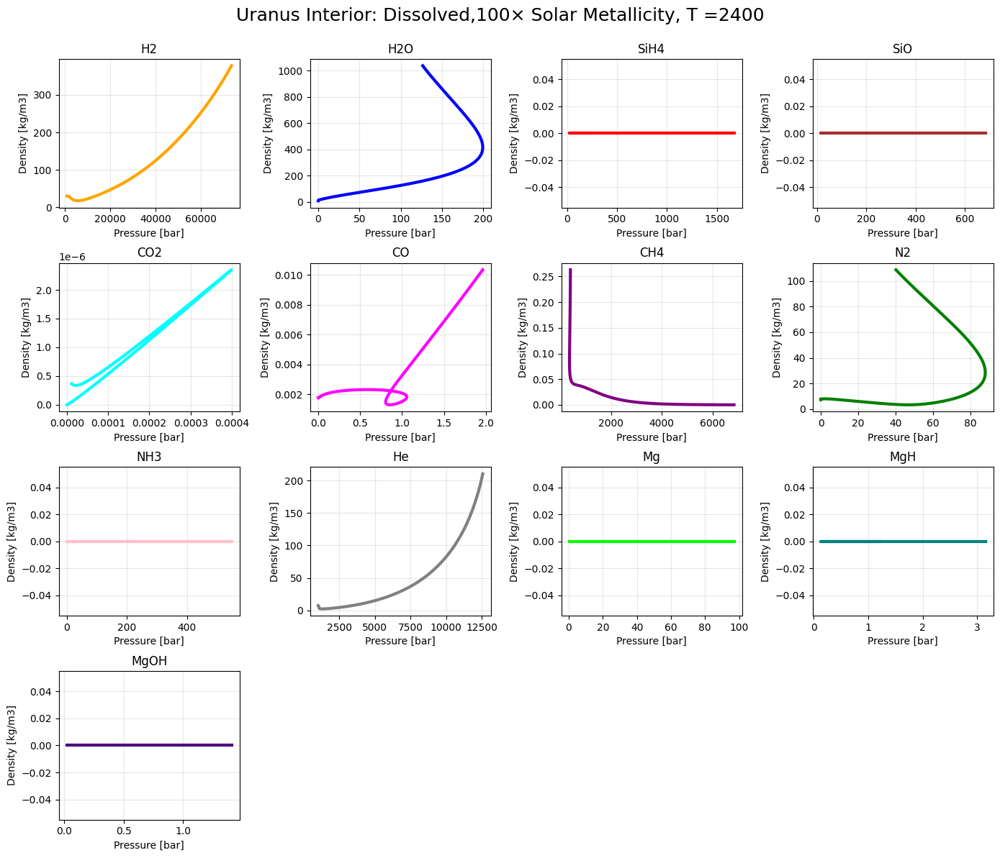

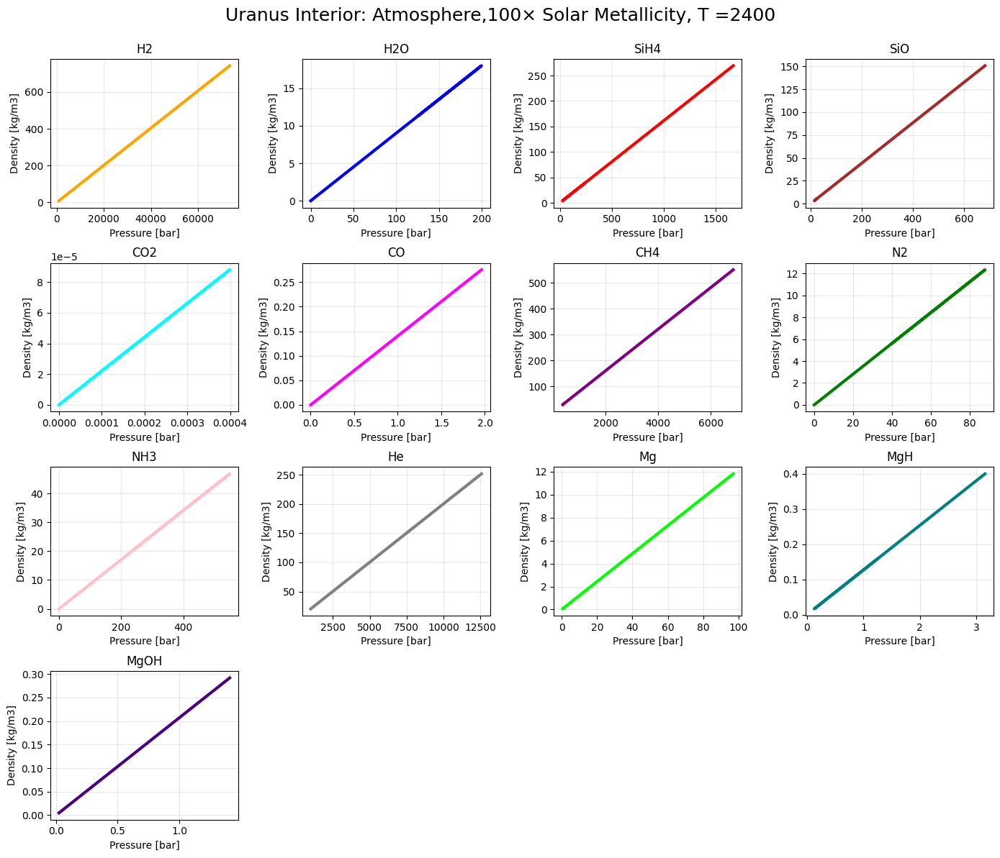

[20:52:59 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:52:59 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

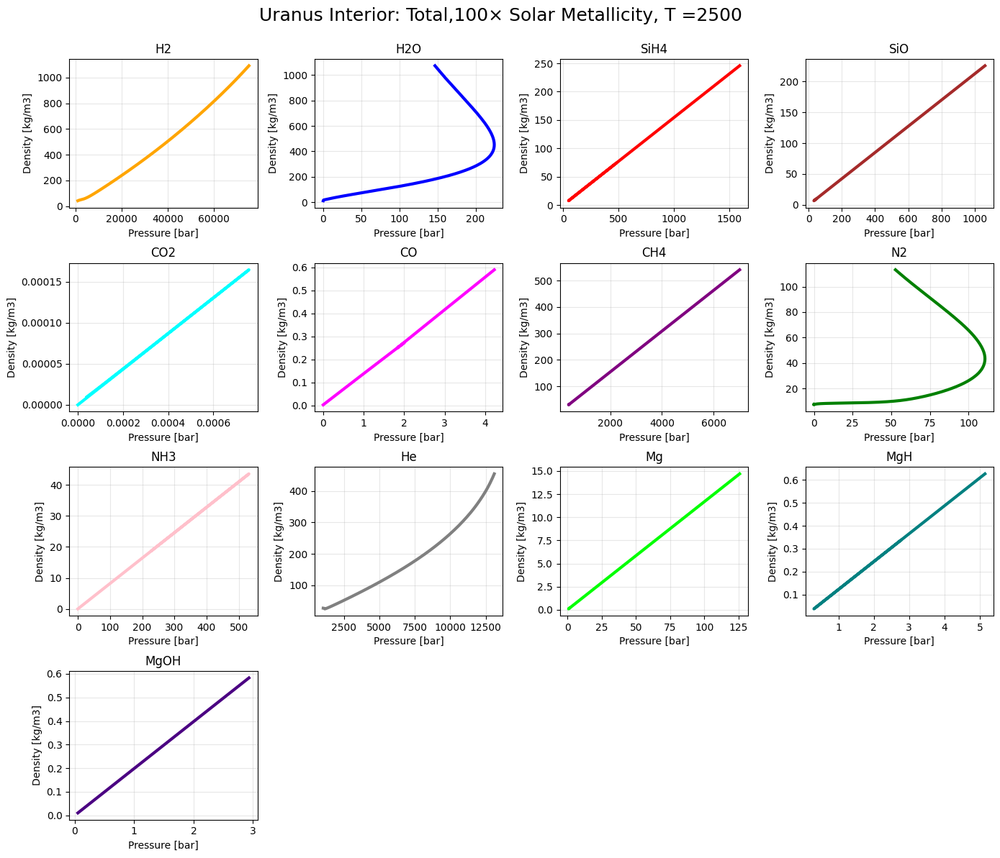

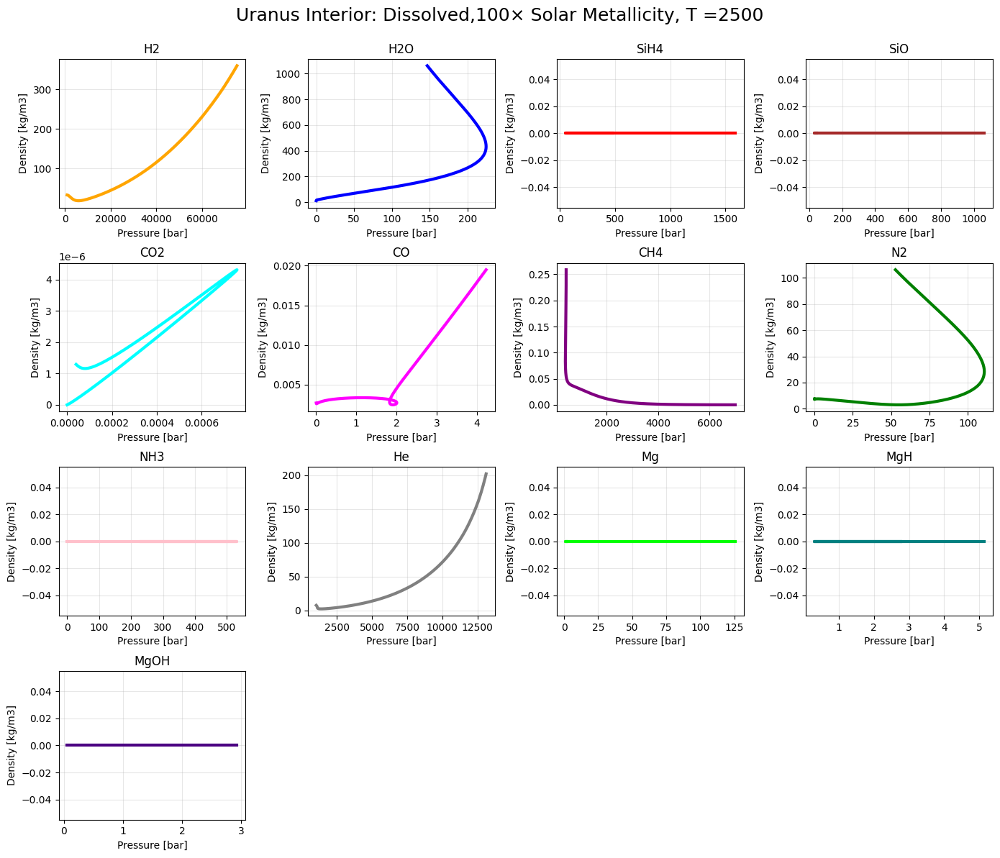

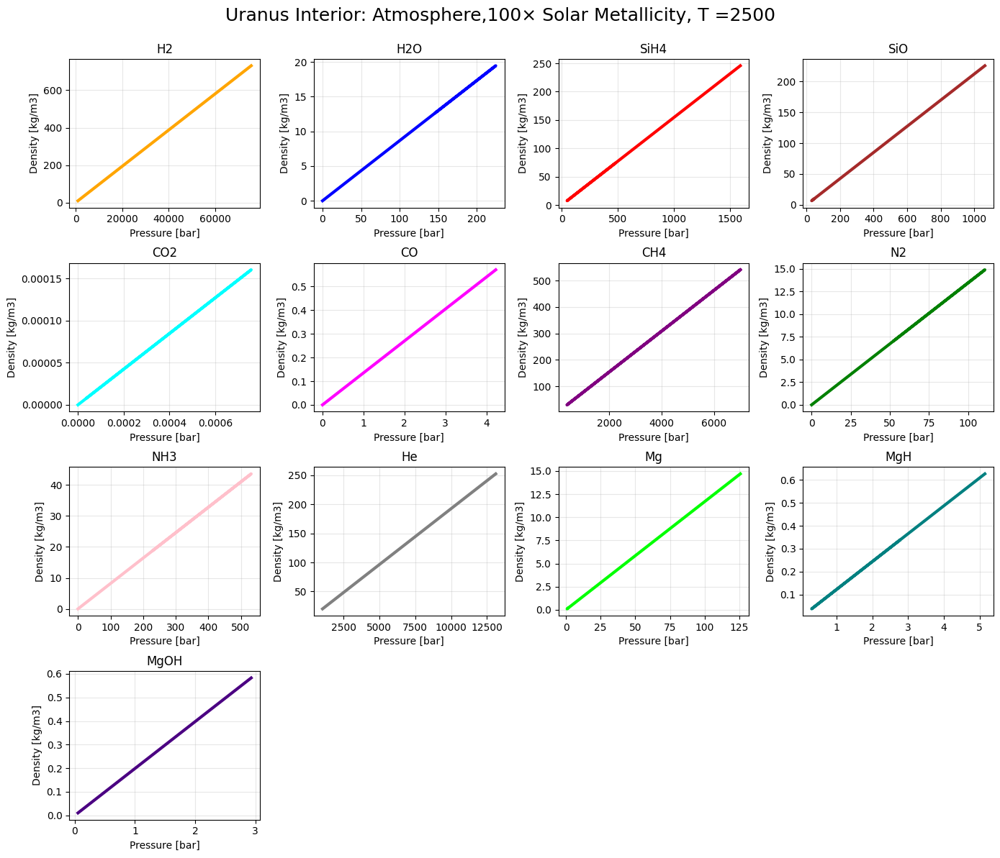

[20:53:55 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:53:55 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

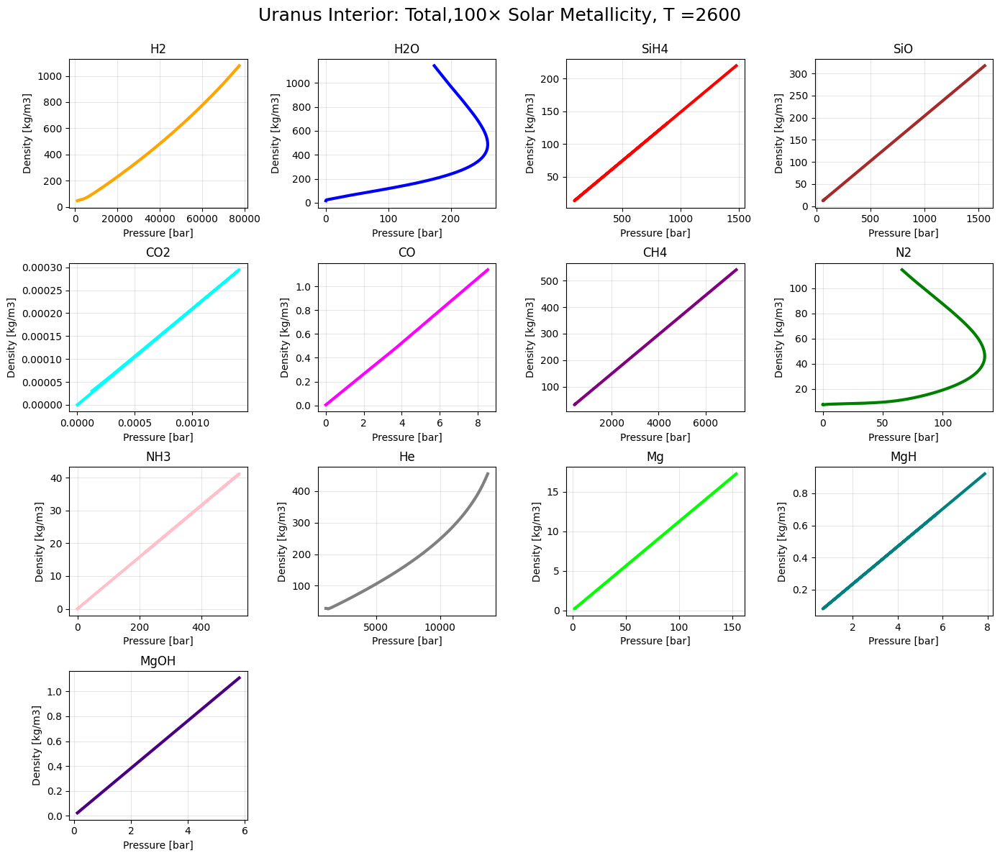

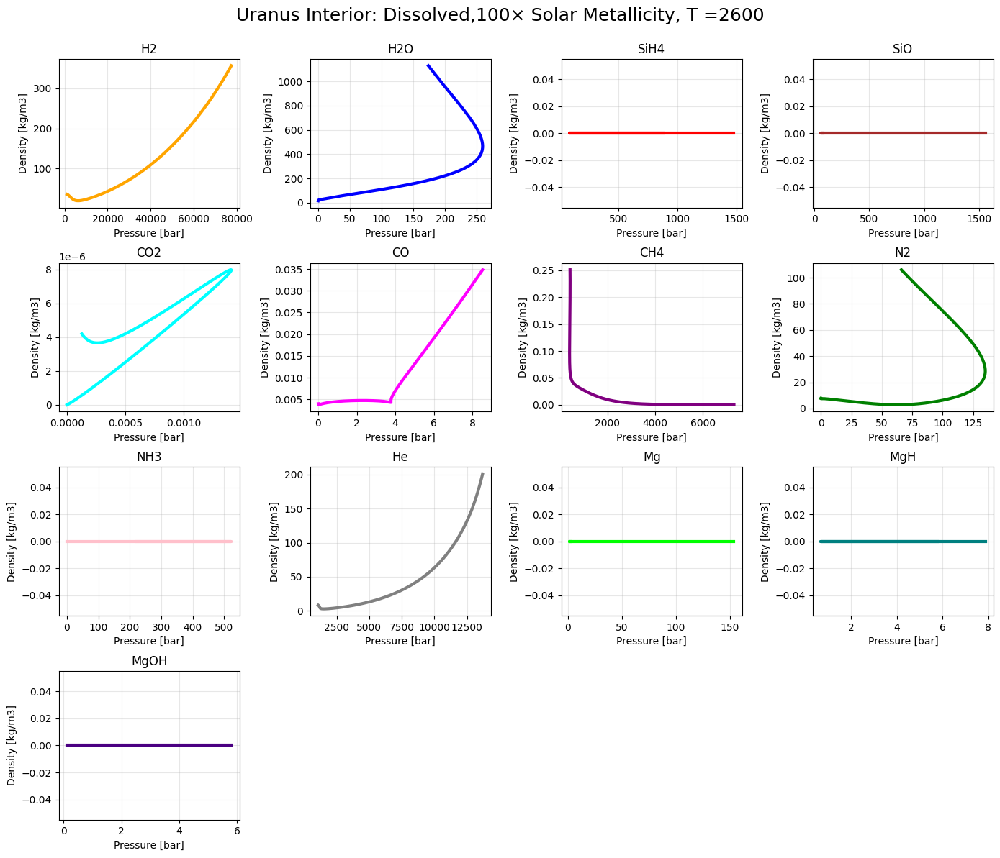

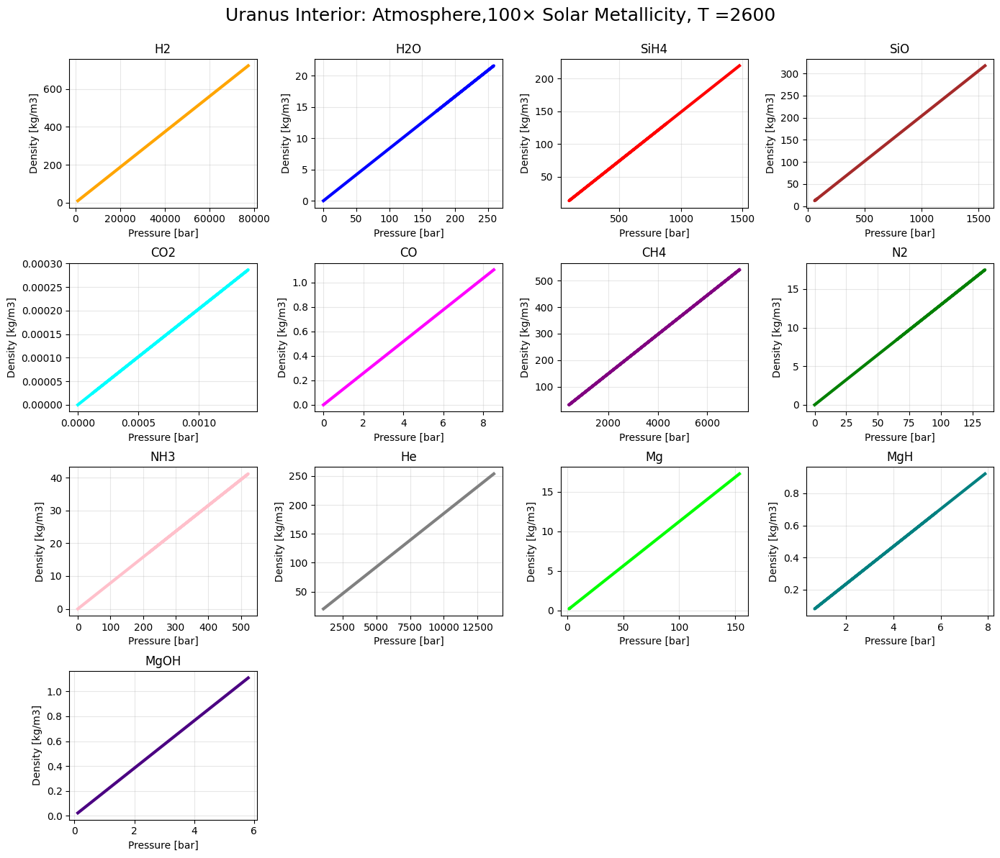

[20:54:45 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:54:45 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

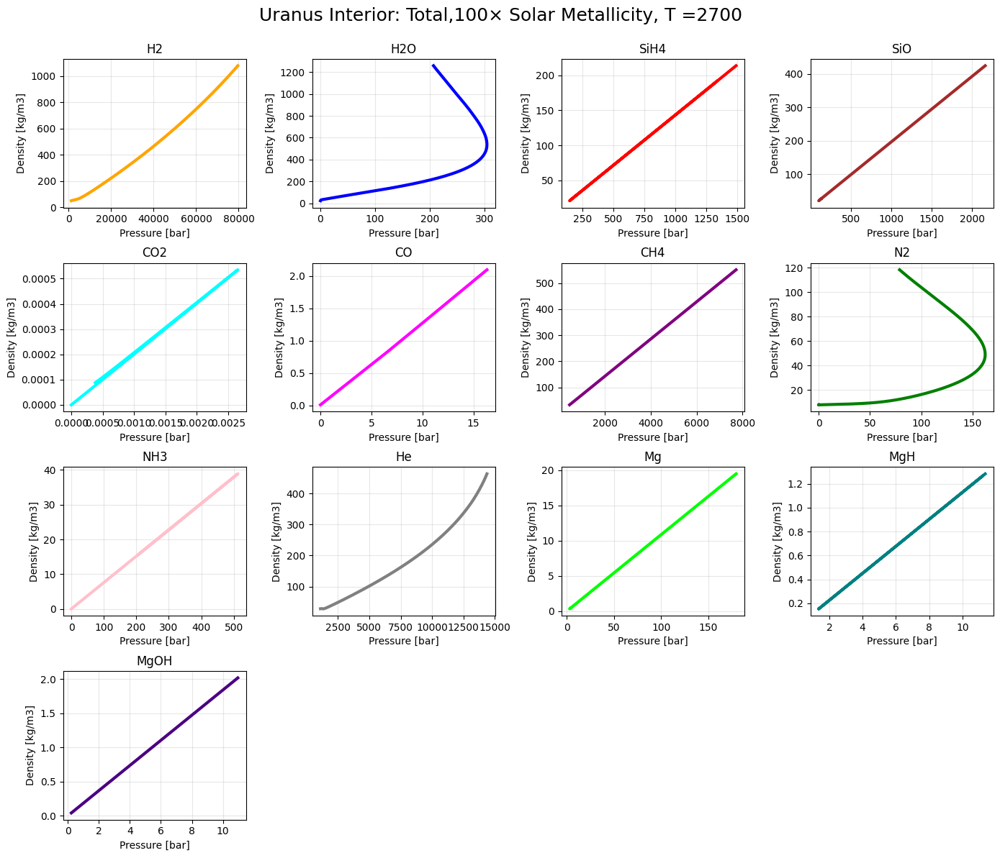

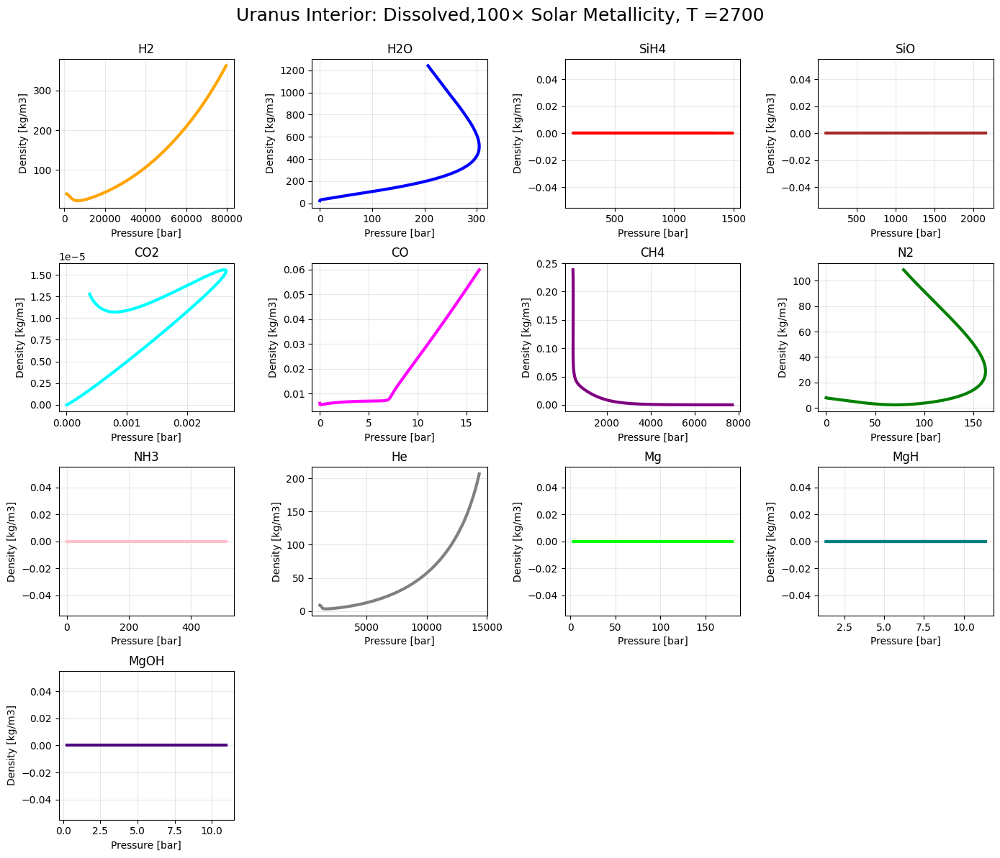

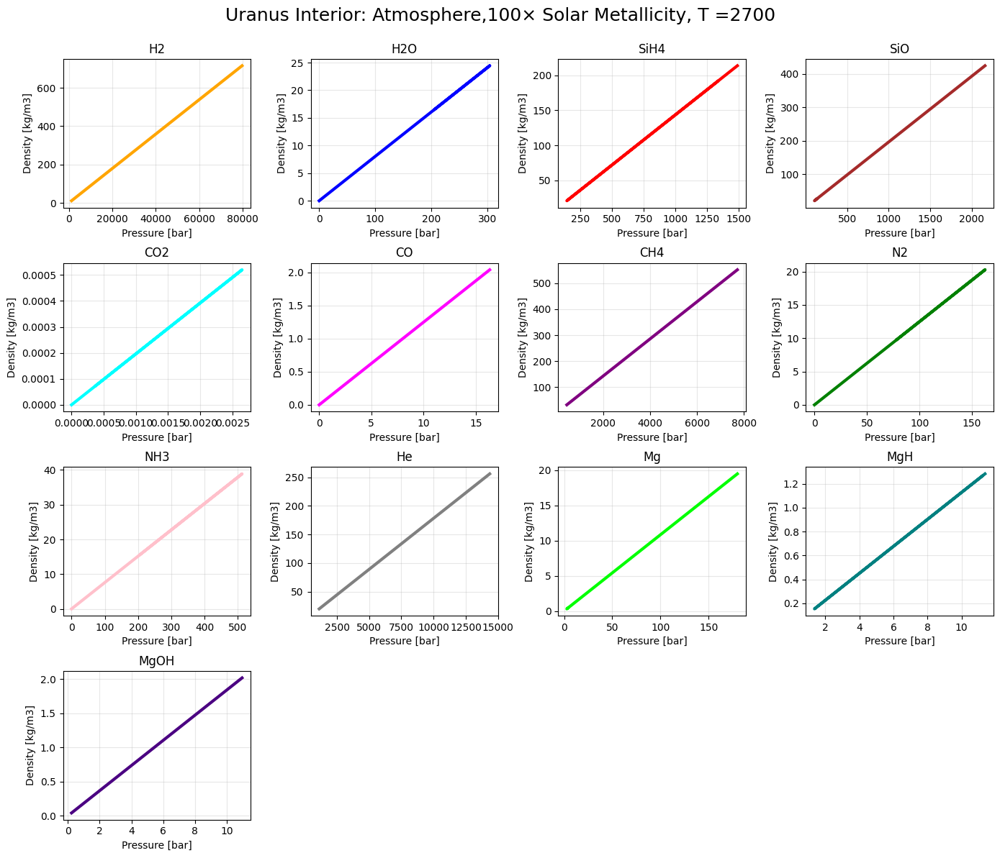

[20:55:35 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:55:35 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

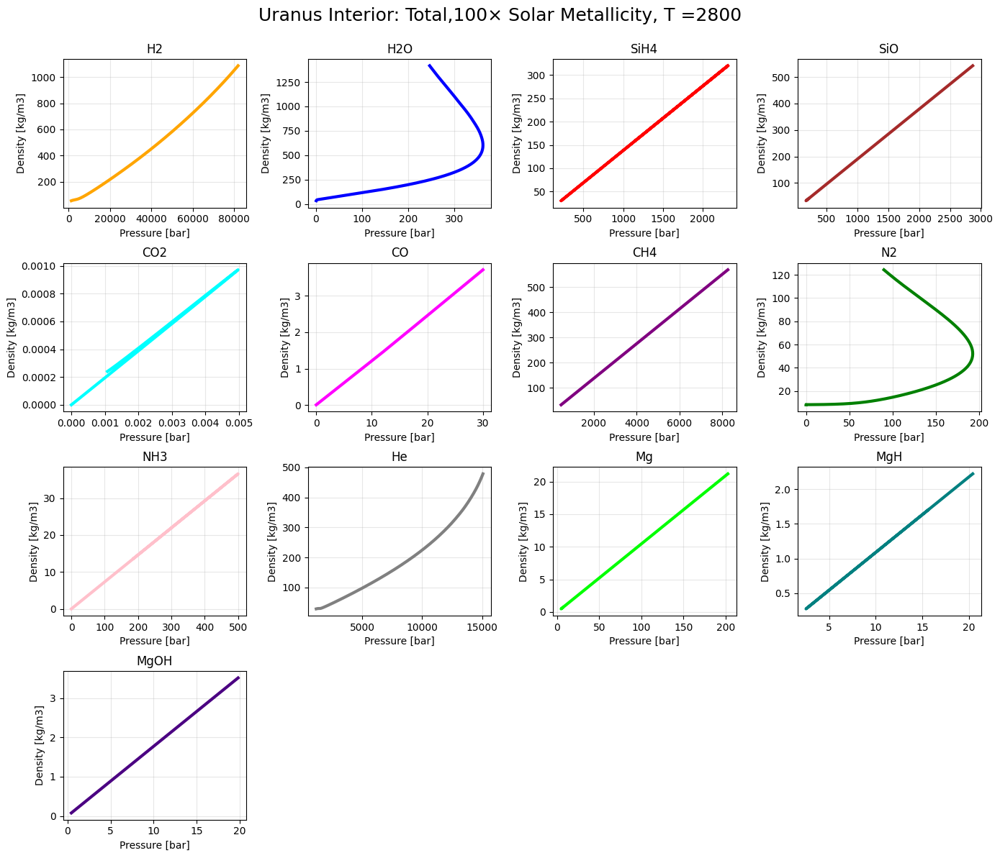

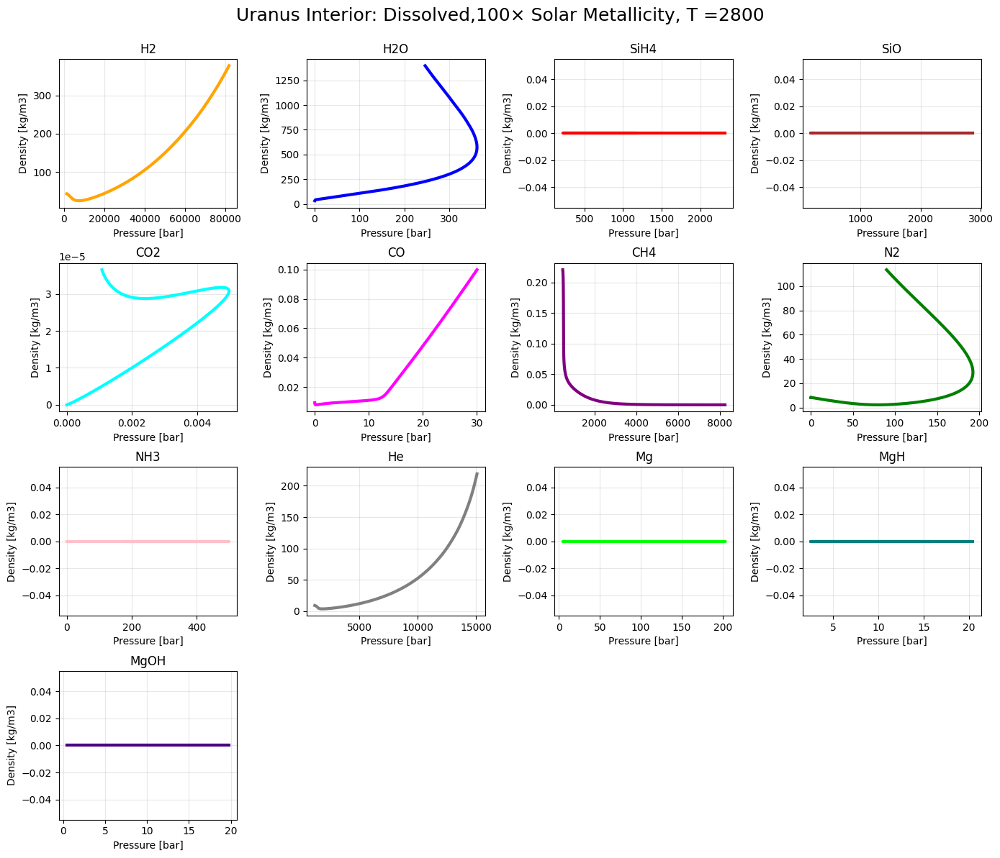

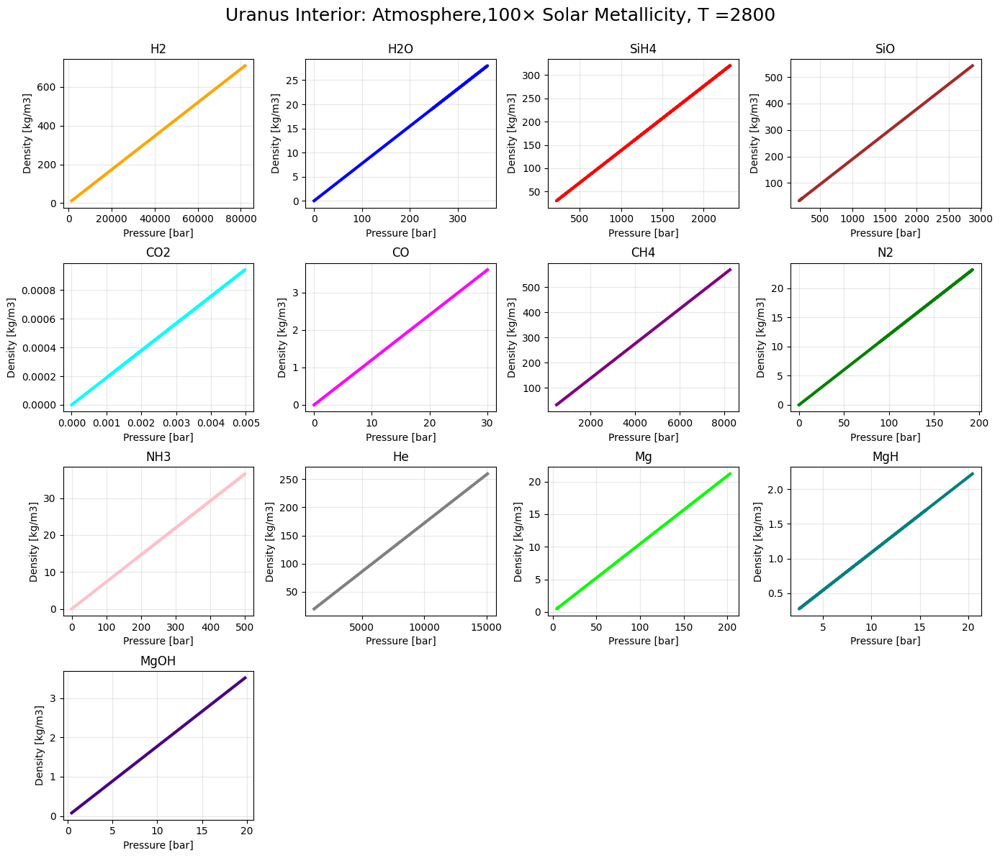

[20:56:26 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:56:26 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

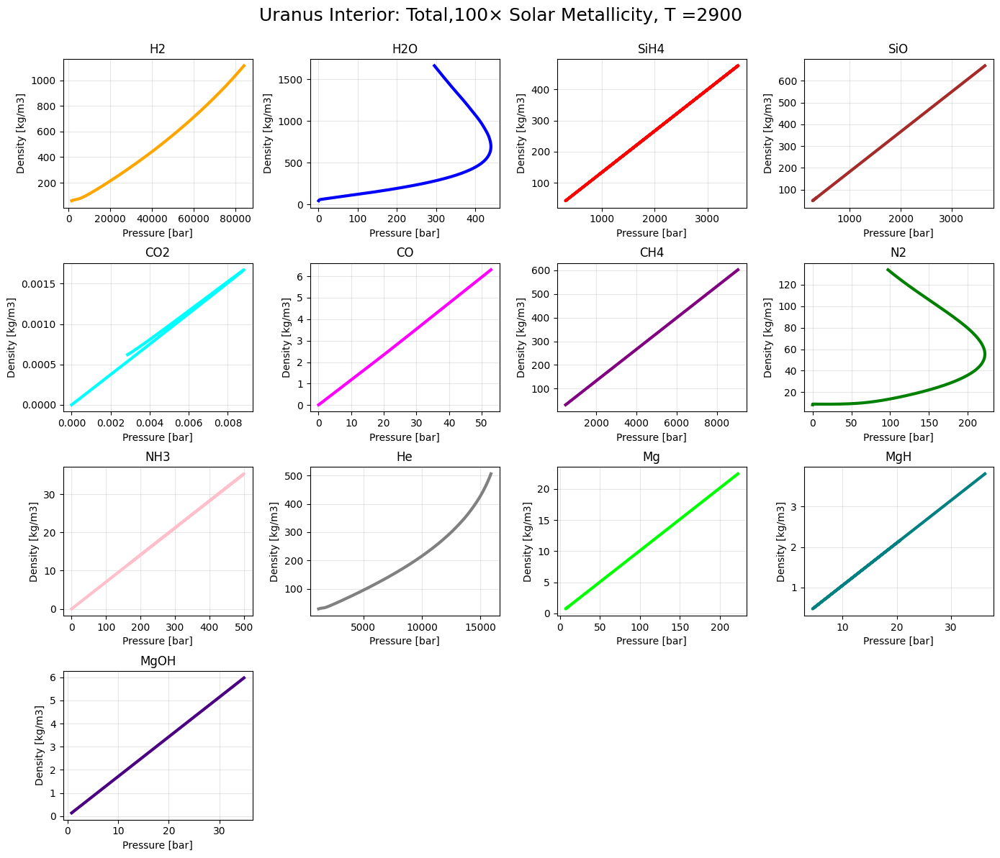

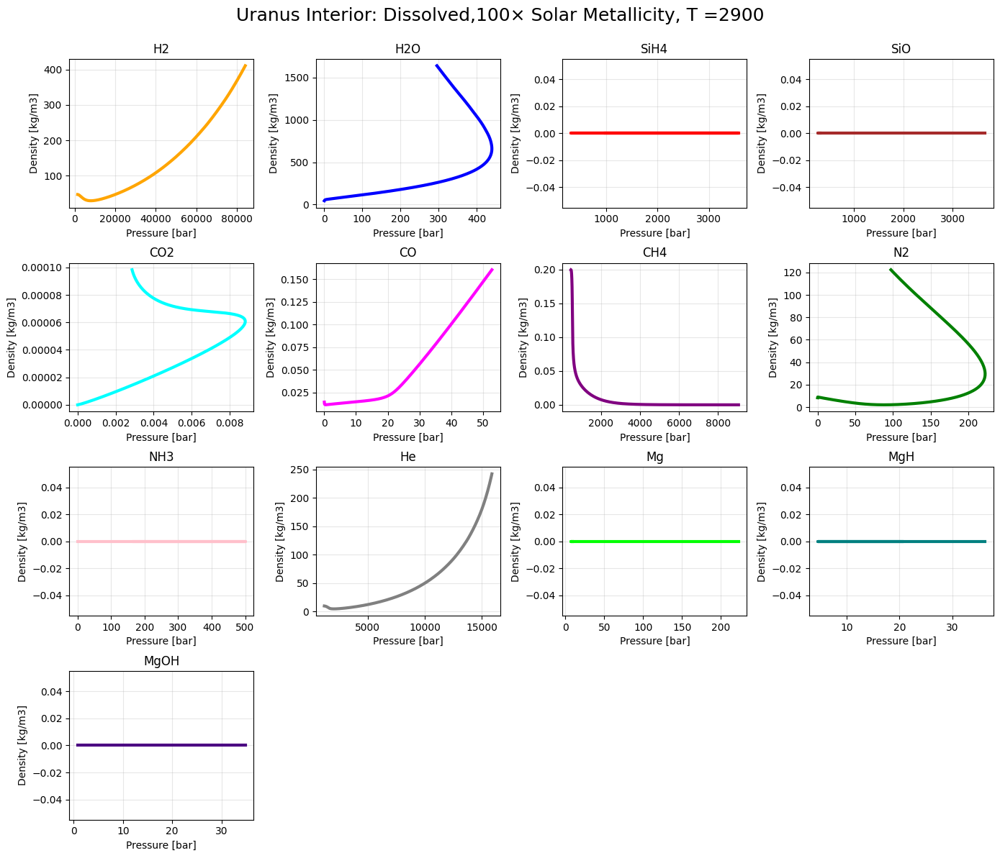

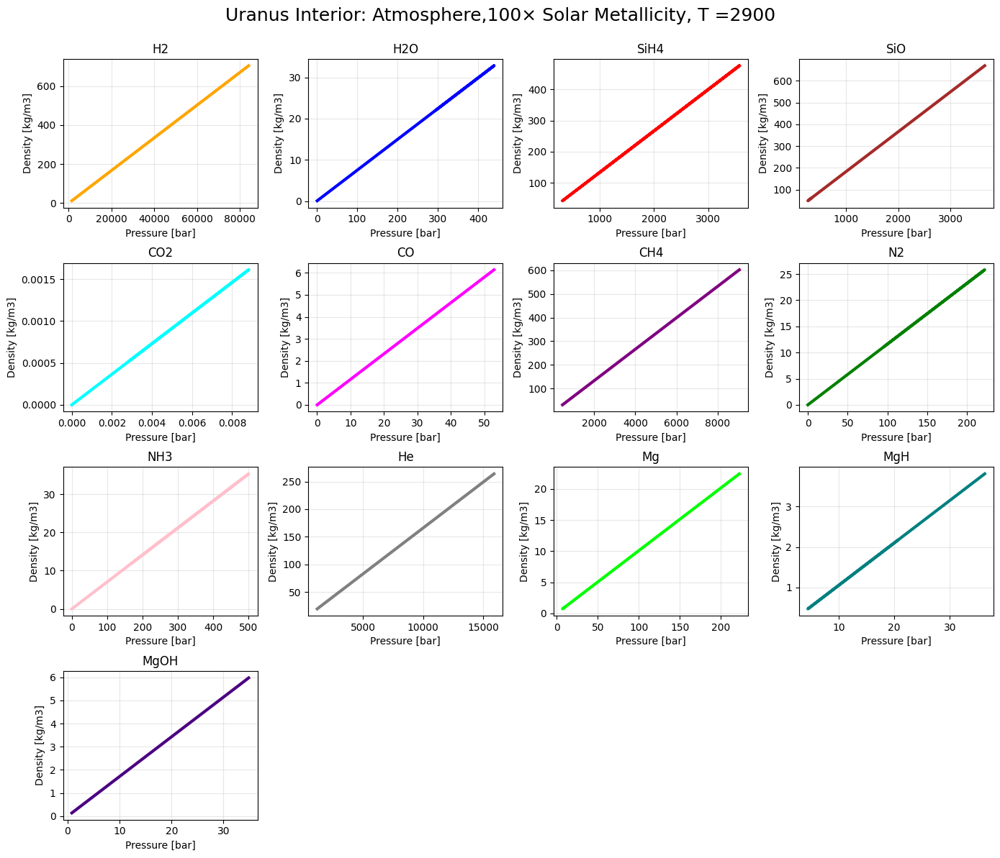

[20:57:20 - atmodeller.classes             - INFO     ] - species = ('H2O_g: IdealGas, NoSolubility', 'H2_g: IdealGas, NoSolubility', 'O2_g: IdealGas, NoSolubility', 'OSi_g: IdealGas, NoSolubility', 'H4Si_g: IdealGas, NoSolubility', 'O2Si_l: CondensateActivity, NoSolubility', 'CO2_g: IdealGas, NoSolubility', 'CO_g: IdealGas, NoSolubility', 'CH4_g: IdealGas, NoSolubility', 'N2_g: IdealGas, NoSolubility', 'H3N_g: IdealGas, NoSolubility', 'He_g: IdealGas, NoSolubility', 'Mg_g: IdealGas, NoSolubility', 'MgO_l: CondensateActivity, NoSolubility', 'HMg_g: IdealGas, NoSolubility', 'HMgO_g: IdealGas, NoSolubility')
[20:57:20 - atmodeller.classes             - INFO     ] - reactions = {0: '1.0 H2_g + 1.0 CO2_g = 1.0 H2O_g + 1.0 CO_g',
 1: '4.0 H2_g + 1.0 CO2_g = 2.0 H2O_g + 1.0 CH4_g',
 2: '4.0 H2_g + 1.0 O2Si_l = 2.0 H2O_g + 1.0 H4Si_g',
 3: '1.5 H2_g + 0.5 N2_g = 1.0 H3N_g',
 4: '2.0 H2O_g = 2.0 H2_g + 1.0 O2_g',
 5: '1.0 H2_g + 1.0 O2Si_l = 1.0 H2O_g + 1.0 OSi_g',
 6: '1.0 H2O_g + 1.0 Mg_g = 

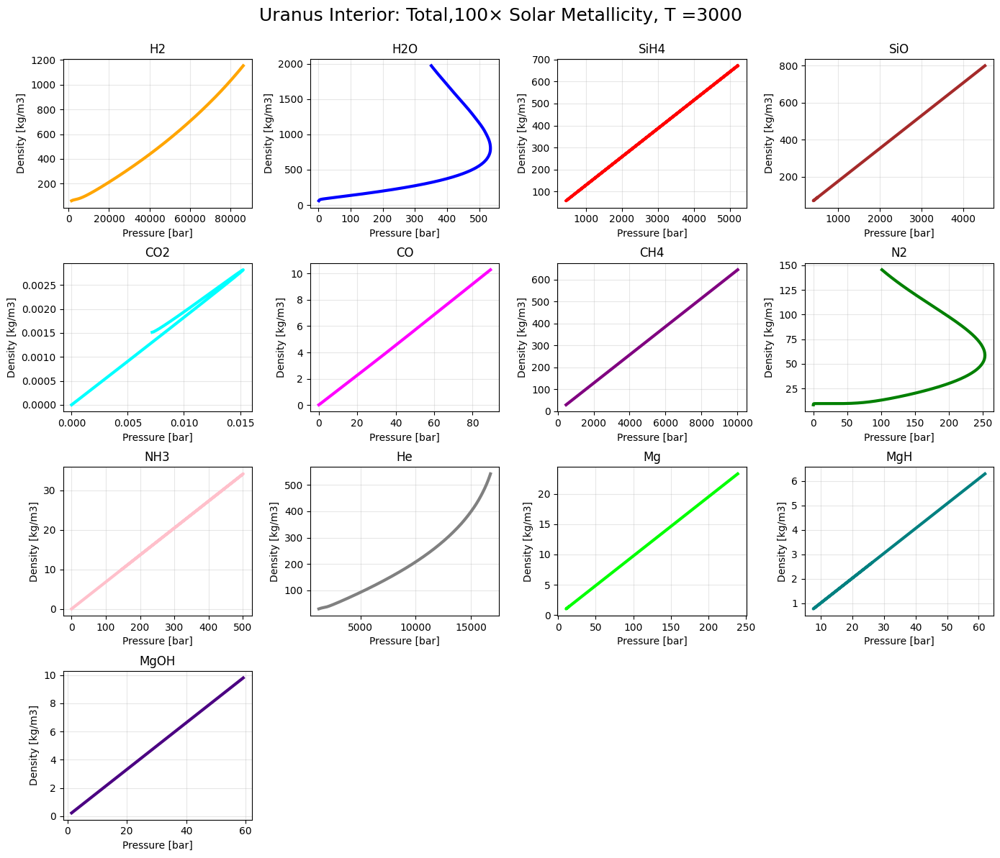

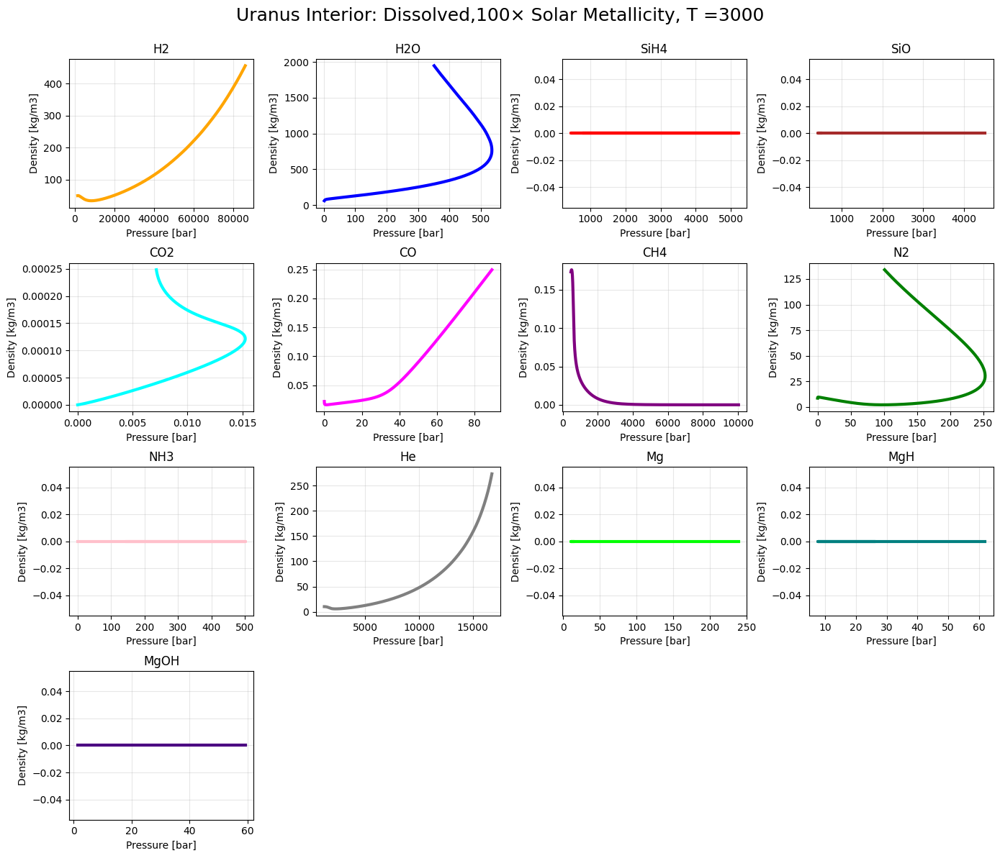

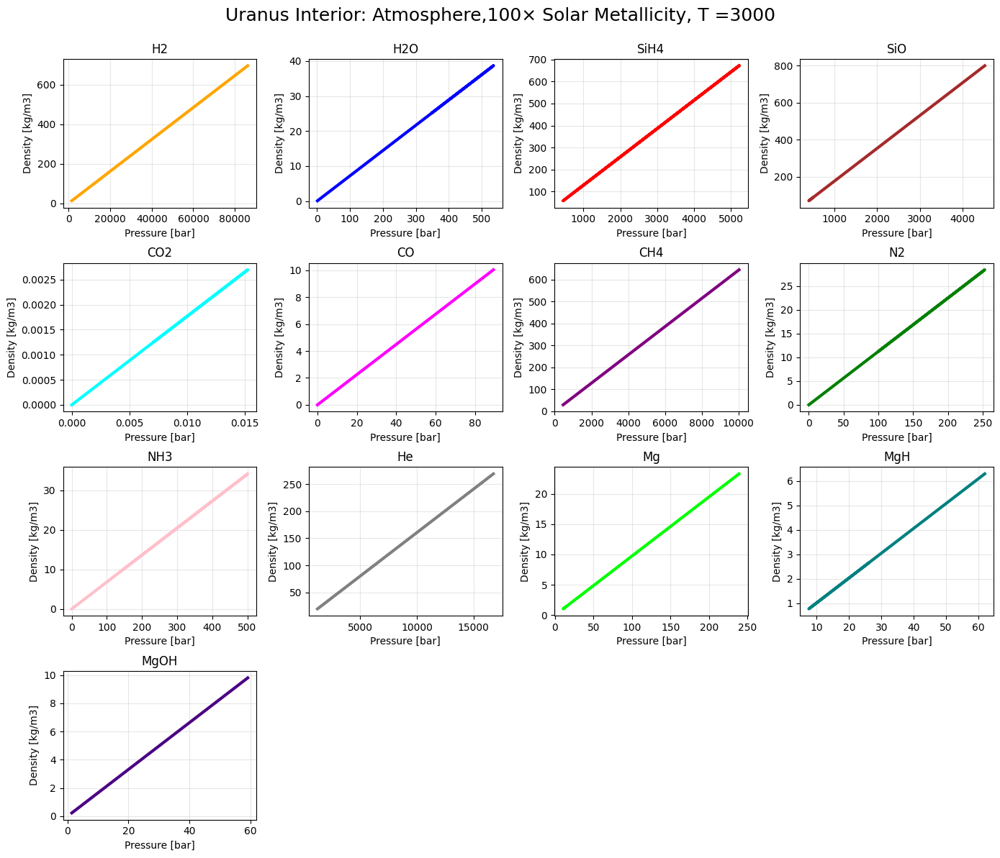

In [9]:
#
init_metallicity = [1, 3, 5, 10, 30, 100]
temperatures = [2000, 2100, 2200, 2300, 2400, 2500, 2600, 2700, 2800, 2900, 3000]
for metall in init_metallicity:
    for temperature in temperatures:
        create_isotherms(temperature, planet_mass, mantle_melt_fraction, surface_radius, metall)